In [1]:
import os
LOAD = False         # True = load previously saved model from disk?  False = (re)train the model
SAVE = "\_TFT_model_02.pth.tar"   # file name to save the model under

EPOCHS = 200
INLEN = 16          # input size
HIDDEN = 32         # hidden layers    
LSTMLAYERS = 2      # recurrent layers

ATTH = 2            # attention heads
BATCH = 64          # batch size
LEARN = 1e-3        # learning rate
DROPOUT = 0.1       # dropout rate
VALWAIT = 1         # epochs to wait before evaluating the loss on the test/validation set
N_FC = 2            # output size

RAND = 42           # random seed
N_SAMPLES = 100     # number of times a prediction is sampled from a probabilistic model
N_JOBS = -1          # parallel processors to use;  -1 = all processors

# default quantiles for QuantileRegression
QUANTILES = [0.01, 0.1, 0.2, 0.5, 0.8, 0.9, 0.99]

SPLIT = 0.9         # train/test %

FIGSIZE = (9, 6)


qL1, qL2 = 0.01, 0.10        # percentiles of predictions: lower bounds
qU1, qU2 = 1-qL1, 1-qL2,     # upper bounds derived from lower bounds
label_q1 = f'{int(qU1 * 100)} / {int(qL1 * 100)} percentile band'
label_q2 = f'{int(qU2 * 100)} / {int(qL2 * 100)} percentile band'

mpath = os.path.abspath(os.getcwd()) + SAVE     # path and file name to save the model

In [2]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys
import missingno as mno

import warnings
warnings.filterwarnings("ignore")
import logging
logging.disable(logging.CRITICAL)


from darts import TimeSeries, concatenate
from darts.dataprocessing.transformers import Scaler
from darts.models import TransformerModel, NBEATSModel, TFTModel
from darts.metrics import mape, rmse, smape
from darts.utils.timeseries_generation import datetime_attribute_timeseries
from darts.utils.likelihood_models import QuantileRegression
from pytorch_lightning.callbacks.early_stopping import EarlyStopping

pd.set_option("display.precision",2)
np.set_printoptions(precision=2, suppress=True)
pd.options.display.float_format = '{:,.2f}'.format

In [3]:
import pandas as pd
xls = pd.ExcelFile('../../data_complete.xlsx')
df_radon={}
for key in ['48','9']:
    df_radon[key] = pd.read_excel(xls, key)
    df_radon[key] = df_radon[key].loc[(df_radon[key]['SyncDate']>='2022-11-10')]

In [4]:
df_radon.keys()

dict_keys(['48', '9'])

In [5]:
#using 21 as the example since it has the most data
df = df_radon['48']

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2166 entries, 0 to 2165
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Serialid     2166 non-null   object        
 1   DeviceName   2166 non-null   object        
 2   SyncDate     2166 non-null   datetime64[ns]
 3   Radon        2166 non-null   float64       
 4   eC02         2166 non-null   int64         
 5   VOC          2166 non-null   int64         
 6   Temperature  2166 non-null   int64         
 7   AirPressure  2166 non-null   float64       
 8   Humidity     2166 non-null   int64         
 9   LogIndex     2166 non-null   int64         
dtypes: datetime64[ns](1), float64(2), int64(5), object(2)
memory usage: 186.1+ KB


In [7]:
df = df[['SyncDate','Temperature','Humidity','AirPressure','Radon']]

In [8]:
df

,SyncDate,Temperature,Humidity,AirPressure,Radon
0,2023-02-11 18:05:58,49,61,30.02,28.90
1,2023-02-11 16:05:58,56,53,30.08,25.40
2,2023-02-11 15:05:58,58,51,30.08,25.30
3,2023-02-11 14:05:58,57,51,30.13,25.30
4,2023-02-11 12:05:58,61,49,30.15,28.40
...,...,...,...,...,...
2161,2022-11-10 04:30:42,64,50,30.16,43.80
2162,2022-11-10 03:30:42,64,50,30.19,43.40
2163,2022-11-10 02:30:42,63,50,30.21,42.80
2164,2022-11-10 01:30:42,63,50,30.23,42.40


In [9]:
df['SyncDate'] = pd.to_datetime(df['SyncDate'])
df.sort_values(by='SyncDate', ascending=True, inplace=True)
df['SyncDate'] = df['SyncDate'].dt.floor('H')
df = df.resample('D', on = 'SyncDate').mean()
df = df.interpolate(method='linear', limit_direction='both')
df.drop_duplicates(inplace=True)

In [10]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-11-10,67.09,53.36,30.06,42.69
2022-11-11,69.29,69.62,29.67,74.10
2022-11-12,64.74,71.04,29.92,58.15
2022-11-13,52.42,60.21,30.14,12.51
2022-11-14,52.50,53.75,30.23,26.52
...,...,...,...,...
2023-02-07,61.57,45.22,30.27,0.68
2023-02-08,64.96,49.57,30.24,0.65
2023-02-09,63.95,59.23,30.13,0.78


In [11]:
df = df[df.index<= '2023-02-10']

In [12]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-11-10,67.09,53.36,30.06,42.69
2022-11-11,69.29,69.62,29.67,74.10
2022-11-12,64.74,71.04,29.92,58.15
2022-11-13,52.42,60.21,30.14,12.51
2022-11-14,52.50,53.75,30.23,26.52
...,...,...,...,...
2023-02-06,63.92,46.08,30.17,3.23
2023-02-07,61.57,45.22,30.27,0.68
2023-02-08,64.96,49.57,30.24,0.65


In [13]:
weather_station = pd.read_csv('../../lilburn_weather_station.csv')

In [14]:
weather_station

,Date,Simple Date,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
0,2023-02-10T23:55:00-05:00,2023-02-10 23:55:00,49.80,0.00,0.00,5.80,337,0.00,0.41,0.27,0.41,1.53,67.44,29.09,74,0,0.00,29.09,336,0.00
1,2023-02-10T23:50:00-05:00,2023-02-10 23:50:00,49.50,0.00,0.00,5.80,328,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,331,0.00
2,2023-02-10T23:45:00-05:00,2023-02-10 23:45:00,49.80,0.00,0.00,5.80,331,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,323,0.00
3,2023-02-10T23:40:00-05:00,2023-02-10 23:40:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,304,0.00
4,2023-02-10T23:35:00-05:00,2023-02-10 23:35:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.10,75,0,0.00,29.10,315,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78459,2022-05-10T00:20:00-04:00,2022-05-10 00:20:00,55.80,0.00,0.00,0.00,305,0.00,0.00,0.00,0.00,0.76,22.72,29.13,91,0,0.00,29.13,305,0.00
78460,2022-05-10T00:15:00-04:00,2022-05-10 00:15:00,55.90,0.00,0.00,0.00,309,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,309,0.00
78461,2022-05-10T00:10:00-04:00,2022-05-10 00:10:00,55.80,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,306,0.00
78462,2022-05-10T00:05:00-04:00,2022-05-10 00:05:00,55.90,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,305,0.00


In [15]:
weather_station.drop('Date', axis=1, inplace=True)
weather_station['Simple Date'] = pd.to_datetime(weather_station['Simple Date'])
weather_station.sort_values(by='Simple Date', ascending=True, inplace=True)
weather_station['Simple Date'] = weather_station['Simple Date'].dt.floor('H')
weather_station = weather_station.resample('D', on = 'Simple Date').mean()
weather_station = weather_station.interpolate(method='linear', limit_direction='both')
weather_station.drop_duplicates(inplace=True)

In [16]:
weather_station

,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
Simple Date,,,,,,,,,,,,,,,,,,
2022-05-10,65.19,0.15,0.57,3.47,294.31,0.00,0.00,0.00,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,69.33,0.18,0.65,3.28,290.86,0.00,0.00,0.00,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,71.16,0.28,0.94,3.61,292.67,0.00,0.00,0.00,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,69.27,0.24,1.18,6.06,287.73,0.00,0.00,0.00,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,70.23,0.12,0.52,4.22,294.85,0.00,0.00,0.00,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,50.15,0.19,0.64,3.79,309.47,0.00,0.00,0.00,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,50.39,0.32,0.92,4.08,302.28,0.00,0.00,0.00,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,57.42,0.14,0.63,4.05,304.45,0.00,0.00,0.00,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [17]:
for column in weather_station.columns:
    df[column] = weather_station[column]

In [18]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-11-10,67.09,53.36,30.06,42.69,60.47,0.53,2.44,9.37,258.31,0.01,...,0.02,0.07,44.87,28.99,81.32,0.04,22.60,28.99,300.35,0.32
2022-11-11,69.29,69.62,29.67,74.10,64.42,0.25,1.28,8.25,293.91,0.06,...,1.36,1.41,46.20,28.62,96.41,0.04,20.99,28.62,310.71,0.05
2022-11-12,64.74,71.04,29.92,58.15,56.74,0.20,1.02,5.06,306.24,0.00,...,1.68,1.73,46.52,28.87,89.31,0.15,30.46,28.87,312.79,0.09
2022-11-13,52.42,60.21,30.14,12.51,39.47,0.47,1.61,7.96,299.45,0.00,...,0.00,1.73,46.52,29.09,73.09,0.79,97.47,29.09,313.13,0.37
2022-11-14,52.50,53.75,30.23,26.52,41.51,0.37,1.42,6.48,295.55,0.00,...,0.00,1.73,46.52,29.19,69.46,0.64,84.99,29.19,316.30,0.22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,63.92,46.08,30.17,3.23,50.15,0.19,0.64,3.79,309.47,0.00,...,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,61.57,45.22,30.27,0.68,50.39,0.32,0.92,4.08,302.28,0.00,...,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,64.96,49.57,30.24,0.65,57.42,0.14,0.63,4.05,304.45,0.00,...,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [19]:
df.dropna(inplace=True)

In [20]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-11-10,67.09,53.36,30.06,42.69,60.47,0.53,2.44,9.37,258.31,0.01,...,0.02,0.07,44.87,28.99,81.32,0.04,22.60,28.99,300.35,0.32
2022-11-11,69.29,69.62,29.67,74.10,64.42,0.25,1.28,8.25,293.91,0.06,...,1.36,1.41,46.20,28.62,96.41,0.04,20.99,28.62,310.71,0.05
2022-11-12,64.74,71.04,29.92,58.15,56.74,0.20,1.02,5.06,306.24,0.00,...,1.68,1.73,46.52,28.87,89.31,0.15,30.46,28.87,312.79,0.09
2022-11-13,52.42,60.21,30.14,12.51,39.47,0.47,1.61,7.96,299.45,0.00,...,0.00,1.73,46.52,29.09,73.09,0.79,97.47,29.09,313.13,0.37
2022-11-14,52.50,53.75,30.23,26.52,41.51,0.37,1.42,6.48,295.55,0.00,...,0.00,1.73,46.52,29.19,69.46,0.64,84.99,29.19,316.30,0.22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,63.92,46.08,30.17,3.23,50.15,0.19,0.64,3.79,309.47,0.00,...,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,61.57,45.22,30.27,0.68,50.39,0.32,0.92,4.08,302.28,0.00,...,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,64.96,49.57,30.24,0.65,57.42,0.14,0.63,4.05,304.45,0.00,...,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [21]:
df.drop(['Ultra-Violet Radiation Index','Solar Radiation (W/m^2)'], axis=1, inplace=True)

In [22]:
# any missing values?
def gaps(df):
    if df.isnull().values.any():
        print("MISSING values:\n")
        mno.matrix(df)
    else:
        print("no missing values\n")
gaps(df)

no missing values



In [23]:
df.describe()

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
count,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00
mean,56.12,58.15,30.14,26.46,47.34,0.24,0.96,5.17,303.79,0.01,0.31,0.13,0.98,5.63,56.98,29.10,78.09,29.10,316.21,0.16
std,7.21,8.18,0.14,24.13,9.00,0.20,0.69,2.50,14.58,0.02,0.57,0.33,1.19,4.22,6.71,0.14,12.73,0.14,7.93,0.17
min,29.26,45.18,29.67,0.65,15.70,0.01,0.03,1.54,244.70,0.00,0.00,0.00,0.00,0.00,44.87,28.62,46.78,28.62,279.18,0.00
25%,51.35,50.53,30.08,7.19,41.37,0.11,0.55,3.48,297.14,0.00,0.00,0.00,0.02,2.26,51.28,29.03,68.00,29.03,312.97,0.05
50%,56.54,57.75,30.15,19.84,47.84,0.20,0.80,4.46,306.77,0.00,0.03,0.00,0.39,5.66,57.15,29.11,78.39,29.11,317.25,0.12
75%,61.50,64.14,30.24,39.30,53.41,0.32,1.28,6.24,312.58,0.01,0.32,0.06,1.96,9.55,61.85,29.19,89.34,29.19,321.45,0.23
max,70.67,78.54,30.47,126.92,64.71,1.11,3.77,15.20,326.26,0.08,3.20,1.72,3.83,14.68,67.42,29.42,98.48,29.42,329.03,0.98


In [24]:
for column in df.columns:
    df[column] = df[column].astype('float32')
    if column == 'Radon':
        continue
    else:
        for i in range(1,40):
            df[column+'_lag_'+str(i)] = df[column].shift(i)

In [25]:
df.fillna(0, inplace=True)

In [26]:
# check correlations of features with price
df_corr = df.corr(method="pearson")
print(df_corr.shape)
print("correlation with price:")
df_corrP = pd.DataFrame(df_corr["Radon"].sort_values(ascending=False))
df_corrP

(761, 761)
correlation with price:


,Radon
Radon,1.00
Hourly Rain (in/hr)_lag_1,0.55
Event Rain (in),0.54
Daily Rain (in)_lag_1,0.48
Event Rain (in)_lag_1,0.38
...,...
AirPressure_lag_28,-0.61
Relative Pressure (inHg)_lag_28,-0.61
Absolute Pressure (inHg)_lag_28,-0.61
Wind Direction (°)_lag_31,-0.61


In [27]:
for i in df_corrP['Radon'].index:
    print(i, df_corrP['Radon'][i])

Radon 1.0
Hourly Rain (in/hr)_lag_1 0.5546459778899299
Event Rain (in) 0.5360131048260441
Daily Rain (in)_lag_1 0.47765605640919573
Event Rain (in)_lag_1 0.37541823344017267
Humidity 0.3181091764202079
Weekly Rain (in) 0.31393738031915136
Daily Rain (in) 0.2835731156648987
Hourly Rain (in/hr) 0.24777441162026495
Humidity (%) 0.23493581458401516
Outdoor h Temperature (°F) 0.20460720403318847
Avg Wind Speed (10 mins) (mph)_lag_9 0.18838973782044807
Outdoor h Temperature (°F)_lag_1 0.16915092137399904
Temperature 0.1577985156357368
Humidity (%)_lag_1 0.15579876324407793
Wind Speed (mph)_lag_9 0.13965498070396953
Daily Rain (in)_lag_6 0.12998652101504007
Avg Wind Speed (10 mins) (mph)_lag_10 0.12316062900139065
Avg Wind Speed (10 mins) (mph)_lag_8 0.1222354479197011
Hourly Rain (in/hr)_lag_2 0.11587552135030901
Humidity_lag_1 0.1109442881686777
Wind Gust (mph)_lag_9 0.10262064495777211
Hourly Rain (in/hr)_lag_20 0.10117911878591279
Wind Speed (mph)_lag_10 0.09947981403403568
Weekly Rain (i

In [28]:
# highest absolute correlations with price
pd.options.display.float_format = '{:,.2f}'.format
df_corrH = df_corrP[(df_corrP["Radon"]) >= 0.55]
df_corrH

,Radon
Radon,1.00
Hourly Rain (in/hr)_lag_1,0.55


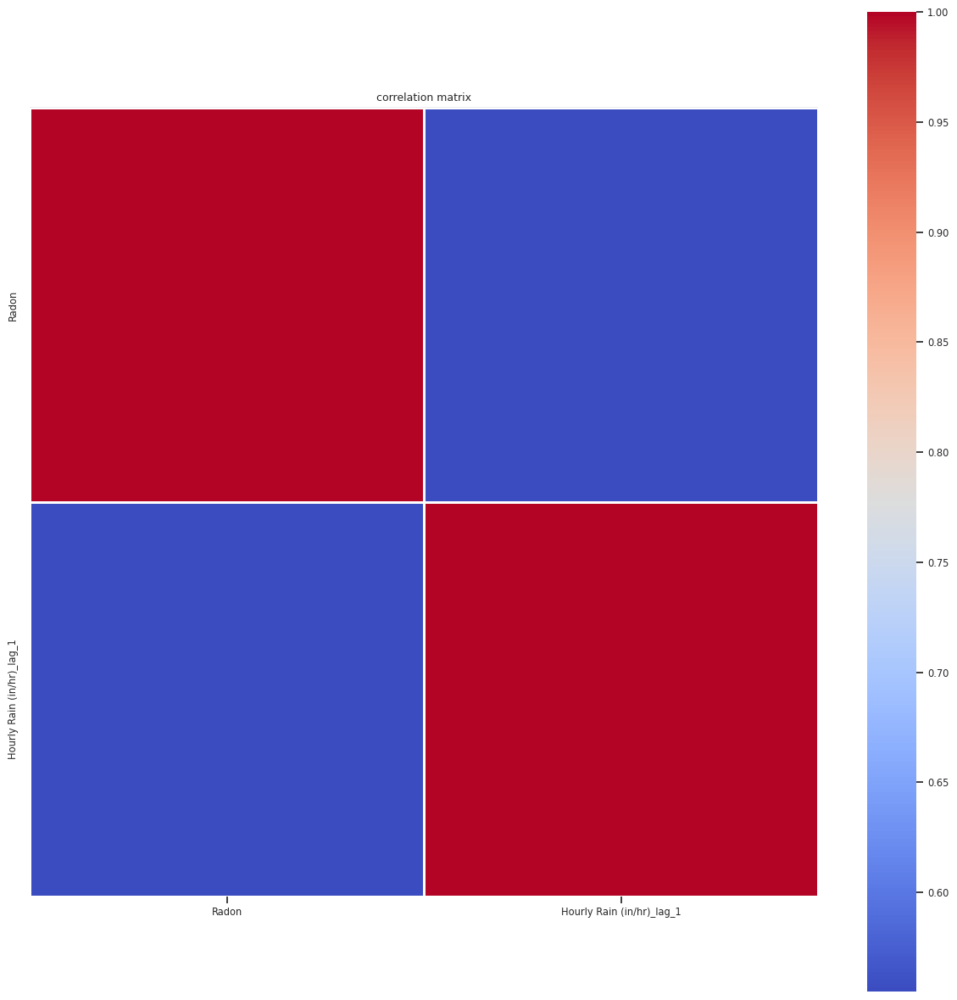

In [29]:
# correlation matrix, limited to highly correlated features
df3 = df[df_corrH.index]

idx = df3.corr().sort_values("Radon", ascending=False).index
df3_sorted = df3.loc[:, idx]  # sort dataframe columns by their correlation with Appliances

plt.figure(figsize = (15,15))
sns.set(font_scale=0.75)
ax = sns.heatmap(df3_sorted.corr().round(3), 
            annot=False, 
            square=True, 
            linewidths=.75, cmap="coolwarm", 
            fmt = ".2f", 
            annot_kws = {"size": 11})
ax.xaxis.tick_bottom()
plt.title("correlation matrix")
plt.show()

In [30]:
df3 = df[df_corrH.index]
df3.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 93 entries, 2022-11-10 to 2023-02-10
Freq: D
Data columns (total 2 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Radon                      93 non-null     float32
 1   Hourly Rain (in/hr)_lag_1  93 non-null     float32
dtypes: float32(2)
memory usage: 1.5 KB


In [31]:
df3.fillna(0, inplace=True)

In [32]:
df3.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 93 entries, 2022-11-10 to 2023-02-10
Freq: D
Data columns (total 2 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Radon                      93 non-null     float32
 1   Hourly Rain (in/hr)_lag_1  93 non-null     float32
dtypes: float32(2)
memory usage: 1.5 KB


In [33]:
# create time series object for target variable
ts_P = TimeSeries.from_series(df3["Radon"], fill_missing_dates=True, freq="D") 

# check attributes of the time series
print("components:", ts_P.components)
print("duration:",ts_P.duration)
print("frequency:",ts_P.freq)
print("frequency:",ts_P.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_P.has_datetime_index)
print("deterministic:",ts_P.is_deterministic)
print("univariate:",ts_P.is_univariate)

components: Index(['Radon'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [34]:
# create time series object for the feature columns
df_covF = df3.loc[:, df3.columns != "Radon"]
ts_covF = TimeSeries.from_dataframe(df_covF, fill_missing_dates=True, freq="D")

# check attributes of the time series
print("components (columns) of feature time series:", ts_covF.components)
print("duration:",ts_covF.duration)
print("frequency:",ts_covF.freq)
print("frequency:",ts_covF.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_covF.has_datetime_index)
print("deterministic:",ts_covF.is_deterministic)
print("univariate:",ts_covF.is_univariate)

components (columns) of feature time series: Index(['Hourly Rain (in/hr)_lag_1'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [35]:
# example: operating with time series objects:
# we can also create a 3-dimensional numpy array from a time series object
# 3 dimensions: time (rows) / components (columns) / samples
ar_covF = ts_covF.all_values()
print(type(ar_covF))
ar_covF.shape

<class 'numpy.ndarray'>


(93, 1, 1)

In [36]:
# example: operating with time series objects:
# we can also create a pandas series or dataframe from a time series object
df_covF = ts_covF.pd_dataframe()
type(df_covF)

pandas.core.frame.DataFrame

In [37]:

# train/test split and scaling of target variable
ts_train, ts_test = ts_P.split_after(split_point=0.8)
print("training start:", ts_train.start_time())
print("training end:", ts_train.end_time())
print("training duration:",ts_train.duration)
print("test start:", ts_test.start_time())
print("test end:", ts_test.end_time())
print("test duration:", ts_test.duration)


scalerP = Scaler()
scalerP.fit_transform(ts_train)
ts_ttrain = scalerP.transform(ts_train)
ts_ttest = scalerP.transform(ts_test)    
ts_t = scalerP.transform(ts_P)

# make sure data are of type float
ts_t = ts_t.astype(np.float32)
ts_ttrain = ts_ttrain.astype(np.float32)
ts_ttest = ts_ttest.astype(np.float32)

print("first and last row of scaled Radon time series:")
pd.options.display.float_format = '{:,.2f}'.format
ts_t.pd_dataframe().iloc[[0,-1]]

training start: 2022-11-10 00:00:00
training end: 2023-01-22 00:00:00
training duration: 73 days 00:00:00
test start: 2023-01-23 00:00:00
test end: 2023-02-10 00:00:00
test duration: 18 days 00:00:00
first and last row of scaled Radon time series:


component,Radon
SyncDate,
2022-11-10,0.33
2023-02-10,0.08


In [38]:
# train/test split and scaling of feature covariates
covF_train, covF_test = ts_covF.split_after(split_point=0.8)

scalerF = Scaler()
scalerF.fit_transform(covF_train)
covF_ttrain = scalerF.transform(covF_train) 
covF_ttest = scalerF.transform(covF_test)   
covF_t = scalerF.transform(ts_covF)  

# make sure data are of type float
covF_ttrain = covF_ttrain.astype(np.float32)
covF_ttest = covF_ttest.astype(np.float32)

pd.options.display.float_format = '{:.2f}'.format
print("first and last row of scaled feature covariates:")
covF_t.pd_dataframe().iloc[[0,-1]]

first and last row of scaled feature covariates:


component,Hourly Rain (in/hr)_lag_1
SyncDate,
2022-11-10,0.00
2023-02-10,0.07


In [39]:

print("first and last row of scaled target variable in training set: price:")
ts_ttrain.pd_dataframe().iloc[[0,-1]]

first and last row of scaled target variable in training set: price:


component,Radon
SyncDate,
2022-11-10,0.33
2023-01-22,0.42


In [40]:
# model = TFTModel(   input_chunk_length=INLEN,
#                     output_chunk_length=N_FC,
#                     hidden_size=HIDDEN,
#                     lstm_layers=LSTMLAYERS,
#                     num_attention_heads=ATTH,
#                     dropout=DROPOUT,
#                     batch_size=BATCH,
#                     n_epochs=EPOCHS,                        
#                     nr_epochs_val_period=VALWAIT, 
#                     likelihood=QuantileRegression(QUANTILES), 
#                     optimizer_kwargs={"lr": LEARN}, 
#                     model_name="TFT_EnergyES",
#                     log_tensorboard=False,
#                     random_state=RAND,
#                     force_reset=True,
#                     save_checkpoints=True,
#                     pl_trainer_kwargs={"callbacks": [EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.05,
#         mode='min',
#     )]}
#                 )

In [41]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)

In [73]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model_return(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=2000
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)
    return model

In [43]:
from ray import tune
from ray.tune import CLIReporter
from ray.tune.integration.pytorch_lightning import TuneReportCallback
from ray.tune.schedulers import ASHAScheduler, AsyncHyperBandScheduler
from ray.tune.search.optuna import OptunaSearch
tune_callback = TuneReportCallback(
    {
        "loss":"val_loss",
        "sMAPE": "val_SymmetricMeanAbsolutePercentageError",
    },
    on="validation_end",
)

early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )

#define the hyperparameter search space
config = {
    "in_len": tune.choice([4,8,16,32,64]),
    "out_len":tune.randint(1,4),
    "lstm_layers":tune.randint(1,4),
    "num_attention_heads":tune.randint(1,12),
    "dropout":tune.uniform(0.1,0.5),
    "lr":tune.loguniform(1e-5,1e-1),
    "include_hour":tune.choice([True,False]),
}

reporter = CLIReporter(
    parameter_columns=list(config.keys()),
    metric_columns=["loss", "sMAPE", "training_iteration"])
resources_per_trial = {"cpu": 8, "gpu": 1}

num_samples = 500

algo = OptunaSearch()

scheduler = AsyncHyperBandScheduler(max_t=1000, grace_period=10, reduction_factor=2)

train_fn_with_parameters = tune.with_parameters(build_fit_tft_model, callbacks=[early_stopper,tune_callback])

analysis = tune.run(
    train_fn_with_parameters,
    resources_per_trial=resources_per_trial,
    metric="sMAPE",
    mode="min",
    config=config,
    num_samples=num_samples,
    search_alg=algo,
    scheduler = scheduler,
    progress_reporter=reporter,
    name="tft_tune",

)

print("Best hyperparameters found were: ", analysis.best_config)

== Status ==
Current time: 2023-02-22 23:11:09 (running for 00:00:00.20)
Memory usage on this node: 8.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 1/500 (1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   lstm_layers |   num_attention_heads |   dropout |         lr | include_hour   |
|------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-----------

(build_fit_tft_model pid=1030124) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1030124)   rank_zero_deprecation(
(build_fit_tft_model pid=1030124) Auto select gpus: [0]
(build_fit_tft_model pid=1030124) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1030124) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1030124) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1030124) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1030124) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1030124) 
(build_fit_tft_model pid=1030124)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1030124) ---------------

Trial name,date,done,episodes_total,experiment_id,hostname,iterations_since_restore,loss,node_ip,pid,sMAPE,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
build_fit_tft_model_005faf83,2023-02-23_00-26-47,True,,d04940d5e8a54dc38407d33c85df43f6,ip-172-31-10-87,10,0.281782,172.31.10.87,1129469,1.61542,7.62342,0.234362,7.62342,1677112007,0,,10,005faf83,0.00536966
build_fit_tft_model_008d9e0a,2023-02-23_00-43-10,True,,0fa1889f46c549f0a5198decc452a01d,ip-172-31-10-87,10,0.413905,172.31.10.87,1150397,1.68261,7.45211,0.29061,7.45211,1677112990,0,,10,008d9e0a,0.00675035
build_fit_tft_model_012b04ee,2023-02-23_00-43-29,True,,c9d06c8d8815479885242c11c5cae9d1,ip-172-31-10-87,10,0.515161,172.31.10.87,1150830,1.75592,7.53103,0.242588,7.53103,1677113009,0,,10,012b04ee,0.00693464
build_fit_tft_model_01c11474,2023-02-22_23-37-16,True,,d2d4dc92152a4697bece1ece5ceaaaf2,ip-172-31-10-87,73,0.17192,172.31.10.87,1064836,1.48233,21.2826,0.245921,21.2826,1677109036,0,,73,01c11474,0.00653601
build_fit_tft_model_022876b8,2023-02-23_01-13-16,True,,e176f8e841984331a67b8367060b4afd,ip-172-31-10-87,10,0.401973,172.31.10.87,1188393,1.75152,7.59903,0.232592,7.59903,1677114796,0,,10,022876b8,0.00813818
build_fit_tft_model_029433a8,2023-02-22_23-25-09,True,,44018210928548ed96036f2832401364,ip-172-31-10-87,10,0.298628,172.31.10.87,1048761,1.61312,8.1784,0.364177,8.1784,1677108309,0,,10,029433a8,0.0109377
build_fit_tft_model_049e7dc7,2023-02-23_01-44-28,True,,eddbcce63c3d4146a3cec3283eb6c2de,ip-172-31-10-87,10,0.242292,172.31.10.87,1228031,1.64371,9.36344,0.283439,9.36344,1677116668,0,,10,049e7dc7,0.00822735
build_fit_tft_model_0540d66b,2023-02-23_01-48-03,True,,aeb96a175c2243199f51138557dfc584,ip-172-31-10-87,10,0.993659,172.31.10.87,1232803,1.75852,8.60166,0.23379,8.60166,1677116883,0,,10,0540d66b,0.00846004
build_fit_tft_model_05928c8f,2023-02-23_01-41-31,True,,4aad9ad5f3a242d28b0b65b37c3dd002,ip-172-31-10-87,40,0.168847,172.31.10.87,1224115,1.43796,12.763,0.180286,12.763,1677116491,0,,40,05928c8f,0.00602126
build_fit_tft_model_06005600,2023-02-23_02-04-17,True,,cbc9fa4bbf37427f89528e61044acc6f,ip-172-31-10-87,20,0.147717,172.31.10.87,1255937,1.465,14.2635,0.245732,14.2635,1677117857,0,,20,06005600,0.00711799


== Status ==
Current time: 2023-02-22 23:11:24 (running for 00:00:14.86)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 4e5635b7 with sMAPE=1.7573986053466797 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 8, 'dropout': 0.11711354351554966, 'lr': 0.002427412012306509, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 PENDING, 1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+---------+----------------------+
| Trial name                   | statu

(build_fit_tft_model pid=1030517) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1030517)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1030517) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1030517)   rank_zero_deprecation(
(build_fit_tft_model pid=1030517) Auto select gpus: [0]
(build_fit_tft_model pid=1030517) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1030517) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1030517) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1030517) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:11:46 (running for 00:00:36.86)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.476340651512146 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 4e5635b7 with sMAPE=1.4014424085617065 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 8, 'dropout': 0.11711354351554966, 'lr': 0.002427412012306509, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 3/500 (1 PENDING, 1 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+---

(build_fit_tft_model pid=1030517) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1030517) 
(build_fit_tft_model pid=1030517)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1030517) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1030517) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1030517) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1030517) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1030517) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1030517) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1030517) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:11:51 (running for 00:00:41.88)
Memory usage on this node: 10.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.476340651512146 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.605638027191162
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 4e5635b7 with sMAPE=1.4014424085617065 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 8, 'dropout': 0.11711354351554966, 'lr': 0.002427412012306509, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 3/500 (1 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-------------

(build_fit_tft_model pid=1031537) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1031537)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1031537) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1031537)   rank_zero_deprecation(
(build_fit_tft_model pid=1031537) Auto select gpus: [0]
(build_fit_tft_model pid=1031537) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1031537) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1031537) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1031537) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:12:06 (running for 00:00:57.49)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.476340651512146 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.605638027191162
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 4e5635b7 with sMAPE=1.4014424085617065 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 8, 'dropout': 0.11711354351554966, 'lr': 0.002427412012306509, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 4/500 (1 PENDING, 1 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

(build_fit_tft_model pid=1031895) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1031895)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1031895) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1031895)   rank_zero_deprecation(
(build_fit_tft_model pid=1031895) Auto select gpus: [0]
(build_fit_tft_model pid=1031895) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1031895) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1031895) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1031895) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:12:25 (running for 00:01:15.88)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.476340651512146 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.6537517309188843
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 4e5635b7 with sMAPE=1.4014424085617065 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 8, 'dropout': 0.11711354351554966, 'lr': 0.002427412012306509, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 5/500 (1 PENDING, 1 RUNNING, 3 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1033062) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1033062)   rank_zero_deprecation(
(build_fit_tft_model pid=1033062) Auto select gpus: [0]
(build_fit_tft_model pid=1033062) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1033062) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1033062) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1033062) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1033062) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1033062) 
(build_fit_tft_model pid=1033062)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1033062) ---------------

== Status ==
Current time: 2023-02-22 23:12:49 (running for 00:01:40.68)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.476340651512146 | Iter 20.000: -1.5056378245353699 | Iter 10.000: -1.605638027191162
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 4e5635b7 with sMAPE=1.4014424085617065 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 8, 'dropout': 0.11711354351554966, 'lr': 0.002427412012306509, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 6/500 (1 PENDING, 1 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

== Status ==
Current time: 2023-02-22 23:13:05 (running for 00:01:56.19)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.376194715499878 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 6/500 (1 PENDING, 1 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-------

(build_fit_tft_model pid=1033601) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1033601)   rank_zero_deprecation(
(build_fit_tft_model pid=1033601) Auto select gpus: [0]
(build_fit_tft_model pid=1033601) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1033601) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1033601) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1033601) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:13:23 (running for 00:02:14.20)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 7/500 (1 PENDING, 1 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+------

(build_fit_tft_model pid=1033601) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1033601) 
(build_fit_tft_model pid=1033601)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1033601) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1033601) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1033601) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1033601) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1033601) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1033601) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1033601) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:13:33 (running for 00:02:23.92)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=4
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 8/500 (1 PENDING, 1 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+----

(build_fit_tft_model pid=1034007) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1034007)   rank_zero_deprecation(
(build_fit_tft_model pid=1034007) Auto select gpus: [0]
(build_fit_tft_model pid=1034007) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1034007) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1034007) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1034007) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1034007) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1034007) 
(build_fit_tft_model pid=1034007)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1034007) ---------------

== Status ==
Current time: 2023-02-22 23:13:43 (running for 00:02:34.45)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=4
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 8/500 (1 PENDING, 1 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+----

(build_fit_tft_model pid=1034441) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1034441)   rank_zero_deprecation(
(build_fit_tft_model pid=1034441) Auto select gpus: [0]
(build_fit_tft_model pid=1034441) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1034441) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1034441) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1034441) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1034441) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1034441) 
(build_fit_tft_model pid=1034441)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1034441) ---------------

== Status ==
Current time: 2023-02-22 23:14:03 (running for 00:02:54.30)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 9/500 (1 PENDING, 1 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+----

(build_fit_tft_model pid=1034871) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1034871)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1034871) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1034871)   rank_zero_deprecation(
(build_fit_tft_model pid=1034871) Auto select gpus: [0]
(build_fit_tft_model pid=1034871) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1034871) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1034871) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1034871) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:14:21 (running for 00:03:12.64)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5828882455825806
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 10/500 (1 PENDING, 1 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+---

(build_fit_tft_model pid=1035339) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1035339)   rank_zero_deprecation(
(build_fit_tft_model pid=1035339) Auto select gpus: [0]
(build_fit_tft_model pid=1035339) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1035339) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1035339) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1035339) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1035339) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1035339) 
(build_fit_tft_model pid=1035339)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1035339) ---------------

== Status ==
Current time: 2023-02-22 23:14:40 (running for 00:03:31.31)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.6073384284973145
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 11/500 (1 PENDING, 1 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+---

(build_fit_tft_model pid=1035729) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1035729)   rank_zero_deprecation(
(build_fit_tft_model pid=1035729) Auto select gpus: [0]
(build_fit_tft_model pid=1035729) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1035729) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1035729) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1035729) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1035729) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1035729) 
(build_fit_tft_model pid=1035729)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1035729) ---------------

== Status ==
Current time: 2023-02-22 23:15:00 (running for 00:03:50.90)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.608173131942749
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 12/500 (1 PENDING, 1 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+---

(build_fit_tft_model pid=1036235) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1036235)   rank_zero_deprecation(
(build_fit_tft_model pid=1036235) Auto select gpus: [0]
(build_fit_tft_model pid=1036235) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1036235) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1036235) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1036235) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1036235) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1036235) 
(build_fit_tft_model pid=1036235)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1036235) ---------------

== Status ==
Current time: 2023-02-22 23:15:20 (running for 00:04:11.03)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.6090078353881836
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 13/500 (1 PENDING, 1 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

(build_fit_tft_model pid=1036724) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1036724)   rank_zero_deprecation(
(build_fit_tft_model pid=1036724) Auto select gpus: [0]
(build_fit_tft_model pid=1036724) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1036724) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1036724) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1036724) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1036724) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1036724) 
(build_fit_tft_model pid=1036724)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1036724) ---------------

== Status ==
Current time: 2023-02-22 23:15:40 (running for 00:04:30.90)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.631379783153534
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 14/500 (1 PENDING, 1 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

(build_fit_tft_model pid=1037164) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1037164)   rank_zero_deprecation(
(build_fit_tft_model pid=1037164) Auto select gpus: [0]
(build_fit_tft_model pid=1037164) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1037164) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1037164) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1037164) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1037164) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1037164) 
(build_fit_tft_model pid=1037164)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1037164) ---------------

== Status ==
Current time: 2023-02-22 23:16:00 (running for 00:04:50.83)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=11
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.6437983512878418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1037569) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1037569)   rank_zero_deprecation(
(build_fit_tft_model pid=1037569) Auto select gpus: [0]
(build_fit_tft_model pid=1037569) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1037569) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1037569) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1037569) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1037569) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1037569) 
(build_fit_tft_model pid=1037569)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1037569) ---------------

== Status ==
Current time: 2023-02-22 23:16:16 (running for 00:05:07.33)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.648775041103363
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 16/500 (1 PENDING, 1 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

(build_fit_tft_model pid=1038007) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1038007)   rank_zero_deprecation(
(build_fit_tft_model pid=1038007) Auto select gpus: [0]
(build_fit_tft_model pid=1038007) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1038007) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1038007) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1038007) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1038007) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1038007) 
(build_fit_tft_model pid=1038007)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1038007) ---------------

== Status ==
Current time: 2023-02-22 23:16:36 (running for 00:05:26.88)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.6537517309188843
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

== Status ==
Current time: 2023-02-22 23:16:47 (running for 00:05:38.03)
Memory usage on this node: 9.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5056378245353699 | Iter 10.000: -1.648775041103363
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+---

(build_fit_tft_model pid=1038440) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1038440)   rank_zero_deprecation(
(build_fit_tft_model pid=1038440) Auto select gpus: [0]
(build_fit_tft_model pid=1038440) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1038440) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1038440) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1038440) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1038440) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1038440) 
(build_fit_tft_model pid=1038440)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1038440) ---------------

== Status ==
Current time: 2023-02-22 23:16:57 (running for 00:05:48.58)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5056378245353699 | Iter 10.000: -1.648775041103363
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

== Status ==
Current time: 2023-02-22 23:17:08 (running for 00:05:58.86)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.6437983512878418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1039128) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1039128)   rank_zero_deprecation(
(build_fit_tft_model pid=1039128) Auto select gpus: [0]
(build_fit_tft_model pid=1039128) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1039128) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1039128) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1039128) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1039128) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1039128) 
(build_fit_tft_model pid=1039128)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1039128) ---------------

== Status ==
Current time: 2023-02-22 23:17:27 (running for 00:06:18.00)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=15
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.476340651512146 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.6437983512878418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 19/500 (1 PENDING, 1 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

== Status ==
Current time: 2023-02-22 23:17:37 (running for 00:06:28.09)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=15
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.476340651512146 | Iter 20.000: -1.462779700756073 | Iter 10.000: -1.6429653763771057
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 19/500 (1 PENDING, 1 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

== Status ==
Current time: 2023-02-22 23:17:52 (running for 00:06:43.05)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=15
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.462779700756073 | Iter 10.000: -1.6429653763771057
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 20/500 (1 PENDING, 1 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

(build_fit_tft_model pid=1039859) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1039859)   rank_zero_deprecation(
(build_fit_tft_model pid=1039859) Auto select gpus: [0]
(build_fit_tft_model pid=1039859) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1039859) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1039859) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1039859) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1039859) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1039859) 
(build_fit_tft_model pid=1039859)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1039859) ---------------

== Status ==
Current time: 2023-02-22 23:18:02 (running for 00:06:52.96)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=15
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.462779700756073 | Iter 10.000: -1.6429653763771057
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 20/500 (1 PENDING, 1 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

== Status ==
Current time: 2023-02-22 23:18:13 (running for 00:07:04.05)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.6421324014663696
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1040271) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1040271)   rank_zero_deprecation(
(build_fit_tft_model pid=1040271) Auto select gpus: [0]
(build_fit_tft_model pid=1040271) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1040271) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1040271) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1040271) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1040271) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1040271) 
(build_fit_tft_model pid=1040271)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1040271) ---------------

== Status ==
Current time: 2023-02-22 23:18:24 (running for 00:07:14.93)
Memory usage on this node: 10.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.6421324014663696
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

== Status ==
Current time: 2023-02-22 23:18:34 (running for 00:07:25.31)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.488941252231598 | Iter 10.000: -1.6255701184272766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

(build_fit_tft_model pid=1040927) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1040927)   rank_zero_deprecation(
(build_fit_tft_model pid=1040927) Auto select gpus: [0]
(build_fit_tft_model pid=1040927) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1040927) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1040927) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1040927) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1040927) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1040927) 
(build_fit_tft_model pid=1040927)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1040927) ---------------

== Status ==
Current time: 2023-02-22 23:18:56 (running for 00:07:47.21)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.476340651512146 | Iter 20.000: -1.488941252231598 | Iter 10.000: -1.6255701184272766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 22/500 (1 PENDING, 1 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

== Status ==
Current time: 2023-02-22 23:19:09 (running for 00:08:00.06)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.476340651512146 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.6090078353881836
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 23/500 (1 PENDING, 1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1041433) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1041433)   rank_zero_deprecation(
(build_fit_tft_model pid=1041433) Auto select gpus: [0]
(build_fit_tft_model pid=1041433) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1041433) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1041433) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1041433) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1041433) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1041433) 
(build_fit_tft_model pid=1041433)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1041433) ---------------

== Status ==
Current time: 2023-02-22 23:19:21 (running for 00:08:12.75)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.476340651512146 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.6090078353881836
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 23/500 (1 PENDING, 1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

== Status ==
Current time: 2023-02-22 23:19:35 (running for 00:08:26.09)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.476340651512146 | Iter 20.000: -1.5056378245353699 | Iter 10.000: -1.608173131942749
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 1 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

(build_fit_tft_model pid=1041992) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1041992)   rank_zero_deprecation(
(build_fit_tft_model pid=1041992) Auto select gpus: [0]
(build_fit_tft_model pid=1041992) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1041992) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1041992) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1041992) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1041992) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1041992) 
(build_fit_tft_model pid=1041992)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1041992) ---------------

== Status ==
Current time: 2023-02-22 23:19:45 (running for 00:08:36.29)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.476340651512146 | Iter 20.000: -1.5056378245353699 | Iter 10.000: -1.608173131942749
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 1 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

(build_fit_tft_model pid=1042448) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1042448)   rank_zero_deprecation(
(build_fit_tft_model pid=1042448) Auto select gpus: [0]
(build_fit_tft_model pid=1042448) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1042448) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1042448) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1042448) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1042448) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1042448) 
(build_fit_tft_model pid=1042448)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1042448) ---------------

== Status ==
Current time: 2023-02-22 23:20:07 (running for 00:08:58.02)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.476340651512146 | Iter 20.000: -1.5063581466674805 | Iter 10.000: -1.6073384284973145
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 25/500 (1 PENDING, 1 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1042809) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1042809)   rank_zero_deprecation(
(build_fit_tft_model pid=1042809) Auto select gpus: [0]
(build_fit_tft_model pid=1042809) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1042809) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1042809) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1042809) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1042809) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1042809) 
(build_fit_tft_model pid=1042809)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1042809) ---------------

== Status ==
Current time: 2023-02-22 23:20:25 (running for 00:09:15.86)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.476340651512146 | Iter 20.000: -1.5063581466674805 | Iter 10.000: -1.608173131942749
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 82d46031 with sMAPE=1.3305531740188599 and parameters={'in_len': 16, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.3265049660123379, 'lr': 0.04742465729596355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 26/500 (1 PENDING, 1 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

== Status ==
Current time: 2023-02-22 23:20:35 (running for 00:09:26.05)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5062006115913391 | Iter 10.000: -1.6073384284973145
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e07afe4b with sMAPE=1.3262566328048706 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.1354326971560757, 'lr': 0.004462439692820036, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 26/500 (1 PENDING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-------------

(build_fit_tft_model pid=1043317) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1043317)   rank_zero_deprecation(
(build_fit_tft_model pid=1043317) Auto select gpus: [0]
(build_fit_tft_model pid=1043317) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1043317) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1043317) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1043317) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1043317) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1043317) 
(build_fit_tft_model pid=1043317)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1043317) ---------------

== Status ==
Current time: 2023-02-22 23:20:51 (running for 00:09:42.75)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.424202799797058 | Iter 20.000: -1.5062006115913391 | Iter 10.000: -1.6073384284973145
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e07afe4b with sMAPE=1.3262566328048706 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.1354326971560757, 'lr': 0.004462439692820036, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 27/500 (1 PENDING, 1 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:21:05 (running for 00:09:56.10)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.476340651512146 | Iter 20.000: -1.5060430765151978 | Iter 10.000: -1.5929152965545654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e07afe4b with sMAPE=1.3262566328048706 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.1354326971560757, 'lr': 0.004462439692820036, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 28/500 (1 PENDING, 1 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1043932) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1043932)   rank_zero_deprecation(
(build_fit_tft_model pid=1043932) Auto select gpus: [0]
(build_fit_tft_model pid=1043932) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1043932) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1043932) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1043932) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1043932) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1043932) 
(build_fit_tft_model pid=1043932)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1043932) ---------------

== Status ==
Current time: 2023-02-22 23:21:15 (running for 00:10:06.39)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.476340651512146 | Iter 20.000: -1.5060430765151978 | Iter 10.000: -1.5929152965545654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e07afe4b with sMAPE=1.3262566328048706 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.1354326971560757, 'lr': 0.004462439692820036, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 28/500 (1 PENDING, 1 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:21:25 (running for 00:10:16.61)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.476340651512146 | Iter 20.000: -1.5054802894592285 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e07afe4b with sMAPE=1.3262566328048706 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.1354326971560757, 'lr': 0.004462439692820036, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 28/500 (1 PENDING, 1 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:21:39 (running for 00:10:30.11)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4489875435829163 | Iter 20.000: -1.5054802894592285 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e07afe4b with sMAPE=1.3262566328048706 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.1354326971560757, 'lr': 0.004462439692820036, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 29/500 (1 PENDING, 1 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1044624) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1044624)   rank_zero_deprecation(
(build_fit_tft_model pid=1044624) Auto select gpus: [0]
(build_fit_tft_model pid=1044624) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1044624) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1044624) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1044624) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1044624) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1044624) 
(build_fit_tft_model pid=1044624)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1044624) ---------------

== Status ==
Current time: 2023-02-22 23:21:50 (running for 00:10:41.11)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4489875435829163 | Iter 20.000: -1.5054802894592285 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e07afe4b with sMAPE=1.3262566328048706 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.1354326971560757, 'lr': 0.004462439692820036, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 29/500 (1 PENDING, 1 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

== Status ==
Current time: 2023-02-22 23:22:00 (running for 00:10:51.29)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4251149892807007 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5684651136398315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.135901689529419 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 29/500 (1 PENDING, 1 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:22:14 (running for 00:11:05.11)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4251149892807007 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5684651136398315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1045348) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1045348)   rank_zero_deprecation(
(build_fit_tft_model pid=1045348) Auto select gpus: [0]
(build_fit_tft_model pid=1045348) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1045348) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1045348) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1045348) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1045348) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1045348) 
(build_fit_tft_model pid=1045348)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1045348) ---------------

== Status ==
Current time: 2023-02-22 23:22:25 (running for 00:11:16.12)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4251149892807007 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5684651136398315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1045865) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1045865)   rank_zero_deprecation(
(build_fit_tft_model pid=1045865) Auto select gpus: [0]
(build_fit_tft_model pid=1045865) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1045865) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1045865) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1045865) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1045865) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1045865) 
(build_fit_tft_model pid=1045865)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1045865) ---------------

== Status ==
Current time: 2023-02-22 23:22:44 (running for 00:11:35.73)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=23
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4251149892807007 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1046219) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1046219)   rank_zero_deprecation(
(build_fit_tft_model pid=1046219) Auto select gpus: [0]
(build_fit_tft_model pid=1046219) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1046219) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1046219) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1046219) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1046219) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1046219) 
(build_fit_tft_model pid=1046219)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1046219) ---------------

== Status ==
Current time: 2023-02-22 23:23:03 (running for 00:11:54.36)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4251149892807007 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5924014449119568
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:23:14 (running for 00:12:05.13)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4251149892807007 | Iter 20.000: -1.5054802894592285 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 33/500 (1 PENDING, 1 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1046719) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1046719)   rank_zero_deprecation(
(build_fit_tft_model pid=1046719) Auto select gpus: [0]
(build_fit_tft_model pid=1046719) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1046719) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1046719) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1046719) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1046719) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1046719) 
(build_fit_tft_model pid=1046719)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1046719) ---------------

== Status ==
Current time: 2023-02-22 23:23:24 (running for 00:12:15.37)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4251149892807007 | Iter 20.000: -1.5054802894592285 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 33/500 (1 PENDING, 1 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1047172) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1047172)   rank_zero_deprecation(
(build_fit_tft_model pid=1047172) Auto select gpus: [0]
(build_fit_tft_model pid=1047172) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1047172) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1047172) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1047172) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1047172) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1047172) 
(build_fit_tft_model pid=1047172)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1047172) ---------------

== Status ==
Current time: 2023-02-22 23:23:44 (running for 00:12:35.56)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4251149892807007 | Iter 20.000: -1.5060430765151978 | Iter 10.000: -1.5684651136398315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 34/500 (1 PENDING, 1 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:23:54 (running for 00:12:45.77)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250884652137756 | Iter 20.000: -1.5054802894592285 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 34/500 (1 PENDING, 1 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1047616) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1047616)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1047616) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1047616)   rank_zero_deprecation(
(build_fit_tft_model pid=1047616) Auto select gpus: [0]
(build_fit_tft_model pid=1047616) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1047616) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1047616) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1047616) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:24:13 (running for 00:13:03.89)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250884652137756 | Iter 20.000: -1.5054802894592285 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:24:26 (running for 00:13:17.15)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250884652137756 | Iter 20.000: -1.5060430765151978 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1048161) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1048161)   rank_zero_deprecation(
(build_fit_tft_model pid=1048161) Auto select gpus: [0]
(build_fit_tft_model pid=1048161) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1048161) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1048161) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1048161) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1048161) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1048161) 
(build_fit_tft_model pid=1048161)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1048161) ---------------

== Status ==
Current time: 2023-02-22 23:24:37 (running for 00:13:28.19)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250884652137756 | Iter 20.000: -1.5060430765151978 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:24:47 (running for 00:13:38.43)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250619411468506 | Iter 20.000: -1.5054802894592285 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1048761) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1048761)   rank_zero_deprecation(
(build_fit_tft_model pid=1048761) Auto select gpus: [0]
(build_fit_tft_model pid=1048761) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1048761) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1048761) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1048761) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1048761) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1048761) 
(build_fit_tft_model pid=1048761)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1048761) ---------------

== Status ==
Current time: 2023-02-22 23:25:05 (running for 00:13:56.78)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250619411468506 | Iter 20.000: -1.5054802894592285 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 37/500 (1 PENDING, 1 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1049212) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1049212)   rank_zero_deprecation(
(build_fit_tft_model pid=1049212) Auto select gpus: [0]
(build_fit_tft_model pid=1049212) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1049212) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1049212) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1049212) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1049212) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1049212) 
(build_fit_tft_model pid=1049212)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1049212) ---------------

== Status ==
Current time: 2023-02-22 23:25:25 (running for 00:14:15.92)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250619411468506 | Iter 20.000: -1.5054802894592285 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 PENDING, 1 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1049619) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1049619)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1049619) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1049619)   rank_zero_deprecation(
(build_fit_tft_model pid=1049619) Auto select gpus: [0]
(build_fit_tft_model pid=1049619) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1049619) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1049619) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1049619) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:25:44 (running for 00:14:35.64)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250619411468506 | Iter 20.000: -1.5054802894592285 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 PENDING, 1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:25:55 (running for 00:14:46.12)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250619411468506 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 PENDING, 1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:26:06 (running for 00:14:57.09)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4233481884002686 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+---------

(build_fit_tft_model pid=1050297) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1050297)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1050297) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1050297)   rank_zero_deprecation(
(build_fit_tft_model pid=1050297) Auto select gpus: [0]
(build_fit_tft_model pid=1050297) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1050297) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1050297) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1050297) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:26:21 (running for 00:15:12.80)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4233481884002686 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:26:34 (running for 00:15:25.19)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4233481884002686 | Iter 20.000: -1.5054802894592285 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 41/500 (1 PENDING, 1 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1050804) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1050804)   rank_zero_deprecation(
(build_fit_tft_model pid=1050804) Auto select gpus: [0]
(build_fit_tft_model pid=1050804) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1050804) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1050804) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1050804) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1050804) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1050804) 
(build_fit_tft_model pid=1050804)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1050804) ---------------

== Status ==
Current time: 2023-02-22 23:26:44 (running for 00:15:35.64)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4233481884002686 | Iter 20.000: -1.5054802894592285 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 41/500 (1 PENDING, 1 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1051215) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1051215)   rank_zero_deprecation(
(build_fit_tft_model pid=1051215) Auto select gpus: [0]
(build_fit_tft_model pid=1051215) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1051215) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1051215) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1051215) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1051215) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1051215) 
(build_fit_tft_model pid=1051215)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1051215) ---------------

== Status ==
Current time: 2023-02-22 23:27:03 (running for 00:15:54.64)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4233481884002686 | Iter 20.000: -1.5054802894592285 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 42/500 (1 PENDING, 1 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1051702) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1051702)   rank_zero_deprecation(
(build_fit_tft_model pid=1051702) Auto select gpus: [0]
(build_fit_tft_model pid=1051702) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1051702) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1051702) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1051702) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1051702) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1051702) 
(build_fit_tft_model pid=1051702)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1051702) ---------------

== Status ==
Current time: 2023-02-22 23:27:23 (running for 00:16:14.03)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4233481884002686 | Iter 20.000: -1.5054802894592285 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 43/500 (1 PENDING, 1 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1052148) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1052148)   rank_zero_deprecation(
(build_fit_tft_model pid=1052148) Auto select gpus: [0]
(build_fit_tft_model pid=1052148) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1052148) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1052148) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1052148) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1052148) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1052148) 
(build_fit_tft_model pid=1052148)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1052148) ---------------

== Status ==
Current time: 2023-02-22 23:27:41 (running for 00:16:32.53)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4233481884002686 | Iter 20.000: -1.5054802894592285 | Iter 10.000: -1.5684651136398315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:27:56 (running for 00:16:47.20)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250619411468506 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1052693) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1052693)   rank_zero_deprecation(
(build_fit_tft_model pid=1052693) Auto select gpus: [0]
(build_fit_tft_model pid=1052693) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1052693) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1052693) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1052693) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:28:07 (running for 00:16:58.11)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250619411468506 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1052693) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1052693) 
(build_fit_tft_model pid=1052693)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1052693) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1052693) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1052693) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1052693) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1052693) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1052693) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1052693) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:28:12 (running for 00:17:03.13)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250619411468506 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5684651136398315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+---------

(build_fit_tft_model pid=1053258) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1053258)   rank_zero_deprecation(
(build_fit_tft_model pid=1053258) Auto select gpus: [0]
(build_fit_tft_model pid=1053258) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1053258) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1053258) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1053258) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1053258) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1053258) 
(build_fit_tft_model pid=1053258)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1053258) ---------------

== Status ==
Current time: 2023-02-22 23:28:28 (running for 00:17:18.98)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250619411468506 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5684651136398315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:28:38 (running for 00:17:29.36)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250619411468506 | Iter 20.000: -1.4910643100738525 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1053795) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1053795)   rank_zero_deprecation(
(build_fit_tft_model pid=1053795) Auto select gpus: [0]
(build_fit_tft_model pid=1053795) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1053795) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1053795) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1053795) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1053795) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1053795) 
(build_fit_tft_model pid=1053795)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1053795) ---------------

== Status ==
Current time: 2023-02-22 23:28:54 (running for 00:17:45.54)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250619411468506 | Iter 20.000: -1.4910643100738525 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1054230) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1054230)   rank_zero_deprecation(
(build_fit_tft_model pid=1054230) Auto select gpus: [0]
(build_fit_tft_model pid=1054230) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1054230) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1054230) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1054230) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1054230) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1054230) 
(build_fit_tft_model pid=1054230)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1054230) ---------------

== Status ==
Current time: 2023-02-22 23:29:13 (running for 00:18:03.90)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=36
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250619411468506 | Iter 20.000: -1.4910643100738525 | Iter 10.000: -1.5684651136398315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1054674) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1054674)   rank_zero_deprecation(
(build_fit_tft_model pid=1054674) Auto select gpus: [0]
(build_fit_tft_model pid=1054674) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1054674) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1054674) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1054674) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1054674) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1054674) 
(build_fit_tft_model pid=1054674)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1054674) ---------------

== Status ==
Current time: 2023-02-22 23:29:34 (running for 00:18:24.88)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250619411468506 | Iter 20.000: -1.4910643100738525 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1055187) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1055187)   rank_zero_deprecation(
(build_fit_tft_model pid=1055187) Auto select gpus: [0]
(build_fit_tft_model pid=1055187) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1055187) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1055187) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1055187) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1055187) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1055187) 
(build_fit_tft_model pid=1055187)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1055187) ---------------

== Status ==
Current time: 2023-02-22 23:29:56 (running for 00:18:46.84)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250619411468506 | Iter 20.000: -1.4910643100738525 | Iter 10.000: -1.5924014449119568
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 50/500 (1 PENDING, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:30:07 (running for 00:18:58.24)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250619411468506 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 51/500 (1 PENDING, 1 RUNNING, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1055729) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1055729)   rank_zero_deprecation(
(build_fit_tft_model pid=1055729) Auto select gpus: [0]
(build_fit_tft_model pid=1055729) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1055729) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1055729) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1055729) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1055729) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1055729) 
(build_fit_tft_model pid=1055729)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1055729) ---------------

== Status ==
Current time: 2023-02-22 23:30:18 (running for 00:19:09.02)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250619411468506 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 51/500 (1 PENDING, 1 RUNNING, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1056203) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1056203)   rank_zero_deprecation(
(build_fit_tft_model pid=1056203) Auto select gpus: [0]
(build_fit_tft_model pid=1056203) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1056203) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1056203) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1056203) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1056203) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1056203) 
(build_fit_tft_model pid=1056203)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1056203) ---------------

== Status ==
Current time: 2023-02-22 23:30:37 (running for 00:19:28.27)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250619411468506 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.582808494567871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 52/500 (1 PENDING, 1 RUNNING, 50 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1056612) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1056612)   rank_zero_deprecation(
(build_fit_tft_model pid=1056612) Auto select gpus: [0]
(build_fit_tft_model pid=1056612) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1056612) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1056612) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1056612) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1056612) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1056612) 
(build_fit_tft_model pid=1056612)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1056612) ---------------

== Status ==
Current time: 2023-02-22 23:30:56 (running for 00:19:46.96)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4250619411468506 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5871248245239258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 53/500 (1 PENDING, 1 RUNNING, 51 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:31:10 (running for 00:20:01.24)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4233481884002686 | Iter 20.000: -1.4910643100738525 | Iter 10.000: -1.582808494567871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1057209) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1057209)   rank_zero_deprecation(
(build_fit_tft_model pid=1057209) Auto select gpus: [0]
(build_fit_tft_model pid=1057209) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1057209) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1057209) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1057209) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1057209) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1057209) 
(build_fit_tft_model pid=1057209)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1057209) ---------------

== Status ==
Current time: 2023-02-22 23:31:21 (running for 00:20:12.06)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4233481884002686 | Iter 20.000: -1.4910643100738525 | Iter 10.000: -1.582808494567871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1057717) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1057717)   rank_zero_deprecation(
(build_fit_tft_model pid=1057717) Auto select gpus: [0]
(build_fit_tft_model pid=1057717) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1057717) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1057717) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1057717) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1057717) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1057717) 
(build_fit_tft_model pid=1057717)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1057717) ---------------

== Status ==
Current time: 2023-02-22 23:31:40 (running for 00:20:31.46)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=42
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4233481884002686 | Iter 20.000: -1.4910643100738525 | Iter 10.000: -1.5871248245239258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 PENDING, 1 RUNNING, 53 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1058088) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1058088)   rank_zero_deprecation(
(build_fit_tft_model pid=1058088) Auto select gpus: [0]
(build_fit_tft_model pid=1058088) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1058088) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1058088) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1058088) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1058088) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1058088) 
(build_fit_tft_model pid=1058088)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1058088) ---------------

== Status ==
Current time: 2023-02-22 23:31:59 (running for 00:20:50.13)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=43
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4233481884002686 | Iter 20.000: -1.4910643100738525 | Iter 10.000: -1.5967177748680115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1058482) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1058482)   rank_zero_deprecation(
(build_fit_tft_model pid=1058482) Auto select gpus: [0]
(build_fit_tft_model pid=1058482) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1058482) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1058482) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1058482) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1058482) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1058482) 
(build_fit_tft_model pid=1058482)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1058482) ---------------

== Status ==
Current time: 2023-02-22 23:32:16 (running for 00:21:07.42)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4233481884002686 | Iter 20.000: -1.4910643100738525 | Iter 10.000: -1.6063107252120972
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 57/500 (1 PENDING, 1 RUNNING, 55 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1058976) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1058976)   rank_zero_deprecation(
(build_fit_tft_model pid=1058976) Auto select gpus: [0]
(build_fit_tft_model pid=1058976) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1058976) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1058976) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1058976) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1058976) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1058976) 
(build_fit_tft_model pid=1058976)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1058976) ---------------

== Status ==
Current time: 2023-02-22 23:32:35 (running for 00:21:26.36)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=45
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4233481884002686 | Iter 20.000: -1.4910643100738525 | Iter 10.000: -1.6068245768547058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 58/500 (1 PENDING, 1 RUNNING, 56 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1059387) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1059387)   rank_zero_deprecation(
(build_fit_tft_model pid=1059387) Auto select gpus: [0]
(build_fit_tft_model pid=1059387) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1059387) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1059387) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1059387) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1059387) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1059387) 
(build_fit_tft_model pid=1059387)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1059387) ---------------

== Status ==
Current time: 2023-02-22 23:32:54 (running for 00:21:45.18)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4233481884002686 | Iter 20.000: -1.4910643100738525 | Iter 10.000: -1.6073384284973145
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 59/500 (1 PENDING, 1 RUNNING, 57 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:33:04 (running for 00:21:55.31)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4216344356536865 | Iter 20.000: -1.4772111177444458 | Iter 10.000: -1.6068245768547058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 59/500 (1 PENDING, 1 RUNNING, 57 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:33:15 (running for 00:22:06.30)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4216344356536865 | Iter 20.000: -1.4772111177444458 | Iter 10.000: -1.6068245768547058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 60/500 (1 PENDING, 1 RUNNING, 58 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1060066) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1060066)   rank_zero_deprecation(
(build_fit_tft_model pid=1060066) Auto select gpus: [0]
(build_fit_tft_model pid=1060066) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1060066) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1060066) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1060066) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1060066) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1060066) 
(build_fit_tft_model pid=1060066)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1060066) ---------------

== Status ==
Current time: 2023-02-22 23:33:26 (running for 00:22:17.69)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4216344356536865 | Iter 20.000: -1.4772111177444458 | Iter 10.000: -1.6068245768547058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 60/500 (1 PENDING, 1 RUNNING, 58 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1060530) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1060530)   rank_zero_deprecation(
(build_fit_tft_model pid=1060530) Auto select gpus: [0]
(build_fit_tft_model pid=1060530) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1060530) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1060530) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1060530) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1060530) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1060530) 
(build_fit_tft_model pid=1060530)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1060530) ---------------

== Status ==
Current time: 2023-02-22 23:33:46 (running for 00:22:37.40)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4216344356536865 | Iter 20.000: -1.4772111177444458 | Iter 10.000: -1.6073384284973145
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 61/500 (1 PENDING, 1 RUNNING, 59 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:33:58 (running for 00:22:49.32)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4216344356536865 | Iter 20.000: -1.4910643100738525 | Iter 10.000: -1.6068245768547058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1061093) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1061093)   rank_zero_deprecation(
(build_fit_tft_model pid=1061093) Auto select gpus: [0]
(build_fit_tft_model pid=1061093) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1061093) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1061093) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1061093) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1061093) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1061093) 
(build_fit_tft_model pid=1061093)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1061093) ---------------

== Status ==
Current time: 2023-02-22 23:34:09 (running for 00:23:00.40)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4216344356536865 | Iter 20.000: -1.4910643100738525 | Iter 10.000: -1.6068245768547058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:34:19 (running for 00:23:10.54)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4216344356536865 | Iter 20.000: -1.4772111177444458 | Iter 10.000: -1.6063107252120972
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1061689) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1061689)   rank_zero_deprecation(
(build_fit_tft_model pid=1061689) Auto select gpus: [0]
(build_fit_tft_model pid=1061689) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1061689) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1061689) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1061689) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1061689) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1061689) 
(build_fit_tft_model pid=1061689)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1061689) ---------------

== Status ==
Current time: 2023-02-22 23:34:38 (running for 00:23:29.16)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4772111177444458 | Iter 10.000: -1.6063107252120972
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 63/500 (1 PENDING, 1 RUNNING, 61 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1062188) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1062188)   rank_zero_deprecation(
(build_fit_tft_model pid=1062188) Auto select gpus: [0]
(build_fit_tft_model pid=1062188) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1062188) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1062188) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1062188) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1062188) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1062188) 
(build_fit_tft_model pid=1062188)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1062188) ---------------

== Status ==
Current time: 2023-02-22 23:34:56 (running for 00:23:47.72)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=49
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4772111177444458 | Iter 10.000: -1.6068245768547058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:35:11 (running for 00:24:02.35)
Memory usage on this node: 10.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=49
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4750880599021912 | Iter 10.000: -1.6063107252120972
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 65/500 (1 PENDING, 1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1062622) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1062622)   rank_zero_deprecation(
(build_fit_tft_model pid=1062622) Auto select gpus: [0]
(build_fit_tft_model pid=1062622) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1062622) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1062622) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1062622) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:35:22 (running for 00:24:12.98)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=49
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4750880599021912 | Iter 10.000: -1.6063107252120972
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 65/500 (1 PENDING, 1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1062622) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1062622) 
(build_fit_tft_model pid=1062622)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1062622) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1062622) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1062622) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1062622) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1062622) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1062622) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1062622) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:35:30 (running for 00:24:21.30)
Memory usage on this node: 9.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4750880599021912 | Iter 10.000: -1.6068245768547058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1063090) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1063090)   rank_zero_deprecation(
(build_fit_tft_model pid=1063090) Auto select gpus: [0]
(build_fit_tft_model pid=1063090) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1063090) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1063090) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1063090) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1063090) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1063090) 
(build_fit_tft_model pid=1063090)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1063090) ---------------

== Status ==
Current time: 2023-02-22 23:35:41 (running for 00:24:32.45)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4750880599021912 | Iter 10.000: -1.6068245768547058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:35:51 (running for 00:24:42.54)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.4729650020599365 | Iter 10.000: -1.6063107252120972
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:36:05 (running for 00:24:56.37)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.4729650020599365 | Iter 10.000: -1.6063107252120972
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1063891) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1063891)   rank_zero_deprecation(
(build_fit_tft_model pid=1063891) Auto select gpus: [0]
(build_fit_tft_model pid=1063891) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1063891) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1063891) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1063891) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1063891) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1063891) 
(build_fit_tft_model pid=1063891)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1063891) ---------------

== Status ==
Current time: 2023-02-22 23:36:16 (running for 00:25:07.58)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.4729650020599365 | Iter 10.000: -1.6063107252120972
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:36:31 (running for 00:25:22.36)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4680786728858948 | Iter 10.000: -1.5967177748680115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1064395) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1064395)   rank_zero_deprecation(
(build_fit_tft_model pid=1064395) Auto select gpus: [0]
(build_fit_tft_model pid=1064395) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1064395) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1064395) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1064395) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1064395) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1064395) 
(build_fit_tft_model pid=1064395)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1064395) ---------------

== Status ==
Current time: 2023-02-22 23:36:42 (running for 00:25:33.06)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4680786728858948 | Iter 10.000: -1.5967177748680115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1064836) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1064836)   rank_zero_deprecation(
(build_fit_tft_model pid=1064836) Auto select gpus: [0]
(build_fit_tft_model pid=1064836) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1064836) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1064836) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1064836) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1064836) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1064836) 
(build_fit_tft_model pid=1064836)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1064836) ---------------

== Status ==
Current time: 2023-02-22 23:37:00 (running for 00:25:51.23)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4680786728858948 | Iter 10.000: -1.6063107252120972
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:37:10 (running for 00:26:01.49)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.5967177748680115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:37:22 (running for 00:26:13.37)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.5967177748680115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 70/500 (1 PENDING, 1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1065515) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1065515)   rank_zero_deprecation(
(build_fit_tft_model pid=1065515) Auto select gpus: [0]
(build_fit_tft_model pid=1065515) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1065515) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1065515) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1065515) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1065515) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1065515) 
(build_fit_tft_model pid=1065515)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1065515) ---------------

== Status ==
Current time: 2023-02-22 23:37:32 (running for 00:26:23.56)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.5967177748680115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 70/500 (1 PENDING, 1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1065995) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1065995)   rank_zero_deprecation(
(build_fit_tft_model pid=1065995) Auto select gpus: [0]
(build_fit_tft_model pid=1065995) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1065995) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1065995) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1065995) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1065995) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1065995) 
(build_fit_tft_model pid=1065995)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1065995) ---------------

== Status ==
Current time: 2023-02-22 23:37:52 (running for 00:26:42.91)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=53
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.6063107252120972
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 71/500 (1 PENDING, 1 RUNNING, 69 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:38:02 (running for 00:26:53.41)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.4680786728858948 | Iter 10.000: -1.6062246561050415
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 72/500 (1 PENDING, 1 RUNNING, 70 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1066403) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1066403)   rank_zero_deprecation(
(build_fit_tft_model pid=1066403) Auto select gpus: [0]
(build_fit_tft_model pid=1066403) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1066403) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1066403) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1066403) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1066403) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1066403) 
(build_fit_tft_model pid=1066403)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1066403) ---------------

== Status ==
Current time: 2023-02-22 23:38:13 (running for 00:27:04.18)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.4680786728858948 | Iter 10.000: -1.6062246561050415
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 72/500 (1 PENDING, 1 RUNNING, 70 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1066858) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1066858)   rank_zero_deprecation(
(build_fit_tft_model pid=1066858) Auto select gpus: [0]
(build_fit_tft_model pid=1066858) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1066858) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1066858) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1066858) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1066858) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1066858) 
(build_fit_tft_model pid=1066858)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1066858) ---------------

== Status ==
Current time: 2023-02-22 23:38:33 (running for 00:27:24.78)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.4729650020599365 | Iter 10.000: -1.6061385869979858
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1067317) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1067317)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1067317) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1067317)   rank_zero_deprecation(
(build_fit_tft_model pid=1067317) Auto select gpus: [0]
(build_fit_tft_model pid=1067317) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1067317) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1067317) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1067317) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:38:55 (running for 00:27:46.23)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.4750880599021912 | Iter 10.000: -1.5966317057609558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:39:05 (running for 00:27:56.56)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=57
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4729650020599365 | Iter 10.000: -1.5871248245239258
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--------------

(build_fit_tft_model pid=1067889) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1067889)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1067889) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1067889)   rank_zero_deprecation(
(build_fit_tft_model pid=1067889) Auto select gpus: [0]
(build_fit_tft_model pid=1067889) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1067889) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1067889) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1067889) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:39:22 (running for 00:28:13.56)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=57
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4729650020599365 | Iter 10.000: -1.5871248245239258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1067889) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1067889) 
(build_fit_tft_model pid=1067889)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1067889) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1067889) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1067889) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1067889) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1067889) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1067889) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1067889) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:39:31 (running for 00:28:22.39)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4729650020599365 | Iter 10.000: -1.59151029586792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1068410) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1068410)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1068410) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1068410)   rank_zero_deprecation(
(build_fit_tft_model pid=1068410) Auto select gpus: [0]
(build_fit_tft_model pid=1068410) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1068410) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1068410) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1068410) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:39:42 (running for 00:28:32.87)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4729650020599365 | Iter 10.000: -1.59151029586792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

== Status ==
Current time: 2023-02-22 23:39:55 (running for 00:28:46.41)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4750880599021912 | Iter 10.000: -1.5871248245239258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1068970) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1068970)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1068970) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1068970)   rank_zero_deprecation(
(build_fit_tft_model pid=1068970) Auto select gpus: [0]
(build_fit_tft_model pid=1068970) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1068970) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1068970) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1068970) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:40:05 (running for 00:28:56.48)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4750880599021912 | Iter 10.000: -1.5871248245239258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1069365) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1069365)   rank_zero_deprecation(
(build_fit_tft_model pid=1069365) Auto select gpus: [0]
(build_fit_tft_model pid=1069365) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1069365) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1069365) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1069365) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1069365) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1069365) 
(build_fit_tft_model pid=1069365)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1069365) ---------------

== Status ==
Current time: 2023-02-22 23:40:25 (running for 00:29:15.95)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4750880599021912 | Iter 10.000: -1.59151029586792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1069812) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1069812)   rank_zero_deprecation(
(build_fit_tft_model pid=1069812) Auto select gpus: [0]
(build_fit_tft_model pid=1069812) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1069812) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1069812) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1069812) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1069812) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1069812) 
(build_fit_tft_model pid=1069812)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1069812) ---------------

== Status ==
Current time: 2023-02-22 23:40:44 (running for 00:29:35.39)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=61
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4750880599021912 | Iter 10.000: -1.595895767211914
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 79/500 (1 PENDING, 1 RUNNING, 77 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

== Status ==
Current time: 2023-02-22 23:40:55 (running for 00:29:46.55)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4772111177444458 | Iter 10.000: -1.59151029586792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1070315) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1070315)   rank_zero_deprecation(
(build_fit_tft_model pid=1070315) Auto select gpus: [0]
(build_fit_tft_model pid=1070315) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1070315) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1070315) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1070315) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1070315) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1070315) 
(build_fit_tft_model pid=1070315)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1070315) ---------------

== Status ==
Current time: 2023-02-22 23:41:08 (running for 00:29:59.15)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4772111177444458 | Iter 10.000: -1.59151029586792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

== Status ==
Current time: 2023-02-22 23:41:18 (running for 00:30:09.33)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.414857268333435 | Iter 20.000: -1.4750880599021912 | Iter 10.000: -1.5871248245239258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1070938) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1070938)   rank_zero_deprecation(
(build_fit_tft_model pid=1070938) Auto select gpus: [0]
(build_fit_tft_model pid=1070938) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1070938) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1070938) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1070938) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:41:36 (running for 00:30:26.85)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.4750880599021912 | Iter 10.000: -1.5871248245239258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 81/500 (1 PENDING, 1 RUNNING, 79 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1070938) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1070938) 
(build_fit_tft_model pid=1070938)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1070938) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1070938) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1070938) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1070938) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1070938) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1070938) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1070938) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:41:41 (running for 00:30:32.07)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.4750880599021912 | Iter 10.000: -1.585019588470459
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 81/500 (1 PENDING, 1 RUNNING, 79 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1071428) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1071428)   rank_zero_deprecation(
(build_fit_tft_model pid=1071428) Auto select gpus: [0]
(build_fit_tft_model pid=1071428) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1071428) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1071428) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1071428) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1071428) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1071428) 
(build_fit_tft_model pid=1071428)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1071428) ---------------

== Status ==
Current time: 2023-02-22 23:41:57 (running for 00:30:48.46)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.4772111177444458 | Iter 10.000: -1.585019588470459
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1071834) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1071834)   rank_zero_deprecation(
(build_fit_tft_model pid=1071834) Auto select gpus: [0]
(build_fit_tft_model pid=1071834) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1071834) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1071834) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1071834) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:42:16 (running for 00:31:07.01)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.4772111177444458 | Iter 10.000: -1.5862010717391968
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1071834) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1071834) 
(build_fit_tft_model pid=1071834)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1071834) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1071834) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1071834) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1071834) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1071834) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1071834) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1071834) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:42:25 (running for 00:31:16.46)
Memory usage on this node: 10.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.4772111177444458 | Iter 10.000: -1.5866629481315613
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1072246) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1072246)   rank_zero_deprecation(
(build_fit_tft_model pid=1072246) Auto select gpus: [0]
(build_fit_tft_model pid=1072246) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1072246) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1072246) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1072246) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1072246) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1072246) 
(build_fit_tft_model pid=1072246)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1072246) ---------------

== Status ==
Current time: 2023-02-22 23:42:36 (running for 00:31:27.57)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.4772111177444458 | Iter 10.000: -1.5866629481315613
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1072719) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1072719)   rank_zero_deprecation(
(build_fit_tft_model pid=1072719) Auto select gpus: [0]
(build_fit_tft_model pid=1072719) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1072719) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1072719) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1072719) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1072719) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1072719) 
(build_fit_tft_model pid=1072719)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1072719) ---------------

== Status ==
Current time: 2023-02-22 23:42:58 (running for 00:31:49.63)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.4910643100738525 | Iter 10.000: -1.5862010717391968
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 85/500 (1 PENDING, 1 RUNNING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1073199) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1073199)   rank_zero_deprecation(
(build_fit_tft_model pid=1073199) Auto select gpus: [0]
(build_fit_tft_model pid=1073199) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1073199) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1073199) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1073199) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1073199) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1073199) 
(build_fit_tft_model pid=1073199)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1073199) ---------------

== Status ==
Current time: 2023-02-22 23:43:20 (running for 00:32:11.20)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.4910643100738525 | Iter 10.000: -1.5866629481315613
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1073646) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1073646)   rank_zero_deprecation(
(build_fit_tft_model pid=1073646) Auto select gpus: [0]
(build_fit_tft_model pid=1073646) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1073646) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1073646) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1073646) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1073646) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1073646) 
(build_fit_tft_model pid=1073646)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1073646) ---------------

== Status ==
Current time: 2023-02-22 23:43:40 (running for 00:32:31.61)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.4910643100738525 | Iter 10.000: -1.5871248245239258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 87/500 (1 PENDING, 1 RUNNING, 85 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1074168) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1074168)   rank_zero_deprecation(
(build_fit_tft_model pid=1074168) Auto select gpus: [0]
(build_fit_tft_model pid=1074168) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1074168) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1074168) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1074168) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1074168) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1074168) 
(build_fit_tft_model pid=1074168)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1074168) ---------------

== Status ==
Current time: 2023-02-22 23:44:01 (running for 00:32:52.42)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.4910643100738525 | Iter 10.000: -1.589878261089325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 88/500 (1 PENDING, 1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1074600) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1074600)   rank_zero_deprecation(
(build_fit_tft_model pid=1074600) Auto select gpus: [0]
(build_fit_tft_model pid=1074600) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1074600) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1074600) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1074600) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1074600) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1074600) 
(build_fit_tft_model pid=1074600)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1074600) ---------------

== Status ==
Current time: 2023-02-22 23:44:22 (running for 00:33:13.27)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4080801010131836 | Iter 20.000: -1.5049175024032593 | Iter 10.000: -1.5871248245239258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:44:32 (running for 00:33:23.44)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.400712490081787 | Iter 20.000: -1.4920877814292908 | Iter 10.000: -1.5866629481315613
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1075187) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1075187)   rank_zero_deprecation(
(build_fit_tft_model pid=1075187) Auto select gpus: [0]
(build_fit_tft_model pid=1075187) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1075187) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1075187) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1075187) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1075187) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1075187) 
(build_fit_tft_model pid=1075187)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1075187) ---------------

== Status ==
Current time: 2023-02-22 23:44:53 (running for 00:33:44.53)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.400712490081787 | Iter 20.000: -1.4920877814292908 | Iter 10.000: -1.5866629481315613
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:45:03 (running for 00:33:54.81)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3933448791503906 | Iter 20.000: -1.4792580604553223 | Iter 10.000: -1.5862010717391968
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1075881) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1075881)   rank_zero_deprecation(
(build_fit_tft_model pid=1075881) Auto select gpus: [0]
(build_fit_tft_model pid=1075881) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1075881) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1075881) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1075881) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1075881) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1075881) 
(build_fit_tft_model pid=1075881)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1075881) ---------------

== Status ==
Current time: 2023-02-22 23:45:24 (running for 00:34:15.64)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3933448791503906 | Iter 20.000: -1.4792580604553223 | Iter 10.000: -1.5862010717391968
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:45:35 (running for 00:34:25.93)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.478234589099884 | Iter 10.000: -1.5845577120780945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:45:47 (running for 00:34:38.55)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.478234589099884 | Iter 10.000: -1.5845577120780945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 92/500 (1 PENDING, 1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1076537) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1076537)   rank_zero_deprecation(
(build_fit_tft_model pid=1076537) Auto select gpus: [0]
(build_fit_tft_model pid=1076537) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1076537) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1076537) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1076537) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1076537) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1076537) 
(build_fit_tft_model pid=1076537)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1076537) ---------------

== Status ==
Current time: 2023-02-22 23:45:58 (running for 00:34:49.27)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.478234589099884 | Iter 10.000: -1.5845577120780945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 92/500 (1 PENDING, 1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1077009) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1077009)   rank_zero_deprecation(
(build_fit_tft_model pid=1077009) Auto select gpus: [0]
(build_fit_tft_model pid=1077009) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1077009) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1077009) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1077009) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1077009) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1077009) 
(build_fit_tft_model pid=1077009)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1077009) ---------------

== Status ==
Current time: 2023-02-22 23:46:18 (running for 00:35:09.03)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=71
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.4792580604553223 | Iter 10.000: -1.5829143524169922
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 PENDING, 1 RUNNING, 91 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1077437) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1077437)   rank_zero_deprecation(
(build_fit_tft_model pid=1077437) Auto select gpus: [0]
(build_fit_tft_model pid=1077437) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1077437) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1077437) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1077437) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1077437) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1077437) 
(build_fit_tft_model pid=1077437)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1077437) ---------------

== Status ==
Current time: 2023-02-22 23:46:36 (running for 00:35:27.21)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.4792580604553223 | Iter 10.000: -1.5845577120780945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:46:46 (running for 00:35:37.59)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.478234589099884 | Iter 10.000: -1.5829143524169922
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1077933) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1077933)   rank_zero_deprecation(
(build_fit_tft_model pid=1077933) Auto select gpus: [0]
(build_fit_tft_model pid=1077933) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1077933) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1077933) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1077933) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1077933) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1077933) 
(build_fit_tft_model pid=1077933)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1077933) ---------------

== Status ==
Current time: 2023-02-22 23:47:03 (running for 00:35:54.64)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.478234589099884 | Iter 10.000: -1.5829143524169922
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 95/500 (1 PENDING, 1 RUNNING, 93 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:47:14 (running for 00:36:04.92)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.4772111177444458 | Iter 10.000: -1.5807032585144043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 95/500 (1 PENDING, 1 RUNNING, 93 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1078514) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1078514)   rank_zero_deprecation(
(build_fit_tft_model pid=1078514) Auto select gpus: [0]
(build_fit_tft_model pid=1078514) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1078514) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1078514) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1078514) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1078514) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1078514) 
(build_fit_tft_model pid=1078514)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1078514) ---------------

== Status ==
Current time: 2023-02-22 23:47:32 (running for 00:36:23.59)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3933448791503906 | Iter 20.000: -1.4772111177444458 | Iter 10.000: -1.5807032585144043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 PENDING, 1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:47:43 (running for 00:36:33.94)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3933448791503906 | Iter 20.000: -1.4750880599021912 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 PENDING, 1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:47:54 (running for 00:36:45.60)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.4750880599021912 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 97/500 (1 PENDING, 1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1079244) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1079244)   rank_zero_deprecation(
(build_fit_tft_model pid=1079244) Auto select gpus: [0]
(build_fit_tft_model pid=1079244) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1079244) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1079244) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1079244) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1079244) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1079244) 
(build_fit_tft_model pid=1079244)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1079244) ---------------

== Status ==
Current time: 2023-02-22 23:48:05 (running for 00:36:55.93)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.4750880599021912 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 97/500 (1 PENDING, 1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1079697) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1079697)   rank_zero_deprecation(
(build_fit_tft_model pid=1079697) Auto select gpus: [0]
(build_fit_tft_model pid=1079697) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1079697) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1079697) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1079697) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1079697) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1079697) 
(build_fit_tft_model pid=1079697)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1079697) ---------------

== Status ==
Current time: 2023-02-22 23:48:24 (running for 00:37:15.28)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.4750880599021912 | Iter 10.000: -1.5807032585144043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 PENDING, 1 RUNNING, 96 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:48:34 (running for 00:37:25.51)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.4729650020599365 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 RUNNING, 97 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+---------

(build_fit_tft_model pid=1080138) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1080138)   rank_zero_deprecation(
(build_fit_tft_model pid=1080138) Auto select gpus: [0]
(build_fit_tft_model pid=1080138) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1080138) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1080138) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1080138) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1080138) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1080138) 
(build_fit_tft_model pid=1080138)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1080138) ---------------

== Status ==
Current time: 2023-02-22 23:48:50 (running for 00:37:41.33)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.4729650020599365 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 99/500 (1 PENDING, 1 RUNNING, 97 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1080537) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1080537)   rank_zero_deprecation(
(build_fit_tft_model pid=1080537) Auto select gpus: [0]
(build_fit_tft_model pid=1080537) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1080537) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1080537) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1080537) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1080537) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1080537) 
(build_fit_tft_model pid=1080537)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1080537) ---------------

== Status ==
Current time: 2023-02-22 23:49:10 (running for 00:38:00.83)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.4729650020599365 | Iter 10.000: -1.5807032585144043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 100/500 (1 PENDING, 1 RUNNING, 98 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1081016) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1081016)   rank_zero_deprecation(
(build_fit_tft_model pid=1081016) Auto select gpus: [0]
(build_fit_tft_model pid=1081016) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1081016) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1081016) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1081016) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1081016) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1081016) 
(build_fit_tft_model pid=1081016)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1081016) ---------------

== Status ==
Current time: 2023-02-22 23:49:29 (running for 00:38:20.08)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=76
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.4729650020599365 | Iter 10.000: -1.5829143524169922
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 1 RUNNING, 99 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

== Status ==
Current time: 2023-02-22 23:49:43 (running for 00:38:34.57)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3933448791503906 | Iter 20.000: -1.4718743562698364 | Iter 10.000: -1.5807032585144043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 102/500 (1 PENDING, 1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1081598) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1081598)   rank_zero_deprecation(
(build_fit_tft_model pid=1081598) Auto select gpus: [0]
(build_fit_tft_model pid=1081598) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1081598) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1081598) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1081598) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1081598) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1081598) 
(build_fit_tft_model pid=1081598)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1081598) ---------------

== Status ==
Current time: 2023-02-22 23:49:54 (running for 00:38:44.97)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3933448791503906 | Iter 20.000: -1.4718743562698364 | Iter 10.000: -1.5807032585144043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 102/500 (1 PENDING, 1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-22 23:50:04 (running for 00:38:55.18)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.4707837104797363 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 102/500 (1 PENDING, 1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-22 23:50:17 (running for 00:39:08.60)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.4707837104797363 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 103/500 (1 PENDING, 1 RUNNING, 101 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1082205) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1082205)   rank_zero_deprecation(
(build_fit_tft_model pid=1082205) Auto select gpus: [0]
(build_fit_tft_model pid=1082205) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1082205) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1082205) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1082205) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1082205) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1082205) 
(build_fit_tft_model pid=1082205)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1082205) ---------------

== Status ==
Current time: 2023-02-22 23:50:28 (running for 00:39:19.71)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.4707837104797363 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 103/500 (1 PENDING, 1 RUNNING, 101 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-22 23:50:42 (running for 00:39:33.64)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.4669880270957947 | Iter 10.000: -1.574106752872467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 104/500 (1 PENDING, 1 RUNNING, 102 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1082754) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1082754)   rank_zero_deprecation(
(build_fit_tft_model pid=1082754) Auto select gpus: [0]
(build_fit_tft_model pid=1082754) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1082754) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1082754) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1082754) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1082754) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1082754) 
(build_fit_tft_model pid=1082754)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1082754) ---------------

== Status ==
Current time: 2023-02-22 23:50:53 (running for 00:39:44.18)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.4669880270957947 | Iter 10.000: -1.574106752872467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 104/500 (1 PENDING, 1 RUNNING, 102 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1083184) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1083184)   rank_zero_deprecation(
(build_fit_tft_model pid=1083184) Auto select gpus: [0]
(build_fit_tft_model pid=1083184) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1083184) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1083184) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1083184) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1083184) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1083184) 
(build_fit_tft_model pid=1083184)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1083184) ---------------

== Status ==
Current time: 2023-02-22 23:51:12 (running for 00:40:02.94)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.4669880270957947 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 1 RUNNING, 103 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1083624) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1083624)   rank_zero_deprecation(
(build_fit_tft_model pid=1083624) Auto select gpus: [0]
(build_fit_tft_model pid=1083624) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1083624) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1083624) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1083624) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1083624) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1083624) 
(build_fit_tft_model pid=1083624)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1083624) ---------------

== Status ==
Current time: 2023-02-22 23:51:33 (running for 00:40:23.92)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3905150890350342 | Iter 20.000: -1.4707837104797363 | Iter 10.000: -1.574106752872467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

== Status ==
Current time: 2023-02-22 23:51:47 (running for 00:40:38.67)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.4669880270957947 | Iter 10.000: -1.5697213411331177
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1084237) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1084237)   rank_zero_deprecation(
(build_fit_tft_model pid=1084237) Auto select gpus: [0]
(build_fit_tft_model pid=1084237) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1084237) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1084237) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1084237) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1084237) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1084237) 
(build_fit_tft_model pid=1084237)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1084237) ---------------

== Status ==
Current time: 2023-02-22 23:51:58 (running for 00:40:49.74)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.4669880270957947 | Iter 10.000: -1.5697213411331177
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-22 23:52:13 (running for 00:41:04.63)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.5679934620857239
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 108/500 (1 PENDING, 1 RUNNING, 106 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1084714) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1084714)   rank_zero_deprecation(
(build_fit_tft_model pid=1084714) Auto select gpus: [0]
(build_fit_tft_model pid=1084714) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1084714) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1084714) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1084714) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1084714) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1084714) 
(build_fit_tft_model pid=1084714)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1084714) ---------------

== Status ==
Current time: 2023-02-22 23:52:24 (running for 00:41:15.38)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.5679934620857239
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 108/500 (1 PENDING, 1 RUNNING, 106 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1085140) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1085140)   rank_zero_deprecation(
(build_fit_tft_model pid=1085140) Auto select gpus: [0]
(build_fit_tft_model pid=1085140) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1085140) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1085140) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1085140) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1085140) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1085140) 
(build_fit_tft_model pid=1085140)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1085140) ---------------

== Status ==
Current time: 2023-02-22 23:52:43 (running for 00:41:34.64)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.5697213411331177
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1085611) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1085611)   rank_zero_deprecation(
(build_fit_tft_model pid=1085611) Auto select gpus: [0]
(build_fit_tft_model pid=1085611) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1085611) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1085611) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1085611) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1085611) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1085611) 
(build_fit_tft_model pid=1085611)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1085611) ---------------

== Status ==
Current time: 2023-02-22 23:53:04 (running for 00:41:54.86)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=81
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.574106752872467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1086098) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1086098)   rank_zero_deprecation(
(build_fit_tft_model pid=1086098) Auto select gpus: [0]
(build_fit_tft_model pid=1086098) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1086098) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1086098) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1086098) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1086098) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1086098) 
(build_fit_tft_model pid=1086098)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1086098) ---------------

== Status ==
Current time: 2023-02-22 23:53:25 (running for 00:42:16.41)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.464010238647461 | Iter 10.000: -1.5697213411331177
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 111/500 (1 PENDING, 1 RUNNING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

== Status ==
Current time: 2023-02-22 23:53:39 (running for 00:42:30.70)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.5679934620857239
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 112/500 (1 PENDING, 1 RUNNING, 110 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1086608) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1086608)   rank_zero_deprecation(
(build_fit_tft_model pid=1086608) Auto select gpus: [0]
(build_fit_tft_model pid=1086608) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1086608) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1086608) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1086608) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1086608) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1086608) 
(build_fit_tft_model pid=1086608)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1086608) ---------------

== Status ==
Current time: 2023-02-22 23:53:49 (running for 00:42:40.36)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.5679934620857239
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 112/500 (1 PENDING, 1 RUNNING, 110 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1087066) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1087066)   rank_zero_deprecation(
(build_fit_tft_model pid=1087066) Auto select gpus: [0]
(build_fit_tft_model pid=1087066) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1087066) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1087066) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1087066) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1087066) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1087066) 
(build_fit_tft_model pid=1087066)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1087066) ---------------

== Status ==
Current time: 2023-02-22 23:54:10 (running for 00:43:01.21)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.464010238647461 | Iter 10.000: -1.56626558303833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 113/500 (1 PENDING, 1 RUNNING, 111 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:54:23 (running for 00:43:14.69)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.5623518228530884
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 114/500 (1 PENDING, 1 RUNNING, 112 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1087582) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1087582)   rank_zero_deprecation(
(build_fit_tft_model pid=1087582) Auto select gpus: [0]
(build_fit_tft_model pid=1087582) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1087582) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1087582) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1087582) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1087582) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1087582) 
(build_fit_tft_model pid=1087582)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1087582) ---------------

== Status ==
Current time: 2023-02-22 23:54:35 (running for 00:43:25.95)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.5623518228530884
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 114/500 (1 PENDING, 1 RUNNING, 112 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1088008) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1088008)   rank_zero_deprecation(
(build_fit_tft_model pid=1088008) Auto select gpus: [0]
(build_fit_tft_model pid=1088008) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1088008) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1088008) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1088008) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1088008) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1088008) 
(build_fit_tft_model pid=1088008)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1088008) ---------------

== Status ==
Current time: 2023-02-22 23:54:56 (running for 00:43:47.19)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.464010238647461 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1088592) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1088592)   rank_zero_deprecation(
(build_fit_tft_model pid=1088592) Auto select gpus: [0]
(build_fit_tft_model pid=1088592) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1088592) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1088592) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1088592) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1088592) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1088592) 
(build_fit_tft_model pid=1088592)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1088592) ---------------

== Status ==
Current time: 2023-02-22 23:55:17 (running for 00:44:08.67)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.4648281335830688 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 116/500 (1 PENDING, 1 RUNNING, 114 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1088937) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1088937)   rank_zero_deprecation(
(build_fit_tft_model pid=1088937) Auto select gpus: [0]
(build_fit_tft_model pid=1088937) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1088937) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1088937) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1088937) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1088937) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1088937) 
(build_fit_tft_model pid=1088937)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1088937) ---------------

== Status ==
Current time: 2023-02-22 23:55:36 (running for 00:44:27.71)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.4648281335830688 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 117/500 (1 PENDING, 1 RUNNING, 115 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-22 23:55:47 (running for 00:44:37.92)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.464010238647461 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 117/500 (1 PENDING, 1 RUNNING, 115 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1089508) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1089508)   rank_zero_deprecation(
(build_fit_tft_model pid=1089508) Auto select gpus: [0]
(build_fit_tft_model pid=1089508) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1089508) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1089508) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1089508) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1089508) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1089508) 
(build_fit_tft_model pid=1089508)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1089508) ---------------

== Status ==
Current time: 2023-02-22 23:56:04 (running for 00:44:55.24)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3901970386505127 | Iter 20.000: -1.464010238647461 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 118/500 (1 PENDING, 1 RUNNING, 116 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1089938) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1089938)   rank_zero_deprecation(
(build_fit_tft_model pid=1089938) Auto select gpus: [0]
(build_fit_tft_model pid=1089938) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1089938) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1089938) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1089938) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1089938) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1089938) 
(build_fit_tft_model pid=1089938)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1089938) ---------------

== Status ==
Current time: 2023-02-22 23:56:23 (running for 00:45:13.83)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3901970386505127 | Iter 20.000: -1.464010238647461 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 119/500 (1 PENDING, 1 RUNNING, 117 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

== Status ==
Current time: 2023-02-22 23:56:33 (running for 00:45:24.71)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3901970386505127 | Iter 20.000: -1.4648281335830688 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 120/500 (1 PENDING, 1 RUNNING, 118 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1090399) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1090399)   rank_zero_deprecation(
(build_fit_tft_model pid=1090399) Auto select gpus: [0]
(build_fit_tft_model pid=1090399) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1090399) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1090399) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1090399) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1090399) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1090399) 
(build_fit_tft_model pid=1090399)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1090399) ---------------

== Status ==
Current time: 2023-02-22 23:56:44 (running for 00:45:34.99)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3901970386505127 | Iter 20.000: -1.4648281335830688 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 120/500 (1 PENDING, 1 RUNNING, 118 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1090810) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1090810)   rank_zero_deprecation(
(build_fit_tft_model pid=1090810) Auto select gpus: [0]
(build_fit_tft_model pid=1090810) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1090810) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1090810) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1090810) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1090810) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1090810) 
(build_fit_tft_model pid=1090810)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1090810) ---------------

== Status ==
Current time: 2023-02-22 23:57:03 (running for 00:45:54.60)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3901970386505127 | Iter 20.000: -1.4648281335830688 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 121/500 (1 PENDING, 1 RUNNING, 119 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1091285) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1091285)   rank_zero_deprecation(
(build_fit_tft_model pid=1091285) Auto select gpus: [0]
(build_fit_tft_model pid=1091285) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1091285) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1091285) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1091285) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1091285) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1091285) 
(build_fit_tft_model pid=1091285)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1091285) ---------------

== Status ==
Current time: 2023-02-22 23:57:23 (running for 00:46:14.47)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3901970386505127 | Iter 20.000: -1.4648281335830688 | Iter 10.000: -1.5623518228530884
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 122/500 (1 PENDING, 1 RUNNING, 120 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-22 23:57:33 (running for 00:46:24.64)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.464010238647461 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 122/500 (1 PENDING, 1 RUNNING, 120 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1091936) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1091936)   rank_zero_deprecation(
(build_fit_tft_model pid=1091936) Auto select gpus: [0]
(build_fit_tft_model pid=1091936) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1091936) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1091936) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1091936) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1091936) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1091936) 
(build_fit_tft_model pid=1091936)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1091936) ---------------

== Status ==
Current time: 2023-02-22 23:57:53 (running for 00:46:44.13)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.464010238647461 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 123/500 (1 PENDING, 1 RUNNING, 121 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1092354) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1092354)   rank_zero_deprecation(
(build_fit_tft_model pid=1092354) Auto select gpus: [0]
(build_fit_tft_model pid=1092354) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1092354) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1092354) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1092354) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1092354) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1092354) 
(build_fit_tft_model pid=1092354)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1092354) ---------------

== Status ==
Current time: 2023-02-22 23:58:10 (running for 00:47:01.30)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.464010238647461 | Iter 10.000: -1.5623518228530884
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 PENDING, 1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

== Status ==
Current time: 2023-02-22 23:58:20 (running for 00:47:11.45)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 PENDING, 1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1092912) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1092912)   rank_zero_deprecation(
(build_fit_tft_model pid=1092912) Auto select gpus: [0]
(build_fit_tft_model pid=1092912) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1092912) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1092912) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1092912) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:58:39 (running for 00:47:30.63)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 125/500 (1 PENDING, 1 RUNNING, 123 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1092912) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1092912) 
(build_fit_tft_model pid=1092912)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1092912) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1092912) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1092912) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1092912) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1092912) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1092912) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1092912) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:58:44 (running for 00:47:35.64)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=94
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.464010238647461 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 125/500 (1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--------

(build_fit_tft_model pid=1093420) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1093420)   rank_zero_deprecation(
(build_fit_tft_model pid=1093420) Auto select gpus: [0]
(build_fit_tft_model pid=1093420) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1093420) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1093420) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1093420) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1093420) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1093420) 
(build_fit_tft_model pid=1093420)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1093420) ---------------

== Status ==
Current time: 2023-02-22 23:59:00 (running for 00:47:51.67)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=94
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.464010238647461 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 126/500 (1 PENDING, 1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

== Status ==
Current time: 2023-02-22 23:59:14 (running for 00:48:05.77)
Memory usage on this node: 10.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 127/500 (1 PENDING, 1 RUNNING, 125 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1093930) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1093930)   rank_zero_deprecation(
(build_fit_tft_model pid=1093930) Auto select gpus: [0]
(build_fit_tft_model pid=1093930) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1093930) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1093930) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1093930) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:59:26 (running for 00:48:16.90)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 127/500 (1 PENDING, 1 RUNNING, 125 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1093930) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1093930) 
(build_fit_tft_model pid=1093930)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1093930) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1093930) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1093930) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1093930) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1093930) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1093930) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1093930) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:59:33 (running for 00:48:24.73)
Memory usage on this node: 9.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 128/500 (1 PENDING, 1 RUNNING, 126 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1094430) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1094430)   rank_zero_deprecation(
(build_fit_tft_model pid=1094430) Auto select gpus: [0]
(build_fit_tft_model pid=1094430) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1094430) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1094430) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1094430) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1094430) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1094430) 
(build_fit_tft_model pid=1094430)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1094430) ---------------

== Status ==
Current time: 2023-02-22 23:59:44 (running for 00:48:35.69)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 128/500 (1 PENDING, 1 RUNNING, 126 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1094934) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1094934)   rank_zero_deprecation(
(build_fit_tft_model pid=1094934) Auto select gpus: [0]
(build_fit_tft_model pid=1094934) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1094934) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1094934) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1094934) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1094934) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1094934) 
(build_fit_tft_model pid=1094934)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1094934) ---------------

== Status ==
Current time: 2023-02-23 00:00:04 (running for 00:48:55.00)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=97
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 129/500 (1 PENDING, 1 RUNNING, 127 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1095336) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1095336)   rank_zero_deprecation(
(build_fit_tft_model pid=1095336) Auto select gpus: [0]
(build_fit_tft_model pid=1095336) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1095336) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1095336) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1095336) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:00:23 (running for 00:49:13.92)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=98
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.5623518228530884
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1095336) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1095336) 
(build_fit_tft_model pid=1095336)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1095336) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1095336) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1095336) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1095336) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1095336) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1095336) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1095336) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:00:28 (running for 00:49:18.97)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=98
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.459259271621704 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1095961) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1095961)   rank_zero_deprecation(
(build_fit_tft_model pid=1095961) Auto select gpus: [0]
(build_fit_tft_model pid=1095961) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1095961) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1095961) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1095961) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1095961) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1095961) 
(build_fit_tft_model pid=1095961)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1095961) ---------------

== Status ==
Current time: 2023-02-23 00:00:48 (running for 00:49:39.06)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=99
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3901970386505127 | Iter 20.000: -1.459259271621704 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1096347) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1096347)   rank_zero_deprecation(
(build_fit_tft_model pid=1096347) Auto select gpus: [0]
(build_fit_tft_model pid=1096347) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1096347) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1096347) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1096347) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1096347) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1096347) 
(build_fit_tft_model pid=1096347)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1096347) ---------------

== Status ==
Current time: 2023-02-23 00:01:06 (running for 00:49:56.92)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3901970386505127 | Iter 20.000: -1.459259271621704 | Iter 10.000: -1.5623518228530884
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 132/500 (1 PENDING, 1 RUNNING, 130 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1096769) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1096769)   rank_zero_deprecation(
(build_fit_tft_model pid=1096769) Auto select gpus: [0]
(build_fit_tft_model pid=1096769) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1096769) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1096769) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1096769) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1096769) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1096769) 
(build_fit_tft_model pid=1096769)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1096769) ---------------

== Status ==
Current time: 2023-02-23 00:01:25 (running for 00:50:16.19)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=101
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3901970386505127 | Iter 20.000: -1.459259271621704 | Iter 10.000: -1.56626558303833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 133/500 (1 PENDING, 1 RUNNING, 131 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1097283) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1097283)   rank_zero_deprecation(
(build_fit_tft_model pid=1097283) Auto select gpus: [0]
(build_fit_tft_model pid=1097283) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1097283) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1097283) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1097283) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1097283) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1097283) 
(build_fit_tft_model pid=1097283)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1097283) ---------------

== Status ==
Current time: 2023-02-23 00:01:45 (running for 00:50:36.43)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3901970386505127 | Iter 20.000: -1.463192343711853 | Iter 10.000: -1.5623518228530884
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 134/500 (1 PENDING, 1 RUNNING, 132 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:01:59 (running for 00:50:49.84)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3901970386505127 | Iter 20.000: -1.459259271621704 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 135/500 (1 PENDING, 1 RUNNING, 133 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1097739) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1097739)   rank_zero_deprecation(
(build_fit_tft_model pid=1097739) Auto select gpus: [0]
(build_fit_tft_model pid=1097739) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1097739) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1097739) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1097739) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1097739) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1097739) 
(build_fit_tft_model pid=1097739)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1097739) ---------------

== Status ==
Current time: 2023-02-23 00:02:09 (running for 00:51:00.74)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3901970386505127 | Iter 20.000: -1.459259271621704 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 135/500 (1 PENDING, 1 RUNNING, 133 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:02:24 (running for 00:51:15.81)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4553261995315552 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 136/500 (1 PENDING, 1 RUNNING, 134 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1098303) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1098303)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1098303) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1098303)   rank_zero_deprecation(
(build_fit_tft_model pid=1098303) Auto select gpus: [0]
(build_fit_tft_model pid=1098303) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1098303) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1098303) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1098303) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:02:35 (running for 00:51:26.65)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4553261995315552 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 136/500 (1 PENDING, 1 RUNNING, 134 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1098733) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1098733)   rank_zero_deprecation(
(build_fit_tft_model pid=1098733) Auto select gpus: [0]
(build_fit_tft_model pid=1098733) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1098733) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1098733) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1098733) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1098733) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1098733) 
(build_fit_tft_model pid=1098733)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1098733) ---------------

== Status ==
Current time: 2023-02-23 00:02:56 (running for 00:51:47.02)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=104
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4553261995315552 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 137/500 (1 PENDING, 1 RUNNING, 135 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1099185) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1099185)   rank_zero_deprecation(
(build_fit_tft_model pid=1099185) Auto select gpus: [0]
(build_fit_tft_model pid=1099185) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1099185) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1099185) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1099185) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1099185) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1099185) 
(build_fit_tft_model pid=1099185)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1099185) ---------------

== Status ==
Current time: 2023-02-23 00:03:16 (running for 00:52:06.84)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=105
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4553261995315552 | Iter 10.000: -1.5623518228530884
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 138/500 (1 PENDING, 1 RUNNING, 136 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1099596) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1099596)   rank_zero_deprecation(
(build_fit_tft_model pid=1099596) Auto select gpus: [0]
(build_fit_tft_model pid=1099596) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1099596) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1099596) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1099596) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1099596) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1099596) 
(build_fit_tft_model pid=1099596)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1099596) ---------------

== Status ==
Current time: 2023-02-23 00:03:34 (running for 00:52:25.35)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=106
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4553261995315552 | Iter 10.000: -1.56626558303833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1100074) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1100074)   rank_zero_deprecation(
(build_fit_tft_model pid=1100074) Auto select gpus: [0]
(build_fit_tft_model pid=1100074) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1100074) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1100074) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1100074) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1100074) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1100074) 
(build_fit_tft_model pid=1100074)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1100074) ---------------

== Status ==
Current time: 2023-02-23 00:03:55 (running for 00:52:46.51)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=107
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.459259271621704 | Iter 10.000: -1.5623518228530884
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 140/500 (1 PENDING, 1 RUNNING, 138 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1100555) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1100555)   rank_zero_deprecation(
(build_fit_tft_model pid=1100555) Auto select gpus: [0]
(build_fit_tft_model pid=1100555) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1100555) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1100555) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1100555) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1100555) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1100555) 
(build_fit_tft_model pid=1100555)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1100555) ---------------

== Status ==
Current time: 2023-02-23 00:04:14 (running for 00:53:05.70)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.459259271621704 | Iter 10.000: -1.56626558303833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1100896) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1100896)   rank_zero_deprecation(
(build_fit_tft_model pid=1100896) Auto select gpus: [0]
(build_fit_tft_model pid=1100896) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1100896) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1100896) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1100896) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1100896) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1100896) 
(build_fit_tft_model pid=1100896)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1100896) ---------------

== Status ==
Current time: 2023-02-23 00:04:34 (running for 00:53:25.23)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.459259271621704 | Iter 10.000: -1.5679934620857239
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1101244) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1101244)   rank_zero_deprecation(
(build_fit_tft_model pid=1101244) Auto select gpus: [0]
(build_fit_tft_model pid=1101244) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1101244) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1101244) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1101244) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1101244) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1101244) 
(build_fit_tft_model pid=1101244)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1101244) ---------------

== Status ==
Current time: 2023-02-23 00:04:52 (running for 00:53:43.64)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.459259271621704 | Iter 10.000: -1.5697213411331177
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 143/500 (1 PENDING, 1 RUNNING, 141 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1101691) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1101691)   rank_zero_deprecation(
(build_fit_tft_model pid=1101691) Auto select gpus: [0]
(build_fit_tft_model pid=1101691) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1101691) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1101691) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1101691) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1101691) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1101691) 
(build_fit_tft_model pid=1101691)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1101691) ---------------

== Status ==
Current time: 2023-02-23 00:05:11 (running for 00:54:02.48)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.459259271621704 | Iter 10.000: -1.5703455209732056
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 144/500 (1 PENDING, 1 RUNNING, 142 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1102088) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1102088)   rank_zero_deprecation(
(build_fit_tft_model pid=1102088) Auto select gpus: [0]
(build_fit_tft_model pid=1102088) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1102088) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1102088) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1102088) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1102088) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1102088) 
(build_fit_tft_model pid=1102088)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1102088) ---------------

== Status ==
Current time: 2023-02-23 00:05:29 (running for 00:54:20.73)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.459259271621704 | Iter 10.000: -1.5709697008132935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 145/500 (1 PENDING, 1 RUNNING, 143 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1102435) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1102435)   rank_zero_deprecation(
(build_fit_tft_model pid=1102435) Auto select gpus: [0]
(build_fit_tft_model pid=1102435) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1102435) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1102435) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1102435) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1102435) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1102435) 
(build_fit_tft_model pid=1102435)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1102435) ---------------

== Status ==
Current time: 2023-02-23 00:05:47 (running for 00:54:38.23)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=113
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.459259271621704 | Iter 10.000: -1.574730932712555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 146/500 (1 PENDING, 1 RUNNING, 144 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1102833) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1102833)   rank_zero_deprecation(
(build_fit_tft_model pid=1102833) Auto select gpus: [0]
(build_fit_tft_model pid=1102833) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1102833) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1102833) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1102833) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1102833) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1102833) 
(build_fit_tft_model pid=1102833)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1102833) ---------------

== Status ==
Current time: 2023-02-23 00:06:05 (running for 00:54:56.57)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.459259271621704 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 147/500 (1 PENDING, 1 RUNNING, 145 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:06:20 (running for 00:55:10.88)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3901970386505127 | Iter 20.000: -1.4553261995315552 | Iter 10.000: -1.574730932712555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 148/500 (1 PENDING, 1 RUNNING, 146 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1103385) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1103385)   rank_zero_deprecation(
(build_fit_tft_model pid=1103385) Auto select gpus: [0]
(build_fit_tft_model pid=1103385) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1103385) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1103385) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1103385) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1103385) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1103385) 
(build_fit_tft_model pid=1103385)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1103385) ---------------

== Status ==
Current time: 2023-02-23 00:06:30 (running for 00:55:21.74)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3901970386505127 | Iter 20.000: -1.4553261995315552 | Iter 10.000: -1.574730932712555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 148/500 (1 PENDING, 1 RUNNING, 146 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1103766) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1103766)   rank_zero_deprecation(
(build_fit_tft_model pid=1103766) Auto select gpus: [0]
(build_fit_tft_model pid=1103766) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1103766) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1103766) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1103766) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1103766) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1103766) 
(build_fit_tft_model pid=1103766)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1103766) ---------------

== Status ==
Current time: 2023-02-23 00:06:49 (running for 00:55:40.50)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=115
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3901970386505127 | Iter 20.000: -1.4553261995315552 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 PENDING, 1 RUNNING, 147 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1104239) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1104239)   rank_zero_deprecation(
(build_fit_tft_model pid=1104239) Auto select gpus: [0]
(build_fit_tft_model pid=1104239) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1104239) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1104239) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1104239) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1104239) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1104239) 
(build_fit_tft_model pid=1104239)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1104239) ---------------

== Status ==
Current time: 2023-02-23 00:07:08 (running for 00:55:58.99)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3901970386505127 | Iter 20.000: -1.4553261995315552 | Iter 10.000: -1.5807032585144043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

== Status ==
Current time: 2023-02-23 00:07:18 (running for 00:56:09.81)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.4535081386566162 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+------

(build_fit_tft_model pid=1104812) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1104812)   rank_zero_deprecation(
(build_fit_tft_model pid=1104812) Auto select gpus: [0]
(build_fit_tft_model pid=1104812) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1104812) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1104812) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1104812) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1104812) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1104812) 
(build_fit_tft_model pid=1104812)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1104812) ---------------

== Status ==
Current time: 2023-02-23 00:07:34 (running for 00:56:25.58)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.4535081386566162 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1105113) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1105113)   rank_zero_deprecation(
(build_fit_tft_model pid=1105113) Auto select gpus: [0]
(build_fit_tft_model pid=1105113) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1105113) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1105113) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1105113) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1105113) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1105113) 
(build_fit_tft_model pid=1105113)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1105113) ---------------

== Status ==
Current time: 2023-02-23 00:07:55 (running for 00:56:46.79)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.4535081386566162 | Iter 10.000: -1.5807032585144043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 152/500 (1 PENDING, 1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

== Status ==
Current time: 2023-02-23 00:08:11 (running for 00:57:01.90)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3895084261894226 | Iter 20.000: -1.4516900777816772 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1105786) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1105786)   rank_zero_deprecation(
(build_fit_tft_model pid=1105786) Auto select gpus: [0]
(build_fit_tft_model pid=1105786) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1105786) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1105786) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1105786) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1105786) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1105786) 
(build_fit_tft_model pid=1105786)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1105786) ---------------

== Status ==
Current time: 2023-02-23 00:08:21 (running for 00:57:12.13)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3895084261894226 | Iter 20.000: -1.4516900777816772 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1106263) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1106263)   rank_zero_deprecation(
(build_fit_tft_model pid=1106263) Auto select gpus: [0]
(build_fit_tft_model pid=1106263) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1106263) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1106263) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1106263) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1106263) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1106263) 
(build_fit_tft_model pid=1106263)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1106263) ---------------

== Status ==
Current time: 2023-02-23 00:08:40 (running for 00:57:31.09)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3895084261894226 | Iter 20.000: -1.4516900777816772 | Iter 10.000: -1.5807032585144043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 154/500 (1 PENDING, 1 RUNNING, 152 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

== Status ==
Current time: 2023-02-23 00:08:55 (running for 00:57:45.90)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3895084261894226 | Iter 20.000: -1.4512128829956055 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 155/500 (1 PENDING, 1 RUNNING, 153 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1106707) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1106707)   rank_zero_deprecation(
(build_fit_tft_model pid=1106707) Auto select gpus: [0]
(build_fit_tft_model pid=1106707) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1106707) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1106707) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1106707) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1106707) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1106707) 
(build_fit_tft_model pid=1106707)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1106707) ---------------

== Status ==
Current time: 2023-02-23 00:09:06 (running for 00:57:57.03)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3895084261894226 | Iter 20.000: -1.4512128829956055 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 155/500 (1 PENDING, 1 RUNNING, 153 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1107160) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1107160)   rank_zero_deprecation(
(build_fit_tft_model pid=1107160) Auto select gpus: [0]
(build_fit_tft_model pid=1107160) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1107160) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1107160) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1107160) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:09:25 (running for 00:58:15.89)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=120
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3895084261894226 | Iter 20.000: -1.4512128829956055 | Iter 10.000: -1.5807032585144043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 156/500 (1 PENDING, 1 RUNNING, 154 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1107160) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1107160) 
(build_fit_tft_model pid=1107160)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1107160) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1107160) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1107160) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1107160) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1107160) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1107160) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1107160) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:09:30 (running for 00:58:21.03)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=120
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3895084261894226 | Iter 20.000: -1.4512128829956055 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 156/500 (1 PENDING, 1 RUNNING, 154 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1107655) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1107655)   rank_zero_deprecation(
(build_fit_tft_model pid=1107655) Auto select gpus: [0]
(build_fit_tft_model pid=1107655) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1107655) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1107655) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1107655) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1107655) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1107655) 
(build_fit_tft_model pid=1107655)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1107655) ---------------

== Status ==
Current time: 2023-02-23 00:09:46 (running for 00:58:37.78)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=121
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3895084261894226 | Iter 20.000: -1.4516900777816772 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 157/500 (1 PENDING, 1 RUNNING, 155 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

== Status ==
Current time: 2023-02-23 00:10:02 (running for 00:58:52.93)
Memory usage on this node: 10.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3913315534591675 | Iter 20.000: -1.4512128829956055 | Iter 10.000: -1.574730932712555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 158/500 (1 PENDING, 1 RUNNING, 156 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1108126) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1108126)   rank_zero_deprecation(
(build_fit_tft_model pid=1108126) Auto select gpus: [0]
(build_fit_tft_model pid=1108126) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1108126) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1108126) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1108126) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1108126) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1108126) 
(build_fit_tft_model pid=1108126)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1108126) ---------------

== Status ==
Current time: 2023-02-23 00:10:12 (running for 00:59:03.42)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3913315534591675 | Iter 20.000: -1.4512128829956055 | Iter 10.000: -1.574730932712555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 158/500 (1 PENDING, 1 RUNNING, 156 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1108585) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1108585)   rank_zero_deprecation(
(build_fit_tft_model pid=1108585) Auto select gpus: [0]
(build_fit_tft_model pid=1108585) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1108585) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1108585) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1108585) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1108585) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1108585) 
(build_fit_tft_model pid=1108585)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1108585) ---------------

== Status ==
Current time: 2023-02-23 00:10:32 (running for 00:59:23.45)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3913315534591675 | Iter 20.000: -1.4512128829956055 | Iter 10.000: -1.5784921646118164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 159/500 (1 PENDING, 1 RUNNING, 157 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

== Status ==
Current time: 2023-02-23 00:10:42 (running for 00:59:33.76)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3913315534591675 | Iter 20.000: -1.4507356882095337 | Iter 10.000: -1.574730932712555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 159/500 (1 PENDING, 1 RUNNING, 157 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1109213) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1109213)   rank_zero_deprecation(
(build_fit_tft_model pid=1109213) Auto select gpus: [0]
(build_fit_tft_model pid=1109213) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1109213) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1109213) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1109213) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1109213) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1109213) 
(build_fit_tft_model pid=1109213)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1109213) ---------------

== Status ==
Current time: 2023-02-23 00:11:00 (running for 00:59:51.51)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=124
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.4507356882095337 | Iter 10.000: -1.574730932712555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 160/500 (1 PENDING, 1 RUNNING, 158 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:11:12 (running for 01:00:03.09)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.4512128829956055 | Iter 10.000: -1.5709697008132935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 161/500 (1 PENDING, 1 RUNNING, 159 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1109683) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1109683)   rank_zero_deprecation(
(build_fit_tft_model pid=1109683) Auto select gpus: [0]
(build_fit_tft_model pid=1109683) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1109683) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1109683) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1109683) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1109683) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1109683) 
(build_fit_tft_model pid=1109683)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1109683) ---------------

== Status ==
Current time: 2023-02-23 00:11:22 (running for 01:00:13.48)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.4512128829956055 | Iter 10.000: -1.5709697008132935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 161/500 (1 PENDING, 1 RUNNING, 159 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1110048) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1110048)   rank_zero_deprecation(
(build_fit_tft_model pid=1110048) Auto select gpus: [0]
(build_fit_tft_model pid=1110048) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1110048) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1110048) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1110048) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1110048) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1110048) 
(build_fit_tft_model pid=1110048)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1110048) ---------------

== Status ==
Current time: 2023-02-23 00:11:41 (running for 01:00:32.62)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.4512128829956055 | Iter 10.000: -1.574730932712555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 162/500 (1 PENDING, 1 RUNNING, 160 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:11:54 (running for 01:00:44.96)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.4507356882095337 | Iter 10.000: -1.5709697008132935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1110561) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1110561)   rank_zero_deprecation(
(build_fit_tft_model pid=1110561) Auto select gpus: [0]
(build_fit_tft_model pid=1110561) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1110561) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1110561) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1110561) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1110561) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1110561) 
(build_fit_tft_model pid=1110561)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1110561) ---------------

== Status ==
Current time: 2023-02-23 00:12:04 (running for 01:00:55.41)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.4507356882095337 | Iter 10.000: -1.5709697008132935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

== Status ==
Current time: 2023-02-23 00:12:15 (running for 01:01:05.84)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=127
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5708956122398376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+------

(build_fit_tft_model pid=1111031) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1111031)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1111031) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1111031)   rank_zero_deprecation(
(build_fit_tft_model pid=1111031) Auto select gpus: [0]
(build_fit_tft_model pid=1111031) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1111031) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1111031) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1111031) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:12:31 (running for 01:01:22.60)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=127
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5708956122398376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1111449) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1111449)   rank_zero_deprecation(
(build_fit_tft_model pid=1111449) Auto select gpus: [0]
(build_fit_tft_model pid=1111449) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1111449) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1111449) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1111449) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1111449) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1111449) 
(build_fit_tft_model pid=1111449)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1111449) ---------------

== Status ==
Current time: 2023-02-23 00:12:51 (running for 01:01:42.63)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5709697008132935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 165/500 (1 PENDING, 1 RUNNING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1111850) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1111850)   rank_zero_deprecation(
(build_fit_tft_model pid=1111850) Auto select gpus: [0]
(build_fit_tft_model pid=1111850) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1111850) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1111850) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1111850) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1111850) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1111850) 
(build_fit_tft_model pid=1111850)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1111850) ---------------

== Status ==
Current time: 2023-02-23 00:13:11 (running for 01:02:02.20)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=129
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.574730932712555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 166/500 (1 PENDING, 1 RUNNING, 164 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1112364) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1112364)   rank_zero_deprecation(
(build_fit_tft_model pid=1112364) Auto select gpus: [0]
(build_fit_tft_model pid=1112364) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1112364) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1112364) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1112364) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1112364) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1112364) 
(build_fit_tft_model pid=1112364)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1112364) ---------------

== Status ==
Current time: 2023-02-23 00:13:33 (running for 01:02:24.06)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4507356882095337 | Iter 10.000: -1.5709697008132935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 167/500 (1 PENDING, 1 RUNNING, 165 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1112733) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1112733)   rank_zero_deprecation(
(build_fit_tft_model pid=1112733) Auto select gpus: [0]
(build_fit_tft_model pid=1112733) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1112733) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1112733) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1112733) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1112733) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1112733) 
(build_fit_tft_model pid=1112733)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1112733) ---------------

== Status ==
Current time: 2023-02-23 00:13:52 (running for 01:02:43.15)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=131
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4507356882095337 | Iter 10.000: -1.574730932712555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:14:02 (running for 01:02:53.45)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=131
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5709697008132935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1113375) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1113375)   rank_zero_deprecation(
(build_fit_tft_model pid=1113375) Auto select gpus: [0]
(build_fit_tft_model pid=1113375) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1113375) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1113375) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1113375) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1113375) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1113375) 
(build_fit_tft_model pid=1113375)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1113375) ---------------

== Status ==
Current time: 2023-02-23 00:14:19 (running for 01:03:10.66)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=131
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5709697008132935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 169/500 (1 PENDING, 1 RUNNING, 167 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

== Status ==
Current time: 2023-02-23 00:14:31 (running for 01:03:22.00)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.4507356882095337 | Iter 10.000: -1.5708956122398376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 170/500 (1 PENDING, 1 RUNNING, 168 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1113912) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1113912)   rank_zero_deprecation(
(build_fit_tft_model pid=1113912) Auto select gpus: [0]
(build_fit_tft_model pid=1113912) GPU available: True (cuda), used: True


== Status ==
Current time: 2023-02-23 00:14:41 (running for 01:03:32.79)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.4507356882095337 | Iter 10.000: -1.5708956122398376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 170/500 (1 PENDING, 1 RUNNING, 168 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1113912) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1113912) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1113912) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1113912) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1113912) 
(build_fit_tft_model pid=1113912)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1113912) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1113912) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1113912) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1113912) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1113912) 3  | input_embeddings                  | _MultiEm

== Status ==
Current time: 2023-02-23 00:14:47 (running for 01:03:37.99)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.4507356882095337 | Iter 10.000: -1.5708215236663818
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 170/500 (1 PENDING, 1 RUNNING, 168 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

== Status ==
Current time: 2023-02-23 00:15:02 (running for 01:03:53.01)
Memory usage on this node: 9.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3913315534591675 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5708215236663818
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 171/500 (1 PENDING, 1 RUNNING, 169 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1114523) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1114523)   rank_zero_deprecation(
(build_fit_tft_model pid=1114523) Auto select gpus: [0]
(build_fit_tft_model pid=1114523) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1114523) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1114523) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1114523) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1114523) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1114523) 
(build_fit_tft_model pid=1114523)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1114523) ---------------

== Status ==
Current time: 2023-02-23 00:15:12 (running for 01:04:03.80)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3913315534591675 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5708215236663818
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 171/500 (1 PENDING, 1 RUNNING, 169 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

== Status ==
Current time: 2023-02-23 00:15:25 (running for 01:04:16.00)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3913315534591675 | Iter 20.000: -1.4503346681594849 | Iter 10.000: -1.5702714323997498
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 172/500 (1 PENDING, 1 RUNNING, 170 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1114957) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1114957)   rank_zero_deprecation(
(build_fit_tft_model pid=1114957) Auto select gpus: [0]
(build_fit_tft_model pid=1114957) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1114957) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1114957) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1114957) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1114957) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1114957) 
(build_fit_tft_model pid=1114957)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1114957) ---------------

== Status ==
Current time: 2023-02-23 00:15:36 (running for 01:04:27.25)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3913315534591675 | Iter 20.000: -1.4503346681594849 | Iter 10.000: -1.5702714323997498
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 172/500 (1 PENDING, 1 RUNNING, 170 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1115394) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1115394)   rank_zero_deprecation(
(build_fit_tft_model pid=1115394) Auto select gpus: [0]
(build_fit_tft_model pid=1115394) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1115394) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1115394) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1115394) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1115394) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1115394) 
(build_fit_tft_model pid=1115394)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1115394) ---------------

== Status ==
Current time: 2023-02-23 00:15:54 (running for 01:04:45.25)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3913315534591675 | Iter 20.000: -1.4503346681594849 | Iter 10.000: -1.5708215236663818
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

== Status ==
Current time: 2023-02-23 00:16:04 (running for 01:04:55.54)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3913315534591675 | Iter 20.000: -1.448870599269867 | Iter 10.000: -1.5702714323997498
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1116010) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1116010)   rank_zero_deprecation(
(build_fit_tft_model pid=1116010) Auto select gpus: [0]
(build_fit_tft_model pid=1116010) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1116010) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1116010) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1116010) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1116010) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1116010) 
(build_fit_tft_model pid=1116010)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1116010) ---------------

== Status ==
Current time: 2023-02-23 00:16:22 (running for 01:05:13.24)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=134
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.448870599269867 | Iter 10.000: -1.5702714323997498
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 174/500 (1 PENDING, 1 RUNNING, 172 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:16:34 (running for 01:05:25.05)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.4503346681594849 | Iter 10.000: -1.5697213411331177
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 175/500 (1 PENDING, 1 RUNNING, 173 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1116499) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1116499)   rank_zero_deprecation(
(build_fit_tft_model pid=1116499) Auto select gpus: [0]
(build_fit_tft_model pid=1116499) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1116499) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1116499) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1116499) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1116499) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1116499) 
(build_fit_tft_model pid=1116499)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1116499) ---------------

== Status ==
Current time: 2023-02-23 00:16:45 (running for 01:05:35.84)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.4503346681594849 | Iter 10.000: -1.5697213411331177
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 175/500 (1 PENDING, 1 RUNNING, 173 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1116859) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1116859)   rank_zero_deprecation(
(build_fit_tft_model pid=1116859) Auto select gpus: [0]
(build_fit_tft_model pid=1116859) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1116859) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1116859) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1116859) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1116859) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1116859) 
(build_fit_tft_model pid=1116859)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1116859) ---------------

== Status ==
Current time: 2023-02-23 00:17:04 (running for 01:05:55.26)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.4503346681594849 | Iter 10.000: -1.5702714323997498
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

== Status ==
Current time: 2023-02-23 00:17:14 (running for 01:06:05.53)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.448870599269867 | Iter 10.000: -1.5697213411331177
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1117442) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1117442)   rank_zero_deprecation(
(build_fit_tft_model pid=1117442) Auto select gpus: [0]
(build_fit_tft_model pid=1117442) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1117442) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1117442) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1117442) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1117442) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1117442) 
(build_fit_tft_model pid=1117442)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1117442) ---------------

== Status ==
Current time: 2023-02-23 00:17:33 (running for 01:06:23.93)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=137
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.448870599269867 | Iter 10.000: -1.5697213411331177
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:17:44 (running for 01:06:35.01)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.568774700164795
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1117955) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1117955)   rank_zero_deprecation(
(build_fit_tft_model pid=1117955) Auto select gpus: [0]
(build_fit_tft_model pid=1117955) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1117955) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1117955) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1117955) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1117955) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1117955) 
(build_fit_tft_model pid=1117955)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1117955) ---------------

== Status ==
Current time: 2023-02-23 00:17:54 (running for 01:06:45.77)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.568774700164795
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:18:05 (running for 01:06:55.97)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5678280591964722
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+------

(build_fit_tft_model pid=1118563) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1118563)   rank_zero_deprecation(
(build_fit_tft_model pid=1118563) Auto select gpus: [0]
(build_fit_tft_model pid=1118563) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1118563) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1118563) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1118563) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1118563) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1118563) 
(build_fit_tft_model pid=1118563)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1118563) ---------------

== Status ==
Current time: 2023-02-23 00:18:20 (running for 01:07:11.75)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5678280591964722
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 179/500 (1 PENDING, 1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

== Status ==
Current time: 2023-02-23 00:18:35 (running for 01:07:26.06)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5670468211174011
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1119041) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1119041)   rank_zero_deprecation(
(build_fit_tft_model pid=1119041) Auto select gpus: [0]
(build_fit_tft_model pid=1119041) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1119041) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1119041) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1119041) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1119041) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1119041) 
(build_fit_tft_model pid=1119041)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1119041) ---------------

== Status ==
Current time: 2023-02-23 00:18:46 (running for 01:07:37.25)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5670468211174011
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

== Status ==
Current time: 2023-02-23 00:18:57 (running for 01:07:47.93)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.56626558303833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--------

(build_fit_tft_model pid=1119656) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1119656)   rank_zero_deprecation(
(build_fit_tft_model pid=1119656) Auto select gpus: [0]
(build_fit_tft_model pid=1119656) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1119656) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1119656) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1119656) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1119656) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1119656) 
(build_fit_tft_model pid=1119656)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1119656) ---------------

== Status ==
Current time: 2023-02-23 00:19:13 (running for 01:08:04.25)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.56626558303833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

== Status ==
Current time: 2023-02-23 00:19:23 (running for 01:08:14.76)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3927087783813477 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5623518228530884
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:19:34 (running for 01:08:24.94)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5623518228530884
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1120385) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1120385)   rank_zero_deprecation(
(build_fit_tft_model pid=1120385) Auto select gpus: [0]
(build_fit_tft_model pid=1120385) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1120385) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1120385) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1120385) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1120385) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1120385) 
(build_fit_tft_model pid=1120385)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1120385) ---------------

== Status ==
Current time: 2023-02-23 00:19:50 (running for 01:08:41.73)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5623518228530884
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 182/500 (1 PENDING, 1 RUNNING, 180 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:20:01 (running for 01:08:52.03)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 182/500 (1 PENDING, 1 RUNNING, 180 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1121070) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1121070)   rank_zero_deprecation(
(build_fit_tft_model pid=1121070) Auto select gpus: [0]
(build_fit_tft_model pid=1121070) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1121070) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1121070) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1121070) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1121070) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1121070) 
(build_fit_tft_model pid=1121070)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1121070) ---------------

== Status ==
Current time: 2023-02-23 00:20:19 (running for 01:09:10.78)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 183/500 (1 PENDING, 1 RUNNING, 181 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1121515) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1121515)   rank_zero_deprecation(
(build_fit_tft_model pid=1121515) Auto select gpus: [0]
(build_fit_tft_model pid=1121515) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1121515) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1121515) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1121515) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:20:40 (running for 01:09:31.05)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5623518228530884
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 184/500 (1 PENDING, 1 RUNNING, 182 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1121515) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1121515) 
(build_fit_tft_model pid=1121515)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1121515) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1121515) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1121515) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1121515) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1121515) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1121515) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1121515) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:20:49 (running for 01:09:40.03)
Memory usage on this node: 9.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.56626558303833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1122026) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1122026)   rank_zero_deprecation(
(build_fit_tft_model pid=1122026) Auto select gpus: [0]
(build_fit_tft_model pid=1122026) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1122026) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1122026) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1122026) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1122026) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1122026) 
(build_fit_tft_model pid=1122026)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1122026) ---------------

== Status ==
Current time: 2023-02-23 00:20:59 (running for 01:09:50.36)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.56626558303833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1122483) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1122483)   rank_zero_deprecation(
(build_fit_tft_model pid=1122483) Auto select gpus: [0]
(build_fit_tft_model pid=1122483) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1122483) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1122483) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1122483) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1122483) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1122483) 
(build_fit_tft_model pid=1122483)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1122483) ---------------

== Status ==
Current time: 2023-02-23 00:21:19 (running for 01:10:09.96)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5670468211174011
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 186/500 (1 PENDING, 1 RUNNING, 184 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:21:30 (running for 01:10:21.12)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.56626558303833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 187/500 (1 PENDING, 1 RUNNING, 185 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1122979) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1122979)   rank_zero_deprecation(
(build_fit_tft_model pid=1122979) Auto select gpus: [0]
(build_fit_tft_model pid=1122979) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1122979) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1122979) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1122979) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1122979) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1122979) 
(build_fit_tft_model pid=1122979)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1122979) ---------------

== Status ==
Current time: 2023-02-23 00:21:40 (running for 01:10:31.67)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.56626558303833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 187/500 (1 PENDING, 1 RUNNING, 185 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 00:21:51 (running for 01:10:41.86)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3920201659202576 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5623518228530884
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b026bfd1 with sMAPE=1.1102309226989746 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.31511989454186357, 'lr': 0.02047252483068432, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 187/500 (1 PENDING, 1 RUNNING, 185 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:22:03 (running for 01:10:54.15)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3913315534591675 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5623518228530884
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1123589) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1123589)   rank_zero_deprecation(
(build_fit_tft_model pid=1123589) Auto select gpus: [0]
(build_fit_tft_model pid=1123589) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1123589) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1123589) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1123589) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1123589) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1123589) 
(build_fit_tft_model pid=1123589)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1123589) ---------------

== Status ==
Current time: 2023-02-23 00:22:14 (running for 01:11:05.25)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3913315534591675 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5623518228530884
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:22:24 (running for 01:11:15.33)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.390476405620575 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1124133) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1124133)   rank_zero_deprecation(
(build_fit_tft_model pid=1124133) Auto select gpus: [0]
(build_fit_tft_model pid=1124133) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1124133) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1124133) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1124133) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:22:43 (running for 01:11:34.30)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.390476405620575 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1124133) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1124133) 
(build_fit_tft_model pid=1124133)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1124133) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1124133) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1124133) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1124133) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1124133) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1124133) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1124133) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:22:48 (running for 01:11:39.44)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.390476405620575 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1124672) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1124672)   rank_zero_deprecation(
(build_fit_tft_model pid=1124672) Auto select gpus: [0]
(build_fit_tft_model pid=1124672) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1124672) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1124672) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1124672) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1124672) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1124672) 
(build_fit_tft_model pid=1124672)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1124672) ---------------

== Status ==
Current time: 2023-02-23 00:23:05 (running for 01:11:56.03)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.390476405620575 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 190/500 (1 PENDING, 1 RUNNING, 188 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1125163) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1125163)   rank_zero_deprecation(
(build_fit_tft_model pid=1125163) Auto select gpus: [0]
(build_fit_tft_model pid=1125163) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1125163) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1125163) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1125163) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1125163) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1125163) 
(build_fit_tft_model pid=1125163)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1125163) ---------------

== Status ==
Current time: 2023-02-23 00:23:25 (running for 01:12:16.72)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.390476405620575 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 191/500 (1 PENDING, 1 RUNNING, 189 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-23 00:23:40 (running for 01:12:31.13)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5557991862297058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 192/500 (1 PENDING, 1 RUNNING, 190 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1125671) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1125671)   rank_zero_deprecation(
(build_fit_tft_model pid=1125671) Auto select gpus: [0]
(build_fit_tft_model pid=1125671) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1125671) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1125671) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1125671) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1125671) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1125671) 
(build_fit_tft_model pid=1125671)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1125671) ---------------

== Status ==
Current time: 2023-02-23 00:23:51 (running for 01:12:42.13)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5557991862297058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 192/500 (1 PENDING, 1 RUNNING, 190 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:24:01 (running for 01:12:52.23)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 192/500 (1 PENDING, 1 RUNNING, 190 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1126214) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1126214)   rank_zero_deprecation(
(build_fit_tft_model pid=1126214) Auto select gpus: [0]
(build_fit_tft_model pid=1126214) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1126214) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1126214) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1126214) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1126214) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1126214) 
(build_fit_tft_model pid=1126214)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1126214) ---------------

== Status ==
Current time: 2023-02-23 00:24:20 (running for 01:13:11.36)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 193/500 (1 PENDING, 1 RUNNING, 191 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 00:24:31 (running for 01:13:22.25)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5531964302062988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1126672) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1126672)   rank_zero_deprecation(
(build_fit_tft_model pid=1126672) Auto select gpus: [0]
(build_fit_tft_model pid=1126672) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1126672) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1126672) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1126672) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1126672) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1126672) 
(build_fit_tft_model pid=1126672)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1126672) ---------------

== Status ==
Current time: 2023-02-23 00:24:42 (running for 01:13:32.94)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5531964302062988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1127069) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1127069)   rank_zero_deprecation(
(build_fit_tft_model pid=1127069) Auto select gpus: [0]
(build_fit_tft_model pid=1127069) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1127069) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1127069) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1127069) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1127069) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1127069) 
(build_fit_tft_model pid=1127069)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1127069) ---------------

== Status ==
Current time: 2023-02-23 00:25:01 (running for 01:13:51.88)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 195/500 (1 PENDING, 1 RUNNING, 193 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 00:25:16 (running for 01:14:07.13)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5531964302062988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 196/500 (1 PENDING, 1 RUNNING, 194 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1127651) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1127651)   rank_zero_deprecation(
(build_fit_tft_model pid=1127651) Auto select gpus: [0]
(build_fit_tft_model pid=1127651) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1127651) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1127651) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1127651) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1127651) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1127651) 
(build_fit_tft_model pid=1127651)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1127651) ---------------

== Status ==
Current time: 2023-02-23 00:25:27 (running for 01:14:18.34)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5531964302062988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 196/500 (1 PENDING, 1 RUNNING, 194 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1128130) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1128130)   rank_zero_deprecation(
(build_fit_tft_model pid=1128130) Auto select gpus: [0]
(build_fit_tft_model pid=1128130) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1128130) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1128130) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1128130) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1128130) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1128130) 
(build_fit_tft_model pid=1128130)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1128130) ---------------

== Status ==
Current time: 2023-02-23 00:25:46 (running for 01:14:36.84)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1128564) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1128564)   rank_zero_deprecation(
(build_fit_tft_model pid=1128564) Auto select gpus: [0]
(build_fit_tft_model pid=1128564) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1128564) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1128564) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1128564) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1128564) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1128564) 
(build_fit_tft_model pid=1128564)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1128564) ---------------

== Status ==
Current time: 2023-02-23 00:26:06 (running for 01:14:57.43)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5531964302062988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 198/500 (1 PENDING, 1 RUNNING, 196 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1128993) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1128993)   rank_zero_deprecation(
(build_fit_tft_model pid=1128993) Auto select gpus: [0]
(build_fit_tft_model pid=1128993) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1128993) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1128993) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1128993) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1128993) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1128993) 
(build_fit_tft_model pid=1128993)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1128993) ---------------

== Status ==
Current time: 2023-02-23 00:26:26 (running for 01:15:17.09)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1129469) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1129469)   rank_zero_deprecation(
(build_fit_tft_model pid=1129469) Auto select gpus: [0]
(build_fit_tft_model pid=1129469) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1129469) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1129469) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1129469) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1129469) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1129469) 
(build_fit_tft_model pid=1129469)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1129469) ---------------

== Status ==
Current time: 2023-02-23 00:26:44 (running for 01:15:35.37)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=152
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1129885) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1129885)   rank_zero_deprecation(
(build_fit_tft_model pid=1129885) Auto select gpus: [0]
(build_fit_tft_model pid=1129885) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1129885) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1129885) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1129885) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1129885) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1129885) 
(build_fit_tft_model pid=1129885)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1129885) ---------------

== Status ==
Current time: 2023-02-23 00:27:04 (running for 01:15:54.95)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=153
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 201/500 (1 PENDING, 1 RUNNING, 199 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1130304) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1130304)   rank_zero_deprecation(
(build_fit_tft_model pid=1130304) Auto select gpus: [0]
(build_fit_tft_model pid=1130304) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1130304) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1130304) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1130304) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1130304) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1130304) 
(build_fit_tft_model pid=1130304)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1130304) ---------------

== Status ==
Current time: 2023-02-23 00:27:25 (running for 01:16:15.87)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=154
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 PENDING, 1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:27:35 (running for 01:16:26.14)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=154
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 RUNNING, 201 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+---------

(build_fit_tft_model pid=1130827) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1130827)   rank_zero_deprecation(
(build_fit_tft_model pid=1130827) Auto select gpus: [0]
(build_fit_tft_model pid=1130827) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1130827) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1130827) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1130827) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1130827) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1130827) 
(build_fit_tft_model pid=1130827)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1130827) ---------------

== Status ==
Current time: 2023-02-23 00:27:52 (running for 01:16:42.93)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=154
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 203/500 (1 PENDING, 1 RUNNING, 201 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 00:28:04 (running for 01:16:55.24)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 PENDING, 1 RUNNING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1131318) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1131318)   rank_zero_deprecation(
(build_fit_tft_model pid=1131318) Auto select gpus: [0]
(build_fit_tft_model pid=1131318) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1131318) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1131318) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1131318) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1131318) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1131318) 
(build_fit_tft_model pid=1131318)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1131318) ---------------

== Status ==
Current time: 2023-02-23 00:28:15 (running for 01:17:06.17)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 PENDING, 1 RUNNING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1131688) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1131688)   rank_zero_deprecation(
(build_fit_tft_model pid=1131688) Auto select gpus: [0]
(build_fit_tft_model pid=1131688) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1131688) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1131688) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1131688) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1131688) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1131688) 
(build_fit_tft_model pid=1131688)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1131688) ---------------

== Status ==
Current time: 2023-02-23 00:28:33 (running for 01:17:24.78)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 205/500 (1 PENDING, 1 RUNNING, 203 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1132195) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1132195)   rank_zero_deprecation(
(build_fit_tft_model pid=1132195) Auto select gpus: [0]
(build_fit_tft_model pid=1132195) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1132195) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1132195) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1132195) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1132195) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1132195) 
(build_fit_tft_model pid=1132195)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1132195) ---------------

== Status ==
Current time: 2023-02-23 00:28:52 (running for 01:17:43.61)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=157
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1132588) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1132588)   rank_zero_deprecation(
(build_fit_tft_model pid=1132588) Auto select gpus: [0]
(build_fit_tft_model pid=1132588) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1132588) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1132588) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1132588) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1132588) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1132588) 
(build_fit_tft_model pid=1132588)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1132588) ---------------

== Status ==
Current time: 2023-02-23 00:29:11 (running for 01:18:02.28)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 PENDING, 1 RUNNING, 205 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1132959) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1132959)   rank_zero_deprecation(
(build_fit_tft_model pid=1132959) Auto select gpus: [0]
(build_fit_tft_model pid=1132959) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1132959) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1132959) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1132959) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1132959) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1132959) 
(build_fit_tft_model pid=1132959)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1132959) ---------------

== Status ==
Current time: 2023-02-23 00:29:30 (running for 01:18:21.52)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 208/500 (1 PENDING, 1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1133472) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1133472)   rank_zero_deprecation(
(build_fit_tft_model pid=1133472) Auto select gpus: [0]
(build_fit_tft_model pid=1133472) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1133472) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1133472) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1133472) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1133472) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1133472) 
(build_fit_tft_model pid=1133472)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1133472) ---------------

== Status ==
Current time: 2023-02-23 00:29:50 (running for 01:18:41.54)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 00:30:00 (running for 01:18:51.66)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 00:30:11 (running for 01:19:02.27)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1134337) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1134337)   rank_zero_deprecation(
(build_fit_tft_model pid=1134337) Auto select gpus: [0]
(build_fit_tft_model pid=1134337) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1134337) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1134337) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1134337) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1134337) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1134337) 
(build_fit_tft_model pid=1134337)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1134337) ---------------

== Status ==
Current time: 2023-02-23 00:30:33 (running for 01:19:24.22)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 210/500 (1 PENDING, 1 RUNNING, 208 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1134769) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1134769)   rank_zero_deprecation(
(build_fit_tft_model pid=1134769) Auto select gpus: [0]
(build_fit_tft_model pid=1134769) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1134769) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1134769) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1134769) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1134769) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1134769) 
(build_fit_tft_model pid=1134769)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1134769) ---------------

== Status ==
Current time: 2023-02-23 00:30:54 (running for 01:19:45.19)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1135201) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1135201)   rank_zero_deprecation(
(build_fit_tft_model pid=1135201) Auto select gpus: [0]
(build_fit_tft_model pid=1135201) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1135201) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1135201) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1135201) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1135201) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1135201) 
(build_fit_tft_model pid=1135201)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1135201) ---------------

== Status ==
Current time: 2023-02-23 00:31:13 (running for 01:20:04.61)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 212/500 (1 PENDING, 1 RUNNING, 210 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:31:24 (running for 01:20:15.30)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1135691) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1135691)   rank_zero_deprecation(
(build_fit_tft_model pid=1135691) Auto select gpus: [0]
(build_fit_tft_model pid=1135691) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1135691) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1135691) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1135691) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1135691) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1135691) 
(build_fit_tft_model pid=1135691)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1135691) ---------------

== Status ==
Current time: 2023-02-23 00:31:35 (running for 01:20:26.38)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 00:31:45 (running for 01:20:36.58)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:31:56 (running for 01:20:47.30)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1136389) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1136389)   rank_zero_deprecation(
(build_fit_tft_model pid=1136389) Auto select gpus: [0]
(build_fit_tft_model pid=1136389) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1136389) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1136389) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1136389) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1136389) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1136389) 
(build_fit_tft_model pid=1136389)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1136389) ---------------

== Status ==
Current time: 2023-02-23 00:32:07 (running for 01:20:57.94)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1136777) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1136777)   rank_zero_deprecation(
(build_fit_tft_model pid=1136777) Auto select gpus: [0]
(build_fit_tft_model pid=1136777) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1136777) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1136777) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1136777) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1136777) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1136777) 
(build_fit_tft_model pid=1136777)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1136777) ---------------

== Status ==
Current time: 2023-02-23 00:32:26 (running for 01:21:17.18)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 00:32:37 (running for 01:21:28.33)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=165
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1137279) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1137279)   rank_zero_deprecation(
(build_fit_tft_model pid=1137279) Auto select gpus: [0]
(build_fit_tft_model pid=1137279) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1137279) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1137279) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1137279) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1137279) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1137279) 
(build_fit_tft_model pid=1137279)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1137279) ---------------

== Status ==
Current time: 2023-02-23 00:32:48 (running for 01:21:39.41)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=165
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1137707) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1137707)   rank_zero_deprecation(
(build_fit_tft_model pid=1137707) Auto select gpus: [0]
(build_fit_tft_model pid=1137707) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1137707) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1137707) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1137707) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1137707) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1137707) 
(build_fit_tft_model pid=1137707)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1137707) ---------------

== Status ==
Current time: 2023-02-23 00:33:06 (running for 01:21:57.66)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=166
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 217/500 (1 PENDING, 1 RUNNING, 215 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1138159) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1138159)   rank_zero_deprecation(
(build_fit_tft_model pid=1138159) Auto select gpus: [0]
(build_fit_tft_model pid=1138159) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1138159) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1138159) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1138159) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1138159) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1138159) 
(build_fit_tft_model pid=1138159)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1138159) ---------------

== Status ==
Current time: 2023-02-23 00:33:25 (running for 01:22:16.38)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 218/500 (1 PENDING, 1 RUNNING, 216 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:33:35 (running for 01:22:26.48)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 218/500 (1 PENDING, 1 RUNNING, 216 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1138745) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1138745)   rank_zero_deprecation(
(build_fit_tft_model pid=1138745) Auto select gpus: [0]
(build_fit_tft_model pid=1138745) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1138745) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1138745) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1138745) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1138745) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1138745) 
(build_fit_tft_model pid=1138745)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1138745) ---------------

== Status ==
Current time: 2023-02-23 00:33:52 (running for 01:22:43.52)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 219/500 (1 PENDING, 1 RUNNING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1139037) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1139037)   rank_zero_deprecation(
(build_fit_tft_model pid=1139037) Auto select gpus: [0]
(build_fit_tft_model pid=1139037) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1139037) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1139037) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1139037) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1139037) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1139037) 
(build_fit_tft_model pid=1139037)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1139037) ---------------

== Status ==
Current time: 2023-02-23 00:34:11 (running for 01:23:02.33)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:34:22 (running for 01:23:13.35)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 221/500 (1 PENDING, 1 RUNNING, 219 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1139477) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1139477)   rank_zero_deprecation(
(build_fit_tft_model pid=1139477) Auto select gpus: [0]
(build_fit_tft_model pid=1139477) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1139477) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1139477) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1139477) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1139477) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1139477) 
(build_fit_tft_model pid=1139477)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1139477) ---------------

== Status ==
Current time: 2023-02-23 00:34:33 (running for 01:23:24.59)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 221/500 (1 PENDING, 1 RUNNING, 219 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 00:34:47 (running for 01:23:38.35)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 222/500 (1 PENDING, 1 RUNNING, 220 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1139977) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1139977)   rank_zero_deprecation(
(build_fit_tft_model pid=1139977) Auto select gpus: [0]
(build_fit_tft_model pid=1139977) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1139977) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1139977) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1139977) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1139977) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1139977) 
(build_fit_tft_model pid=1139977)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1139977) ---------------

== Status ==
Current time: 2023-02-23 00:34:58 (running for 01:23:48.91)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 222/500 (1 PENDING, 1 RUNNING, 220 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:35:11 (running for 01:24:02.35)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 223/500 (1 PENDING, 1 RUNNING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1140502) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1140502)   rank_zero_deprecation(
(build_fit_tft_model pid=1140502) Auto select gpus: [0]
(build_fit_tft_model pid=1140502) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1140502) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1140502) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1140502) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1140502) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1140502) 
(build_fit_tft_model pid=1140502)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1140502) ---------------

== Status ==
Current time: 2023-02-23 00:35:22 (running for 01:24:13.26)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 223/500 (1 PENDING, 1 RUNNING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1140860) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1140860)   rank_zero_deprecation(
(build_fit_tft_model pid=1140860) Auto select gpus: [0]
(build_fit_tft_model pid=1140860) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1140860) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1140860) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1140860) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1140860) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1140860) 
(build_fit_tft_model pid=1140860)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1140860) ---------------

== Status ==
Current time: 2023-02-23 00:35:43 (running for 01:24:34.44)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 PENDING, 1 RUNNING, 222 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:35:54 (running for 01:24:45.38)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 225/500 (1 PENDING, 1 RUNNING, 223 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1141290) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1141290)   rank_zero_deprecation(
(build_fit_tft_model pid=1141290) Auto select gpus: [0]
(build_fit_tft_model pid=1141290) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1141290) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1141290) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1141290) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1141290) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1141290) 
(build_fit_tft_model pid=1141290)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1141290) ---------------

== Status ==
Current time: 2023-02-23 00:36:05 (running for 01:24:56.50)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 225/500 (1 PENDING, 1 RUNNING, 223 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:36:16 (running for 01:25:07.40)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5531964302062988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1141817) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1141817)   rank_zero_deprecation(
(build_fit_tft_model pid=1141817) Auto select gpus: [0]
(build_fit_tft_model pid=1141817) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1141817) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1141817) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1141817) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1141817) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1141817) 
(build_fit_tft_model pid=1141817)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1141817) ---------------

== Status ==
Current time: 2023-02-23 00:36:27 (running for 01:25:18.47)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5531964302062988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1142241) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1142241)   rank_zero_deprecation(
(build_fit_tft_model pid=1142241) Auto select gpus: [0]
(build_fit_tft_model pid=1142241) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1142241) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1142241) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1142241) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1142241) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1142241) 
(build_fit_tft_model pid=1142241)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1142241) ---------------

== Status ==
Current time: 2023-02-23 00:36:48 (running for 01:25:38.90)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1142745) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1142745)   rank_zero_deprecation(
(build_fit_tft_model pid=1142745) Auto select gpus: [0]
(build_fit_tft_model pid=1142745) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1142745) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1142745) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1142745) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1142745) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1142745) 
(build_fit_tft_model pid=1142745)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1142745) ---------------

== Status ==
Current time: 2023-02-23 00:37:07 (running for 01:25:58.63)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 PENDING, 1 RUNNING, 226 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1143151) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1143151)   rank_zero_deprecation(
(build_fit_tft_model pid=1143151) Auto select gpus: [0]
(build_fit_tft_model pid=1143151) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1143151) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1143151) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1143151) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:37:27 (running for 01:26:18.19)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 229/500 (1 PENDING, 1 RUNNING, 227 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1143151) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1143151) 
(build_fit_tft_model pid=1143151)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1143151) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1143151) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1143151) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1143151) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1143151) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1143151) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1143151) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:37:35 (running for 01:26:26.37)
Memory usage on this node: 10.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1143529) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1143529)   rank_zero_deprecation(
(build_fit_tft_model pid=1143529) Auto select gpus: [0]
(build_fit_tft_model pid=1143529) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1143529) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1143529) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1143529) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1143529) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1143529) 
(build_fit_tft_model pid=1143529)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1143529) ---------------

== Status ==
Current time: 2023-02-23 00:37:46 (running for 01:26:36.84)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

== Status ==
Current time: 2023-02-23 00:37:59 (running for 01:26:50.45)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1144007) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1144007)   rank_zero_deprecation(
(build_fit_tft_model pid=1144007) Auto select gpus: [0]
(build_fit_tft_model pid=1144007) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1144007) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1144007) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1144007) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1144007) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1144007) 
(build_fit_tft_model pid=1144007)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1144007) ---------------

== Status ==
Current time: 2023-02-23 00:38:10 (running for 01:27:01.15)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1144406) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1144406)   rank_zero_deprecation(
(build_fit_tft_model pid=1144406) Auto select gpus: [0]
(build_fit_tft_model pid=1144406) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1144406) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1144406) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1144406) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1144406) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1144406) 
(build_fit_tft_model pid=1144406)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1144406) ---------------

== Status ==
Current time: 2023-02-23 00:38:29 (running for 01:27:20.38)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 232/500 (1 PENDING, 1 RUNNING, 230 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

== Status ==
Current time: 2023-02-23 00:38:39 (running for 01:27:30.55)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 232/500 (1 PENDING, 1 RUNNING, 230 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

== Status ==
Current time: 2023-02-23 00:38:51 (running for 01:27:42.46)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1145062) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1145062)   rank_zero_deprecation(
(build_fit_tft_model pid=1145062) Auto select gpus: [0]
(build_fit_tft_model pid=1145062) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1145062) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1145062) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1145062) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1145062) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1145062) 
(build_fit_tft_model pid=1145062)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1145062) ---------------

== Status ==
Current time: 2023-02-23 00:39:02 (running for 01:27:53.79)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

== Status ==
Current time: 2023-02-23 00:39:13 (running for 01:28:04.44)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 234/500 (1 PENDING, 1 RUNNING, 232 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1145556) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1145556)   rank_zero_deprecation(
(build_fit_tft_model pid=1145556) Auto select gpus: [0]
(build_fit_tft_model pid=1145556) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1145556) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1145556) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1145556) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1145556) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1145556) 
(build_fit_tft_model pid=1145556)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1145556) ---------------

== Status ==
Current time: 2023-02-23 00:39:23 (running for 01:28:14.63)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 234/500 (1 PENDING, 1 RUNNING, 232 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

== Status ==
Current time: 2023-02-23 00:39:34 (running for 01:28:25.45)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1146023) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1146023)   rank_zero_deprecation(
(build_fit_tft_model pid=1146023) Auto select gpus: [0]
(build_fit_tft_model pid=1146023) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1146023) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1146023) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1146023) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1146023) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1146023) 
(build_fit_tft_model pid=1146023)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1146023) ---------------

== Status ==
Current time: 2023-02-23 00:39:45 (running for 01:28:36.43)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1146427) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1146427)   rank_zero_deprecation(
(build_fit_tft_model pid=1146427) Auto select gpus: [0]
(build_fit_tft_model pid=1146427) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1146427) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1146427) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1146427) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1146427) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1146427) 
(build_fit_tft_model pid=1146427)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1146427) ---------------

== Status ==
Current time: 2023-02-23 00:40:05 (running for 01:28:56.07)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 236/500 (1 PENDING, 1 RUNNING, 234 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1146851) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1146851)   rank_zero_deprecation(
(build_fit_tft_model pid=1146851) Auto select gpus: [0]
(build_fit_tft_model pid=1146851) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1146851) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1146851) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1146851) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1146851) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1146851) 
(build_fit_tft_model pid=1146851)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1146851) ---------------

== Status ==
Current time: 2023-02-23 00:40:24 (running for 01:29:15.69)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 237/500 (1 PENDING, 1 RUNNING, 235 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

== Status ==
Current time: 2023-02-23 00:40:36 (running for 01:29:27.43)
Memory usage on this node: 8.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=183
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 238/500 (1 PENDING, 1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1147357) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1147357)   rank_zero_deprecation(
(build_fit_tft_model pid=1147357) Auto select gpus: [0]
(build_fit_tft_model pid=1147357) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1147357) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1147357) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1147357) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1147357) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1147357) 
(build_fit_tft_model pid=1147357)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1147357) ---------------

== Status ==
Current time: 2023-02-23 00:40:47 (running for 01:29:38.21)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=183
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 238/500 (1 PENDING, 1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1147803) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1147803)   rank_zero_deprecation(
(build_fit_tft_model pid=1147803) Auto select gpus: [0]
(build_fit_tft_model pid=1147803) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1147803) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1147803) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1147803) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1147803) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1147803) 
(build_fit_tft_model pid=1147803)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1147803) ---------------

== Status ==
Current time: 2023-02-23 00:41:08 (running for 01:29:59.25)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 239/500 (1 PENDING, 1 RUNNING, 237 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1148185) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1148185)   rank_zero_deprecation(
(build_fit_tft_model pid=1148185) Auto select gpus: [0]
(build_fit_tft_model pid=1148185) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1148185) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1148185) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1148185) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1148185) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1148185) 
(build_fit_tft_model pid=1148185)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1148185) ---------------

== Status ==
Current time: 2023-02-23 00:41:29 (running for 01:30:20.25)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=185
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 240/500 (1 PENDING, 1 RUNNING, 238 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1148618) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1148618)   rank_zero_deprecation(
(build_fit_tft_model pid=1148618) Auto select gpus: [0]
(build_fit_tft_model pid=1148618) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1148618) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1148618) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1148618) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1148618) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1148618) 
(build_fit_tft_model pid=1148618)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1148618) ---------------

== Status ==
Current time: 2023-02-23 00:41:50 (running for 01:30:40.92)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 241/500 (1 PENDING, 1 RUNNING, 239 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1149128) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1149128)   rank_zero_deprecation(
(build_fit_tft_model pid=1149128) Auto select gpus: [0]
(build_fit_tft_model pid=1149128) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1149128) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1149128) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1149128) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1149128) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1149128) 
(build_fit_tft_model pid=1149128)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1149128) ---------------

== Status ==
Current time: 2023-02-23 00:42:10 (running for 01:31:01.02)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 242/500 (1 PENDING, 1 RUNNING, 240 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1149578) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1149578)   rank_zero_deprecation(
(build_fit_tft_model pid=1149578) Auto select gpus: [0]
(build_fit_tft_model pid=1149578) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1149578) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1149578) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1149578) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1149578) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1149578) 
(build_fit_tft_model pid=1149578)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1149578) ---------------

== Status ==
Current time: 2023-02-23 00:42:29 (running for 01:31:20.67)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1149943) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1149943)   rank_zero_deprecation(
(build_fit_tft_model pid=1149943) Auto select gpus: [0]
(build_fit_tft_model pid=1149943) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1149943) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1149943) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1149943) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:42:47 (running for 01:31:38.79)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 244/500 (1 PENDING, 1 RUNNING, 242 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1149943) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1149943) 
(build_fit_tft_model pid=1149943)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1149943) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1149943) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1149943) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1149943) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1149943) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1149943) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1149943) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:42:56 (running for 01:31:47.46)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1150397) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1150397)   rank_zero_deprecation(
(build_fit_tft_model pid=1150397) Auto select gpus: [0]
(build_fit_tft_model pid=1150397) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1150397) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1150397) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1150397) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1150397) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1150397) 
(build_fit_tft_model pid=1150397)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1150397) ---------------

== Status ==
Current time: 2023-02-23 00:43:07 (running for 01:31:58.66)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1150830) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1150830)   rank_zero_deprecation(
(build_fit_tft_model pid=1150830) Auto select gpus: [0]
(build_fit_tft_model pid=1150830) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1150830) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1150830) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1150830) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1150830) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1150830) 
(build_fit_tft_model pid=1150830)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1150830) ---------------

== Status ==
Current time: 2023-02-23 00:43:26 (running for 01:32:17.60)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5586987137794495
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 246/500 (1 PENDING, 1 RUNNING, 244 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1151166) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1151166)   rank_zero_deprecation(
(build_fit_tft_model pid=1151166) Auto select gpus: [0]
(build_fit_tft_model pid=1151166) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1151166) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1151166) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1151166) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1151166) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1151166) 
(build_fit_tft_model pid=1151166)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1151166) ---------------

== Status ==
Current time: 2023-02-23 00:43:45 (running for 01:32:36.61)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3765310645103455 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5589593648910522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

== Status ==
Current time: 2023-02-23 00:43:56 (running for 01:32:47.07)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5586987137794495
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------+---------

(build_fit_tft_model pid=1151704) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1151704)   rank_zero_deprecation(
(build_fit_tft_model pid=1151704) Auto select gpus: [0]
(build_fit_tft_model pid=1151704) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1151704) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1151704) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1151704) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1151704) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1151704) 
(build_fit_tft_model pid=1151704)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1151704) ---------------

== Status ==
Current time: 2023-02-23 00:44:12 (running for 01:33:03.22)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5586987137794495
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 248/500 (1 PENDING, 1 RUNNING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

== Status ==
Current time: 2023-02-23 00:44:22 (running for 01:33:13.31)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 248/500 (1 PENDING, 1 RUNNING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1152286) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1152286)   rank_zero_deprecation(
(build_fit_tft_model pid=1152286) Auto select gpus: [0]
(build_fit_tft_model pid=1152286) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1152286) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1152286) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1152286) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1152286) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1152286) 
(build_fit_tft_model pid=1152286)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1152286) ---------------

== Status ==
Current time: 2023-02-23 00:44:40 (running for 01:33:31.12)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

== Status ==
Current time: 2023-02-23 00:44:50 (running for 01:33:41.48)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

== Status ==
Current time: 2023-02-23 00:45:01 (running for 01:33:51.92)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1152930) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1152930)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1152930) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1152930)   rank_zero_deprecation(
(build_fit_tft_model pid=1152930) Auto select gpus: [0]
(build_fit_tft_model pid=1152930) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1152930) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1152930) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1152930) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:45:18 (running for 01:34:09.40)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 250/500 (1 PENDING, 1 RUNNING, 248 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

== Status ==
Current time: 2023-02-23 00:45:31 (running for 01:34:22.56)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1153431) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1153431)   rank_zero_deprecation(
(build_fit_tft_model pid=1153431) Auto select gpus: [0]
(build_fit_tft_model pid=1153431) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1153431) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1153431) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1153431) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1153431) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1153431) 
(build_fit_tft_model pid=1153431)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1153431) ---------------

== Status ==
Current time: 2023-02-23 00:45:42 (running for 01:34:33.41)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

== Status ==
Current time: 2023-02-23 00:45:52 (running for 01:34:43.75)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1154037) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1154037)   rank_zero_deprecation(
(build_fit_tft_model pid=1154037) Auto select gpus: [0]
(build_fit_tft_model pid=1154037) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1154037) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1154037) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1154037) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1154037) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1154037) 
(build_fit_tft_model pid=1154037)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1154037) ---------------

== Status ==
Current time: 2023-02-23 00:46:11 (running for 01:35:02.20)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 PENDING, 1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

== Status ==
Current time: 2023-02-23 00:46:22 (running for 01:35:13.57)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1154484) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1154484)   rank_zero_deprecation(
(build_fit_tft_model pid=1154484) Auto select gpus: [0]
(build_fit_tft_model pid=1154484) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1154484) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1154484) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1154484) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1154484) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1154484) 
(build_fit_tft_model pid=1154484)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1154484) ---------------

== Status ==
Current time: 2023-02-23 00:46:33 (running for 01:35:24.08)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

== Status ==
Current time: 2023-02-23 00:46:45 (running for 01:35:36.54)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1154937) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1154937)   rank_zero_deprecation(
(build_fit_tft_model pid=1154937) Auto select gpus: [0]
(build_fit_tft_model pid=1154937) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1154937) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1154937) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1154937) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:46:56 (running for 01:35:47.47)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1154937) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1154937) 
(build_fit_tft_model pid=1154937)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1154937) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1154937) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1154937) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1154937) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1154937) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1154937) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1154937) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:47:01 (running for 01:35:52.55)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1155419) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1155419)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1155419) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1155419)   rank_zero_deprecation(
(build_fit_tft_model pid=1155419) Auto select gpus: [0]
(build_fit_tft_model pid=1155419) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1155419) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1155419) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1155419) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:47:21 (running for 01:36:12.53)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 255/500 (1 PENDING, 1 RUNNING, 253 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1155805) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1155805)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1155805) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1155805)   rank_zero_deprecation(
(build_fit_tft_model pid=1155805) Auto select gpus: [0]
(build_fit_tft_model pid=1155805) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1155805) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1155805) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1155805) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:47:41 (running for 01:36:32.47)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 256/500 (1 PENDING, 1 RUNNING, 254 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1156223) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1156223)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1156223) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1156223)   rank_zero_deprecation(
(build_fit_tft_model pid=1156223) Auto select gpus: [0]
(build_fit_tft_model pid=1156223) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1156223) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1156223) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1156223) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:48:01 (running for 01:36:52.78)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

== Status ==
Current time: 2023-02-23 00:48:12 (running for 01:37:03.34)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1156855) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1156855)   rank_zero_deprecation(
(build_fit_tft_model pid=1156855) Auto select gpus: [0]
(build_fit_tft_model pid=1156855) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1156855) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1156855) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1156855) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1156855) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1156855) 
(build_fit_tft_model pid=1156855)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1156855) ---------------

== Status ==
Current time: 2023-02-23 00:48:33 (running for 01:37:23.98)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=201
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1157332) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1157332)   rank_zero_deprecation(
(build_fit_tft_model pid=1157332) Auto select gpus: [0]
(build_fit_tft_model pid=1157332) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1157332) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1157332) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1157332) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1157332) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1157332) 
(build_fit_tft_model pid=1157332)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1157332) ---------------

== Status ==
Current time: 2023-02-23 00:48:54 (running for 01:37:44.86)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 PENDING, 1 RUNNING, 257 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1157740) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1157740)   rank_zero_deprecation(
(build_fit_tft_model pid=1157740) Auto select gpus: [0]
(build_fit_tft_model pid=1157740) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1157740) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1157740) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1157740) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1157740) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1157740) 
(build_fit_tft_model pid=1157740)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1157740) ---------------

== Status ==
Current time: 2023-02-23 00:49:13 (running for 01:38:04.58)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 260/500 (1 PENDING, 1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

== Status ==
Current time: 2023-02-23 00:49:23 (running for 01:38:14.69)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 260/500 (1 PENDING, 1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1158283) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1158283)   rank_zero_deprecation(
(build_fit_tft_model pid=1158283) Auto select gpus: [0]
(build_fit_tft_model pid=1158283) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1158283) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1158283) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1158283) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1158283) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1158283) 
(build_fit_tft_model pid=1158283)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1158283) ---------------

== Status ==
Current time: 2023-02-23 00:49:41 (running for 01:38:32.41)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 261/500 (1 PENDING, 1 RUNNING, 259 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

== Status ==
Current time: 2023-02-23 00:49:53 (running for 01:38:44.60)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1158809) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1158809)   rank_zero_deprecation(
(build_fit_tft_model pid=1158809) Auto select gpus: [0]
(build_fit_tft_model pid=1158809) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1158809) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1158809) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1158809) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1158809) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1158809) 
(build_fit_tft_model pid=1158809)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1158809) ---------------

== Status ==
Current time: 2023-02-23 00:50:04 (running for 01:38:55.32)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

== Status ==
Current time: 2023-02-23 00:50:14 (running for 01:39:05.51)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1159417) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1159417)   rank_zero_deprecation(
(build_fit_tft_model pid=1159417) Auto select gpus: [0]
(build_fit_tft_model pid=1159417) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1159417) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1159417) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1159417) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1159417) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1159417) 
(build_fit_tft_model pid=1159417)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1159417) ---------------

== Status ==
Current time: 2023-02-23 00:50:33 (running for 01:39:24.63)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 263/500 (1 PENDING, 1 RUNNING, 261 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

== Status ==
Current time: 2023-02-23 00:50:47 (running for 01:39:38.62)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5531964302062988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 264/500 (1 PENDING, 1 RUNNING, 262 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1159964) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1159964)   rank_zero_deprecation(
(build_fit_tft_model pid=1159964) Auto select gpus: [0]
(build_fit_tft_model pid=1159964) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1159964) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1159964) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1159964) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1159964) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1159964) 
(build_fit_tft_model pid=1159964)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1159964) ---------------

== Status ==
Current time: 2023-02-23 00:50:59 (running for 01:39:49.99)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5531964302062988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 264/500 (1 PENDING, 1 RUNNING, 262 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1160435) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1160435)   rank_zero_deprecation(
(build_fit_tft_model pid=1160435) Auto select gpus: [0]
(build_fit_tft_model pid=1160435) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1160435) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1160435) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1160435) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1160435) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1160435) 
(build_fit_tft_model pid=1160435)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1160435) ---------------

== Status ==
Current time: 2023-02-23 00:51:19 (running for 01:40:09.94)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 PENDING, 1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

== Status ==
Current time: 2023-02-23 00:51:29 (running for 01:40:20.67)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5531964302062988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1160857) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1160857)   rank_zero_deprecation(
(build_fit_tft_model pid=1160857) Auto select gpus: [0]
(build_fit_tft_model pid=1160857) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1160857) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1160857) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1160857) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1160857) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1160857) 
(build_fit_tft_model pid=1160857)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1160857) ---------------

== Status ==
Current time: 2023-02-23 00:51:40 (running for 01:40:31.49)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5531964302062988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

== Status ==
Current time: 2023-02-23 00:51:51 (running for 01:40:42.01)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1161515) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1161515)   rank_zero_deprecation(
(build_fit_tft_model pid=1161515) Auto select gpus: [0]
(build_fit_tft_model pid=1161515) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1161515) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1161515) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1161515) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1161515) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1161515) 
(build_fit_tft_model pid=1161515)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1161515) ---------------

== Status ==
Current time: 2023-02-23 00:52:11 (running for 01:41:02.80)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 267/500 (1 PENDING, 1 RUNNING, 265 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1161860) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1161860)   rank_zero_deprecation(
(build_fit_tft_model pid=1161860) Auto select gpus: [0]
(build_fit_tft_model pid=1161860) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1161860) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1161860) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1161860) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:52:31 (running for 01:41:22.46)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5531964302062988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1161860) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1161860) 
(build_fit_tft_model pid=1161860)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1161860) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1161860) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1161860) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1161860) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1161860) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1161860) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1161860) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:52:36 (running for 01:41:27.68)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

== Status ==
Current time: 2023-02-23 00:52:49 (running for 01:41:40.64)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1162476) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1162476)   rank_zero_deprecation(
(build_fit_tft_model pid=1162476) Auto select gpus: [0]
(build_fit_tft_model pid=1162476) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1162476) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1162476) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1162476) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1162476) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1162476) 
(build_fit_tft_model pid=1162476)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1162476) ---------------

== Status ==
Current time: 2023-02-23 00:53:00 (running for 01:41:51.75)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1162872) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1162872)   rank_zero_deprecation(
(build_fit_tft_model pid=1162872) Auto select gpus: [0]
(build_fit_tft_model pid=1162872) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1162872) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1162872) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1162872) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1162872) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1162872) 
(build_fit_tft_model pid=1162872)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1162872) ---------------

== Status ==
Current time: 2023-02-23 00:53:20 (running for 01:42:11.50)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5531964302062988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

== Status ==
Current time: 2023-02-23 00:53:31 (running for 01:42:22.70)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 271/500 (1 PENDING, 1 RUNNING, 269 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1163383) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1163383)   rank_zero_deprecation(
(build_fit_tft_model pid=1163383) Auto select gpus: [0]
(build_fit_tft_model pid=1163383) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1163383) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1163383) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1163383) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1163383) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1163383) 
(build_fit_tft_model pid=1163383)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1163383) ---------------

== Status ==
Current time: 2023-02-23 00:53:43 (running for 01:42:33.94)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 271/500 (1 PENDING, 1 RUNNING, 269 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

== Status ==
Current time: 2023-02-23 00:53:54 (running for 01:42:45.73)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.549677312374115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1163828) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1163828)   rank_zero_deprecation(
(build_fit_tft_model pid=1163828) Auto select gpus: [0]
(build_fit_tft_model pid=1163828) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1163828) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1163828) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1163828) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1163828) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1163828) 
(build_fit_tft_model pid=1163828)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1163828) ---------------

== Status ==
Current time: 2023-02-23 00:54:06 (running for 01:42:56.94)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.549677312374115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

== Status ==
Current time: 2023-02-23 00:54:20 (running for 01:43:11.72)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 273/500 (1 PENDING, 1 RUNNING, 271 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1164431) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1164431)   rank_zero_deprecation(
(build_fit_tft_model pid=1164431) Auto select gpus: [0]
(build_fit_tft_model pid=1164431) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1164431) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1164431) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1164431) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:54:31 (running for 01:43:22.46)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 273/500 (1 PENDING, 1 RUNNING, 271 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1164431) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1164431) 
(build_fit_tft_model pid=1164431)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1164431) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1164431) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1164431) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1164431) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1164431) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1164431) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1164431) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:54:36 (running for 01:43:27.65)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5467347502708435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 273/500 (1 PENDING, 1 RUNNING, 271 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

== Status ==
Current time: 2023-02-23 00:54:48 (running for 01:43:39.63)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5467347502708435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1164901) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1164901)   rank_zero_deprecation(
(build_fit_tft_model pid=1164901) Auto select gpus: [0]
(build_fit_tft_model pid=1164901) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1164901) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1164901) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1164901) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:54:59 (running for 01:43:50.79)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5467347502708435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1164901) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1164901) 
(build_fit_tft_model pid=1164901)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1164901) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1164901) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1164901) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1164901) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1164901) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1164901) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1164901) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:55:05 (running for 01:43:56.00)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.546433687210083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

== Status ==
Current time: 2023-02-23 00:55:15 (running for 01:44:06.64)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.546433687210083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 275/500 (1 PENDING, 1 RUNNING, 273 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1165443) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1165443)   rank_zero_deprecation(
(build_fit_tft_model pid=1165443) Auto select gpus: [0]
(build_fit_tft_model pid=1165443) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1165443) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1165443) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1165443) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1165443) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1165443) 
(build_fit_tft_model pid=1165443)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1165443) ---------------

== Status ==
Current time: 2023-02-23 00:55:26 (running for 01:44:17.81)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.546433687210083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 275/500 (1 PENDING, 1 RUNNING, 273 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1165917) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1165917)   rank_zero_deprecation(
(build_fit_tft_model pid=1165917) Auto select gpus: [0]
(build_fit_tft_model pid=1165917) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1165917) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1165917) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1165917) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1165917) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1165917) 
(build_fit_tft_model pid=1165917)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1165917) ---------------

== Status ==
Current time: 2023-02-23 00:55:47 (running for 01:44:38.15)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5467347502708435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 276/500 (1 PENDING, 1 RUNNING, 274 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1166282) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1166282)   rank_zero_deprecation(
(build_fit_tft_model pid=1166282) Auto select gpus: [0]
(build_fit_tft_model pid=1166282) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1166282) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1166282) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1166282) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1166282) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1166282) 
(build_fit_tft_model pid=1166282)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1166282) ---------------

== Status ==
Current time: 2023-02-23 00:56:07 (running for 01:44:58.45)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=215
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 277/500 (1 PENDING, 1 RUNNING, 275 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1166777) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1166777)   rank_zero_deprecation(
(build_fit_tft_model pid=1166777) Auto select gpus: [0]
(build_fit_tft_model pid=1166777) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1166777) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1166777) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1166777) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1166777) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1166777) 
(build_fit_tft_model pid=1166777)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1166777) ---------------

== Status ==
Current time: 2023-02-23 00:56:26 (running for 01:45:17.44)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=216
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.549677312374115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 278/500 (1 PENDING, 1 RUNNING, 276 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1167270) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1167270)   rank_zero_deprecation(
(build_fit_tft_model pid=1167270) Auto select gpus: [0]
(build_fit_tft_model pid=1167270) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1167270) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1167270) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1167270) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1167270) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1167270) 
(build_fit_tft_model pid=1167270)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1167270) ---------------

== Status ==
Current time: 2023-02-23 00:56:45 (running for 01:45:36.73)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 279/500 (1 PENDING, 1 RUNNING, 277 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1167707) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1167707)   rank_zero_deprecation(
(build_fit_tft_model pid=1167707) Auto select gpus: [0]
(build_fit_tft_model pid=1167707) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1167707) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1167707) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1167707) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1167707) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1167707) 
(build_fit_tft_model pid=1167707)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1167707) ---------------

== Status ==
Current time: 2023-02-23 00:57:08 (running for 01:45:58.90)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.549677312374115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

== Status ==
Current time: 2023-02-23 00:57:22 (running for 01:46:13.72)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 281/500 (1 PENDING, 1 RUNNING, 279 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1168290) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1168290)   rank_zero_deprecation(
(build_fit_tft_model pid=1168290) Auto select gpus: [0]
(build_fit_tft_model pid=1168290) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1168290) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1168290) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1168290) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1168290) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1168290) 
(build_fit_tft_model pid=1168290)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1168290) ---------------

== Status ==
Current time: 2023-02-23 00:57:34 (running for 01:46:25.08)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 281/500 (1 PENDING, 1 RUNNING, 279 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

== Status ==
Current time: 2023-02-23 00:57:44 (running for 01:46:35.73)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5467347502708435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1168759) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1168759)   rank_zero_deprecation(
(build_fit_tft_model pid=1168759) Auto select gpus: [0]
(build_fit_tft_model pid=1168759) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1168759) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1168759) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1168759) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1168759) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1168759) 
(build_fit_tft_model pid=1168759)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1168759) ---------------

== Status ==
Current time: 2023-02-23 00:57:56 (running for 01:46:47.19)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5467347502708435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

== Status ==
Current time: 2023-02-23 00:58:07 (running for 01:46:58.78)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.546433687210083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1169259) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1169259)   rank_zero_deprecation(
(build_fit_tft_model pid=1169259) Auto select gpus: [0]
(build_fit_tft_model pid=1169259) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1169259) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1169259) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1169259) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1169259) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1169259) 
(build_fit_tft_model pid=1169259)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1169259) ---------------

== Status ==
Current time: 2023-02-23 00:58:19 (running for 01:47:10.28)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.546433687210083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1169758) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1169758)   rank_zero_deprecation(
(build_fit_tft_model pid=1169758) Auto select gpus: [0]
(build_fit_tft_model pid=1169758) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1169758) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1169758) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1169758) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1169758) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1169758) 
(build_fit_tft_model pid=1169758)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1169758) ---------------

== Status ==
Current time: 2023-02-23 00:58:39 (running for 01:47:30.41)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5467347502708435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1170175) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1170175)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1170175) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1170175)   rank_zero_deprecation(
(build_fit_tft_model pid=1170175) Auto select gpus: [0]
(build_fit_tft_model pid=1170175) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1170175) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1170175) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1170175) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:58:59 (running for 01:47:50.61)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 285/500 (1 PENDING, 1 RUNNING, 283 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1170635) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1170635)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1170635) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1170635)   rank_zero_deprecation(
(build_fit_tft_model pid=1170635) Auto select gpus: [0]
(build_fit_tft_model pid=1170635) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1170635) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1170635) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1170635) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:59:20 (running for 01:48:11.54)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=223
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.549677312374115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

== Status ==
Current time: 2023-02-23 00:59:34 (running for 01:48:25.78)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 287/500 (1 PENDING, 1 RUNNING, 285 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1171209) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1171209)   rank_zero_deprecation(
(build_fit_tft_model pid=1171209) Auto select gpus: [0]
(build_fit_tft_model pid=1171209) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1171209) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1171209) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1171209) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1171209) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1171209) 
(build_fit_tft_model pid=1171209)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1171209) ---------------

== Status ==
Current time: 2023-02-23 00:59:46 (running for 01:48:36.99)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 287/500 (1 PENDING, 1 RUNNING, 285 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1171604) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1171604)   rank_zero_deprecation(
(build_fit_tft_model pid=1171604) Auto select gpus: [0]
(build_fit_tft_model pid=1171604) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1171604) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1171604) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1171604) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:00:05 (running for 01:48:56.79)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=225
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.549677312374115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1171604) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1171604) 
(build_fit_tft_model pid=1171604)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1171604) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1171604) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1171604) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1171604) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1171604) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1171604) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1171604) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:00:11 (running for 01:49:01.90)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=225
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1172153) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1172153)   rank_zero_deprecation(
(build_fit_tft_model pid=1172153) Auto select gpus: [0]
(build_fit_tft_model pid=1172153) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1172153) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1172153) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1172153) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1172153) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1172153) 
(build_fit_tft_model pid=1172153)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1172153) ---------------

== Status ==
Current time: 2023-02-23 01:00:28 (running for 01:49:19.70)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 289/500 (1 PENDING, 1 RUNNING, 287 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1172514) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1172514)   rank_zero_deprecation(
(build_fit_tft_model pid=1172514) Auto select gpus: [0]
(build_fit_tft_model pid=1172514) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1172514) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1172514) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1172514) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1172514) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1172514) 
(build_fit_tft_model pid=1172514)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1172514) ---------------

== Status ==
Current time: 2023-02-23 01:00:49 (running for 01:49:40.08)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.549677312374115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1172991) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1172991)   rank_zero_deprecation(
(build_fit_tft_model pid=1172991) Auto select gpus: [0]
(build_fit_tft_model pid=1172991) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1172991) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1172991) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1172991) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1172991) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1172991) 
(build_fit_tft_model pid=1172991)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1172991) ---------------

== Status ==
Current time: 2023-02-23 01:01:09 (running for 01:50:00.39)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=228
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 291/500 (1 PENDING, 1 RUNNING, 289 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

== Status ==
Current time: 2023-02-23 01:01:22 (running for 01:50:13.75)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.549677312374115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 292/500 (1 PENDING, 1 RUNNING, 290 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1173507) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1173507)   rank_zero_deprecation(
(build_fit_tft_model pid=1173507) Auto select gpus: [0]
(build_fit_tft_model pid=1173507) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1173507) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1173507) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1173507) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1173507) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1173507) 
(build_fit_tft_model pid=1173507)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1173507) ---------------

== Status ==
Current time: 2023-02-23 01:01:34 (running for 01:50:24.96)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.549677312374115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 292/500 (1 PENDING, 1 RUNNING, 290 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1173981) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1173981)   rank_zero_deprecation(
(build_fit_tft_model pid=1173981) Auto select gpus: [0]
(build_fit_tft_model pid=1173981) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1173981) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1173981) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1173981) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1173981) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1173981) 
(build_fit_tft_model pid=1173981)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1173981) ---------------

== Status ==
Current time: 2023-02-23 01:01:53 (running for 01:50:44.60)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 293/500 (1 PENDING, 1 RUNNING, 291 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

== Status ==
Current time: 2023-02-23 01:02:08 (running for 01:50:59.81)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.549677312374115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1174526) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1174526)   rank_zero_deprecation(
(build_fit_tft_model pid=1174526) Auto select gpus: [0]
(build_fit_tft_model pid=1174526) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1174526) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1174526) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1174526) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1174526) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1174526) 
(build_fit_tft_model pid=1174526)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1174526) ---------------

== Status ==
Current time: 2023-02-23 01:02:19 (running for 01:51:10.58)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.549677312374115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

== Status ==
Current time: 2023-02-23 01:02:30 (running for 01:51:20.84)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1175123) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1175123)   rank_zero_deprecation(
(build_fit_tft_model pid=1175123) Auto select gpus: [0]
(build_fit_tft_model pid=1175123) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1175123) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1175123) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1175123) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1175123) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1175123) 
(build_fit_tft_model pid=1175123)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1175123) ---------------

== Status ==
Current time: 2023-02-23 01:02:47 (running for 01:51:38.76)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

== Status ==
Current time: 2023-02-23 01:02:58 (running for 01:51:49.82)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5467347502708435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 296/500 (1 PENDING, 1 RUNNING, 294 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1175635) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1175635)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1175635) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1175635)   rank_zero_deprecation(
(build_fit_tft_model pid=1175635) Auto select gpus: [0]
(build_fit_tft_model pid=1175635) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1175635) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1175635) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1175635) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:03:10 (running for 01:52:00.89)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5467347502708435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 296/500 (1 PENDING, 1 RUNNING, 294 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1176035) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1176035)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1176035) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1176035)   rank_zero_deprecation(
(build_fit_tft_model pid=1176035) Auto select gpus: [0]
(build_fit_tft_model pid=1176035) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1176035) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1176035) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1176035) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:03:30 (running for 01:52:21.06)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=234
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 297/500 (1 PENDING, 1 RUNNING, 295 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

== Status ==
Current time: 2023-02-23 01:03:40 (running for 01:52:31.43)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=234
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5467347502708435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 297/500 (1 PENDING, 1 RUNNING, 295 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1176649) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1176649)   rank_zero_deprecation(
(build_fit_tft_model pid=1176649) Auto select gpus: [0]
(build_fit_tft_model pid=1176649) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1176649) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1176649) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1176649) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1176649) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1176649) 
(build_fit_tft_model pid=1176649)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1176649) ---------------

== Status ==
Current time: 2023-02-23 01:04:01 (running for 01:52:51.98)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5467347502708435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 298/500 (1 PENDING, 1 RUNNING, 296 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1177164) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1177164)   rank_zero_deprecation(
(build_fit_tft_model pid=1177164) Auto select gpus: [0]
(build_fit_tft_model pid=1177164) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1177164) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1177164) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1177164) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:04:22 (running for 01:53:13.08)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1177164) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1177164) 
(build_fit_tft_model pid=1177164)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1177164) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1177164) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1177164) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1177164) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1177164) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1177164) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1177164) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:04:27 (running for 01:53:18.30)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5467347502708435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1177639) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1177639)   rank_zero_deprecation(
(build_fit_tft_model pid=1177639) Auto select gpus: [0]
(build_fit_tft_model pid=1177639) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1177639) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1177639) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1177639) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:04:46 (running for 01:53:36.88)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5467347502708435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 300/500 (1 PENDING, 1 RUNNING, 298 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1177639) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1177639) 
(build_fit_tft_model pid=1177639)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1177639) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1177639) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1177639) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1177639) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1177639) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1177639) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1177639) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:04:55 (running for 01:53:46.82)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1178123) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1178123)   rank_zero_deprecation(
(build_fit_tft_model pid=1178123) Auto select gpus: [0]
(build_fit_tft_model pid=1178123) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1178123) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1178123) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1178123) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1178123) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1178123) 
(build_fit_tft_model pid=1178123)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1178123) ---------------

== Status ==
Current time: 2023-02-23 01:05:07 (running for 01:53:58.40)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1178596) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1178596)   rank_zero_deprecation(
(build_fit_tft_model pid=1178596) Auto select gpus: [0]
(build_fit_tft_model pid=1178596) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1178596) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1178596) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1178596) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1178596) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1178596) 
(build_fit_tft_model pid=1178596)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1178596) ---------------

== Status ==
Current time: 2023-02-23 01:05:26 (running for 01:54:17.81)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 302/500 (1 PENDING, 1 RUNNING, 300 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1179095) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1179095)   rank_zero_deprecation(
(build_fit_tft_model pid=1179095) Auto select gpus: [0]
(build_fit_tft_model pid=1179095) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1179095) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1179095) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1179095) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1179095) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1179095) 
(build_fit_tft_model pid=1179095)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1179095) ---------------

== Status ==
Current time: 2023-02-23 01:05:47 (running for 01:54:38.14)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 303/500 (1 PENDING, 1 RUNNING, 301 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1179449) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1179449)   rank_zero_deprecation(
(build_fit_tft_model pid=1179449) Auto select gpus: [0]
(build_fit_tft_model pid=1179449) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1179449) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1179449) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1179449) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:06:05 (running for 01:54:56.26)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 304/500 (1 PENDING, 1 RUNNING, 302 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1179449) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1179449) 
(build_fit_tft_model pid=1179449)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1179449) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1179449) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1179449) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1179449) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1179449) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1179449) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1179449) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:06:15 (running for 01:55:05.85)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=242
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1179949) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1179949)   rank_zero_deprecation(
(build_fit_tft_model pid=1179949) Auto select gpus: [0]
(build_fit_tft_model pid=1179949) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1179949) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1179949) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1179949) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1179949) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1179949) 
(build_fit_tft_model pid=1179949)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1179949) ---------------

== Status ==
Current time: 2023-02-23 01:06:25 (running for 01:55:15.90)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=242
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1180338) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1180338)   rank_zero_deprecation(
(build_fit_tft_model pid=1180338) Auto select gpus: [0]
(build_fit_tft_model pid=1180338) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1180338) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1180338) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1180338) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1180338) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1180338) 
(build_fit_tft_model pid=1180338)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1180338) ---------------

== Status ==
Current time: 2023-02-23 01:06:46 (running for 01:55:36.87)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1180835) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1180835)   rank_zero_deprecation(
(build_fit_tft_model pid=1180835) Auto select gpus: [0]
(build_fit_tft_model pid=1180835) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1180835) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1180835) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1180835) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:07:05 (running for 01:55:56.79)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 307/500 (1 PENDING, 1 RUNNING, 305 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1180835) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1180835) 
(build_fit_tft_model pid=1180835)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1180835) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1180835) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1180835) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1180835) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1180835) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1180835) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1180835) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:07:11 (running for 01:56:01.88)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 307/500 (1 PENDING, 1 RUNNING, 305 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

== Status ==
Current time: 2023-02-23 01:07:23 (running for 01:56:13.91)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.390476405620575 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 308/500 (1 PENDING, 1 RUNNING, 306 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1181387) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1181387)   rank_zero_deprecation(
(build_fit_tft_model pid=1181387) Auto select gpus: [0]
(build_fit_tft_model pid=1181387) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1181387) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1181387) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1181387) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1181387) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1181387) 
(build_fit_tft_model pid=1181387)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1181387) ---------------

== Status ==
Current time: 2023-02-23 01:07:34 (running for 01:56:25.14)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.390476405620575 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 308/500 (1 PENDING, 1 RUNNING, 306 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1181871) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1181871)   rank_zero_deprecation(
(build_fit_tft_model pid=1181871) Auto select gpus: [0]
(build_fit_tft_model pid=1181871) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1181871) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1181871) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1181871) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1181871) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1181871) 
(build_fit_tft_model pid=1181871)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1181871) ---------------

== Status ==
Current time: 2023-02-23 01:07:54 (running for 01:56:45.46)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.390476405620575 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 309/500 (1 PENDING, 1 RUNNING, 307 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1182381) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1182381)   rank_zero_deprecation(
(build_fit_tft_model pid=1182381) Auto select gpus: [0]
(build_fit_tft_model pid=1182381) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1182381) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1182381) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1182381) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1182381) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1182381) 
(build_fit_tft_model pid=1182381)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1182381) ---------------

== Status ==
Current time: 2023-02-23 01:08:15 (running for 01:57:05.96)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.390476405620575 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5531964302062988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1182742) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1182742)   rank_zero_deprecation(
(build_fit_tft_model pid=1182742) Auto select gpus: [0]
(build_fit_tft_model pid=1182742) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1182742) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1182742) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1182742) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1182742) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1182742) 
(build_fit_tft_model pid=1182742)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1182742) ---------------

== Status ==
Current time: 2023-02-23 01:08:35 (running for 01:57:26.33)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=248
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.390476405620575 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1183053) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1183053)   rank_zero_deprecation(
(build_fit_tft_model pid=1183053) Auto select gpus: [0]
(build_fit_tft_model pid=1183053) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1183053) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1183053) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1183053) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1183053) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1183053) 
(build_fit_tft_model pid=1183053)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1183053) ---------------

== Status ==
Current time: 2023-02-23 01:08:55 (running for 01:57:46.18)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.390476405620575 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

== Status ==
Current time: 2023-02-23 01:09:05 (running for 01:57:56.64)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.390476405620575 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

== Status ==
Current time: 2023-02-23 01:09:17 (running for 01:58:07.93)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1183783) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1183783)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1183783) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1183783)   rank_zero_deprecation(
(build_fit_tft_model pid=1183783) Auto select gpus: [0]
(build_fit_tft_model pid=1183783) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1183783) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1183783) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1183783) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:09:27 (running for 01:58:18.25)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1184103) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1184103)   rank_zero_deprecation(
(build_fit_tft_model pid=1184103) Auto select gpus: [0]
(build_fit_tft_model pid=1184103) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1184103) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1184103) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1184103) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1184103) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1184103) 
(build_fit_tft_model pid=1184103)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1184103) ---------------

== Status ==
Current time: 2023-02-23 01:09:47 (running for 01:58:38.49)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 314/500 (1 PENDING, 1 RUNNING, 312 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1184466) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1184466)   rank_zero_deprecation(
(build_fit_tft_model pid=1184466) Auto select gpus: [0]
(build_fit_tft_model pid=1184466) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1184466) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1184466) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1184466) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1184466) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1184466) 
(build_fit_tft_model pid=1184466)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1184466) ---------------

== Status ==
Current time: 2023-02-23 01:10:08 (running for 01:58:59.01)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=251
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 315/500 (1 PENDING, 1 RUNNING, 313 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1184904) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1184904)   rank_zero_deprecation(
(build_fit_tft_model pid=1184904) Auto select gpus: [0]
(build_fit_tft_model pid=1184904) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1184904) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1184904) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1184904) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1184904) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1184904) 
(build_fit_tft_model pid=1184904)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1184904) ---------------

== Status ==
Current time: 2023-02-23 01:10:28 (running for 01:59:18.93)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=252
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5531964302062988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

== Status ==
Current time: 2023-02-23 01:10:40 (running for 01:59:31.14)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 317/500 (1 PENDING, 1 RUNNING, 315 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1185417) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1185417)   rank_zero_deprecation(
(build_fit_tft_model pid=1185417) Auto select gpus: [0]
(build_fit_tft_model pid=1185417) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1185417) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1185417) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1185417) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1185417) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1185417) 
(build_fit_tft_model pid=1185417)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1185417) ---------------

== Status ==
Current time: 2023-02-23 01:10:50 (running for 01:59:41.64)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 317/500 (1 PENDING, 1 RUNNING, 315 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1185796) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1185796)   rank_zero_deprecation(
(build_fit_tft_model pid=1185796) Auto select gpus: [0]
(build_fit_tft_model pid=1185796) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1185796) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1185796) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1185796) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1185796) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1185796) 
(build_fit_tft_model pid=1185796)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1185796) ---------------

== Status ==
Current time: 2023-02-23 01:11:10 (running for 02:00:01.46)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 PENDING, 1 RUNNING, 316 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1186174) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1186174)   rank_zero_deprecation(
(build_fit_tft_model pid=1186174) Auto select gpus: [0]
(build_fit_tft_model pid=1186174) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1186174) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1186174) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1186174) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1186174) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1186174) 
(build_fit_tft_model pid=1186174)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1186174) ---------------

== Status ==
Current time: 2023-02-23 01:11:29 (running for 02:00:20.65)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=255
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 319/500 (1 PENDING, 1 RUNNING, 317 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

== Status ==
Current time: 2023-02-23 01:11:41 (running for 02:00:32.01)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1186625) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1186625)   rank_zero_deprecation(
(build_fit_tft_model pid=1186625) Auto select gpus: [0]
(build_fit_tft_model pid=1186625) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1186625) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1186625) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1186625) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1186625) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1186625) 
(build_fit_tft_model pid=1186625)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1186625) ---------------

== Status ==
Current time: 2023-02-23 01:11:51 (running for 02:00:42.51)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1187070) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1187070)   rank_zero_deprecation(
(build_fit_tft_model pid=1187070) Auto select gpus: [0]
(build_fit_tft_model pid=1187070) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1187070) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1187070) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1187070) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1187070) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1187070) 
(build_fit_tft_model pid=1187070)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1187070) ---------------

== Status ==
Current time: 2023-02-23 01:12:10 (running for 02:01:01.63)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=257
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 321/500 (1 PENDING, 1 RUNNING, 319 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1187444) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1187444)   rank_zero_deprecation(
(build_fit_tft_model pid=1187444) Auto select gpus: [0]
(build_fit_tft_model pid=1187444) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1187444) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1187444) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1187444) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:12:30 (running for 02:01:21.28)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=258
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 PENDING, 1 RUNNING, 320 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1187444) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1187444) 
(build_fit_tft_model pid=1187444)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1187444) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1187444) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1187444) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1187444) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1187444) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1187444) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1187444) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:12:40 (running for 02:01:30.97)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 323/500 (1 PENDING, 1 RUNNING, 321 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1187889) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1187889)   rank_zero_deprecation(
(build_fit_tft_model pid=1187889) Auto select gpus: [0]
(build_fit_tft_model pid=1187889) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1187889) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1187889) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1187889) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1187889) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1187889) 
(build_fit_tft_model pid=1187889)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1187889) ---------------

== Status ==
Current time: 2023-02-23 01:12:51 (running for 02:01:42.24)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 323/500 (1 PENDING, 1 RUNNING, 321 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

== Status ==
Current time: 2023-02-23 01:13:02 (running for 02:01:53.06)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4503346681594849 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1188393) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1188393)   rank_zero_deprecation(
(build_fit_tft_model pid=1188393) Auto select gpus: [0]
(build_fit_tft_model pid=1188393) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1188393) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1188393) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1188393) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1188393) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1188393) 
(build_fit_tft_model pid=1188393)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1188393) ---------------

== Status ==
Current time: 2023-02-23 01:13:13 (running for 02:02:04.69)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4503346681594849 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1188753) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1188753)   rank_zero_deprecation(
(build_fit_tft_model pid=1188753) Auto select gpus: [0]
(build_fit_tft_model pid=1188753) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1188753) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1188753) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1188753) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1188753) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1188753) 
(build_fit_tft_model pid=1188753)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1188753) ---------------

== Status ==
Current time: 2023-02-23 01:13:33 (running for 02:02:24.05)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4503346681594849 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 325/500 (1 PENDING, 1 RUNNING, 323 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1189121) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1189121)   rank_zero_deprecation(
(build_fit_tft_model pid=1189121) Auto select gpus: [0]
(build_fit_tft_model pid=1189121) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1189121) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1189121) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1189121) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1189121) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1189121) 
(build_fit_tft_model pid=1189121)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1189121) ---------------

== Status ==
Current time: 2023-02-23 01:13:52 (running for 02:02:42.98)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4503346681594849 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 326/500 (1 PENDING, 1 RUNNING, 324 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

== Status ==
Current time: 2023-02-23 01:14:02 (running for 02:02:53.11)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 326/500 (1 PENDING, 1 RUNNING, 324 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

== Status ==
Current time: 2023-02-23 01:14:12 (running for 02:03:03.40)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5561351776123047
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 326/500 (1 PENDING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1189798) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1189798)   rank_zero_deprecation(
(build_fit_tft_model pid=1189798) Auto select gpus: [0]
(build_fit_tft_model pid=1189798) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1189798) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1189798) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1189798) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1189798) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1189798) 
(build_fit_tft_model pid=1189798)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1189798) ---------------

== Status ==
Current time: 2023-02-23 01:14:29 (running for 02:03:20.55)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 327/500 (1 PENDING, 1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1190202) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1190202)   rank_zero_deprecation(
(build_fit_tft_model pid=1190202) Auto select gpus: [0]
(build_fit_tft_model pid=1190202) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1190202) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1190202) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1190202) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1190202) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1190202) 
(build_fit_tft_model pid=1190202)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1190202) ---------------

== Status ==
Current time: 2023-02-23 01:14:49 (running for 02:03:39.84)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=263
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1190603) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1190603)   rank_zero_deprecation(
(build_fit_tft_model pid=1190603) Auto select gpus: [0]
(build_fit_tft_model pid=1190603) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1190603) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1190603) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1190603) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1190603) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1190603) 
(build_fit_tft_model pid=1190603)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1190603) ---------------

== Status ==
Current time: 2023-02-23 01:15:08 (running for 02:03:59.24)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=264
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 329/500 (1 PENDING, 1 RUNNING, 327 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1191082) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1191082)   rank_zero_deprecation(
(build_fit_tft_model pid=1191082) Auto select gpus: [0]
(build_fit_tft_model pid=1191082) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1191082) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1191082) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1191082) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1191082) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1191082) 
(build_fit_tft_model pid=1191082)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1191082) ---------------

== Status ==
Current time: 2023-02-23 01:15:29 (running for 02:04:20.66)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.4503346681594849 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 330/500 (1 PENDING, 1 RUNNING, 328 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1191525) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1191525)   rank_zero_deprecation(
(build_fit_tft_model pid=1191525) Auto select gpus: [0]
(build_fit_tft_model pid=1191525) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1191525) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1191525) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1191525) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1191525) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1191525) 
(build_fit_tft_model pid=1191525)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1191525) ---------------

== Status ==
Current time: 2023-02-23 01:15:51 (running for 02:04:42.40)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 331/500 (1 PENDING, 1 RUNNING, 329 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1192026) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1192026)   rank_zero_deprecation(
(build_fit_tft_model pid=1192026) Auto select gpus: [0]
(build_fit_tft_model pid=1192026) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1192026) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1192026) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1192026) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:16:11 (running for 02:05:02.30)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 332/500 (1 PENDING, 1 RUNNING, 330 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1192026) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1192026) 
(build_fit_tft_model pid=1192026)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1192026) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1192026) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1192026) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1192026) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1192026) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1192026) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1192026) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:16:17 (running for 02:05:07.92)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.4507356882095337 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 332/500 (1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--

(build_fit_tft_model pid=1192498) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1192498)   rank_zero_deprecation(
(build_fit_tft_model pid=1192498) Auto select gpus: [0]
(build_fit_tft_model pid=1192498) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1192498) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1192498) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1192498) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:16:33 (running for 02:05:24.28)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.4507356882095337 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1192498) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1192498) 
(build_fit_tft_model pid=1192498)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1192498) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1192498) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1192498) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1192498) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1192498) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1192498) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1192498) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:16:38 (running for 02:05:29.38)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1193063) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1193063)   rank_zero_deprecation(
(build_fit_tft_model pid=1193063) Auto select gpus: [0]
(build_fit_tft_model pid=1193063) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1193063) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1193063) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1193063) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1193063) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1193063) 
(build_fit_tft_model pid=1193063)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1193063) ---------------

== Status ==
Current time: 2023-02-23 01:16:59 (running for 02:05:50.17)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=269
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 334/500 (1 PENDING, 1 RUNNING, 332 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1193419) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1193419)   rank_zero_deprecation(
(build_fit_tft_model pid=1193419) Auto select gpus: [0]
(build_fit_tft_model pid=1193419) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1193419) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1193419) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1193419) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1193419) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1193419) 
(build_fit_tft_model pid=1193419)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1193419) ---------------

== Status ==
Current time: 2023-02-23 01:17:17 (running for 02:06:08.28)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 335/500 (1 PENDING, 1 RUNNING, 333 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1193923) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1193923)   rank_zero_deprecation(
(build_fit_tft_model pid=1193923) Auto select gpus: [0]
(build_fit_tft_model pid=1193923) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1193923) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1193923) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1193923) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1193923) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1193923) 
(build_fit_tft_model pid=1193923)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1193923) ---------------

== Status ==
Current time: 2023-02-23 01:17:38 (running for 02:06:29.15)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=271
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 336/500 (1 PENDING, 1 RUNNING, 334 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:17:51 (running for 02:06:42.13)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4507356882095337 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1194466) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1194466)   rank_zero_deprecation(
(build_fit_tft_model pid=1194466) Auto select gpus: [0]
(build_fit_tft_model pid=1194466) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1194466) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1194466) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1194466) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1194466) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1194466) 
(build_fit_tft_model pid=1194466)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1194466) ---------------

== Status ==
Current time: 2023-02-23 01:18:01 (running for 02:06:52.58)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.3896212577819824 | Iter 20.000: -1.4507356882095337 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:18:12 (running for 02:07:02.88)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1195024) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1195024)   rank_zero_deprecation(
(build_fit_tft_model pid=1195024) Auto select gpus: [0]
(build_fit_tft_model pid=1195024) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1195024) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1195024) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1195024) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1195024) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1195024) 
(build_fit_tft_model pid=1195024)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1195024) ---------------

== Status ==
Current time: 2023-02-23 01:18:30 (running for 02:07:21.26)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 338/500 (1 PENDING, 1 RUNNING, 336 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1195456) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1195456)   rank_zero_deprecation(
(build_fit_tft_model pid=1195456) Auto select gpus: [0]
(build_fit_tft_model pid=1195456) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1195456) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1195456) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1195456) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1195456) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1195456) 
(build_fit_tft_model pid=1195456)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1195456) ---------------

== Status ==
Current time: 2023-02-23 01:18:48 (running for 02:07:39.00)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1195818) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1195818)   rank_zero_deprecation(
(build_fit_tft_model pid=1195818) Auto select gpus: [0]
(build_fit_tft_model pid=1195818) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1195818) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1195818) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1195818) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1195818) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1195818) 
(build_fit_tft_model pid=1195818)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1195818) ---------------

== Status ==
Current time: 2023-02-23 01:19:07 (running for 02:07:58.20)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=274
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 340/500 (1 PENDING, 1 RUNNING, 338 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1196275) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1196275)   rank_zero_deprecation(
(build_fit_tft_model pid=1196275) Auto select gpus: [0]
(build_fit_tft_model pid=1196275) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1196275) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1196275) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1196275) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1196275) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1196275) 
(build_fit_tft_model pid=1196275)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1196275) ---------------

== Status ==
Current time: 2023-02-23 01:19:26 (running for 02:08:17.32)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.38865327835083 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 341/500 (1 PENDING, 1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:19:40 (running for 02:08:31.13)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.4503346681594849 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 342/500 (1 PENDING, 1 RUNNING, 340 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1196909) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1196909)   rank_zero_deprecation(
(build_fit_tft_model pid=1196909) Auto select gpus: [0]
(build_fit_tft_model pid=1196909) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1196909) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1196909) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1196909) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1196909) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1196909) 
(build_fit_tft_model pid=1196909)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1196909) ---------------

== Status ==
Current time: 2023-02-23 01:19:50 (running for 02:08:41.28)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.4503346681594849 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 342/500 (1 PENDING, 1 RUNNING, 340 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1197337) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1197337)   rank_zero_deprecation(
(build_fit_tft_model pid=1197337) Auto select gpus: [0]
(build_fit_tft_model pid=1197337) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1197337) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1197337) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1197337) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1197337) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1197337) 
(build_fit_tft_model pid=1197337)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1197337) ---------------

== Status ==
Current time: 2023-02-23 01:20:08 (running for 02:08:59.45)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=276
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.4503346681594849 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1197644) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1197644)   rank_zero_deprecation(
(build_fit_tft_model pid=1197644) Auto select gpus: [0]
(build_fit_tft_model pid=1197644) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1197644) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1197644) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1197644) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1197644) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1197644) 
(build_fit_tft_model pid=1197644)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1197644) ---------------

== Status ==
Current time: 2023-02-23 01:20:28 (running for 02:09:19.65)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=277
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 344/500 (1 PENDING, 1 RUNNING, 342 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1198137) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1198137)   rank_zero_deprecation(
(build_fit_tft_model pid=1198137) Auto select gpus: [0]
(build_fit_tft_model pid=1198137) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1198137) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1198137) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1198137) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1198137) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1198137) 
(build_fit_tft_model pid=1198137)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1198137) ---------------

== Status ==
Current time: 2023-02-23 01:20:47 (running for 02:09:38.48)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1198566) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1198566)   rank_zero_deprecation(
(build_fit_tft_model pid=1198566) Auto select gpus: [0]
(build_fit_tft_model pid=1198566) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1198566) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1198566) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1198566) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1198566) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1198566) 
(build_fit_tft_model pid=1198566)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1198566) ---------------

== Status ==
Current time: 2023-02-23 01:21:07 (running for 02:09:58.03)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=279
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 346/500 (1 PENDING, 1 RUNNING, 344 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1199061) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1199061)   rank_zero_deprecation(
(build_fit_tft_model pid=1199061) Auto select gpus: [0]
(build_fit_tft_model pid=1199061) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1199061) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1199061) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1199061) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1199061) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1199061) 
(build_fit_tft_model pid=1199061)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1199061) ---------------

== Status ==
Current time: 2023-02-23 01:21:27 (running for 02:10:18.18)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 347/500 (1 PENDING, 1 RUNNING, 345 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1199545) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1199545)   rank_zero_deprecation(
(build_fit_tft_model pid=1199545) Auto select gpus: [0]
(build_fit_tft_model pid=1199545) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1199545) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1199545) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1199545) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1199545) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1199545) 
(build_fit_tft_model pid=1199545)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1199545) ---------------

== Status ==
Current time: 2023-02-23 01:21:50 (running for 02:10:41.45)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.3876852989196777 | Iter 20.000: -1.4505351781845093 | Iter 10.000: -1.5586987137794495
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 348/500 (1 PENDING, 1 RUNNING, 346 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:22:00 (running for 02:10:51.75)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3049802780151367 | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.4503346681594849 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 348/500 (1 PENDING, 1 RUNNING, 346 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:22:11 (running for 02:11:02.01)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2987864017486572 | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.4503346681594849 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 348/500 (1 PENDING, 1 RUNNING, 346 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:22:25 (running for 02:11:16.27)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2987864017486572 | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.4503346681594849 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1200462) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1200462)   rank_zero_deprecation(
(build_fit_tft_model pid=1200462) Auto select gpus: [0]
(build_fit_tft_model pid=1200462) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1200462) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1200462) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1200462) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1200462) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1200462) 
(build_fit_tft_model pid=1200462)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1200462) ---------------

== Status ==
Current time: 2023-02-23 01:22:37 (running for 02:11:28.00)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2987864017486572 | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.4503346681594849 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:22:47 (running for 02:11:38.33)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2987864017486572 | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1201003) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1201003)   rank_zero_deprecation(
(build_fit_tft_model pid=1201003) Auto select gpus: [0]
(build_fit_tft_model pid=1201003) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1201003) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1201003) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1201003) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1201003) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1201003) 
(build_fit_tft_model pid=1201003)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1201003) ---------------

== Status ==
Current time: 2023-02-23 01:23:03 (running for 02:11:54.15)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2987864017486572 | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 350/500 (1 PENDING, 1 RUNNING, 348 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1201376) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1201376)   rank_zero_deprecation(
(build_fit_tft_model pid=1201376) Auto select gpus: [0]
(build_fit_tft_model pid=1201376) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1201376) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1201376) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1201376) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1201376) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1201376) 
(build_fit_tft_model pid=1201376)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1201376) ---------------

== Status ==
Current time: 2023-02-23 01:23:20 (running for 02:12:11.36)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2987864017486572 | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1201765) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1201765)   rank_zero_deprecation(
(build_fit_tft_model pid=1201765) Auto select gpus: [0]
(build_fit_tft_model pid=1201765) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1201765) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1201765) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1201765) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1201765) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1201765) 
(build_fit_tft_model pid=1201765)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1201765) ---------------

== Status ==
Current time: 2023-02-23 01:23:37 (running for 02:12:28.30)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2987864017486572 | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5586987137794495
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 352/500 (1 PENDING, 1 RUNNING, 350 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:23:48 (running for 02:12:39.30)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2987864017486572 | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 353/500 (1 PENDING, 1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1202188) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1202188)   rank_zero_deprecation(
(build_fit_tft_model pid=1202188) Auto select gpus: [0]
(build_fit_tft_model pid=1202188) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1202188) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1202188) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1202188) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1202188) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1202188) 
(build_fit_tft_model pid=1202188)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1202188) ---------------

== Status ==
Current time: 2023-02-23 01:23:57 (running for 02:12:48.50)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2987864017486572 | Iter 40.000: -1.3842849731445312 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 353/500 (1 PENDING, 1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:24:12 (running for 02:13:03.23)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2987864017486572 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1202661) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1202661)   rank_zero_deprecation(
(build_fit_tft_model pid=1202661) Auto select gpus: [0]
(build_fit_tft_model pid=1202661) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1202661) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1202661) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1202661) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1202661) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1202661) 
(build_fit_tft_model pid=1202661)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1202661) ---------------

== Status ==
Current time: 2023-02-23 01:24:21 (running for 02:13:11.90)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2987864017486572 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:24:31 (running for 02:13:22.61)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2987864017486572 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1203096) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1203096)   rank_zero_deprecation(
(build_fit_tft_model pid=1203096) Auto select gpus: [0]
(build_fit_tft_model pid=1203096) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1203096) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1203096) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1203096) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1203096) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1203096) 
(build_fit_tft_model pid=1203096)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1203096) ---------------

== Status ==
Current time: 2023-02-23 01:24:47 (running for 02:13:38.64)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2987864017486572 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 355/500 (1 PENDING, 1 RUNNING, 353 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:24:58 (running for 02:13:49.10)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2987864017486572 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 355/500 (1 PENDING, 1 RUNNING, 353 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:25:11 (running for 02:14:02.22)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 356/500 (1 PENDING, 1 RUNNING, 354 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1203722) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1203722)   rank_zero_deprecation(
(build_fit_tft_model pid=1203722) Auto select gpus: [0]
(build_fit_tft_model pid=1203722) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1203722) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1203722) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1203722) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1203722) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1203722) 
(build_fit_tft_model pid=1203722)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1203722) ---------------

== Status ==
Current time: 2023-02-23 01:25:20 (running for 02:14:11.76)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 356/500 (1 PENDING, 1 RUNNING, 354 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1204001) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1204001)   rank_zero_deprecation(
(build_fit_tft_model pid=1204001) Auto select gpus: [0]
(build_fit_tft_model pid=1204001) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1204001) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1204001) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1204001) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1204001) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1204001) 
(build_fit_tft_model pid=1204001)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1204001) ---------------

== Status ==
Current time: 2023-02-23 01:25:37 (running for 02:14:28.74)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=284
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1204349) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1204349)   rank_zero_deprecation(
(build_fit_tft_model pid=1204349) Auto select gpus: [0]
(build_fit_tft_model pid=1204349) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1204349) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1204349) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1204349) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1204349) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1204349) 
(build_fit_tft_model pid=1204349)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1204349) ---------------

== Status ==
Current time: 2023-02-23 01:25:56 (running for 02:14:47.13)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 358/500 (1 PENDING, 1 RUNNING, 356 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:26:10 (running for 02:15:01.20)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=286
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 359/500 (1 PENDING, 1 RUNNING, 357 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1204825) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1204825)   rank_zero_deprecation(
(build_fit_tft_model pid=1204825) Auto select gpus: [0]
(build_fit_tft_model pid=1204825) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1204825) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1204825) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1204825) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1204825) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1204825) 
(build_fit_tft_model pid=1204825)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1204825) ---------------

== Status ==
Current time: 2023-02-23 01:26:19 (running for 02:15:10.77)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=286
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 359/500 (1 PENDING, 1 RUNNING, 357 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1205110) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1205110)   rank_zero_deprecation(
(build_fit_tft_model pid=1205110) Auto select gpus: [0]
(build_fit_tft_model pid=1205110) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1205110) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1205110) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1205110) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1205110) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1205110) 
(build_fit_tft_model pid=1205110)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1205110) ---------------

== Status ==
Current time: 2023-02-23 01:26:38 (running for 02:15:29.18)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=287
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 360/500 (1 PENDING, 1 RUNNING, 358 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1205510) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1205510)   rank_zero_deprecation(
(build_fit_tft_model pid=1205510) Auto select gpus: [0]
(build_fit_tft_model pid=1205510) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1205510) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1205510) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1205510) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1205510) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1205510) 
(build_fit_tft_model pid=1205510)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1205510) ---------------

== Status ==
Current time: 2023-02-23 01:26:56 (running for 02:15:47.04)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1205869) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1205869)   rank_zero_deprecation(
(build_fit_tft_model pid=1205869) Auto select gpus: [0]
(build_fit_tft_model pid=1205869) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1205869) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1205869) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1205869) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1205869) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1205869) 
(build_fit_tft_model pid=1205869)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1205869) ---------------

== Status ==
Current time: 2023-02-23 01:27:15 (running for 02:16:05.84)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:27:25 (running for 02:16:16.11)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.55752432346344
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 361 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1206395) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1206395)   rank_zero_deprecation(
(build_fit_tft_model pid=1206395) Auto select gpus: [0]
(build_fit_tft_model pid=1206395) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1206395) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1206395) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1206395) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1206395) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1206395) 
(build_fit_tft_model pid=1206395)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1206395) ---------------

== Status ==
Current time: 2023-02-23 01:27:41 (running for 02:16:32.23)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 363/500 (1 PENDING, 1 RUNNING, 361 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1206811) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1206811)   rank_zero_deprecation(
(build_fit_tft_model pid=1206811) Auto select gpus: [0]
(build_fit_tft_model pid=1206811) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1206811) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1206811) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1206811) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1206811) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1206811) 
(build_fit_tft_model pid=1206811)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1206811) ---------------

== Status ==
Current time: 2023-02-23 01:27:58 (running for 02:16:49.35)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 364/500 (1 PENDING, 1 RUNNING, 362 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:28:12 (running for 02:17:03.32)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1207245) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1207245)   rank_zero_deprecation(
(build_fit_tft_model pid=1207245) Auto select gpus: [0]
(build_fit_tft_model pid=1207245) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1207245) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1207245) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1207245) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1207245) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1207245) 
(build_fit_tft_model pid=1207245)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1207245) ---------------

== Status ==
Current time: 2023-02-23 01:28:22 (running for 02:17:13.52)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1207685) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1207685)   rank_zero_deprecation(
(build_fit_tft_model pid=1207685) Auto select gpus: [0]
(build_fit_tft_model pid=1207685) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1207685) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1207685) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1207685) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1207685) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1207685) 
(build_fit_tft_model pid=1207685)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1207685) ---------------

== Status ==
Current time: 2023-02-23 01:28:41 (running for 02:17:32.40)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 1 RUNNING, 364 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1207966) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1207966)   rank_zero_deprecation(
(build_fit_tft_model pid=1207966) Auto select gpus: [0]
(build_fit_tft_model pid=1207966) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1207966) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1207966) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1207966) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1207966) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1207966) 
(build_fit_tft_model pid=1207966)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1207966) ---------------

== Status ==
Current time: 2023-02-23 01:29:00 (running for 02:17:51.60)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=293
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 367/500 (1 PENDING, 1 RUNNING, 365 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1208363) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1208363)   rank_zero_deprecation(
(build_fit_tft_model pid=1208363) Auto select gpus: [0]
(build_fit_tft_model pid=1208363) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1208363) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1208363) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1208363) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1208363) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1208363) 
(build_fit_tft_model pid=1208363)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1208363) ---------------

== Status ==
Current time: 2023-02-23 01:29:19 (running for 02:18:10.32)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=294
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 368/500 (1 PENDING, 1 RUNNING, 366 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1208715) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1208715)   rank_zero_deprecation(
(build_fit_tft_model pid=1208715) Auto select gpus: [0]
(build_fit_tft_model pid=1208715) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1208715) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1208715) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1208715) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1208715) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1208715) 
(build_fit_tft_model pid=1208715)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1208715) ---------------

== Status ==
Current time: 2023-02-23 01:29:37 (running for 02:18:28.15)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=295
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5584380626678467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 369/500 (1 PENDING, 1 RUNNING, 367 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:29:50 (running for 02:18:41.26)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1209114) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1209114)   rank_zero_deprecation(
(build_fit_tft_model pid=1209114) Auto select gpus: [0]
(build_fit_tft_model pid=1209114) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1209114) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1209114) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1209114) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1209114) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1209114) 
(build_fit_tft_model pid=1209114)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1209114) ---------------

== Status ==
Current time: 2023-02-23 01:29:59 (running for 02:18:50.31)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.5579811930656433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:30:09 (running for 02:19:00.64)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1209649) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1209649)   rank_zero_deprecation(
(build_fit_tft_model pid=1209649) Auto select gpus: [0]
(build_fit_tft_model pid=1209649) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1209649) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1209649) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1209649) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1209649) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1209649) 
(build_fit_tft_model pid=1209649)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1209649) ---------------

== Status ==
Current time: 2023-02-23 01:30:25 (running for 02:19:16.75)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.55752432346344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:30:36 (running for 02:19:27.42)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1210154) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1210154)   rank_zero_deprecation(
(build_fit_tft_model pid=1210154) Auto select gpus: [0]
(build_fit_tft_model pid=1210154) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1210154) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1210154) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1210154) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1210154) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1210154) 
(build_fit_tft_model pid=1210154)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1210154) ---------------

== Status ==
Current time: 2023-02-23 01:30:55 (running for 02:19:46.44)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5568297505378723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 372/500 (1 PENDING, 1 RUNNING, 370 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1210572) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1210572)   rank_zero_deprecation(
(build_fit_tft_model pid=1210572) Auto select gpus: [0]
(build_fit_tft_model pid=1210572) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1210572) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1210572) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1210572) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1210572) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1210572) 
(build_fit_tft_model pid=1210572)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1210572) ---------------

== Status ==
Current time: 2023-02-23 01:31:15 (running for 02:20:06.79)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.5561351776123047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:31:26 (running for 02:20:17.05)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1211788) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1211788)   rank_zero_deprecation(
(build_fit_tft_model pid=1211788) Auto select gpus: [0]
(build_fit_tft_model pid=1211788) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1211788) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1211788) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1211788) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:31:47 (running for 02:20:38.36)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3786216974258423 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5551046133041382
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1211788) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1211788) 
(build_fit_tft_model pid=1211788)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1211788) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1211788) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1211788) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1211788) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1211788) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1211788) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1211788) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:31:52 (running for 02:20:43.65)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3786216974258423 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:32:07 (running for 02:20:58.32)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 375/500 (1 PENDING, 1 RUNNING, 373 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1212501) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1212501)   rank_zero_deprecation(
(build_fit_tft_model pid=1212501) Auto select gpus: [0]
(build_fit_tft_model pid=1212501) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1212501) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1212501) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1212501) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1212501) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1212501) 
(build_fit_tft_model pid=1212501)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1212501) ---------------

== Status ==
Current time: 2023-02-23 01:32:18 (running for 02:21:09.55)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 375/500 (1 PENDING, 1 RUNNING, 373 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:32:29 (running for 02:21:20.29)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.44461327791214 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 375/500 (1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--

(build_fit_tft_model pid=1213066) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1213066)   rank_zero_deprecation(
(build_fit_tft_model pid=1213066) Auto select gpus: [0]
(build_fit_tft_model pid=1213066) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1213066) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1213066) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1213066) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1213066) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1213066) 
(build_fit_tft_model pid=1213066)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1213066) ---------------

== Status ==
Current time: 2023-02-23 01:32:45 (running for 02:21:36.26)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.44461327791214 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 376/500 (1 PENDING, 1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1213496) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1213496)   rank_zero_deprecation(
(build_fit_tft_model pid=1213496) Auto select gpus: [0]
(build_fit_tft_model pid=1213496) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1213496) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1213496) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1213496) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1213496) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1213496) 
(build_fit_tft_model pid=1213496)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1213496) ---------------

== Status ==
Current time: 2023-02-23 01:33:04 (running for 02:21:55.74)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=300
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.44461327791214 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 377/500 (1 PENDING, 1 RUNNING, 375 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:33:16 (running for 02:22:07.40)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 378/500 (1 PENDING, 1 RUNNING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1214003) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1214003)   rank_zero_deprecation(
(build_fit_tft_model pid=1214003) Auto select gpus: [0]
(build_fit_tft_model pid=1214003) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1214003) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1214003) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1214003) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1214003) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1214003) 
(build_fit_tft_model pid=1214003)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1214003) ---------------

== Status ==
Current time: 2023-02-23 01:33:28 (running for 02:22:19.14)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 378/500 (1 PENDING, 1 RUNNING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:33:38 (running for 02:22:29.54)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.44461327791214 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 378/500 (1 PENDING, 1 RUNNING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1214536) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1214536)   rank_zero_deprecation(
(build_fit_tft_model pid=1214536) Auto select gpus: [0]
(build_fit_tft_model pid=1214536) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1214536) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1214536) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1214536) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1214536) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1214536) 
(build_fit_tft_model pid=1214536)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1214536) ---------------

== Status ==
Current time: 2023-02-23 01:33:58 (running for 02:22:49.80)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.44461327791214 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 379/500 (1 PENDING, 1 RUNNING, 377 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:34:09 (running for 02:22:59.97)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4440641403198242 | Iter 10.000: -1.5525690913200378
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 379/500 (1 PENDING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1215161) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1215161)   rank_zero_deprecation(
(build_fit_tft_model pid=1215161) Auto select gpus: [0]
(build_fit_tft_model pid=1215161) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1215161) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1215161) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1215161) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1215161) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1215161) 
(build_fit_tft_model pid=1215161)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1215161) ---------------

== Status ==
Current time: 2023-02-23 01:34:25 (running for 02:23:15.87)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4440641403198242 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:34:36 (running for 02:23:27.42)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.44461327791214 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 381/500 (1 PENDING, 1 RUNNING, 379 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1215672) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1215672)   rank_zero_deprecation(
(build_fit_tft_model pid=1215672) Auto select gpus: [0]
(build_fit_tft_model pid=1215672) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1215672) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1215672) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1215672) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1215672) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1215672) 
(build_fit_tft_model pid=1215672)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1215672) ---------------

== Status ==
Current time: 2023-02-23 01:34:47 (running for 02:23:37.85)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.44461327791214 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 381/500 (1 PENDING, 1 RUNNING, 379 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:34:58 (running for 02:23:49.40)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1216133) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1216133)   rank_zero_deprecation(
(build_fit_tft_model pid=1216133) Auto select gpus: [0]
(build_fit_tft_model pid=1216133) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1216133) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1216133) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1216133) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1216133) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1216133) 
(build_fit_tft_model pid=1216133)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1216133) ---------------

== Status ==
Current time: 2023-02-23 01:35:09 (running for 02:24:00.67)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1216561) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1216561)   rank_zero_deprecation(
(build_fit_tft_model pid=1216561) Auto select gpus: [0]
(build_fit_tft_model pid=1216561) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1216561) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1216561) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1216561) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1216561) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1216561) 
(build_fit_tft_model pid=1216561)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1216561) ---------------

== Status ==
Current time: 2023-02-23 01:35:29 (running for 02:24:20.71)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 383/500 (1 PENDING, 1 RUNNING, 381 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1216974) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1216974)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1216974) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1216974)   rank_zero_deprecation(
(build_fit_tft_model pid=1216974) Auto select gpus: [0]
(build_fit_tft_model pid=1216974) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1216974) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1216974) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1216974) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:35:52 (running for 02:24:43.66)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 384/500 (1 PENDING, 1 RUNNING, 382 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1217459) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1217459)   rank_zero_deprecation(
(build_fit_tft_model pid=1217459) Auto select gpus: [0]
(build_fit_tft_model pid=1217459) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1217459) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1217459) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1217459) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1217459) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1217459) 
(build_fit_tft_model pid=1217459)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1217459) ---------------

== Status ==
Current time: 2023-02-23 01:36:13 (running for 02:25:04.21)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1217853) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1217853)   rank_zero_deprecation(
(build_fit_tft_model pid=1217853) Auto select gpus: [0]
(build_fit_tft_model pid=1217853) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1217853) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1217853) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1217853) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:36:34 (running for 02:25:25.63)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1217853) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1217853) 
(build_fit_tft_model pid=1217853)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1217853) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1217853) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1217853) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1217853) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1217853) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1217853) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1217853) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:36:39 (running for 02:25:30.80)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1218374) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1218374)   rank_zero_deprecation(
(build_fit_tft_model pid=1218374) Auto select gpus: [0]
(build_fit_tft_model pid=1218374) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1218374) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1218374) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1218374) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:36:59 (running for 02:25:50.66)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 1 RUNNING, 385 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1218374) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1218374) 
(build_fit_tft_model pid=1218374)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1218374) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1218374) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1218374) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1218374) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1218374) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1218374) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1218374) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:37:09 (running for 02:26:00.36)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 388/500 (1 PENDING, 1 RUNNING, 386 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1218785) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1218785)   rank_zero_deprecation(
(build_fit_tft_model pid=1218785) Auto select gpus: [0]
(build_fit_tft_model pid=1218785) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1218785) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1218785) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1218785) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1218785) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1218785) 
(build_fit_tft_model pid=1218785)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1218785) ---------------

== Status ==
Current time: 2023-02-23 01:37:20 (running for 02:26:11.26)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 388/500 (1 PENDING, 1 RUNNING, 386 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1219243) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1219243)   rank_zero_deprecation(
(build_fit_tft_model pid=1219243) Auto select gpus: [0]
(build_fit_tft_model pid=1219243) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1219243) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1219243) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1219243) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1219243) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1219243) 
(build_fit_tft_model pid=1219243)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1219243) ---------------

== Status ==
Current time: 2023-02-23 01:37:39 (running for 02:26:30.09)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=310
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1219670) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1219670)   rank_zero_deprecation(
(build_fit_tft_model pid=1219670) Auto select gpus: [0]
(build_fit_tft_model pid=1219670) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1219670) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1219670) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1219670) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1219670) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1219670) 
(build_fit_tft_model pid=1219670)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1219670) ---------------

== Status ==
Current time: 2023-02-23 01:37:59 (running for 02:26:50.63)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1220082) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1220082)   rank_zero_deprecation(
(build_fit_tft_model pid=1220082) Auto select gpus: [0]
(build_fit_tft_model pid=1220082) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1220082) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1220082) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1220082) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1220082) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1220082) 
(build_fit_tft_model pid=1220082)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1220082) ---------------

== Status ==
Current time: 2023-02-23 01:38:19 (running for 02:27:10.38)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:38:30 (running for 02:27:21.19)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1220763) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1220763)   rank_zero_deprecation(
(build_fit_tft_model pid=1220763) Auto select gpus: [0]
(build_fit_tft_model pid=1220763) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1220763) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1220763) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1220763) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1220763) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1220763) 
(build_fit_tft_model pid=1220763)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1220763) ---------------

== Status ==
Current time: 2023-02-23 01:38:48 (running for 02:27:39.08)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:39:01 (running for 02:27:52.52)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.44461327791214 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1221168) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1221168)   rank_zero_deprecation(
(build_fit_tft_model pid=1221168) Auto select gpus: [0]
(build_fit_tft_model pid=1221168) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1221168) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1221168) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1221168) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1221168) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1221168) 
(build_fit_tft_model pid=1221168)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1221168) ---------------

== Status ==
Current time: 2023-02-23 01:39:12 (running for 02:28:03.56)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.44461327791214 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1221678) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1221678)   rank_zero_deprecation(
(build_fit_tft_model pid=1221678) Auto select gpus: [0]
(build_fit_tft_model pid=1221678) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1221678) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1221678) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1221678) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1221678) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1221678) 
(build_fit_tft_model pid=1221678)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1221678) ---------------

== Status ==
Current time: 2023-02-23 01:39:32 (running for 02:28:23.34)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=313
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3799060583114624 | Iter 20.000: -1.44461327791214 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:39:42 (running for 02:28:33.81)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4440641403198242 | Iter 10.000: -1.552318811416626
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1222214) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1222214)   rank_zero_deprecation(
(build_fit_tft_model pid=1222214) Auto select gpus: [0]
(build_fit_tft_model pid=1222214) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1222214) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1222214) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1222214) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1222214) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1222214) 
(build_fit_tft_model pid=1222214)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1222214) ---------------

== Status ==
Current time: 2023-02-23 01:39:59 (running for 02:28:50.43)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4440641403198242 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 395/500 (1 PENDING, 1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1222652) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1222652)   rank_zero_deprecation(
(build_fit_tft_model pid=1222652) Auto select gpus: [0]
(build_fit_tft_model pid=1222652) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1222652) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1222652) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1222652) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1222652) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1222652) 
(build_fit_tft_model pid=1222652)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1222652) ---------------

== Status ==
Current time: 2023-02-23 01:40:19 (running for 02:29:10.66)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4440641403198242 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:40:34 (running for 02:29:25.49)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4437273740768433 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1223189) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1223189)   rank_zero_deprecation(
(build_fit_tft_model pid=1223189) Auto select gpus: [0]
(build_fit_tft_model pid=1223189) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1223189) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1223189) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1223189) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1223189) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1223189) 
(build_fit_tft_model pid=1223189)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1223189) ---------------

== Status ==
Current time: 2023-02-23 01:40:45 (running for 02:29:35.89)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4437273740768433 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1223628) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1223628)   rank_zero_deprecation(
(build_fit_tft_model pid=1223628) Auto select gpus: [0]
(build_fit_tft_model pid=1223628) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1223628) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1223628) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1223628) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1223628) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1223628) 
(build_fit_tft_model pid=1223628)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1223628) ---------------

== Status ==
Current time: 2023-02-23 01:41:04 (running for 02:29:55.81)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4437273740768433 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 398/500 (1 PENDING, 1 RUNNING, 396 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1224115) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1224115)   rank_zero_deprecation(
(build_fit_tft_model pid=1224115) Auto select gpus: [0]
(build_fit_tft_model pid=1224115) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1224115) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1224115) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1224115) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1224115) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1224115) 
(build_fit_tft_model pid=1224115)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1224115) ---------------

== Status ==
Current time: 2023-02-23 01:41:23 (running for 02:30:14.72)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4437273740768433 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 399/500 (1 PENDING, 1 RUNNING, 397 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:41:37 (running for 02:30:28.52)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4433906078338623 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1224692) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1224692)   rank_zero_deprecation(
(build_fit_tft_model pid=1224692) Auto select gpus: [0]
(build_fit_tft_model pid=1224692) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1224692) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1224692) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1224692) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1224692) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1224692) 
(build_fit_tft_model pid=1224692)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1224692) ---------------

== Status ==
Current time: 2023-02-23 01:41:48 (running for 02:30:39.61)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4433906078338623 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:41:59 (running for 02:30:50.56)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4437273740768433 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 401/500 (1 PENDING, 1 RUNNING, 399 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1225062) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1225062)   rank_zero_deprecation(
(build_fit_tft_model pid=1225062) Auto select gpus: [0]
(build_fit_tft_model pid=1225062) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1225062) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1225062) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1225062) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1225062) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1225062) 
(build_fit_tft_model pid=1225062)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1225062) ---------------

== Status ==
Current time: 2023-02-23 01:42:10 (running for 02:31:01.38)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4437273740768433 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 401/500 (1 PENDING, 1 RUNNING, 399 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1225582) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1225582)   rank_zero_deprecation(
(build_fit_tft_model pid=1225582) Auto select gpus: [0]
(build_fit_tft_model pid=1225582) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1225582) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1225582) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1225582) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1225582) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1225582) 
(build_fit_tft_model pid=1225582)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1225582) ---------------

== Status ==
Current time: 2023-02-23 01:42:30 (running for 02:31:21.36)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4437273740768433 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1226131) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1226131)   rank_zero_deprecation(
(build_fit_tft_model pid=1226131) Auto select gpus: [0]
(build_fit_tft_model pid=1226131) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1226131) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1226131) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1226131) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1226131) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1226131) 
(build_fit_tft_model pid=1226131)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1226131) ---------------

== Status ==
Current time: 2023-02-23 01:42:50 (running for 02:31:41.50)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4437273740768433 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 403/500 (1 PENDING, 1 RUNNING, 401 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:43:01 (running for 02:31:52.57)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4440641403198242 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1226595) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1226595)   rank_zero_deprecation(
(build_fit_tft_model pid=1226595) Auto select gpus: [0]
(build_fit_tft_model pid=1226595) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1226595) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1226595) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1226595) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1226595) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1226595) 
(build_fit_tft_model pid=1226595)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1226595) ---------------

== Status ==
Current time: 2023-02-23 01:43:12 (running for 02:32:03.34)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4440641403198242 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1227039) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1227039)   rank_zero_deprecation(
(build_fit_tft_model pid=1227039) Auto select gpus: [0]
(build_fit_tft_model pid=1227039) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1227039) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1227039) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1227039) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1227039) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1227039) 
(build_fit_tft_model pid=1227039)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1227039) ---------------

== Status ==
Current time: 2023-02-23 01:43:32 (running for 02:32:23.73)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4440641403198242 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 PENDING, 1 RUNNING, 403 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1227439) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1227439)   rank_zero_deprecation(
(build_fit_tft_model pid=1227439) Auto select gpus: [0]
(build_fit_tft_model pid=1227439) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1227439) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1227439) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1227439) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:43:53 (running for 02:32:44.63)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4440641403198242 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1227439) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1227439) 
(build_fit_tft_model pid=1227439)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1227439) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1227439) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1227439) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1227439) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1227439) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1227439) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1227439) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:43:59 (running for 02:32:49.91)
Memory usage on this node: 22.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4440641403198242 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:44:11 (running for 02:33:02.49)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4437273740768433 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1228031) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1228031)   rank_zero_deprecation(
(build_fit_tft_model pid=1228031) Auto select gpus: [0]
(build_fit_tft_model pid=1228031) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1228031) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1228031) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1228031) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:44:24 (running for 02:33:14.84)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4437273740768433 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1228031) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1228031) 
(build_fit_tft_model pid=1228031)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1228031) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1228031) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1228031) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1228031) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1228031) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1228031) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1228031) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:44:33 (running for 02:33:24.52)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4437273740768433 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1228633) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1228633)   rank_zero_deprecation(
(build_fit_tft_model pid=1228633) Auto select gpus: [0]
(build_fit_tft_model pid=1228633) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1228633) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1228633) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1228633) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1228633) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1228633) 
(build_fit_tft_model pid=1228633)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1228633) ---------------

== Status ==
Current time: 2023-02-23 01:44:46 (running for 02:33:37.37)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4437273740768433 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:44:56 (running for 02:33:47.57)
Memory usage on this node: 22.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4433906078338623 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1229222) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1229222)   rank_zero_deprecation(
(build_fit_tft_model pid=1229222) Auto select gpus: [0]
(build_fit_tft_model pid=1229222) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1229222) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1229222) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1229222) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:45:17 (running for 02:34:08.23)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4433906078338623 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 409/500 (1 PENDING, 1 RUNNING, 407 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1229222) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1229222) 
(build_fit_tft_model pid=1229222)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1229222) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1229222) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1229222) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1229222) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1229222) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1229222) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1229222) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:45:26 (running for 02:34:17.52)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4433906078338623 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 410/500 (1 PENDING, 1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1229693) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1229693)   rank_zero_deprecation(
(build_fit_tft_model pid=1229693) Auto select gpus: [0]
(build_fit_tft_model pid=1229693) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1229693) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1229693) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1229693) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1229693) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1229693) 
(build_fit_tft_model pid=1229693)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1229693) ---------------

== Status ==
Current time: 2023-02-23 01:45:38 (running for 02:34:29.67)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4433906078338623 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 410/500 (1 PENDING, 1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1230185) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1230185)   rank_zero_deprecation(
(build_fit_tft_model pid=1230185) Auto select gpus: [0]
(build_fit_tft_model pid=1230185) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1230185) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1230185) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1230185) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1230185) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1230185) 
(build_fit_tft_model pid=1230185)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1230185) ---------------

== Status ==
Current time: 2023-02-23 01:46:00 (running for 02:34:50.95)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4433906078338623 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:46:10 (running for 02:35:01.38)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4422534704208374 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1230851) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1230851)   rank_zero_deprecation(
(build_fit_tft_model pid=1230851) Auto select gpus: [0]
(build_fit_tft_model pid=1230851) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1230851) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1230851) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1230851) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:46:28 (running for 02:35:19.49)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4422534704208374 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 PENDING, 1 RUNNING, 410 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1230851) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1230851) 
(build_fit_tft_model pid=1230851)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1230851) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1230851) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1230851) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1230851) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1230851) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1230851) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1230851) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:46:38 (running for 02:35:29.65)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4422534704208374 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 1 RUNNING, 411 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1231352) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1231352)   rank_zero_deprecation(
(build_fit_tft_model pid=1231352) Auto select gpus: [0]
(build_fit_tft_model pid=1231352) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1231352) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1231352) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1231352) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1231352) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1231352) 
(build_fit_tft_model pid=1231352)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1231352) ---------------

== Status ==
Current time: 2023-02-23 01:46:51 (running for 02:35:41.96)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4422534704208374 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 1 RUNNING, 411 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:47:02 (running for 02:35:53.65)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4433906078338623 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 PENDING, 1 RUNNING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1231885) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1231885)   rank_zero_deprecation(
(build_fit_tft_model pid=1231885) Auto select gpus: [0]
(build_fit_tft_model pid=1231885) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1231885) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1231885) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1231885) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1231885) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1231885) 
(build_fit_tft_model pid=1231885)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1231885) ---------------

== Status ==
Current time: 2023-02-23 01:47:14 (running for 02:36:05.57)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4433906078338623 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 PENDING, 1 RUNNING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1232283) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1232283)   rank_zero_deprecation(
(build_fit_tft_model pid=1232283) Auto select gpus: [0]
(build_fit_tft_model pid=1232283) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1232283) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1232283) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1232283) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:47:37 (running for 02:36:27.89)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4433906078338623 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1232283) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1232283) 
(build_fit_tft_model pid=1232283)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1232283) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1232283) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1232283) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1232283) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1232283) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1232283) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1232283) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:47:42 (running for 02:36:33.06)
Memory usage on this node: 22.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4433906078338623 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1232803) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1232803)   rank_zero_deprecation(
(build_fit_tft_model pid=1232803) Auto select gpus: [0]
(build_fit_tft_model pid=1232803) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1232803) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1232803) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1232803) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:48:00 (running for 02:36:51.07)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4437273740768433 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 1 RUNNING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1232803) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1232803) 
(build_fit_tft_model pid=1232803)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1232803) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1232803) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1232803) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1232803) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1232803) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1232803) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1232803) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:48:09 (running for 02:37:00.63)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4437273740768433 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1233235) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1233235)   rank_zero_deprecation(
(build_fit_tft_model pid=1233235) Auto select gpus: [0]
(build_fit_tft_model pid=1233235) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1233235) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1233235) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1233235) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1233235) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1233235) 
(build_fit_tft_model pid=1233235)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1233235) ---------------

== Status ==
Current time: 2023-02-23 01:48:22 (running for 02:37:13.38)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4437273740768433 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:48:34 (running for 02:37:25.68)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4440641403198242 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1233873) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1233873)   rank_zero_deprecation(
(build_fit_tft_model pid=1233873) Auto select gpus: [0]
(build_fit_tft_model pid=1233873) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1233873) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1233873) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1233873) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1233873) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1233873) 
(build_fit_tft_model pid=1233873)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1233873) ---------------

== Status ==
Current time: 2023-02-23 01:48:47 (running for 02:37:37.89)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4440641403198242 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:48:59 (running for 02:37:50.71)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.44461327791214 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 419/500 (1 PENDING, 1 RUNNING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1234423) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1234423)   rank_zero_deprecation(
(build_fit_tft_model pid=1234423) Auto select gpus: [0]
(build_fit_tft_model pid=1234423) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1234423) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1234423) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1234423) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1234423) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1234423) 
(build_fit_tft_model pid=1234423)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1234423) ---------------

== Status ==
Current time: 2023-02-23 01:49:11 (running for 02:38:02.42)
Memory usage on this node: 21.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.44461327791214 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 419/500 (1 PENDING, 1 RUNNING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:49:25 (running for 02:38:16.69)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1234941) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1234941)   rank_zero_deprecation(
(build_fit_tft_model pid=1234941) Auto select gpus: [0]
(build_fit_tft_model pid=1234941) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1234941) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1234941) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1234941) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:49:37 (running for 02:38:28.64)
Memory usage on this node: 22.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1234941) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1234941) 
(build_fit_tft_model pid=1234941)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1234941) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1234941) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1234941) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1234941) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1234941) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1234941) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1234941) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:49:46 (running for 02:38:37.62)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1235462) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1235462)   rank_zero_deprecation(
(build_fit_tft_model pid=1235462) Auto select gpus: [0]
(build_fit_tft_model pid=1235462) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1235462) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1235462) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1235462) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:49:58 (running for 02:38:49.36)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1235462) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1235462) 
(build_fit_tft_model pid=1235462)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1235462) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1235462) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1235462) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1235462) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1235462) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1235462) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1235462) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:50:07 (running for 02:38:58.61)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 422/500 (1 PENDING, 1 RUNNING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1235952) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1235952)   rank_zero_deprecation(
(build_fit_tft_model pid=1235952) Auto select gpus: [0]
(build_fit_tft_model pid=1235952) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1235952) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1235952) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1235952) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:50:19 (running for 02:39:10.58)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 422/500 (1 PENDING, 1 RUNNING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1235952) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1235952) 
(build_fit_tft_model pid=1235952)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1235952) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1235952) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1235952) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1235952) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1235952) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1235952) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1235952) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:50:29 (running for 02:39:20.75)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1236550) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1236550)   rank_zero_deprecation(
(build_fit_tft_model pid=1236550) Auto select gpus: [0]
(build_fit_tft_model pid=1236550) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1236550) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1236550) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1236550) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1236550) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1236550) 
(build_fit_tft_model pid=1236550)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1236550) ---------------

== Status ==
Current time: 2023-02-23 01:50:42 (running for 02:39:33.79)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5540740489959717
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:50:55 (running for 02:39:46.71)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1237076) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1237076)   rank_zero_deprecation(
(build_fit_tft_model pid=1237076) Auto select gpus: [0]
(build_fit_tft_model pid=1237076) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1237076) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1237076) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1237076) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1237076) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1237076) 
(build_fit_tft_model pid=1237076)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1237076) ---------------

== Status ==
Current time: 2023-02-23 01:51:07 (running for 02:39:58.59)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5534467101097107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:51:17 (running for 02:40:08.80)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1238313) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1238313)   rank_zero_deprecation(
(build_fit_tft_model pid=1238313) Auto select gpus: [0]
(build_fit_tft_model pid=1238313) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1238313) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1238313) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1238313) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:51:42 (running for 02:40:33.53)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1238313) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1238313) 
(build_fit_tft_model pid=1238313)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1238313) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1238313) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1238313) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1238313) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1238313) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1238313) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1238313) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:51:47 (running for 02:40:38.58)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1238909) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1238909)   rank_zero_deprecation(
(build_fit_tft_model pid=1238909) Auto select gpus: [0]
(build_fit_tft_model pid=1238909) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1238909) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1238909) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1238909) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:52:09 (running for 02:41:00.08)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1238909) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1238909) 
(build_fit_tft_model pid=1238909)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1238909) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1238909) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1238909) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1238909) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1238909) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1238909) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1238909) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:52:14 (running for 02:41:05.26)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5528193712234497
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1239509) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1239509)   rank_zero_deprecation(
(build_fit_tft_model pid=1239509) Auto select gpus: [0]
(build_fit_tft_model pid=1239509) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1239509) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1239509) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1239509) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:52:34 (running for 02:41:25.28)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5528193712234497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1239509) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1239509) 
(build_fit_tft_model pid=1239509)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1239509) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1239509) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1239509) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1239509) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1239509) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1239509) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1239509) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:52:39 (running for 02:41:30.40)
Memory usage on this node: 21.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:52:53 (running for 02:41:44.70)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1240211) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1240211)   rank_zero_deprecation(
(build_fit_tft_model pid=1240211) Auto select gpus: [0]
(build_fit_tft_model pid=1240211) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1240211) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1240211) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1240211) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:53:07 (running for 02:41:58.35)
Memory usage on this node: 22.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1240211) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1240211) 
(build_fit_tft_model pid=1240211)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1240211) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1240211) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1240211) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1240211) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1240211) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1240211) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1240211) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:53:12 (running for 02:42:03.54)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4451624155044556 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1240900) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1240900)   rank_zero_deprecation(
(build_fit_tft_model pid=1240900) Auto select gpus: [0]
(build_fit_tft_model pid=1240900) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1240900) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1240900) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1240900) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:53:35 (running for 02:42:26.63)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1240900) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1240900) 
(build_fit_tft_model pid=1240900)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1240900) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1240900) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1240900) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1240900) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1240900) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1240900) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1240900) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:53:41 (running for 02:42:32.19)
Memory usage on this node: 24.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5525690913200378
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1241481) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1241481)   rank_zero_deprecation(
(build_fit_tft_model pid=1241481) Auto select gpus: [0]
(build_fit_tft_model pid=1241481) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1241481) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1241481) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1241481) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:54:01 (running for 02:42:51.91)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1241481) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1241481) 
(build_fit_tft_model pid=1241481)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1241481) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1241481) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1241481) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1241481) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1241481) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1241481) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1241481) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:54:06 (running for 02:42:56.99)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:54:16 (running for 02:43:07.71)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1242246) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1242246)   rank_zero_deprecation(
(build_fit_tft_model pid=1242246) Auto select gpus: [0]
(build_fit_tft_model pid=1242246) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1242246) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1242246) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1242246) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:54:31 (running for 02:43:22.06)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1242246) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1242246) 
(build_fit_tft_model pid=1242246)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1242246) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1242246) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1242246) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1242246) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1242246) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1242246) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1242246) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:54:36 (running for 02:43:27.60)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+

(build_fit_tft_model pid=1242847) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1242847)   rank_zero_deprecation(
(build_fit_tft_model pid=1242847) Auto select gpus: [0]
(build_fit_tft_model pid=1242847) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1242847) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1242847) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1242847) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:54:56 (running for 02:43:47.52)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1242847) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1242847) 
(build_fit_tft_model pid=1242847)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1242847) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1242847) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1242847) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1242847) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1242847) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1242847) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1242847) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:55:01 (running for 02:43:52.75)
Memory usage on this node: 24.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1243428) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1243428)   rank_zero_deprecation(
(build_fit_tft_model pid=1243428) Auto select gpus: [0]
(build_fit_tft_model pid=1243428) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1243428) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1243428) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1243428) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:55:22 (running for 02:44:13.34)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1243428) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1243428) 
(build_fit_tft_model pid=1243428)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1243428) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1243428) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1243428) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1243428) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1243428) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1243428) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1243428) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:55:27 (running for 02:44:18.59)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:55:38 (running for 02:44:29.23)
Memory usage on this node: 22.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1244270) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1244270)   rank_zero_deprecation(
(build_fit_tft_model pid=1244270) Auto select gpus: [0]
(build_fit_tft_model pid=1244270) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1244270) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1244270) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1244270) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:56:01 (running for 02:44:51.88)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1244270) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1244270) 
(build_fit_tft_model pid=1244270)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1244270) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1244270) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1244270) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1244270) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1244270) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1244270) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1244270) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:56:06 (running for 02:44:57.05)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:56:17 (running for 02:45:08.77)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1245036) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1245036)   rank_zero_deprecation(
(build_fit_tft_model pid=1245036) Auto select gpus: [0]
(build_fit_tft_model pid=1245036) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1245036) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1245036) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1245036) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:56:31 (running for 02:45:22.80)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1245036) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1245036) 
(build_fit_tft_model pid=1245036)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1245036) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1245036) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1245036) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1245036) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1245036) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1245036) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1245036) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:56:37 (running for 02:45:27.94)
Memory usage on this node: 24.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.5516614317893982
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1245672) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1245672)   rank_zero_deprecation(
(build_fit_tft_model pid=1245672) Auto select gpus: [0]
(build_fit_tft_model pid=1245672) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1245672) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1245672) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1245672) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:56:57 (running for 02:45:48.03)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1245672) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1245672) 
(build_fit_tft_model pid=1245672)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1245672) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1245672) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1245672) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1245672) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1245672) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1245672) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1245672) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:57:02 (running for 02:45:53.65)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---

(build_fit_tft_model pid=1246333) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1246333)   rank_zero_deprecation(
(build_fit_tft_model pid=1246333) Auto select gpus: [0]
(build_fit_tft_model pid=1246333) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1246333) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1246333) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1246333) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:57:22 (running for 02:46:12.99)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1246333) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1246333) 
(build_fit_tft_model pid=1246333)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1246333) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1246333) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1246333) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1246333) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1246333) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1246333) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1246333) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:57:27 (running for 02:46:18.49)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.5525690913200378
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1246955) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1246955)   rank_zero_deprecation(
(build_fit_tft_model pid=1246955) Auto select gpus: [0]
(build_fit_tft_model pid=1246955) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1246955) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1246955) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1246955) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:57:46 (running for 02:46:37.12)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.5525690913200378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1246955) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1246955) 
(build_fit_tft_model pid=1246955)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1246955) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1246955) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1246955) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1246955) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1246955) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1246955) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1246955) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:57:51 (running for 02:46:42.37)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:58:05 (running for 02:46:56.80)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1247675) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1247675)   rank_zero_deprecation(
(build_fit_tft_model pid=1247675) Auto select gpus: [0]
(build_fit_tft_model pid=1247675) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1247675) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1247675) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1247675) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:58:19 (running for 02:47:10.45)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1247675) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1247675) 
(build_fit_tft_model pid=1247675)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1247675) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1247675) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1247675) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1247675) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1247675) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1247675) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1247675) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:58:24 (running for 02:47:15.65)
Memory usage on this node: 21.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:58:34 (running for 02:47:25.80)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:58:45 (running for 02:47:36.16)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1248624) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1248624)   rank_zero_deprecation(
(build_fit_tft_model pid=1248624) Auto select gpus: [0]
(build_fit_tft_model pid=1248624) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1248624) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1248624) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1248624) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:59:06 (running for 02:47:57.24)
Memory usage on this node: 23.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1248624) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1248624) 
(build_fit_tft_model pid=1248624)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1248624) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1248624) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1248624) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1248624) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1248624) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1248624) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1248624) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:59:11 (running for 02:48:02.46)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1249187) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1249187)   rank_zero_deprecation(
(build_fit_tft_model pid=1249187) Auto select gpus: [0]
(build_fit_tft_model pid=1249187) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1249187) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1249187) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1249187) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:59:31 (running for 02:48:22.80)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1249187) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1249187) 
(build_fit_tft_model pid=1249187)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1249187) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1249187) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1249187) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1249187) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1249187) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1249187) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1249187) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:59:37 (running for 02:48:28.07)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1249834) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1249834)   rank_zero_deprecation(
(build_fit_tft_model pid=1249834) Auto select gpus: [0]
(build_fit_tft_model pid=1249834) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1249834) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1249834) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1249834) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:59:59 (running for 02:48:50.66)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1249834) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1249834) 
(build_fit_tft_model pid=1249834)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1249834) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1249834) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1249834) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1249834) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1249834) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1249834) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1249834) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:00:04 (running for 02:48:55.70)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 02:00:17 (running for 02:49:07.83)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1250584) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1250584)   rank_zero_deprecation(
(build_fit_tft_model pid=1250584) Auto select gpus: [0]
(build_fit_tft_model pid=1250584) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1250584) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1250584) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1250584) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:00:31 (running for 02:49:22.38)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1250584) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1250584) 
(build_fit_tft_model pid=1250584)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1250584) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1250584) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1250584) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1250584) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1250584) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1250584) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1250584) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:00:36 (running for 02:49:27.45)
Memory usage on this node: 22.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4458919763565063 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1251282) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1251282)   rank_zero_deprecation(
(build_fit_tft_model pid=1251282) Auto select gpus: [0]
(build_fit_tft_model pid=1251282) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1251282) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1251282) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1251282) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:00:59 (running for 02:49:50.67)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1251282) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1251282) 
(build_fit_tft_model pid=1251282)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1251282) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1251282) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1251282) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1251282) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1251282) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1251282) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1251282) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:01:05 (running for 02:49:55.91)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1251971) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1251971)   rank_zero_deprecation(
(build_fit_tft_model pid=1251971) Auto select gpus: [0]
(build_fit_tft_model pid=1251971) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1251971) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1251971) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1251971) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:01:30 (running for 02:50:20.86)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1251971) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1251971) 
(build_fit_tft_model pid=1251971)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1251971) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1251971) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1251971) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1251971) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1251971) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1251971) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1251971) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:01:40 (running for 02:50:30.86)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1252676) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1252676)   rank_zero_deprecation(
(build_fit_tft_model pid=1252676) Auto select gpus: [0]
(build_fit_tft_model pid=1252676) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1252676) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1252676) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1252676) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1252676) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1252676) 
(build_fit_tft_model pid=1252676)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1252676) ---------------

== Status ==
Current time: 2023-02-23 02:01:54 (running for 02:50:45.47)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1253285) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1253285)   rank_zero_deprecation(
(build_fit_tft_model pid=1253285) Auto select gpus: [0]
(build_fit_tft_model pid=1253285) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1253285) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1253285) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1253285) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:02:17 (running for 02:51:08.52)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1253285) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1253285) 
(build_fit_tft_model pid=1253285)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1253285) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1253285) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1253285) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1253285) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1253285) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1253285) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1253285) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:02:22 (running for 02:51:13.56)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:02:36 (running for 02:51:26.90)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1254048) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1254048)   rank_zero_deprecation(
(build_fit_tft_model pid=1254048) Auto select gpus: [0]
(build_fit_tft_model pid=1254048) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1254048) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1254048) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1254048) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:02:49 (running for 02:51:40.70)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1254048) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1254048) 
(build_fit_tft_model pid=1254048)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1254048) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1254048) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1254048) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1254048) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1254048) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1254048) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1254048) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:02:54 (running for 02:51:45.81)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1254613) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1254613)   rank_zero_deprecation(
(build_fit_tft_model pid=1254613) Auto select gpus: [0]
(build_fit_tft_model pid=1254613) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1254613) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1254613) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1254613) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:03:14 (running for 02:52:05.65)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1254613) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1254613) 
(build_fit_tft_model pid=1254613)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1254613) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1254613) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1254613) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1254613) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1254613) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1254613) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1254613) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:03:20 (running for 02:52:11.04)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.5516614317893982
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1255205) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1255205)   rank_zero_deprecation(
(build_fit_tft_model pid=1255205) Auto select gpus: [0]
(build_fit_tft_model pid=1255205) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1255205) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1255205) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1255205) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:03:40 (running for 02:52:31.25)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1255205) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1255205) 
(build_fit_tft_model pid=1255205)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1255205) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1255205) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1255205) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1255205) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1255205) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1255205) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1255205) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:03:45 (running for 02:52:36.57)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4466215372085571 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1255937) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1255937)   rank_zero_deprecation(
(build_fit_tft_model pid=1255937) Auto select gpus: [0]
(build_fit_tft_model pid=1255937) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1255937) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1255937) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1255937) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:04:08 (running for 02:52:58.99)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1255937) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1255937) 
(build_fit_tft_model pid=1255937)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1255937) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1255937) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1255937) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1255937) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1255937) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1255937) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1255937) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:04:13 (running for 02:53:04.26)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.44663006067276 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1256571) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1256571)   rank_zero_deprecation(
(build_fit_tft_model pid=1256571) Auto select gpus: [0]
(build_fit_tft_model pid=1256571) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1256571) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1256571) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1256571) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:04:36 (running for 02:53:27.48)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1256571) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1256571) 
(build_fit_tft_model pid=1256571)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1256571) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1256571) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1256571) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1256571) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1256571) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1256571) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1256571) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:04:41 (running for 02:53:32.54)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1257155) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1257155)   rank_zero_deprecation(
(build_fit_tft_model pid=1257155) Auto select gpus: [0]
(build_fit_tft_model pid=1257155) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1257155) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1257155) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1257155) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:05:01 (running for 02:53:52.55)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1257155) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1257155) 
(build_fit_tft_model pid=1257155)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1257155) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1257155) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1257155) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1257155) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1257155) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1257155) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1257155) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:05:06 (running for 02:53:57.63)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1257819) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1257819)   rank_zero_deprecation(
(build_fit_tft_model pid=1257819) Auto select gpus: [0]
(build_fit_tft_model pid=1257819) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1257819) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1257819) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1257819) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:05:30 (running for 02:54:21.04)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1257819) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1257819) 
(build_fit_tft_model pid=1257819)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1257819) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1257819) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1257819) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1257819) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1257819) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1257819) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1257819) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:05:35 (running for 02:54:26.63)
Memory usage on this node: 21.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5510040521621704
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1258435) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1258435)   rank_zero_deprecation(
(build_fit_tft_model pid=1258435) Auto select gpus: [0]
(build_fit_tft_model pid=1258435) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1258435) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1258435) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1258435) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:05:54 (running for 02:54:45.32)
Memory usage on this node: 24.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1258435) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1258435) 
(build_fit_tft_model pid=1258435)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1258435) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1258435) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1258435) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1258435) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1258435) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1258435) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1258435) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:05:59 (running for 02:54:50.36)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1259029) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1259029)   rank_zero_deprecation(
(build_fit_tft_model pid=1259029) Auto select gpus: [0]
(build_fit_tft_model pid=1259029) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1259029) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1259029) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1259029) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:06:23 (running for 02:55:14.26)
Memory usage on this node: 23.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1259029) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1259029) 
(build_fit_tft_model pid=1259029)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1259029) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1259029) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1259029) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1259029) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1259029) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1259029) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1259029) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:06:28 (running for 02:55:19.48)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1259683) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1259683)   rank_zero_deprecation(
(build_fit_tft_model pid=1259683) Auto select gpus: [0]
(build_fit_tft_model pid=1259683) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1259683) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1259683) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1259683) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:06:52 (running for 02:55:43.08)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 PENDING, 1 RUNNING, 455 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1259683) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1259683) 
(build_fit_tft_model pid=1259683)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1259683) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1259683) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1259683) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1259683) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1259683) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1259683) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1259683) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:06:58 (running for 02:55:48.83)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-

(build_fit_tft_model pid=1260235) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1260235)   rank_zero_deprecation(
(build_fit_tft_model pid=1260235) Auto select gpus: [0]
(build_fit_tft_model pid=1260235) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1260235) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1260235) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1260235) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:07:17 (running for 02:56:08.29)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1260235) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1260235) 
(build_fit_tft_model pid=1260235)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1260235) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1260235) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1260235) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1260235) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1260235) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1260235) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1260235) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:07:22 (running for 02:56:13.35)
Memory usage on this node: 24.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5510040521621704
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1260775) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1260775)   rank_zero_deprecation(
(build_fit_tft_model pid=1260775) Auto select gpus: [0]
(build_fit_tft_model pid=1260775) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1260775) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1260775) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1260775) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:07:42 (running for 02:56:32.90)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1260775) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1260775) 
(build_fit_tft_model pid=1260775)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1260775) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1260775) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1260775) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1260775) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1260775) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1260775) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1260775) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:07:47 (running for 02:56:37.98)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1261433) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1261433)   rank_zero_deprecation(
(build_fit_tft_model pid=1261433) Auto select gpus: [0]
(build_fit_tft_model pid=1261433) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1261433) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1261433) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1261433) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:08:09 (running for 02:57:00.02)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1261433) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1261433) 
(build_fit_tft_model pid=1261433)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1261433) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1261433) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1261433) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1261433) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1261433) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1261433) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1261433) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:08:14 (running for 02:57:05.08)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1262039) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1262039)   rank_zero_deprecation(
(build_fit_tft_model pid=1262039) Auto select gpus: [0]
(build_fit_tft_model pid=1262039) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1262039) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1262039) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1262039) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:08:34 (running for 02:57:24.86)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1262039) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1262039) 
(build_fit_tft_model pid=1262039)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1262039) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1262039) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1262039) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1262039) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1262039) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1262039) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1262039) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:08:39 (running for 02:57:29.97)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1262624) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1262624)   rank_zero_deprecation(
(build_fit_tft_model pid=1262624) Auto select gpus: [0]
(build_fit_tft_model pid=1262624) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1262624) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1262624) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1262624) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:09:02 (running for 02:57:53.15)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1262624) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1262624) 
(build_fit_tft_model pid=1262624)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1262624) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1262624) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1262624) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1262624) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1262624) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1262624) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1262624) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:09:07 (running for 02:57:58.40)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4496815204620361 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 02:09:17 (running for 02:58:08.73)
Memory usage on this node: 22.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 02:09:28 (running for 02:58:19.07)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1263708) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1263708)   rank_zero_deprecation(
(build_fit_tft_model pid=1263708) Auto select gpus: [0]
(build_fit_tft_model pid=1263708) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1263708) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1263708) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1263708) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:09:48 (running for 02:58:39.29)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1263708) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1263708) 
(build_fit_tft_model pid=1263708)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1263708) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1263708) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1263708) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1263708) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1263708) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1263708) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1263708) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:09:53 (running for 02:58:44.53)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5490199327468872
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1264285) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1264285)   rank_zero_deprecation(
(build_fit_tft_model pid=1264285) Auto select gpus: [0]
(build_fit_tft_model pid=1264285) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1264285) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1264285) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1264285) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:10:12 (running for 02:59:03.55)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1264285) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1264285) 
(build_fit_tft_model pid=1264285)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1264285) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1264285) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1264285) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1264285) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1264285) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1264285) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1264285) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:10:17 (running for 02:59:08.63)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5510040521621704
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1264799) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1264799)   rank_zero_deprecation(
(build_fit_tft_model pid=1264799) Auto select gpus: [0]
(build_fit_tft_model pid=1264799) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1264799) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1264799) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1264799) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:10:37 (running for 02:59:28.82)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1264799) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1264799) 
(build_fit_tft_model pid=1264799)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1264799) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1264799) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1264799) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1264799) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1264799) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1264799) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1264799) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:10:43 (running for 02:59:34.01)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1265483) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1265483)   rank_zero_deprecation(
(build_fit_tft_model pid=1265483) Auto select gpus: [0]
(build_fit_tft_model pid=1265483) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1265483) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1265483) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1265483) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:11:04 (running for 02:59:55.49)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 PENDING, 1 RUNNING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1265483) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1265483) 
(build_fit_tft_model pid=1265483)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1265483) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1265483) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1265483) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1265483) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1265483) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1265483) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1265483) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:11:10 (running for 03:00:00.85)
Memory usage on this node: 22.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 PENDING, 1 RUNNING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1266112) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1266112)   rank_zero_deprecation(
(build_fit_tft_model pid=1266112) Auto select gpus: [0]
(build_fit_tft_model pid=1266112) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1266112) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1266112) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1266112) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:11:31 (running for 03:00:22.04)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.552318811416626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1266112) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1266112) 
(build_fit_tft_model pid=1266112)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1266112) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1266112) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1266112) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1266112) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1266112) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1266112) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1266112) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:11:36 (running for 03:00:27.19)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4490283727645874 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 02:11:50 (running for 03:00:41.04)
Memory usage on this node: 22.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1266933) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1266933)   rank_zero_deprecation(
(build_fit_tft_model pid=1266933) Auto select gpus: [0]
(build_fit_tft_model pid=1266933) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1266933) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1266933) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1266933) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:12:04 (running for 03:00:55.40)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5516614317893982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1266933) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1266933) 
(build_fit_tft_model pid=1266933)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1266933) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1266933) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1266933) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1266933) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1266933) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1266933) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1266933) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:12:09 (running for 03:01:00.71)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1267638) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1267638)   rank_zero_deprecation(
(build_fit_tft_model pid=1267638) Auto select gpus: [0]
(build_fit_tft_model pid=1267638) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1267638) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1267638) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1267638) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:12:35 (running for 03:01:26.41)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5510040521621704
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1267638) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1267638) 
(build_fit_tft_model pid=1267638)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1267638) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1267638) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1267638) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1267638) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1267638) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1267638) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1267638) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:12:40 (running for 03:01:31.68)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1268317) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1268317)   rank_zero_deprecation(
(build_fit_tft_model pid=1268317) Auto select gpus: [0]
(build_fit_tft_model pid=1268317) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1268317) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1268317) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1268317) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:13:04 (running for 03:01:55.15)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.5490199327468872
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1268317) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1268317) 
(build_fit_tft_model pid=1268317)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1268317) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1268317) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1268317) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1268317) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1268317) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1268317) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1268317) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:13:09 (running for 03:02:00.30)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4482174515724182 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 02:13:19 (running for 03:02:10.49)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:13:33 (running for 03:02:24.07)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1269293) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1269293)   rank_zero_deprecation(
(build_fit_tft_model pid=1269293) Auto select gpus: [0]
(build_fit_tft_model pid=1269293) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1269293) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1269293) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1269293) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:13:48 (running for 03:02:39.26)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1269293) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1269293) 
(build_fit_tft_model pid=1269293)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1269293) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1269293) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1269293) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1269293) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1269293) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1269293) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1269293) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:13:53 (running for 03:02:44.35)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5467347502708435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1270017) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1270017)   rank_zero_deprecation(
(build_fit_tft_model pid=1270017) Auto select gpus: [0]
(build_fit_tft_model pid=1270017) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1270017) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1270017) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1270017) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:14:17 (running for 03:03:08.29)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=380
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4478400349617004 | Iter 10.000: -1.5467347502708435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1270017) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1270017) 
(build_fit_tft_model pid=1270017)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1270017) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1270017) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1270017) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1270017) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1270017) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1270017) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1270017) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:14:22 (running for 03:03:13.37)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=380
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4478400349617004 | Iter 10.000: -1.5467347502708435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1270652) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1270652)   rank_zero_deprecation(
(build_fit_tft_model pid=1270652) Auto select gpus: [0]
(build_fit_tft_model pid=1270652) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1270652) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1270652) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1270652) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:14:43 (running for 03:03:34.40)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=381
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4478400349617004 | Iter 10.000: -1.547035813331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1270652) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1270652) 
(build_fit_tft_model pid=1270652)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1270652) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1270652) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1270652) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1270652) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1270652) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1270652) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1270652) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:14:48 (running for 03:03:39.67)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=381
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4478400349617004 | Iter 10.000: -1.5467347502708435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1271350) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1271350)   rank_zero_deprecation(
(build_fit_tft_model pid=1271350) Auto select gpus: [0]
(build_fit_tft_model pid=1271350) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1271350) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1271350) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1271350) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:15:12 (running for 03:04:03.03)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=382
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4482735395431519 | Iter 10.000: -1.5467347502708435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 474/500 (1 PENDING, 1 RUNNING, 472 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1271350) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1271350) 
(build_fit_tft_model pid=1271350)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1271350) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1271350) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1271350) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1271350) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1271350) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1271350) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1271350) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:15:17 (running for 03:04:08.09)
Memory usage on this node: 24.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=382
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4482735395431519 | Iter 10.000: -1.546433687210083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 474/500 (1 PENDING, 1 RUNNING, 472 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1271956) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1271956)   rank_zero_deprecation(
(build_fit_tft_model pid=1271956) Auto select gpus: [0]
(build_fit_tft_model pid=1271956) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1271956) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1271956) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1271956) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:15:40 (running for 03:04:30.84)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4486509561538696 | Iter 10.000: -1.546433687210083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 PENDING, 1 RUNNING, 473 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1271956) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1271956) 
(build_fit_tft_model pid=1271956)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1271956) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1271956) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1271956) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1271956) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1271956) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1271956) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1271956) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:15:45 (running for 03:04:36.07)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.4486509561538696 | Iter 10.000: -1.5461663603782654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 PENDING, 1 RUNNING, 473 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 02:15:58 (running for 03:04:49.09)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4482735395431519 | Iter 10.000: -1.5461663603782654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1272804) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1272804)   rank_zero_deprecation(
(build_fit_tft_model pid=1272804) Auto select gpus: [0]
(build_fit_tft_model pid=1272804) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1272804) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1272804) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1272804) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:16:11 (running for 03:05:02.63)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4482735395431519 | Iter 10.000: -1.5461663603782654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1272804) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1272804) 
(build_fit_tft_model pid=1272804)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1272804) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1272804) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1272804) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1272804) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1272804) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1272804) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1272804) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:16:16 (running for 03:05:07.81)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4482735395431519 | Iter 10.000: -1.5461663603782654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 02:16:32 (running for 03:05:23.22)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4478400349617004 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1273532) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1273532)   rank_zero_deprecation(
(build_fit_tft_model pid=1273532) Auto select gpus: [0]
(build_fit_tft_model pid=1273532) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1273532) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1273532) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1273532) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:16:46 (running for 03:05:37.04)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4478400349617004 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1273532) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1273532) 
(build_fit_tft_model pid=1273532)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1273532) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1273532) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1273532) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1273532) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1273532) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1273532) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1273532) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:16:51 (running for 03:05:42.28)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.4478400349617004 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 02:17:01 (running for 03:05:52.46)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1274304) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1274304)   rank_zero_deprecation(
(build_fit_tft_model pid=1274304) Auto select gpus: [0]
(build_fit_tft_model pid=1274304) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1274304) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1274304) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1274304) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:17:22 (running for 03:06:12.84)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 PENDING, 1 RUNNING, 476 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1274304) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1274304) 
(build_fit_tft_model pid=1274304)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1274304) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1274304) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1274304) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1274304) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1274304) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1274304) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1274304) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:17:27 (running for 03:06:18.14)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 PENDING, 1 RUNNING, 476 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1274841) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1274841)   rank_zero_deprecation(
(build_fit_tft_model pid=1274841) Auto select gpus: [0]
(build_fit_tft_model pid=1274841) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1274841) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1274841) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1274841) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:17:48 (running for 03:06:39.55)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1274841) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1274841) 
(build_fit_tft_model pid=1274841)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1274841) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1274841) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1274841) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1274841) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1274841) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1274841) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1274841) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:17:53 (running for 03:06:44.80)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1275442) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1275442)   rank_zero_deprecation(
(build_fit_tft_model pid=1275442) Auto select gpus: [0]
(build_fit_tft_model pid=1275442) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1275442) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1275442) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1275442) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:18:16 (running for 03:07:07.61)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4478400349617004 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1275442) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1275442) 
(build_fit_tft_model pid=1275442)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1275442) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1275442) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1275442) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1275442) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1275442) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1275442) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1275442) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:18:21 (running for 03:07:12.77)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3837748765945435 | Iter 20.000: -1.4478400349617004 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:18:32 (running for 03:07:23.22)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5439234972000122
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 02:18:45 (running for 03:07:36.13)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5439234972000122
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1276330) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1276330)   rank_zero_deprecation(
(build_fit_tft_model pid=1276330) Auto select gpus: [0]
(build_fit_tft_model pid=1276330) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1276330) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1276330) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1276330) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:18:59 (running for 03:07:50.34)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5439234972000122
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1276330) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1276330) 
(build_fit_tft_model pid=1276330)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1276330) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1276330) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1276330) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1276330) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1276330) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1276330) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1276330) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:19:04 (running for 03:07:55.78)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.54491126537323
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1276897) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1276897)   rank_zero_deprecation(
(build_fit_tft_model pid=1276897) Auto select gpus: [0]
(build_fit_tft_model pid=1276897) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1276897) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1276897) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1276897) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:19:24 (running for 03:08:15.28)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 PENDING, 1 RUNNING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1276897) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1276897) 
(build_fit_tft_model pid=1276897)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1276897) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1276897) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1276897) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1276897) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1276897) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1276897) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1276897) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:19:34 (running for 03:08:25.17)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1277418) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1277418)   rank_zero_deprecation(
(build_fit_tft_model pid=1277418) Auto select gpus: [0]
(build_fit_tft_model pid=1277418) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1277418) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1277418) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1277418) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:19:48 (running for 03:08:39.17)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1277418) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1277418) 
(build_fit_tft_model pid=1277418)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1277418) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1277418) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1277418) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1277418) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1277418) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1277418) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1277418) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:19:53 (running for 03:08:44.30)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3823297619819641 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:20:03 (running for 03:08:54.61)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1278279) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1278279)   rank_zero_deprecation(
(build_fit_tft_model pid=1278279) Auto select gpus: [0]
(build_fit_tft_model pid=1278279) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1278279) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1278279) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1278279) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:20:24 (running for 03:09:15.18)
Memory usage on this node: 22.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1278279) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1278279) 
(build_fit_tft_model pid=1278279)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1278279) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1278279) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1278279) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1278279) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1278279) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1278279) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1278279) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:20:29 (running for 03:09:20.50)
Memory usage on this node: 21.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1278935) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1278935)   rank_zero_deprecation(
(build_fit_tft_model pid=1278935) Auto select gpus: [0]
(build_fit_tft_model pid=1278935) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1278935) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1278935) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1278935) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:20:51 (running for 03:09:42.28)
Memory usage on this node: 22.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=390
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 1 RUNNING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1278935) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1278935) 
(build_fit_tft_model pid=1278935)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1278935) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1278935) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1278935) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1278935) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1278935) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1278935) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1278935) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:21:01 (running for 03:09:52.17)
Memory usage on this node: 22.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5461663603782654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 486/500 (1 PENDING, 1 RUNNING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1279419) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1279419)   rank_zero_deprecation(
(build_fit_tft_model pid=1279419) Auto select gpus: [0]
(build_fit_tft_model pid=1279419) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1279419) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1279419) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1279419) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:21:16 (running for 03:10:07.46)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5461663603782654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 486/500 (1 PENDING, 1 RUNNING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1279419) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1279419) 
(build_fit_tft_model pid=1279419)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1279419) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1279419) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1279419) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1279419) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1279419) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1279419) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1279419) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:21:21 (running for 03:10:12.63)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 486/500 (1 PENDING, 1 RUNNING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 02:21:32 (running for 03:10:23.04)
Memory usage on this node: 22.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 486/500 (1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--

(build_fit_tft_model pid=1280209) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1280209)   rank_zero_deprecation(
(build_fit_tft_model pid=1280209) Auto select gpus: [0]
(build_fit_tft_model pid=1280209) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1280209) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1280209) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1280209) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:21:51 (running for 03:10:42.82)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1280209) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1280209) 
(build_fit_tft_model pid=1280209)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1280209) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1280209) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1280209) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1280209) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1280209) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1280209) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1280209) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:21:57 (running for 03:10:48.10)
Memory usage on this node: 21.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1280839) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1280839)   rank_zero_deprecation(
(build_fit_tft_model pid=1280839) Auto select gpus: [0]
(build_fit_tft_model pid=1280839) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1280839) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1280839) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1280839) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:22:19 (running for 03:11:10.59)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=392
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 1 RUNNING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1280839) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1280839) 
(build_fit_tft_model pid=1280839)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1280839) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1280839) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1280839) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1280839) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1280839) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1280839) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1280839) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:22:25 (running for 03:11:16.07)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--

(build_fit_tft_model pid=1281461) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1281461)   rank_zero_deprecation(
(build_fit_tft_model pid=1281461) Auto select gpus: [0]
(build_fit_tft_model pid=1281461) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1281461) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1281461) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1281461) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:22:44 (running for 03:11:34.93)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1281461) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1281461) 
(build_fit_tft_model pid=1281461)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1281461) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1281461) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1281461) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1281461) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1281461) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1281461) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1281461) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:22:49 (running for 03:11:40.02)
Memory usage on this node: 21.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3808846473693848 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:22:59 (running for 03:11:50.24)
Memory usage on this node: 22.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1282151) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1282151)   rank_zero_deprecation(
(build_fit_tft_model pid=1282151) Auto select gpus: [0]
(build_fit_tft_model pid=1282151) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1282151) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1282151) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1282151) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:23:22 (running for 03:12:13.25)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 490/500 (1 PENDING, 1 RUNNING, 488 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1282151) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1282151) 
(build_fit_tft_model pid=1282151)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1282151) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1282151) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1282151) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1282151) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1282151) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1282151) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1282151) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:23:27 (running for 03:12:18.68)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5458990335464478
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 490/500 (1 PENDING, 489 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1282675) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1282675)   rank_zero_deprecation(
(build_fit_tft_model pid=1282675) Auto select gpus: [0]
(build_fit_tft_model pid=1282675) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1282675) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1282675) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1282675) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:23:48 (running for 03:12:39.20)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 491/500 (1 PENDING, 1 RUNNING, 489 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1282675) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1282675) 
(build_fit_tft_model pid=1282675)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1282675) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1282675) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1282675) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1282675) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1282675) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1282675) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1282675) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:23:58 (running for 03:12:49.33)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=395
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5461663603782654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1283231) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1283231)   rank_zero_deprecation(
(build_fit_tft_model pid=1283231) Auto select gpus: [0]
(build_fit_tft_model pid=1283231) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1283231) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1283231) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1283231) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:24:12 (running for 03:13:03.29)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=395
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5461663603782654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1283231) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1283231) 
(build_fit_tft_model pid=1283231)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1283231) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1283231) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1283231) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1283231) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1283231) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1283231) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1283231) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:24:17 (running for 03:13:08.35)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=396
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.546433687210083
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1283852) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1283852)   rank_zero_deprecation(
(build_fit_tft_model pid=1283852) Auto select gpus: [0]
(build_fit_tft_model pid=1283852) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1283852) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1283852) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1283852) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:24:37 (running for 03:13:28.49)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=396
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.546433687210083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1283852) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1283852) 
(build_fit_tft_model pid=1283852)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1283852) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1283852) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1283852) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1283852) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1283852) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1283852) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1283852) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:24:42 (running for 03:13:33.62)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=396
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.446638584136963 | Iter 10.000: -1.5461663603782654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1284403) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1284403)   rank_zero_deprecation(
(build_fit_tft_model pid=1284403) Auto select gpus: [0]
(build_fit_tft_model pid=1284403) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1284403) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1284403) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1284403) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:25:03 (running for 03:13:54.45)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5461663603782654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1284403) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1284403) 
(build_fit_tft_model pid=1284403)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1284403) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1284403) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1284403) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1284403) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1284403) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1284403) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1284403) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:25:09 (running for 03:14:00.06)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=398
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.546433687210083
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1285059) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1285059)   rank_zero_deprecation(
(build_fit_tft_model pid=1285059) Auto select gpus: [0]
(build_fit_tft_model pid=1285059) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1285059) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1285059) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1285059) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:25:29 (running for 03:14:20.68)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=398
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.546433687210083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1285059) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1285059) 
(build_fit_tft_model pid=1285059)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1285059) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1285059) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1285059) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1285059) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1285059) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1285059) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1285059) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:25:35 (running for 03:14:25.83)
Memory usage on this node: 22.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=398
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.447022557258606 | Iter 10.000: -1.5461663603782654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1285660) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1285660)   rank_zero_deprecation(
(build_fit_tft_model pid=1285660) Auto select gpus: [0]
(build_fit_tft_model pid=1285660) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1285660) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1285660) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1285660) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:25:56 (running for 03:14:46.95)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=399
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5461663603782654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1285660) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1285660) 
(build_fit_tft_model pid=1285660)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1285660) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1285660) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1285660) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1285660) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1285660) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1285660) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1285660) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:26:01 (running for 03:14:52.13)
Memory usage on this node: 21.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=399
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.447406530380249 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1286267) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1286267)   rank_zero_deprecation(
(build_fit_tft_model pid=1286267) Auto select gpus: [0]
(build_fit_tft_model pid=1286267) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1286267) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1286267) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1286267) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:26:23 (running for 03:15:14.18)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=400
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4478400349617004 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1286267) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1286267) 
(build_fit_tft_model pid=1286267)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1286267) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1286267) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1286267) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1286267) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1286267) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1286267) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1286267) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:26:28 (running for 03:15:19.39)
Memory usage on this node: 24.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=400
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4478400349617004 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1286879) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1286879)   rank_zero_deprecation(
(build_fit_tft_model pid=1286879) Auto select gpus: [0]
(build_fit_tft_model pid=1286879) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1286879) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1286879) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1286879) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:26:52 (running for 03:15:43.11)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=401
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4482735395431519 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1286879) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1286879) 
(build_fit_tft_model pid=1286879)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1286879) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1286879) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1286879) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1286879) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1286879) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1286879) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1286879) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:26:57 (running for 03:15:48.20)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=401
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4482735395431519 | Iter 10.000: -1.54491126537323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1287539) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1287539)   rank_zero_deprecation(
(build_fit_tft_model pid=1287539) Auto select gpus: [0]
(build_fit_tft_model pid=1287539) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1287539) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1287539) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1287539) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:27:17 (running for 03:16:08.02)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=402
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4482735395431519 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 499/500 (1 PENDING, 1 RUNNING, 497 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1287539) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1287539) 
(build_fit_tft_model pid=1287539)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1287539) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1287539) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1287539) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1287539) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1287539) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1287539) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1287539) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:27:22 (running for 03:16:13.29)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=402
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4482735395431519 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 499/500 (1 PENDING, 1 RUNNING, 497 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1288109) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1288109)   rank_zero_deprecation(
(build_fit_tft_model pid=1288109) Auto select gpus: [0]
(build_fit_tft_model pid=1288109) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1288109) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1288109) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1288109) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1288109) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1288109) 
(build_fit_tft_model pid=1288109)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1288109) ---------------

== Status ==
Current time: 2023-02-23 02:27:41 (running for 03:16:32.28)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=403
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4482735395431519 | Iter 10.000: -1.5461663603782654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 PENDING, 1 RUNNING, 498 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 02:27:51 (running for 03:16:42.73)
Memory usage on this node: 22.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=403
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4478400349617004 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 PENDING, 1 RUNNING, 498 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1288648) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1288648)   rank_zero_deprecation(
(build_fit_tft_model pid=1288648) Auto select gpus: [0]
(build_fit_tft_model pid=1288648) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1288648) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1288648) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1288648) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:28:11 (running for 03:17:02.40)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=403
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4478400349617004 | Iter 10.000: -1.5458990335464478
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 RUNNING, 499 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-

(build_fit_tft_model pid=1288648) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1288648) 
(build_fit_tft_model pid=1288648)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1288648) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1288648) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1288648) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1288648) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1288648) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1288648) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1288648) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:28:15 (running for 03:17:05.88)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=404
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.2925925254821777 | Iter 40.000: -1.3803953528404236 | Iter 20.000: -1.4478400349617004 | Iter 10.000: -1.5461663603782654
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 3b623686 with sMAPE=1.072668194770813 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (500 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------+-----

Best hyperparameters found were:  {'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.31609027028083797, 'lr': 0.025788355040330103, 'include_hour': False}


In [55]:
analysis.best_config

{'in_len': 16,
 'out_len': 1,
 'lstm_layers': 2,
 'num_attention_heads': 6,
 'dropout': 0.31609027028083797,
 'lr': 0.025788355040330103,
 'include_hour': False}

In [82]:
early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )
best_model = build_fit_tft_model_return(analysis.best_config, callbacks=[early_stopper])

/home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
  rank_zero_deprecation(


In [83]:
# testing: generate predictions
ts_tpred = best_model.predict(   series=ts_ttrain,
                            future_covariates=covF_t,
                            n=len(ts_ttest), 
                            num_samples=1000,   
                            n_jobs=1, 
                            verbose=True)

Predicting: 0it [00:00, ?it/s]

In [84]:
# retrieve forecast series for chosen quantiles, 
# inverse-transform each series,
# insert them as columns in a new dataframe dfY
q50_RMSE = np.inf
q50_MAPE = np.inf
ts_q50 = None
pd.options.display.float_format = '{:,.2f}'.format
dfY = pd.DataFrame()
dfY["Actual"] = TimeSeries.pd_series(ts_test)


# helper function: get forecast values for selected quantile q and insert them in dataframe dfY
def predQ(ts_t, q):
    ts_tq = ts_t.quantile_timeseries(q)
    ts_q = scalerP.inverse_transform(ts_tq)
    s = TimeSeries.pd_series(ts_q)
    header = "Q" + format(int(q*100), "02d")
    dfY[header] = s
    if q==0.5:
        ts_q50 = ts_q
        q50_RMSE = rmse(ts_q50, ts_test)
        q50_MAPE = mape(ts_q50, ts_test)
        q50_SMAPE = smape(ts_q50, ts_test) 
        print("50th RMSE:", f'{q50_RMSE:.2f}')
        print("50th MAPE:", f'{q50_MAPE:.2f}')
        print("50th SMAPE:", f'{q50_SMAPE:.2f}')
    if q==0.8:
        ts_q80 = ts_q
        q80_RMSE = rmse(ts_q80, ts_test)
        q80_MAPE = mape(ts_q80, ts_test)
        q80_SMAPE = smape(ts_q80, ts_test) 
        print("80th RMSE:", f'{q80_RMSE:.2f}')
        print("80th MAPE:", f'{q80_MAPE:.2f}')
        print("80th SMAPE:", f'{q80_SMAPE:.2f}')
    if q==0.9:
        ts_q90 = ts_q
        q90_RMSE = rmse(ts_q90, ts_test)
        q90_MAPE = mape(ts_q90, ts_test)
        q90_SMAPE = smape(ts_q90, ts_test) 
        print("90th RMSE:", f'{q90_RMSE:.2f}')
        print("90th MAPE:", f'{q90_MAPE:.2f}')
        print("90th SMAPE:", f'{q90_SMAPE:.2f}')
# call helper function predQ, once for every quantile
_ = [predQ(ts_tpred, q) for q in QUANTILES]

# move Q50 column to the left of the Actual column
col = dfY.pop("Q50")
dfY.insert(1, col.name, col)
dfY.iloc[np.r_[0:2, -2:0]]

50th RMSE: 7.27
50th MAPE: 66.54
50th SMAPE: 81.48
80th RMSE: 15.15
80th MAPE: 61.51
80th SMAPE: 101.57
90th RMSE: 22.14
90th MAPE: 67.91
90th SMAPE: 115.47


,Actual,Q50,Q01,Q10,Q20,Q80,Q90,Q99
SyncDate,,,,,,,,
2023-01-23,68.04,75.27,36.03,73.21,73.54,80.86,81.87,99.19
2023-01-24,26.76,11.50,0.64,4.91,7.06,19.26,20.32,38.04
2023-02-09,0.78,12.12,-1.58,0.85,3.80,27.04,33.79,55.57
2023-02-10,11.70,17.88,-1.19,2.44,6.38,31.16,37.73,55.00


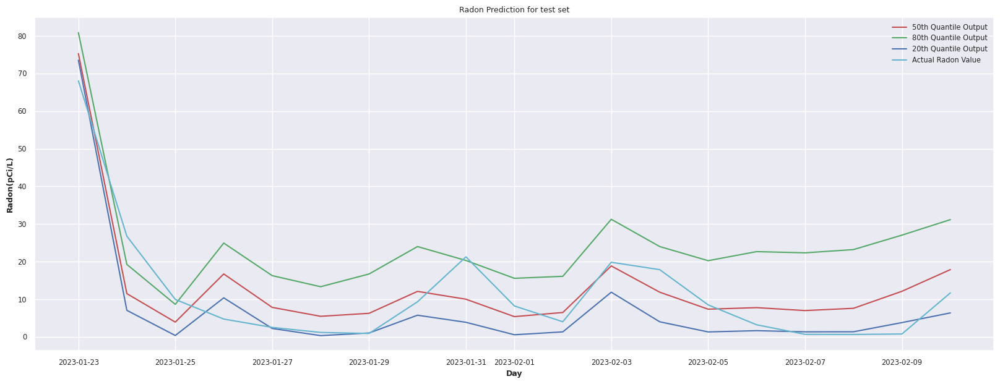

In [85]:
# plot the forecast
plt.figure(100, figsize=(20, 7))
plt.plot(dfY.index, dfY['Q50'], color='r', label='50th Quantile Output')
plt.plot(dfY.index, dfY['Q80'], color='g', label='80th Quantile Output')
plt.plot(dfY.index, dfY['Q20'], color='b', label='20th Quantile Output')
plt.plot(dfY.index, dfY['Actual'], color='c', label='Actual Radon Value')
plt.legend()
plt.title('Radon Prediction for test set')
plt.xlabel('Day')
plt.ylabel('Radon(pCi/L)')
plt.show()

# Radon 9

In [86]:
#using 21 as the example since it has the most data
df = df_radon['9']

In [87]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2195 entries, 0 to 2194
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Serialid     2195 non-null   object        
 1   DeviceName   2195 non-null   object        
 2   SyncDate     2195 non-null   datetime64[ns]
 3   Radon        2195 non-null   float64       
 4   eC02         2195 non-null   int64         
 5   VOC          2195 non-null   int64         
 6   Temperature  2195 non-null   int64         
 7   AirPressure  2195 non-null   float64       
 8   Humidity     2195 non-null   int64         
 9   LogIndex     2195 non-null   int64         
dtypes: datetime64[ns](1), float64(2), int64(5), object(2)
memory usage: 188.6+ KB


In [88]:
df = df[['SyncDate','Temperature','Humidity','AirPressure','Radon']]

In [89]:
df

,SyncDate,Temperature,Humidity,AirPressure,Radon
0,2023-02-11 18:02:44,49,73,30.03,4.70
1,2023-02-11 17:02:44,50,69,30.07,5.50
2,2023-02-11 16:02:44,54,61,30.08,5.40
3,2023-02-11 15:02:44,55,59,30.08,6.00
4,2023-02-11 14:02:44,54,57,30.13,6.00
...,...,...,...,...,...
2190,2022-11-10 04:23:30,59,65,30.16,10.00
2191,2022-11-10 03:23:30,59,65,30.19,10.50
2192,2022-11-10 02:23:30,58,65,30.21,9.80
2193,2022-11-10 01:23:30,58,65,30.23,10.10


In [90]:
df['SyncDate'] = pd.to_datetime(df['SyncDate'])
df.sort_values(by='SyncDate', ascending=True, inplace=True)
df['SyncDate'] = df['SyncDate'].dt.floor('H')
df = df.resample('D', on = 'SyncDate').mean()
df = df.interpolate(method='linear', limit_direction='both')
df.drop_duplicates(inplace=True)

In [91]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-11-10,61.46,71.17,30.04,10.56
2022-11-11,65.54,83.88,29.66,30.35
2022-11-12,60.83,83.79,29.91,54.13
2022-11-13,44.08,79.46,30.13,44.88
2022-11-14,44.54,71.38,30.23,46.60
...,...,...,...,...
2023-02-07,53.57,59.91,30.27,1.45
2023-02-08,61.59,61.59,30.24,2.94
2023-02-09,62.78,69.74,30.12,2.90


In [92]:
df = df[df.index<= '2023-02-10']

In [93]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-11-10,61.46,71.17,30.04,10.56
2022-11-11,65.54,83.88,29.66,30.35
2022-11-12,60.83,83.79,29.91,54.13
2022-11-13,44.08,79.46,30.13,44.88
2022-11-14,44.54,71.38,30.23,46.60
...,...,...,...,...
2023-02-06,54.67,60.52,30.17,0.55
2023-02-07,53.57,59.91,30.27,1.45
2023-02-08,61.59,61.59,30.24,2.94


In [94]:
weather_station = pd.read_csv('../../lilburn_weather_station.csv')

In [95]:
weather_station

,Date,Simple Date,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
0,2023-02-10T23:55:00-05:00,2023-02-10 23:55:00,49.80,0.00,0.00,5.80,337,0.00,0.41,0.27,0.41,1.53,67.44,29.09,74,0,0.00,29.09,336,0.00
1,2023-02-10T23:50:00-05:00,2023-02-10 23:50:00,49.50,0.00,0.00,5.80,328,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,331,0.00
2,2023-02-10T23:45:00-05:00,2023-02-10 23:45:00,49.80,0.00,0.00,5.80,331,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,323,0.00
3,2023-02-10T23:40:00-05:00,2023-02-10 23:40:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,304,0.00
4,2023-02-10T23:35:00-05:00,2023-02-10 23:35:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.10,75,0,0.00,29.10,315,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78459,2022-05-10T00:20:00-04:00,2022-05-10 00:20:00,55.80,0.00,0.00,0.00,305,0.00,0.00,0.00,0.00,0.76,22.72,29.13,91,0,0.00,29.13,305,0.00
78460,2022-05-10T00:15:00-04:00,2022-05-10 00:15:00,55.90,0.00,0.00,0.00,309,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,309,0.00
78461,2022-05-10T00:10:00-04:00,2022-05-10 00:10:00,55.80,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,306,0.00
78462,2022-05-10T00:05:00-04:00,2022-05-10 00:05:00,55.90,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,305,0.00


In [96]:
weather_station.drop('Date', axis=1, inplace=True)
weather_station['Simple Date'] = pd.to_datetime(weather_station['Simple Date'])
weather_station.sort_values(by='Simple Date', ascending=True, inplace=True)
weather_station['Simple Date'] = weather_station['Simple Date'].dt.floor('H')
weather_station = weather_station.resample('D', on = 'Simple Date').mean()
weather_station = weather_station.interpolate(method='linear', limit_direction='both')
weather_station.drop_duplicates(inplace=True)

In [97]:
weather_station

,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
Simple Date,,,,,,,,,,,,,,,,,,
2022-05-10,65.19,0.15,0.57,3.47,294.31,0.00,0.00,0.00,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,69.33,0.18,0.65,3.28,290.86,0.00,0.00,0.00,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,71.16,0.28,0.94,3.61,292.67,0.00,0.00,0.00,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,69.27,0.24,1.18,6.06,287.73,0.00,0.00,0.00,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,70.23,0.12,0.52,4.22,294.85,0.00,0.00,0.00,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,50.15,0.19,0.64,3.79,309.47,0.00,0.00,0.00,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,50.39,0.32,0.92,4.08,302.28,0.00,0.00,0.00,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,57.42,0.14,0.63,4.05,304.45,0.00,0.00,0.00,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [98]:
for column in weather_station.columns:
    df[column] = weather_station[column]

In [99]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-11-10,61.46,71.17,30.04,10.56,60.47,0.53,2.44,9.37,258.31,0.01,...,0.02,0.07,44.87,28.99,81.32,0.04,22.60,28.99,300.35,0.32
2022-11-11,65.54,83.88,29.66,30.35,64.42,0.25,1.28,8.25,293.91,0.06,...,1.36,1.41,46.20,28.62,96.41,0.04,20.99,28.62,310.71,0.05
2022-11-12,60.83,83.79,29.91,54.13,56.74,0.20,1.02,5.06,306.24,0.00,...,1.68,1.73,46.52,28.87,89.31,0.15,30.46,28.87,312.79,0.09
2022-11-13,44.08,79.46,30.13,44.88,39.47,0.47,1.61,7.96,299.45,0.00,...,0.00,1.73,46.52,29.09,73.09,0.79,97.47,29.09,313.13,0.37
2022-11-14,44.54,71.38,30.23,46.60,41.51,0.37,1.42,6.48,295.55,0.00,...,0.00,1.73,46.52,29.19,69.46,0.64,84.99,29.19,316.30,0.22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,54.67,60.52,30.17,0.55,50.15,0.19,0.64,3.79,309.47,0.00,...,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,53.57,59.91,30.27,1.45,50.39,0.32,0.92,4.08,302.28,0.00,...,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,61.59,61.59,30.24,2.94,57.42,0.14,0.63,4.05,304.45,0.00,...,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [100]:
df.dropna(inplace=True)

In [101]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-11-10,61.46,71.17,30.04,10.56,60.47,0.53,2.44,9.37,258.31,0.01,...,0.02,0.07,44.87,28.99,81.32,0.04,22.60,28.99,300.35,0.32
2022-11-11,65.54,83.88,29.66,30.35,64.42,0.25,1.28,8.25,293.91,0.06,...,1.36,1.41,46.20,28.62,96.41,0.04,20.99,28.62,310.71,0.05
2022-11-12,60.83,83.79,29.91,54.13,56.74,0.20,1.02,5.06,306.24,0.00,...,1.68,1.73,46.52,28.87,89.31,0.15,30.46,28.87,312.79,0.09
2022-11-13,44.08,79.46,30.13,44.88,39.47,0.47,1.61,7.96,299.45,0.00,...,0.00,1.73,46.52,29.09,73.09,0.79,97.47,29.09,313.13,0.37
2022-11-14,44.54,71.38,30.23,46.60,41.51,0.37,1.42,6.48,295.55,0.00,...,0.00,1.73,46.52,29.19,69.46,0.64,84.99,29.19,316.30,0.22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,54.67,60.52,30.17,0.55,50.15,0.19,0.64,3.79,309.47,0.00,...,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,53.57,59.91,30.27,1.45,50.39,0.32,0.92,4.08,302.28,0.00,...,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,61.59,61.59,30.24,2.94,57.42,0.14,0.63,4.05,304.45,0.00,...,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [102]:
df.drop(['Ultra-Violet Radiation Index','Solar Radiation (W/m^2)'], axis=1, inplace=True)

In [103]:
# any missing values?
def gaps(df):
    if df.isnull().values.any():
        print("MISSING values:\n")
        mno.matrix(df)
    else:
        print("no missing values\n")
gaps(df)

no missing values



In [104]:
df.describe()

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
count,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00
mean,50.91,71.75,30.14,25.32,47.34,0.24,0.96,5.17,303.79,0.01,0.31,0.13,0.98,5.63,56.98,29.10,78.09,29.10,316.21,0.16
std,8.43,8.65,0.14,28.58,9.00,0.20,0.69,2.50,14.58,0.02,0.57,0.33,1.19,4.22,6.71,0.14,12.73,0.14,7.93,0.17
min,22.38,52.90,29.66,0.45,15.70,0.01,0.03,1.54,244.70,0.00,0.00,0.00,0.00,0.00,44.87,28.62,46.78,28.62,279.18,0.00
25%,46.14,64.92,30.07,4.04,41.37,0.11,0.55,3.48,297.14,0.00,0.00,0.00,0.02,2.26,51.28,29.03,68.00,29.03,312.97,0.05
50%,50.61,72.54,30.16,11.11,47.84,0.20,0.80,4.46,306.77,0.00,0.03,0.00,0.39,5.66,57.15,29.11,78.39,29.11,317.25,0.12
75%,56.78,77.38,30.24,40.69,53.41,0.32,1.28,6.24,312.58,0.01,0.32,0.06,1.96,9.55,61.85,29.19,89.34,29.19,321.45,0.23
max,65.54,90.12,30.47,138.14,64.71,1.11,3.77,15.20,326.26,0.08,3.20,1.72,3.83,14.68,67.42,29.42,98.48,29.42,329.03,0.98


In [105]:
for column in df.columns:
    df[column] = df[column].astype('float32')
    if column == 'Radon':
        continue
    else:
        for i in range(1,40):
            df[column+'_lag_'+str(i)] = df[column].shift(i)

In [106]:
df.fillna(0, inplace=True)

In [107]:
# check correlations of features with price
df_corr = df.corr(method="pearson")
print(df_corr.shape)
print("correlation with price:")
df_corrP = pd.DataFrame(df_corr["Radon"].sort_values(ascending=False))
df_corrP

(761, 761)
correlation with price:


,Radon
Radon,1.00
Humidity,0.32
Humidity_lag_1,0.25
Event Rain (in),0.20
Hourly Rain (in/hr)_lag_1,0.19
...,...
Yearly Rain (in)_lag_29,-0.75
Avg Wind Direction (10 mins) (°)_lag_31,-0.75
Wind Direction (°)_lag_30,-0.75
Yearly Rain (in)_lag_31,-0.76


In [108]:
for i in df_corrP['Radon'].index:
    print(i, df_corrP['Radon'][i])

Radon 1.0
Humidity 0.3226996148868811
Humidity_lag_1 0.24763335242365128
Event Rain (in) 0.19908880793795342
Hourly Rain (in/hr)_lag_1 0.19450354222717875
Hourly Rain (in/hr) 0.17950903985648856
Outdoor h Temperature (°F)_lag_1 0.17520133337864688
Daily Rain (in)_lag_5 0.15644411726407684
Outdoor h Temperature (°F) 0.14724122887434266
Humidity_lag_2 0.14126361459557205
Daily Rain (in)_lag_1 0.12651627073659558
Wind Direction (°) 0.1223268289165775
Outdoor h Temperature (°F)_lag_2 0.11848667779032397
Daily Rain (in) 0.10936133391568571
Daily Rain (in)_lag_6 0.10383743695826751
Hourly Rain (in/hr)_lag_5 0.09977699670705331
Humidity (%)_lag_1 0.09898029088058086
Absolute Pressure (inHg) 0.09815531102640089
Relative Pressure (inHg) 0.09815531102640089
Wind Direction (°)_lag_1 0.0966511009645657
Humidity (%) 0.09464926099351226
Weekly Rain (in)_lag_3 0.09327675790786896
Avg Wind Speed (10 mins) (mph)_lag_8 0.09204317535307342
AirPressure 0.08867026900601539
Avg Wind Speed (10 mins) (mph)_la

In [109]:
# highest absolute correlations with price
pd.options.display.float_format = '{:,.2f}'.format
df_corrH = df_corrP[np.abs(df_corrP["Radon"]) >= 0.75]
df_corrH

,Radon
Radon,1.00
Yearly Rain (in)_lag_29,-0.75
Avg Wind Direction (10 mins) (°)_lag_31,-0.75
Wind Direction (°)_lag_30,-0.75
Yearly Rain (in)_lag_31,-0.76
Yearly Rain (in)_lag_30,-0.76


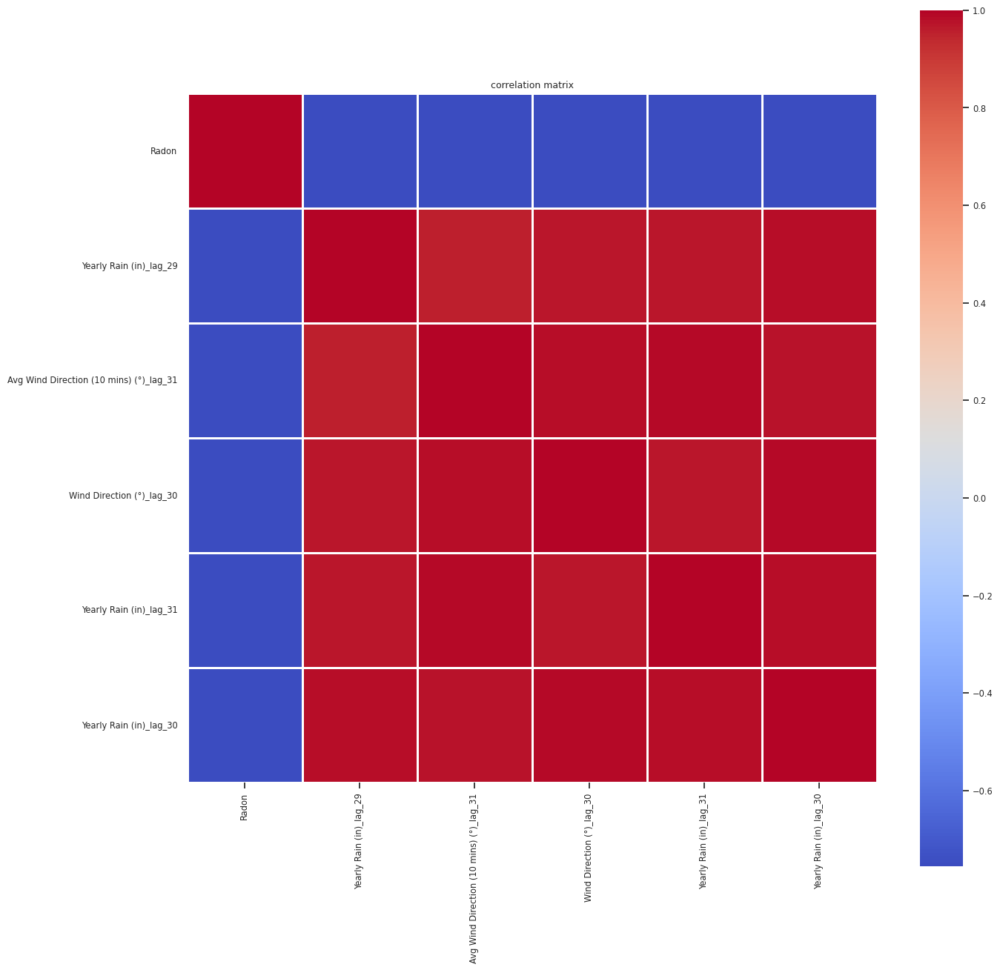

In [110]:
# correlation matrix, limited to highly correlated features
df3 = df[df_corrH.index]

idx = df3.corr().sort_values("Radon", ascending=False).index
df3_sorted = df3.loc[:, idx]  # sort dataframe columns by their correlation with Appliances

plt.figure(figsize = (15,15))
sns.set(font_scale=0.75)
ax = sns.heatmap(df3_sorted.corr().round(3), 
            annot=False, 
            square=True, 
            linewidths=.75, cmap="coolwarm", 
            fmt = ".2f", 
            annot_kws = {"size": 11})
ax.xaxis.tick_bottom()
plt.title("correlation matrix")
plt.show()

In [111]:
df3 = df[df_corrH.index]
df3.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 93 entries, 2022-11-10 to 2023-02-10
Freq: D
Data columns (total 6 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   Radon                                    93 non-null     float32
 1   Yearly Rain (in)_lag_29                  93 non-null     float32
 2   Avg Wind Direction (10 mins) (°)_lag_31  93 non-null     float32
 3   Wind Direction (°)_lag_30                93 non-null     float32
 4   Yearly Rain (in)_lag_31                  93 non-null     float32
 5   Yearly Rain (in)_lag_30                  93 non-null     float32
dtypes: float32(6)
memory usage: 2.9 KB


In [112]:
df3.fillna(0, inplace=True)

In [113]:
df3.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 93 entries, 2022-11-10 to 2023-02-10
Freq: D
Data columns (total 6 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   Radon                                    93 non-null     float32
 1   Yearly Rain (in)_lag_29                  93 non-null     float32
 2   Avg Wind Direction (10 mins) (°)_lag_31  93 non-null     float32
 3   Wind Direction (°)_lag_30                93 non-null     float32
 4   Yearly Rain (in)_lag_31                  93 non-null     float32
 5   Yearly Rain (in)_lag_30                  93 non-null     float32
dtypes: float32(6)
memory usage: 2.9 KB


In [114]:
# create time series object for target variable
ts_P = TimeSeries.from_series(df3["Radon"], fill_missing_dates=True, freq="D") 

# check attributes of the time series
print("components:", ts_P.components)
print("duration:",ts_P.duration)
print("frequency:",ts_P.freq)
print("frequency:",ts_P.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_P.has_datetime_index)
print("deterministic:",ts_P.is_deterministic)
print("univariate:",ts_P.is_univariate)

components: Index(['Radon'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [115]:
# create time series object for the feature columns
df_covF = df3.loc[:, df3.columns != "Radon"]
ts_covF = TimeSeries.from_dataframe(df_covF, fill_missing_dates=True, freq="D")

# check attributes of the time series
print("components (columns) of feature time series:", ts_covF.components)
print("duration:",ts_covF.duration)
print("frequency:",ts_covF.freq)
print("frequency:",ts_covF.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_covF.has_datetime_index)
print("deterministic:",ts_covF.is_deterministic)
print("univariate:",ts_covF.is_univariate)

components (columns) of feature time series: Index(['Yearly Rain (in)_lag_29', 'Avg Wind Direction (10 mins) (°)_lag_31',
       'Wind Direction (°)_lag_30', 'Yearly Rain (in)_lag_31',
       'Yearly Rain (in)_lag_30'],
      dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: False


In [116]:
# example: operating with time series objects:
# we can also create a 3-dimensional numpy array from a time series object
# 3 dimensions: time (rows) / components (columns) / samples
ar_covF = ts_covF.all_values()
print(type(ar_covF))
ar_covF.shape

<class 'numpy.ndarray'>


(93, 5, 1)

In [117]:
# example: operating with time series objects:
# we can also create a pandas series or dataframe from a time series object
df_covF = ts_covF.pd_dataframe()
type(df_covF)

pandas.core.frame.DataFrame

In [118]:

# train/test split and scaling of target variable
ts_train, ts_test = ts_P.split_after(split_point=0.8)
print("training start:", ts_train.start_time())
print("training end:", ts_train.end_time())
print("training duration:",ts_train.duration)
print("test start:", ts_test.start_time())
print("test end:", ts_test.end_time())
print("test duration:", ts_test.duration)


scalerP = Scaler()
scalerP.fit_transform(ts_train)
ts_ttrain = scalerP.transform(ts_train)
ts_ttest = scalerP.transform(ts_test)    
ts_t = scalerP.transform(ts_P)

# make sure data are of type float
ts_t = ts_t.astype(np.float32)
ts_ttrain = ts_ttrain.astype(np.float32)
ts_ttest = ts_ttest.astype(np.float32)

print("first and last row of scaled Radon time series:")
pd.options.display.float_format = '{:,.2f}'.format
ts_t.pd_dataframe().iloc[[0,-1]]

training start: 2022-11-10 00:00:00
training end: 2023-01-22 00:00:00
training duration: 73 days 00:00:00
test start: 2023-01-23 00:00:00
test end: 2023-02-10 00:00:00
test duration: 18 days 00:00:00
first and last row of scaled Radon time series:


component,Radon
SyncDate,
2022-11-10,0.07
2023-02-10,0.03


In [119]:
# train/test split and scaling of feature covariates
covF_train, covF_test = ts_covF.split_after(split_point=0.8)

scalerF = Scaler()
scalerF.fit_transform(covF_train)
covF_ttrain = scalerF.transform(covF_train) 
covF_ttest = scalerF.transform(covF_test)   
covF_t = scalerF.transform(ts_covF)  

# make sure data are of type float
covF_ttrain = covF_ttrain.astype(np.float32)
covF_ttest = covF_ttest.astype(np.float32)

pd.options.display.float_format = '{:.2f}'.format
print("first and last row of scaled feature covariates:")
covF_t.pd_dataframe().iloc[[0,-1]]

first and last row of scaled feature covariates:


component,Yearly Rain (in)_lag_29,Avg Wind Direction (10 mins) (°)_lag_31,Wind Direction (°)_lag_30,Yearly Rain (in)_lag_31,Yearly Rain (in)_lag_30
SyncDate,,,,,
2022-11-10,0.00,0.00,0.00,0.00,0.00
2023-02-10,1.07,0.97,1.00,1.07,1.07


In [120]:

print("first and last row of scaled target variable in training set: price:")
ts_ttrain.pd_dataframe().iloc[[0,-1]]

first and last row of scaled target variable in training set: price:


component,Radon
SyncDate,
2022-11-10,0.07
2023-01-22,0.07


In [121]:
# model = TFTModel(   input_chunk_length=INLEN,
#                     output_chunk_length=N_FC,
#                     hidden_size=HIDDEN,
#                     lstm_layers=LSTMLAYERS,
#                     num_attention_heads=ATTH,
#                     dropout=DROPOUT,
#                     batch_size=BATCH,
#                     n_epochs=EPOCHS,                        
#                     nr_epochs_val_period=VALWAIT, 
#                     likelihood=QuantileRegression(QUANTILES), 
#                     optimizer_kwargs={"lr": LEARN}, 
#                     model_name="TFT_EnergyES",
#                     log_tensorboard=False,
#                     random_state=RAND,
#                     force_reset=True,
#                     save_checkpoints=True,
#                     pl_trainer_kwargs={"callbacks": [EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.05,
#         mode='min',
#     )]}
#                 )

In [122]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)

In [123]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model_return(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=2000
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)
    return model

In [124]:
from ray import tune
from ray.tune import CLIReporter
from ray.tune.integration.pytorch_lightning import TuneReportCallback
from ray.tune.schedulers import ASHAScheduler, AsyncHyperBandScheduler
from ray.tune.search.optuna import OptunaSearch
tune_callback = TuneReportCallback(
    {
        "loss":"val_loss",
        "sMAPE": "val_SymmetricMeanAbsolutePercentageError",
    },
    on="validation_end",
)

early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )

#define the hyperparameter search space
config = {
    "in_len": tune.choice([4,8,16,32,64]),
    "out_len":tune.randint(1,4),
    "lstm_layers":tune.randint(1,4),
    "num_attention_heads":tune.randint(1,12),
    "dropout":tune.uniform(0.1,0.5),
    "lr":tune.loguniform(1e-5,1e-1),
    "include_hour":tune.choice([True,False]),
}

reporter = CLIReporter(
    parameter_columns=list(config.keys()),
    metric_columns=["loss", "sMAPE", "training_iteration"])
resources_per_trial = {"cpu": 8, "gpu": 1}

num_samples = 500

algo = OptunaSearch()

scheduler = AsyncHyperBandScheduler(max_t=1000, grace_period=10, reduction_factor=2)

train_fn_with_parameters = tune.with_parameters(build_fit_tft_model, callbacks=[early_stopper,tune_callback])

analysis = tune.run(
    train_fn_with_parameters,
    resources_per_trial=resources_per_trial,
    metric="sMAPE",
    mode="min",
    config=config,
    num_samples=num_samples,
    search_alg=algo,
    scheduler = scheduler,
    progress_reporter=reporter,
    name="tft_tune",

)

print("Best hyperparameters found were: ", analysis.best_config)

== Status ==
Current time: 2023-02-23 04:31:02 (running for 00:00:00.22)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 1/500 (1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   lstm_layers |   num_attention_heads |   dropout |          lr | include_hour   |
|------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+--------

(build_fit_tft_model pid=1409942) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1409942)   rank_zero_deprecation(
(build_fit_tft_model pid=1409942) Auto select gpus: [0]
(build_fit_tft_model pid=1409942) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1409942) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1409942) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1409942) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1409942) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1409942) 
(build_fit_tft_model pid=1409942)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1409942) ---------------

Trial name,date,done,episodes_total,experiment_id,experiment_tag,hostname,iterations_since_restore,loss,node_ip,pid,sMAPE,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
build_fit_tft_model_00c45e40,2023-02-23_04-42-47,True,,f79136a5ca85461e81c7a5bab8b38997,,ip-172-31-10-87,10,0.276311,172.31.10.87,1421259,1.84111,5.91663,0.237402,5.91663,1677127367,0,,10,00c45e40,0.00472164
build_fit_tft_model_029edb23,2023-02-23_04-41-24,True,,a3613fdb073748fb82d850f7e5fe370b,,ip-172-31-10-87,20,0.210025,172.31.10.87,1419771,1.95028,8.57059,0.199098,8.57059,1677127284,0,,20,029edb23,0.00569224
build_fit_tft_model_0502386b,2023-02-23_07-11-19,True,,d9edf8a22b6842a1b973badc1031a5ad,,ip-172-31-10-87,40,0.108971,172.31.10.87,1592162,1.75408,14.6858,0.255343,14.6858,1677136279,0,,40,0502386b,0.00479841
build_fit_tft_model_05cc8659,2023-02-23_07-17-22,True,,3d34ac4ead1c459795079b28fafa61e0,,ip-172-31-10-87,40,0.0908739,172.31.10.87,1598118,1.88638,13.1534,0.217231,13.1534,1677136642,0,,40,05cc8659,0.00482655
build_fit_tft_model_07bae2bb,2023-02-23_05-27-24,True,,a94c4c23a88e45f88ff55671f585c996,,ip-172-31-10-87,20,0.1283,172.31.10.87,1471229,1.74732,11.8772,0.338373,11.8772,1677130044,0,,20,07bae2bb,0.00521708
build_fit_tft_model_07c214e2,2023-02-23_06-48-05,True,,d0e0920ec2194c32bb8b7f99e232a6ac,,ip-172-31-10-87,10,0.280146,172.31.10.87,1567431,1.88793,7.66773,0.277333,7.66773,1677134885,0,,10,07c214e2,0.00539064
build_fit_tft_model_086367a1,2023-02-23_05-47-24,True,,23d96bd8e6594ebf88af27c55ad250d8,,ip-172-31-10-87,20,0.182427,172.31.10.87,1494674,1.74693,9.38309,0.209101,9.38309,1677131244,0,,20,086367a1,0.00592923
build_fit_tft_model_089ece13,2023-02-23_04-56-03,True,,5617ed0f6f6c4e4eacef3cba28f5fe95,,ip-172-31-10-87,20,0.284872,172.31.10.87,1435507,1.80755,8.90062,0.238035,8.90062,1677128163,0,,20,089ece13,0.00569439
build_fit_tft_model_09eb6dd5,2023-02-23_05-48-02,True,,b6e28c165a044adcb870104e0ee6694a,,ip-172-31-10-87,40,0.120967,172.31.10.87,1495379,1.62658,13.4276,0.198289,13.4276,1677131282,0,,40,09eb6dd5,0.00500035
build_fit_tft_model_0a28f729,2023-02-23_06-32-07,True,,27fd1327e0a14083ab3672f6b64ea5d9,,ip-172-31-10-87,20,0.27675,172.31.10.87,1547887,1.84686,10.8189,0.429826,10.8189,1677133927,0,,20,0a28f729,0.0139866


== Status ==
Current time: 2023-02-23 04:31:16 (running for 00:00:13.67)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: c3c2ce72 with sMAPE=1.956302285194397 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.36986731739897005, 'lr': 1.930813986501496e-05, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 PENDING, 1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------+---------+----------------------+
| Trial name                   | status 

(build_fit_tft_model pid=1410332) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1410332)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1410332) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1410332)   rank_zero_deprecation(
(build_fit_tft_model pid=1410332) Auto select gpus: [0]
(build_fit_tft_model pid=1410332) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1410332) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1410332) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1410332) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:31:37 (running for 00:00:35.13)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -1.8642605543136597 | Iter 10.000: -1.9136780500411987
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b9c6bd01 with sMAPE=1.888903260231018 and parameters={'in_len': 4, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 8, 'dropout': 0.2945149461673373, 'lr': 0.005379528796580392, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 3/500 (1 PENDING, 1 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------+---------+-------------------

== Status ==
Current time: 2023-02-23 04:32:01 (running for 00:00:58.50)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.8252424001693726 | Iter 20.000: -1.7702584862709045 | Iter 10.000: -1.8450251817703247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b9c6bd01 with sMAPE=1.6803773641586304 and parameters={'in_len': 4, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 8, 'dropout': 0.2945149461673373, 'lr': 0.005379528796580392, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 4/500 (1 PENDING, 1 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

(build_fit_tft_model pid=1410874) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1410874)   rank_zero_deprecation(
(build_fit_tft_model pid=1410874) Auto select gpus: [0]
(build_fit_tft_model pid=1410874) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1410874) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1410874) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1410874) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1410874) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1410874) 
(build_fit_tft_model pid=1410874)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1410874) ---------------

== Status ==
Current time: 2023-02-23 04:32:08 (running for 00:01:06.18)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.8252424001693726 | Iter 20.000: -1.7702584862709045 | Iter 10.000: -1.8450251817703247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b9c6bd01 with sMAPE=1.6803773641586304 and parameters={'in_len': 4, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 8, 'dropout': 0.2945149461673373, 'lr': 0.005379528796580392, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 4/500 (1 PENDING, 1 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

(build_fit_tft_model pid=1411140) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1411140)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1411140) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1411140)   rank_zero_deprecation(
(build_fit_tft_model pid=1411140) Auto select gpus: [0]
(build_fit_tft_model pid=1411140) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1411140) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1411140) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1411140) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:32:23 (running for 00:01:21.42)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.8252424001693726 | Iter 20.000: -1.7702584862709045 | Iter 10.000: -1.855676531791687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b9c6bd01 with sMAPE=1.6803773641586304 and parameters={'in_len': 4, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 8, 'dropout': 0.2945149461673373, 'lr': 0.005379528796580392, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 5/500 (1 PENDING, 1 RUNNING, 3 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+---

== Status ==
Current time: 2023-02-23 04:32:39 (running for 00:01:37.07)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.694717824459076 | Iter 20.000: -1.7421506643295288 | Iter 10.000: -1.8404667377471924
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e3c4727d with sMAPE=1.4992367029190063 and parameters={'in_len': 8, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 10, 'dropout': 0.3575538688404196, 'lr': 0.06175402071188132, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 5/500 (1 PENDING, 1 RUNNING, 3 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+---

(build_fit_tft_model pid=1411703) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1411703)   rank_zero_deprecation(
(build_fit_tft_model pid=1411703) Auto select gpus: [0]
(build_fit_tft_model pid=1411703) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1411703) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1411703) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1411703) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1411703) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1411703) 
(build_fit_tft_model pid=1411703)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1411703) ---------------

== Status ==
Current time: 2023-02-23 04:33:04 (running for 00:02:01.44)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.694717824459076 | Iter 20.000: -1.7421506643295288 | Iter 10.000: -1.8404667377471924
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e3c4727d with sMAPE=1.6081174612045288 and parameters={'in_len': 8, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 10, 'dropout': 0.3575538688404196, 'lr': 0.06175402071188132, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 6/500 (1 PENDING, 1 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

== Status ==
Current time: 2023-02-23 04:33:21 (running for 00:02:18.50)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.5641932487487793 | Iter 20.000: -1.7209796905517578 | Iter 10.000: -1.8252569437026978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 248fd378 with sMAPE=1.6012400388717651 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.37366262194763056, 'lr': 0.026321400144944246, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 7/500 (1 PENDING, 1 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1412168) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1412168)   rank_zero_deprecation(
(build_fit_tft_model pid=1412168) Auto select gpus: [0]
(build_fit_tft_model pid=1412168) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1412168) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1412168) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1412168) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1412168) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1412168) 
(build_fit_tft_model pid=1412168)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1412168) ---------------

== Status ==
Current time: 2023-02-23 04:33:28 (running for 00:02:26.31)
Memory usage on this node: 24.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.5641932487487793 | Iter 20.000: -1.7209796905517578 | Iter 10.000: -1.8252569437026978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 248fd378 with sMAPE=1.6012400388717651 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.37366262194763056, 'lr': 0.026321400144944246, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 7/500 (1 PENDING, 1 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1412460) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1412460)   rank_zero_deprecation(
(build_fit_tft_model pid=1412460) Auto select gpus: [0]
(build_fit_tft_model pid=1412460) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1412460) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1412460) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1412460) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1412460) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1412460) 
(build_fit_tft_model pid=1412460)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1412460) ---------------

== Status ==
Current time: 2023-02-23 04:33:43 (running for 00:02:41.42)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.5641932487487793 | Iter 20.000: -1.7209796905517578 | Iter 10.000: -1.8404667377471924
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 248fd378 with sMAPE=1.6012400388717651 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.37366262194763056, 'lr': 0.026321400144944246, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 8/500 (1 PENDING, 1 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1412784) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1412784)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1412784) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1412784)   rank_zero_deprecation(
(build_fit_tft_model pid=1412784) Auto select gpus: [0]
(build_fit_tft_model pid=1412784) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1412784) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1412784) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1412784) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:33:59 (running for 00:02:57.08)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.5641932487487793 | Iter 20.000: -1.7209796905517578 | Iter 10.000: -1.855676531791687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 248fd378 with sMAPE=1.6012400388717651 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.37366262194763056, 'lr': 0.026321400144944246, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 9/500 (1 PENDING, 1 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:34:15 (running for 00:03:12.60)
Memory usage on this node: 30.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.5641932487487793 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8404667377471924
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 248fd378 with sMAPE=1.6012400388717651 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.37366262194763056, 'lr': 0.026321400144944246, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 9/500 (1 PENDING, 1 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1413255) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1413255)   rank_zero_deprecation(
(build_fit_tft_model pid=1413255) Auto select gpus: [0]
(build_fit_tft_model pid=1413255) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1413255) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1413255) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1413255) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1413255) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1413255) 
(build_fit_tft_model pid=1413255)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1413255) ---------------

== Status ==
Current time: 2023-02-23 04:34:32 (running for 00:03:29.79)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=4
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.649623990058899 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8404667377471924
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 248fd378 with sMAPE=1.6012400388717651 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.37366262194763056, 'lr': 0.026321400144944246, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 10/500 (1 PENDING, 1 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1413605) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1413605)   rank_zero_deprecation(
(build_fit_tft_model pid=1413605) Auto select gpus: [0]
(build_fit_tft_model pid=1413605) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1413605) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1413605) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1413605) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1413605) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1413605) 
(build_fit_tft_model pid=1413605)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1413605) ---------------

== Status ==
Current time: 2023-02-23 04:34:53 (running for 00:03:50.74)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.649623990058899 | Iter 20.000: -1.7163745164871216 | Iter 10.000: -1.8252569437026978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 248fd378 with sMAPE=1.6012400388717651 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.37366262194763056, 'lr': 0.026321400144944246, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 11/500 (1 PENDING, 1 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1413941) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1413941)   rank_zero_deprecation(
(build_fit_tft_model pid=1413941) Auto select gpus: [0]
(build_fit_tft_model pid=1413941) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1413941) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1413941) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1413941) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1413941) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1413941) 
(build_fit_tft_model pid=1413941)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1413941) ---------------

== Status ==
Current time: 2023-02-23 04:35:09 (running for 00:04:06.89)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.649623990058899 | Iter 20.000: -1.7163745164871216 | Iter 10.000: -1.8404667377471924
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 248fd378 with sMAPE=1.6012400388717651 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.37366262194763056, 'lr': 0.026321400144944246, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 12/500 (1 PENDING, 1 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1414209) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1414209)   rank_zero_deprecation(
(build_fit_tft_model pid=1414209) Auto select gpus: [0]
(build_fit_tft_model pid=1414209) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1414209) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1414209) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1414209) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1414209) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1414209) 
(build_fit_tft_model pid=1414209)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1414209) ---------------

== Status ==
Current time: 2023-02-23 04:35:25 (running for 00:04:22.48)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.649623990058899 | Iter 20.000: -1.7163745164871216 | Iter 10.000: -1.855676531791687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 248fd378 with sMAPE=1.6012400388717651 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.37366262194763056, 'lr': 0.026321400144944246, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 13/500 (1 PENDING, 1 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 04:35:36 (running for 00:04:33.58)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.649623990058899 | Iter 20.000: -1.7320281267166138 | Iter 10.000: -1.8404667377471924
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 248fd378 with sMAPE=1.6012400388717651 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.37366262194763056, 'lr': 0.026321400144944246, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 14/500 (1 PENDING, 1 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1414563) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1414563)   rank_zero_deprecation(
(build_fit_tft_model pid=1414563) Auto select gpus: [0]
(build_fit_tft_model pid=1414563) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1414563) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1414563) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1414563) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1414563) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1414563) 
(build_fit_tft_model pid=1414563)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1414563) ---------------

== Status ==
Current time: 2023-02-23 04:35:42 (running for 00:04:40.01)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.649623990058899 | Iter 20.000: -1.7320281267166138 | Iter 10.000: -1.8404667377471924
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 248fd378 with sMAPE=1.6012400388717651 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.37366262194763056, 'lr': 0.026321400144944246, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 14/500 (1 PENDING, 1 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:35:55 (running for 00:04:52.56)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.649623990058899 | Iter 20.000: -1.7181504368782043 | Iter 10.000: -1.8252569437026978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 248fd378 with sMAPE=1.6012400388717651 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.37366262194763056, 'lr': 0.026321400144944246, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1414836) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1414836)   rank_zero_deprecation(
(build_fit_tft_model pid=1414836) Auto select gpus: [0]
(build_fit_tft_model pid=1414836) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1414836) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1414836) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1414836) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1414836) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1414836) 
(build_fit_tft_model pid=1414836)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1414836) ---------------

== Status ==
Current time: 2023-02-23 04:36:02 (running for 00:04:59.87)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.649623990058899 | Iter 20.000: -1.7181504368782043 | Iter 10.000: -1.8252569437026978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 248fd378 with sMAPE=1.6012400388717651 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.37366262194763056, 'lr': 0.026321400144944246, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1415102) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1415102)   rank_zero_deprecation(
(build_fit_tft_model pid=1415102) Auto select gpus: [0]
(build_fit_tft_model pid=1415102) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1415102) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1415102) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1415102) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1415102) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1415102) 
(build_fit_tft_model pid=1415102)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1415102) ---------------

== Status ==
Current time: 2023-02-23 04:36:17 (running for 00:05:14.51)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.649623990058899 | Iter 20.000: -1.7181504368782043 | Iter 10.000: -1.8404667377471924
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 248fd378 with sMAPE=1.6012400388717651 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.37366262194763056, 'lr': 0.026321400144944246, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 16/500 (1 PENDING, 1 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1415388) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1415388)   rank_zero_deprecation(
(build_fit_tft_model pid=1415388) Auto select gpus: [0]
(build_fit_tft_model pid=1415388) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1415388) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1415388) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1415388) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1415388) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1415388) 
(build_fit_tft_model pid=1415388)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1415388) ---------------

== Status ==
Current time: 2023-02-23 04:36:31 (running for 00:05:28.81)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.649623990058899 | Iter 20.000: -1.7181504368782043 | Iter 10.000: -1.8553873300552368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 248fd378 with sMAPE=1.6012400388717651 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.37366262194763056, 'lr': 0.026321400144944246, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1415650) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1415650)   rank_zero_deprecation(
(build_fit_tft_model pid=1415650) Auto select gpus: [0]
(build_fit_tft_model pid=1415650) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1415650) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1415650) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1415650) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1415650) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1415650) 
(build_fit_tft_model pid=1415650)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1415650) ---------------

== Status ==
Current time: 2023-02-23 04:36:46 (running for 00:05:44.31)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=11
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.649623990058899 | Iter 20.000: -1.7181504368782043 | Iter 10.000: -1.855531930923462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 248fd378 with sMAPE=1.6012400388717651 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.37366262194763056, 'lr': 0.026321400144944246, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1415868) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1415868)   rank_zero_deprecation(
(build_fit_tft_model pid=1415868) Auto select gpus: [0]
(build_fit_tft_model pid=1415868) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1415868) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1415868) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1415868) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1415868) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1415868) 
(build_fit_tft_model pid=1415868)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1415868) ---------------

== Status ==
Current time: 2023-02-23 04:37:01 (running for 00:05:59.08)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.649623990058899 | Iter 20.000: -1.7181504368782043 | Iter 10.000: -1.855676531791687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 248fd378 with sMAPE=1.6012400388717651 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.37366262194763056, 'lr': 0.026321400144944246, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 19/500 (1 PENDING, 1 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:37:11 (running for 00:06:09.20)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.594439148902893 | Iter 20.000: -1.704272747039795 | Iter 10.000: -1.855531930923462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.556152105331421 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 19/500 (1 PENDING, 1 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1416278) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1416278)   rank_zero_deprecation(
(build_fit_tft_model pid=1416278) Auto select gpus: [0]
(build_fit_tft_model pid=1416278) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1416278) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1416278) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1416278) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1416278) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1416278) 
(build_fit_tft_model pid=1416278)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1416278) ---------------

== Status ==
Current time: 2023-02-23 04:37:27 (running for 00:06:24.99)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.594439148902893 | Iter 20.000: -1.704272747039795 | Iter 10.000: -1.855531930923462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 20/500 (1 PENDING, 1 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:37:41 (running for 00:06:38.59)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6345131397247314 | Iter 20.000: -1.7020407319068909 | Iter 10.000: -1.8553873300552368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1416582) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1416582)   rank_zero_deprecation(
(build_fit_tft_model pid=1416582) Auto select gpus: [0]
(build_fit_tft_model pid=1416582) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1416582) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1416582) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1416582) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1416582) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1416582) 
(build_fit_tft_model pid=1416582)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1416582) ---------------

== Status ==
Current time: 2023-02-23 04:37:47 (running for 00:06:45.41)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6345131397247314 | Iter 20.000: -1.7020407319068909 | Iter 10.000: -1.8553873300552368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:37:58 (running for 00:06:55.69)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.594439148902893 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8403221368789673
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1416923) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1416923)   rank_zero_deprecation(
(build_fit_tft_model pid=1416923) Auto select gpus: [0]
(build_fit_tft_model pid=1416923) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1416923) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1416923) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1416923) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1416923) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1416923) 
(build_fit_tft_model pid=1416923)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1416923) ---------------

== Status ==
Current time: 2023-02-23 04:38:14 (running for 00:07:11.69)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.594439148902893 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8403221368789673
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 22/500 (1 PENDING, 1 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1417182) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1417182)   rank_zero_deprecation(
(build_fit_tft_model pid=1417182) Auto select gpus: [0]
(build_fit_tft_model pid=1417182) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1417182) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1417182) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1417182) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1417182) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1417182) 
(build_fit_tft_model pid=1417182)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1417182) ---------------

== Status ==
Current time: 2023-02-23 04:38:30 (running for 00:07:27.51)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.594439148902893 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8553873300552368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 23/500 (1 PENDING, 1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1417404) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1417404)   rank_zero_deprecation(
(build_fit_tft_model pid=1417404) Auto select gpus: [0]
(build_fit_tft_model pid=1417404) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1417404) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1417404) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1417404) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1417404) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1417404) 
(build_fit_tft_model pid=1417404)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1417404) ---------------

== Status ==
Current time: 2023-02-23 04:38:45 (running for 00:07:43.23)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=15
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.594439148902893 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.855531930923462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 1 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 04:38:56 (running for 00:07:53.60)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.594439148902893 | Iter 20.000: -1.7020407319068909 | Iter 10.000: -1.8553873300552368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 25/500 (1 PENDING, 1 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1417680) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1417680)   rank_zero_deprecation(
(build_fit_tft_model pid=1417680) Auto select gpus: [0]
(build_fit_tft_model pid=1417680) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1417680) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1417680) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1417680) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1417680) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1417680) 
(build_fit_tft_model pid=1417680)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1417680) ---------------

== Status ==
Current time: 2023-02-23 04:39:03 (running for 00:08:01.19)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.594439148902893 | Iter 20.000: -1.7020407319068909 | Iter 10.000: -1.8553873300552368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 25/500 (1 PENDING, 1 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:39:14 (running for 00:08:11.53)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6345131397247314 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8403221368789673
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 25/500 (1 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---

(build_fit_tft_model pid=1418064) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1418064)   rank_zero_deprecation(
(build_fit_tft_model pid=1418064) Auto select gpus: [0]
(build_fit_tft_model pid=1418064) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1418064) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1418064) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1418064) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1418064) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1418064) 
(build_fit_tft_model pid=1418064)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1418064) ---------------

== Status ==
Current time: 2023-02-23 04:39:26 (running for 00:08:23.68)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6345131397247314 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8403221368789673
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 26/500 (1 PENDING, 1 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1418334) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1418334)   rank_zero_deprecation(
(build_fit_tft_model pid=1418334) Auto select gpus: [0]
(build_fit_tft_model pid=1418334) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1418334) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1418334) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1418334) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1418334) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1418334) 
(build_fit_tft_model pid=1418334)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1418334) ---------------

== Status ==
Current time: 2023-02-23 04:39:41 (running for 00:08:39.41)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6345131397247314 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8553873300552368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 27/500 (1 PENDING, 1 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1418568) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1418568)   rank_zero_deprecation(
(build_fit_tft_model pid=1418568) Auto select gpus: [0]
(build_fit_tft_model pid=1418568) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1418568) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1418568) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1418568) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1418568) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1418568) 
(build_fit_tft_model pid=1418568)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1418568) ---------------

== Status ==
Current time: 2023-02-23 04:39:57 (running for 00:08:55.14)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6345131397247314 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.855531930923462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 28/500 (1 PENDING, 1 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1418837) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1418837)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1418837) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1418837)   rank_zero_deprecation(
(build_fit_tft_model pid=1418837) Auto select gpus: [0]
(build_fit_tft_model pid=1418837) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1418837) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1418837) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1418837) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:40:11 (running for 00:09:09.34)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6345131397247314 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.855676531791687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 29/500 (1 PENDING, 1 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:40:22 (running for 00:09:19.78)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6345131397247314 | Iter 20.000: -1.6889476776123047 | Iter 10.000: -1.855531930923462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 29/500 (1 PENDING, 1 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1419121) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1419121)   rank_zero_deprecation(
(build_fit_tft_model pid=1419121) Auto select gpus: [0]
(build_fit_tft_model pid=1419121) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1419121) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1419121) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1419121) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1419121) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1419121) 
(build_fit_tft_model pid=1419121)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1419121) ---------------

== Status ==
Current time: 2023-02-23 04:40:36 (running for 00:09:34.28)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6745871305465698 | Iter 20.000: -1.6889476776123047 | Iter 10.000: -1.855531930923462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:40:47 (running for 00:09:44.69)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6745871305465698 | Iter 20.000: -1.6780866384506226 | Iter 10.000: -1.8553873300552368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1419465) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1419465)   rank_zero_deprecation(
(build_fit_tft_model pid=1419465) Auto select gpus: [0]
(build_fit_tft_model pid=1419465) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1419465) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1419465) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1419465) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1419465) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1419465) 
(build_fit_tft_model pid=1419465)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1419465) ---------------

== Status ==
Current time: 2023-02-23 04:41:03 (running for 00:10:00.78)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.657052755355835 | Iter 20.000: -1.6780866384506226 | Iter 10.000: -1.8553873300552368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1419771) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1419771)   rank_zero_deprecation(
(build_fit_tft_model pid=1419771) Auto select gpus: [0]
(build_fit_tft_model pid=1419771) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1419771) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1419771) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1419771) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1419771) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1419771) 
(build_fit_tft_model pid=1419771)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1419771) ---------------

== Status ==
Current time: 2023-02-23 04:41:20 (running for 00:10:17.45)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.657052755355835 | Iter 20.000: -1.6889476776123047 | Iter 10.000: -1.8454874157905579
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1420042) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1420042)   rank_zero_deprecation(
(build_fit_tft_model pid=1420042) Auto select gpus: [0]
(build_fit_tft_model pid=1420042) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1420042) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1420042) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1420042) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1420042) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1420042) 
(build_fit_tft_model pid=1420042)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1420042) ---------------

== Status ==
Current time: 2023-02-23 04:41:37 (running for 00:10:34.44)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=23
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.657052755355835 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.835587501525879
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 33/500 (1 PENDING, 1 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1420320) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1420320)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1420320) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1420320)   rank_zero_deprecation(
(build_fit_tft_model pid=1420320) Auto select gpus: [0]
(build_fit_tft_model pid=1420320) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1420320) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1420320) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1420320) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:41:52 (running for 00:10:49.81)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.657052755355835 | Iter 20.000: -1.7020407319068909 | Iter 10.000: -1.8304222226142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 34/500 (1 PENDING, 1 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:42:06 (running for 00:11:03.61)
Memory usage on this node: 24.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6395183801651 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8252569437026978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1420642) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1420642)   rank_zero_deprecation(
(build_fit_tft_model pid=1420642) Auto select gpus: [0]
(build_fit_tft_model pid=1420642) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1420642) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1420642) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1420642) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1420642) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1420642) 
(build_fit_tft_model pid=1420642)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1420642) ---------------

== Status ==
Current time: 2023-02-23 04:42:12 (running for 00:11:10.15)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6395183801651 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8252569437026978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1420920) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1420920)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1420920) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1420920)   rank_zero_deprecation(
(build_fit_tft_model pid=1420920) Auto select gpus: [0]
(build_fit_tft_model pid=1420920) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1420920) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1420920) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1420920) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:42:26 (running for 00:11:23.99)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6395183801651 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8304222226142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:42:39 (running for 00:11:36.60)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6395183801651 | Iter 20.000: -1.6987293362617493 | Iter 10.000: -1.8252569437026978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 37/500 (1 PENDING, 1 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1421259) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1421259)   rank_zero_deprecation(
(build_fit_tft_model pid=1421259) Auto select gpus: [0]
(build_fit_tft_model pid=1421259) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1421259) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1421259) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1421259) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1421259) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1421259) 
(build_fit_tft_model pid=1421259)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1421259) ---------------

== Status ==
Current time: 2023-02-23 04:42:45 (running for 00:11:42.94)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6395183801651 | Iter 20.000: -1.6987293362617493 | Iter 10.000: -1.8252569437026978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 37/500 (1 PENDING, 1 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1421465) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1421465)   rank_zero_deprecation(
(build_fit_tft_model pid=1421465) Auto select gpus: [0]
(build_fit_tft_model pid=1421465) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1421465) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1421465) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1421465) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1421465) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1421465) 
(build_fit_tft_model pid=1421465)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1421465) ---------------

== Status ==
Current time: 2023-02-23 04:42:59 (running for 00:11:56.77)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6395183801651 | Iter 20.000: -1.6987293362617493 | Iter 10.000: -1.8304222226142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 PENDING, 1 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:43:10 (running for 00:12:07.56)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6224247217178345 | Iter 20.000: -1.6976499557495117 | Iter 10.000: -1.8252569437026978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---

(build_fit_tft_model pid=1421825) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1421825)   rank_zero_deprecation(
(build_fit_tft_model pid=1421825) Auto select gpus: [0]
(build_fit_tft_model pid=1421825) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1421825) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1421825) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1421825) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1421825) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1421825) 
(build_fit_tft_model pid=1421825)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1421825) ---------------

== Status ==
Current time: 2023-02-23 04:43:21 (running for 00:12:19.11)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6224247217178345 | Iter 20.000: -1.6976499557495117 | Iter 10.000: -1.8252569437026978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 PENDING, 1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1422089) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1422089)   rank_zero_deprecation(
(build_fit_tft_model pid=1422089) Auto select gpus: [0]
(build_fit_tft_model pid=1422089) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1422089) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1422089) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1422089) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1422089) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1422089) 
(build_fit_tft_model pid=1422089)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1422089) ---------------

== Status ==
Current time: 2023-02-23 04:43:36 (running for 00:12:34.13)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6224247217178345 | Iter 20.000: -1.6987293362617493 | Iter 10.000: -1.8239522576332092
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1422324) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1422324)   rank_zero_deprecation(
(build_fit_tft_model pid=1422324) Auto select gpus: [0]
(build_fit_tft_model pid=1422324) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1422324) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1422324) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1422324) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1422324) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1422324) 
(build_fit_tft_model pid=1422324)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1422324) ---------------

== Status ==
Current time: 2023-02-23 04:43:49 (running for 00:12:47.01)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6224247217178345 | Iter 20.000: -1.6987293362617493 | Iter 10.000: -1.8252569437026978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 41/500 (1 PENDING, 1 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1422479) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1422479)   rank_zero_deprecation(
(build_fit_tft_model pid=1422479) Auto select gpus: [0]
(build_fit_tft_model pid=1422479) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1422479) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1422479) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1422479) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1422479) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1422479) 
(build_fit_tft_model pid=1422479)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1422479) ---------------

== Status ==
Current time: 2023-02-23 04:44:03 (running for 00:13:00.90)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6224247217178345 | Iter 20.000: -1.6987293362617493 | Iter 10.000: -1.8304222226142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 42/500 (1 PENDING, 1 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1422784) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1422784)   rank_zero_deprecation(
(build_fit_tft_model pid=1422784) Auto select gpus: [0]
(build_fit_tft_model pid=1422784) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1422784) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1422784) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1422784) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1422784) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1422784) 
(build_fit_tft_model pid=1422784)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1422784) ---------------

== Status ==
Current time: 2023-02-23 04:44:19 (running for 00:13:16.71)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6224247217178345 | Iter 20.000: -1.6987293362617493 | Iter 10.000: -1.835587501525879
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 43/500 (1 PENDING, 1 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1423056) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1423056)   rank_zero_deprecation(
(build_fit_tft_model pid=1423056) Auto select gpus: [0]
(build_fit_tft_model pid=1423056) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1423056) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1423056) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1423056) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1423056) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1423056) 
(build_fit_tft_model pid=1423056)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1423056) ---------------

== Status ==
Current time: 2023-02-23 04:44:36 (running for 00:13:34.05)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6224247217178345 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8304222226142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1423242) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1423242)   rank_zero_deprecation(
(build_fit_tft_model pid=1423242) Auto select gpus: [0]
(build_fit_tft_model pid=1423242) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1423242) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1423242) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1423242) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1423242) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1423242) 
(build_fit_tft_model pid=1423242)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1423242) ---------------

== Status ==
Current time: 2023-02-23 04:44:52 (running for 00:13:49.66)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6224247217178345 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.835587501525879
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1423590) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1423590)   rank_zero_deprecation(
(build_fit_tft_model pid=1423590) Auto select gpus: [0]
(build_fit_tft_model pid=1423590) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1423590) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1423590) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1423590) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1423590) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1423590) 
(build_fit_tft_model pid=1423590)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1423590) ---------------

== Status ==
Current time: 2023-02-23 04:45:08 (running for 00:14:05.95)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6224247217178345 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8383487462997437
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:45:19 (running for 00:14:16.48)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6224247217178345 | Iter 20.000: -1.6987293362617493 | Iter 10.000: -1.835587501525879
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1424106) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1424106)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1424106) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1424106)   rank_zero_deprecation(
(build_fit_tft_model pid=1424106) Auto select gpus: [0]
(build_fit_tft_model pid=1424106) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1424106) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1424106) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1424106) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:45:37 (running for 00:14:34.43)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6395183801651 | Iter 20.000: -1.6987293362617493 | Iter 10.000: -1.835587501525879
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:45:47 (running for 00:14:44.82)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6395183801651 | Iter 20.000: -1.6976909637451172 | Iter 10.000: -1.8304222226142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1424504) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1424504)   rank_zero_deprecation(
(build_fit_tft_model pid=1424504) Auto select gpus: [0]
(build_fit_tft_model pid=1424504) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1424504) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1424504) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1424504) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1424504) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1424504) 
(build_fit_tft_model pid=1424504)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1424504) ---------------

== Status ==
Current time: 2023-02-23 04:46:01 (running for 00:14:59.37)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6395183801651 | Iter 20.000: -1.6976909637451172 | Iter 10.000: -1.8304222226142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:46:12 (running for 00:15:10.09)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6395183801651 | Iter 20.000: -1.6976704597473145 | Iter 10.000: -1.8252569437026978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:46:23 (running for 00:15:20.45)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6325684785842896 | Iter 20.000: -1.6976704597473145 | Iter 10.000: -1.8252569437026978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1425121) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1425121)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1425121) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1425121)   rank_zero_deprecation(
(build_fit_tft_model pid=1425121) Auto select gpus: [0]
(build_fit_tft_model pid=1425121) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1425121) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1425121) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1425121) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:46:38 (running for 00:15:35.97)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6325684785842896 | Iter 20.000: -1.6976704597473145 | Iter 10.000: -1.8252569437026978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:46:49 (running for 00:15:47.03)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6325684785842896 | Iter 20.000: -1.6976499557495117 | Iter 10.000: -1.8239522576332092
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1425617) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1425617)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1425617) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1425617)   rank_zero_deprecation(
(build_fit_tft_model pid=1425617) Auto select gpus: [0]
(build_fit_tft_model pid=1425617) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1425617) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1425617) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1425617) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:47:06 (running for 00:16:03.65)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.625618577003479 | Iter 20.000: -1.6976499557495117 | Iter 10.000: -1.8239522576332092
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 50/500 (1 PENDING, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:47:19 (running for 00:16:16.69)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.625618577003479 | Iter 20.000: -1.6976704597473145 | Iter 10.000: -1.8226475715637207
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 51/500 (1 PENDING, 1 RUNNING, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1426029) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1426029)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1426029) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1426029)   rank_zero_deprecation(
(build_fit_tft_model pid=1426029) Auto select gpus: [0]
(build_fit_tft_model pid=1426029) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1426029) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1426029) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1426029) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:47:26 (running for 00:16:24.36)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.625618577003479 | Iter 20.000: -1.6976704597473145 | Iter 10.000: -1.8226475715637207
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 51/500 (1 PENDING, 1 RUNNING, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1426345) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1426345)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1426345) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1426345)   rank_zero_deprecation(
(build_fit_tft_model pid=1426345) Auto select gpus: [0]
(build_fit_tft_model pid=1426345) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1426345) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1426345) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1426345) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:47:43 (running for 00:16:40.79)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=36
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.625618577003479 | Iter 20.000: -1.6976704597473145 | Iter 10.000: -1.8239522576332092
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 52/500 (1 PENDING, 1 RUNNING, 50 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1426641) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1426641)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1426641) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1426641)   rank_zero_deprecation(
(build_fit_tft_model pid=1426641) Auto select gpus: [0]
(build_fit_tft_model pid=1426641) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1426641) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1426641) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1426641) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:48:00 (running for 00:16:58.27)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.625618577003479 | Iter 20.000: -1.6976704597473145 | Iter 10.000: -1.8252569437026978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 53/500 (1 PENDING, 1 RUNNING, 51 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:48:14 (running for 00:17:11.67)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.625618577003479 | Iter 20.000: -1.6976909637451172 | Iter 10.000: -1.8247698545455933
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1427007) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1427007)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1427007) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1427007)   rank_zero_deprecation(
(build_fit_tft_model pid=1427007) Auto select gpus: [0]
(build_fit_tft_model pid=1427007) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1427007) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1427007) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1427007) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:48:22 (running for 00:17:19.49)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.625618577003479 | Iter 20.000: -1.6976909637451172 | Iter 10.000: -1.8247698545455933
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:48:32 (running for 00:17:29.97)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.625618577003479 | Iter 20.000: -1.6976704597473145 | Iter 10.000: -1.8242827653884888
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1427499) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1427499)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1427499) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1427499)   rank_zero_deprecation(
(build_fit_tft_model pid=1427499) Auto select gpus: [0]
(build_fit_tft_model pid=1427499) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1427499) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1427499) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1427499) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:48:47 (running for 00:17:45.01)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.625618577003479 | Iter 20.000: -1.6976704597473145 | Iter 10.000: -1.8242827653884888
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 PENDING, 1 RUNNING, 53 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:49:00 (running for 00:17:57.67)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.625618577003479 | Iter 20.000: -1.6976909637451172 | Iter 10.000: -1.8234651684761047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1427937) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1427937)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1427937) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1427937)   rank_zero_deprecation(
(build_fit_tft_model pid=1427937) Auto select gpus: [0]
(build_fit_tft_model pid=1427937) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1427937) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1427937) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1427937) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:49:07 (running for 00:18:05.02)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.625618577003479 | Iter 20.000: -1.6976909637451172 | Iter 10.000: -1.8234651684761047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:49:20 (running for 00:18:17.65)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.625618577003479 | Iter 20.000: -1.698749840259552 | Iter 10.000: -1.8226475715637207
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 57/500 (1 PENDING, 1 RUNNING, 55 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1428277) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1428277)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1428277) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1428277)   rank_zero_deprecation(
(build_fit_tft_model pid=1428277) Auto select gpus: [0]
(build_fit_tft_model pid=1428277) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1428277) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1428277) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1428277) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:49:28 (running for 00:18:26.23)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.625618577003479 | Iter 20.000: -1.698749840259552 | Iter 10.000: -1.8226475715637207
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 57/500 (1 PENDING, 1 RUNNING, 55 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 04:49:39 (running for 00:18:36.65)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.625618577003479 | Iter 20.000: -1.6976909637451172 | Iter 10.000: -1.8222786784172058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 57/500 (1 PENDING, 1 RUNNING, 55 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:49:50 (running for 00:18:47.69)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.6976909637451172 | Iter 10.000: -1.8222786784172058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 58/500 (1 PENDING, 1 RUNNING, 56 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1428779) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1428779)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1428779) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1428779)   rank_zero_deprecation(
(build_fit_tft_model pid=1428779) Auto select gpus: [0]
(build_fit_tft_model pid=1428779) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1428779) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1428779) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1428779) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:49:57 (running for 00:18:55.19)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.6976909637451172 | Iter 10.000: -1.8222786784172058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 58/500 (1 PENDING, 1 RUNNING, 56 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1429103) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1429103)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1429103) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1429103)   rank_zero_deprecation(
(build_fit_tft_model pid=1429103) Auto select gpus: [0]
(build_fit_tft_model pid=1429103) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1429103) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1429103) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1429103) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:50:14 (running for 00:19:12.24)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.6976909637451172 | Iter 10.000: -1.8226475715637207
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 59/500 (1 PENDING, 1 RUNNING, 57 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 04:50:28 (running for 00:19:25.68)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=42
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.698749840259552 | Iter 10.000: -1.8222786784172058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 60/500 (1 PENDING, 1 RUNNING, 58 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1429414) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1429414)   rank_zero_deprecation(
(build_fit_tft_model pid=1429414) Auto select gpus: [0]
(build_fit_tft_model pid=1429414) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1429414) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1429414) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1429414) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1429414) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1429414) 
(build_fit_tft_model pid=1429414)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1429414) ---------------

== Status ==
Current time: 2023-02-23 04:50:36 (running for 00:19:34.31)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=42
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.698749840259552 | Iter 10.000: -1.8222786784172058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 60/500 (1 PENDING, 1 RUNNING, 58 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1429772) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1429772)   rank_zero_deprecation(
(build_fit_tft_model pid=1429772) Auto select gpus: [0]
(build_fit_tft_model pid=1429772) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1429772) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1429772) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1429772) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1429772) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1429772) 
(build_fit_tft_model pid=1429772)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1429772) ---------------

== Status ==
Current time: 2023-02-23 04:50:52 (running for 00:19:50.19)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=43
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.698749840259552 | Iter 10.000: -1.8226475715637207
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 61/500 (1 PENDING, 1 RUNNING, 59 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:51:07 (running for 00:20:04.69)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=43
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.6976909637451172 | Iter 10.000: -1.8222786784172058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1430181) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1430181)   rank_zero_deprecation(
(build_fit_tft_model pid=1430181) Auto select gpus: [0]
(build_fit_tft_model pid=1430181) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1430181) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1430181) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1430181) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1430181) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1430181) 
(build_fit_tft_model pid=1430181)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1430181) ---------------

== Status ==
Current time: 2023-02-23 04:51:15 (running for 00:20:13.11)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=43
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.6976909637451172 | Iter 10.000: -1.8222786784172058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1430490) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1430490)   rank_zero_deprecation(
(build_fit_tft_model pid=1430490) Auto select gpus: [0]
(build_fit_tft_model pid=1430490) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1430490) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1430490) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1430490) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1430490) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1430490) 
(build_fit_tft_model pid=1430490)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1430490) ---------------

== Status ==
Current time: 2023-02-23 04:51:34 (running for 00:20:31.82)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.698749840259552 | Iter 10.000: -1.821909785270691
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 63/500 (1 PENDING, 1 RUNNING, 61 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1430807) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1430807)   rank_zero_deprecation(
(build_fit_tft_model pid=1430807) Auto select gpus: [0]
(build_fit_tft_model pid=1430807) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1430807) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1430807) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1430807) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1430807) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1430807) 
(build_fit_tft_model pid=1430807)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1430807) ---------------

== Status ==
Current time: 2023-02-23 04:51:50 (running for 00:20:48.05)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=45
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.698749840259552 | Iter 10.000: -1.8222786784172058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1431166) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1431166)   rank_zero_deprecation(
(build_fit_tft_model pid=1431166) Auto select gpus: [0]
(build_fit_tft_model pid=1431166) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1431166) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1431166) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1431166) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1431166) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1431166) 
(build_fit_tft_model pid=1431166)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1431166) ---------------

== Status ==
Current time: 2023-02-23 04:52:07 (running for 00:21:05.23)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.698749840259552 | Iter 10.000: -1.8226475715637207
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 65/500 (1 PENDING, 1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:52:21 (running for 00:21:18.72)
Memory usage on this node: 25.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8222786784172058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1431609) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1431609)   rank_zero_deprecation(
(build_fit_tft_model pid=1431609) Auto select gpus: [0]
(build_fit_tft_model pid=1431609) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1431609) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1431609) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1431609) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1431609) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1431609) 
(build_fit_tft_model pid=1431609)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1431609) ---------------

== Status ==
Current time: 2023-02-23 04:52:28 (running for 00:21:26.20)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8222786784172058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 04:52:39 (running for 00:21:36.59)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.699574053287506 | Iter 10.000: -1.821909785270691
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:52:51 (running for 00:21:48.71)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.699574053287506 | Iter 10.000: -1.821909785270691
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1432158) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1432158)   rank_zero_deprecation(
(build_fit_tft_model pid=1432158) Auto select gpus: [0]
(build_fit_tft_model pid=1432158) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1432158) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1432158) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1432158) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1432158) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1432158) 
(build_fit_tft_model pid=1432158)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1432158) ---------------

== Status ==
Current time: 2023-02-23 04:52:58 (running for 00:21:56.25)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.699574053287506 | Iter 10.000: -1.821909785270691
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 04:53:11 (running for 00:22:08.73)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8213107585906982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1432536) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1432536)   rank_zero_deprecation(
(build_fit_tft_model pid=1432536) Auto select gpus: [0]
(build_fit_tft_model pid=1432536) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1432536) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1432536) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1432536) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1432536) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1432536) 
(build_fit_tft_model pid=1432536)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1432536) ---------------

== Status ==
Current time: 2023-02-23 04:53:19 (running for 00:22:16.62)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8213107585906982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:53:29 (running for 00:22:27.00)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.699574053287506 | Iter 10.000: -1.8207117319107056
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:53:40 (running for 00:22:37.50)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.699574053287506 | Iter 10.000: -1.8207117319107056
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1433127) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1433127)   rank_zero_deprecation(
(build_fit_tft_model pid=1433127) Auto select gpus: [0]
(build_fit_tft_model pid=1433127) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1433127) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1433127) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1433127) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1433127) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1433127) 
(build_fit_tft_model pid=1433127)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1433127) ---------------

== Status ==
Current time: 2023-02-23 04:53:55 (running for 00:22:52.48)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.699574053287506 | Iter 10.000: -1.8207117319107056
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1433459) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1433459)   rank_zero_deprecation(
(build_fit_tft_model pid=1433459) Auto select gpus: [0]
(build_fit_tft_model pid=1433459) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1433459) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1433459) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1433459) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1433459) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1433459) 
(build_fit_tft_model pid=1433459)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1433459) ---------------

== Status ==
Current time: 2023-02-23 04:54:13 (running for 00:23:11.23)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=49
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8207097053527832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 70/500 (1 PENDING, 1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1433760) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1433760)   rank_zero_deprecation(
(build_fit_tft_model pid=1433760) Auto select gpus: [0]
(build_fit_tft_model pid=1433760) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1433760) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1433760) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1433760) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1433760) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1433760) 
(build_fit_tft_model pid=1433760)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1433760) ---------------

== Status ==
Current time: 2023-02-23 04:54:30 (running for 00:23:27.81)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8207117319107056
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 71/500 (1 PENDING, 1 RUNNING, 69 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1434078) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1434078)   rank_zero_deprecation(
(build_fit_tft_model pid=1434078) Auto select gpus: [0]
(build_fit_tft_model pid=1434078) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1434078) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1434078) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1434078) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1434078) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1434078) 
(build_fit_tft_model pid=1434078)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1434078) ---------------

== Status ==
Current time: 2023-02-23 04:54:46 (running for 00:23:43.65)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8213107585906982
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 72/500 (1 PENDING, 1 RUNNING, 70 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:54:57 (running for 00:23:54.74)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7020407319068909 | Iter 10.000: -1.8207117319107056
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1434447) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1434447)   rank_zero_deprecation(
(build_fit_tft_model pid=1434447) Auto select gpus: [0]
(build_fit_tft_model pid=1434447) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1434447) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1434447) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1434447) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1434447) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1434447) 
(build_fit_tft_model pid=1434447)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1434447) ---------------

== Status ==
Current time: 2023-02-23 04:55:05 (running for 00:24:02.57)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7020407319068909 | Iter 10.000: -1.8207117319107056
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:55:15 (running for 00:24:12.72)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6722749471664429 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8207097053527832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:55:29 (running for 00:24:26.74)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8207097053527832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1435094) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1435094)   rank_zero_deprecation(
(build_fit_tft_model pid=1435094) Auto select gpus: [0]
(build_fit_tft_model pid=1435094) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1435094) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1435094) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1435094) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1435094) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1435094) 
(build_fit_tft_model pid=1435094)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1435094) ---------------

== Status ==
Current time: 2023-02-23 04:55:36 (running for 00:24:33.98)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8207097053527832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:55:51 (running for 00:24:48.76)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=53
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.699574053287506 | Iter 10.000: -1.8207076787948608
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1435507) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1435507)   rank_zero_deprecation(
(build_fit_tft_model pid=1435507) Auto select gpus: [0]
(build_fit_tft_model pid=1435507) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1435507) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1435507) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1435507) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1435507) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1435507) 
(build_fit_tft_model pid=1435507)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1435507) ---------------

== Status ==
Current time: 2023-02-23 04:55:59 (running for 00:24:56.65)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=53
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.699574053287506 | Iter 10.000: -1.8207076787948608
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1435906) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1435906)   rank_zero_deprecation(
(build_fit_tft_model pid=1435906) Auto select gpus: [0]
(build_fit_tft_model pid=1435906) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1435906) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1435906) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1435906) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1435906) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1435906) 
(build_fit_tft_model pid=1435906)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1435906) ---------------

== Status ==
Current time: 2023-02-23 04:56:17 (running for 00:25:14.66)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8201335072517395
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:56:27 (running for 00:25:25.06)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.699574053287506 | Iter 10.000: -1.8195593357086182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1436377) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1436377)   rank_zero_deprecation(
(build_fit_tft_model pid=1436377) Auto select gpus: [0]
(build_fit_tft_model pid=1436377) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1436377) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1436377) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1436377) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1436377) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1436377) 
(build_fit_tft_model pid=1436377)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1436377) ---------------

== Status ==
Current time: 2023-02-23 04:56:42 (running for 00:25:39.43)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.699574053287506 | Iter 10.000: -1.8195593357086182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1436730) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1436730)   rank_zero_deprecation(
(build_fit_tft_model pid=1436730) Auto select gpus: [0]
(build_fit_tft_model pid=1436730) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1436730) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1436730) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1436730) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1436730) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1436730) 
(build_fit_tft_model pid=1436730)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1436730) ---------------

== Status ==
Current time: 2023-02-23 04:57:00 (running for 00:25:57.57)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8171619772911072
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1437104) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1437104)   rank_zero_deprecation(
(build_fit_tft_model pid=1437104) Auto select gpus: [0]
(build_fit_tft_model pid=1437104) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1437104) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1437104) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1437104) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1437104) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1437104) 
(build_fit_tft_model pid=1437104)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1437104) ---------------

== Status ==
Current time: 2023-02-23 04:57:17 (running for 00:26:15.35)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7019129991531372 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 79/500 (1 PENDING, 1 RUNNING, 77 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:57:32 (running for 00:26:29.77)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=57
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.813466191291809
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1437411) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1437411)   rank_zero_deprecation(
(build_fit_tft_model pid=1437411) Auto select gpus: [0]
(build_fit_tft_model pid=1437411) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1437411) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1437411) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1437411) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1437411) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1437411) 
(build_fit_tft_model pid=1437411)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1437411) ---------------

== Status ==
Current time: 2023-02-23 04:57:40 (running for 00:26:38.07)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=57
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.813466191291809
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1437776) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1437776)   rank_zero_deprecation(
(build_fit_tft_model pid=1437776) Auto select gpus: [0]
(build_fit_tft_model pid=1437776) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1437776) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1437776) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1437776) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1437776) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1437776) 
(build_fit_tft_model pid=1437776)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1437776) ---------------

== Status ==
Current time: 2023-02-23 04:57:55 (running for 00:26:53.41)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 81/500 (1 PENDING, 1 RUNNING, 79 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1438035) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1438035)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1438035) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1438035)   rank_zero_deprecation(
(build_fit_tft_model pid=1438035) Auto select gpus: [0]
(build_fit_tft_model pid=1438035) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1438035) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1438035) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1438035) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:58:11 (running for 00:27:09.10)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.815264105796814
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 04:58:26 (running for 00:27:23.77)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7019129991531372 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1438462) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1438462)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1438462) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1438462)   rank_zero_deprecation(
(build_fit_tft_model pid=1438462) Auto select gpus: [0]
(build_fit_tft_model pid=1438462) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1438462) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1438462) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1438462) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:58:34 (running for 00:27:31.72)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7019129991531372 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1438779) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1438779)   rank_zero_deprecation(
(build_fit_tft_model pid=1438779) Auto select gpus: [0]
(build_fit_tft_model pid=1438779) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1438779) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1438779) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1438779) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1438779) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1438779) 
(build_fit_tft_model pid=1438779)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1438779) ---------------

== Status ==
Current time: 2023-02-23 04:58:51 (running for 00:27:48.69)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=61
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7019129991531372 | Iter 10.000: -1.815264105796814
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 04:59:04 (running for 00:28:01.77)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=61
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 85/500 (1 PENDING, 1 RUNNING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1439144) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1439144)   rank_zero_deprecation(
(build_fit_tft_model pid=1439144) Auto select gpus: [0]
(build_fit_tft_model pid=1439144) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1439144) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1439144) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1439144) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1439144) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1439144) 
(build_fit_tft_model pid=1439144)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1439144) ---------------

== Status ==
Current time: 2023-02-23 04:59:12 (running for 00:28:09.52)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=61
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 85/500 (1 PENDING, 1 RUNNING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:59:27 (running for 00:28:24.77)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.699574053287506 | Iter 10.000: -1.813466191291809
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1439647) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1439647)   rank_zero_deprecation(
(build_fit_tft_model pid=1439647) Auto select gpus: [0]
(build_fit_tft_model pid=1439647) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1439647) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1439647) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1439647) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1439647) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1439647) 
(build_fit_tft_model pid=1439647)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1439647) ---------------

== Status ==
Current time: 2023-02-23 04:59:35 (running for 00:28:32.75)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.699574053287506 | Iter 10.000: -1.813466191291809
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1440001) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1440001)   rank_zero_deprecation(
(build_fit_tft_model pid=1440001) Auto select gpus: [0]
(build_fit_tft_model pid=1440001) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1440001) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1440001) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1440001) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1440001) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1440001) 
(build_fit_tft_model pid=1440001)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1440001) ---------------

== Status ==
Current time: 2023-02-23 04:59:52 (running for 00:28:50.34)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.812167763710022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 87/500 (1 PENDING, 1 RUNNING, 85 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1440270) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1440270)   rank_zero_deprecation(
(build_fit_tft_model pid=1440270) Auto select gpus: [0]
(build_fit_tft_model pid=1440270) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1440270) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1440270) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1440270) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1440270) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1440270) 
(build_fit_tft_model pid=1440270)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1440270) ---------------

== Status ==
Current time: 2023-02-23 05:00:07 (running for 00:29:05.29)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.813466191291809
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 88/500 (1 PENDING, 1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1440587) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1440587)   rank_zero_deprecation(
(build_fit_tft_model pid=1440587) Auto select gpus: [0]
(build_fit_tft_model pid=1440587) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1440587) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1440587) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1440587) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1440587) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1440587) 
(build_fit_tft_model pid=1440587)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1440587) ---------------

== Status ==
Current time: 2023-02-23 05:00:23 (running for 00:29:20.76)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1440958) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1440958)   rank_zero_deprecation(
(build_fit_tft_model pid=1440958) Auto select gpus: [0]
(build_fit_tft_model pid=1440958) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1440958) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1440958) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1440958) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1440958) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1440958) 
(build_fit_tft_model pid=1440958)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1440958) ---------------

== Status ==
Current time: 2023-02-23 05:00:39 (running for 00:29:37.32)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.815264105796814
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:00:53 (running for 00:29:50.78)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7019129991531372 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1441330) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1441330)   rank_zero_deprecation(
(build_fit_tft_model pid=1441330) Auto select gpus: [0]
(build_fit_tft_model pid=1441330) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1441330) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1441330) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1441330) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1441330) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1441330) 
(build_fit_tft_model pid=1441330)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1441330) ---------------

== Status ==
Current time: 2023-02-23 05:01:01 (running for 00:29:58.74)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7019129991531372 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1441648) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1441648)   rank_zero_deprecation(
(build_fit_tft_model pid=1441648) Auto select gpus: [0]
(build_fit_tft_model pid=1441648) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1441648) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1441648) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1441648) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1441648) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1441648) 
(build_fit_tft_model pid=1441648)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1441648) ---------------

== Status ==
Current time: 2023-02-23 05:01:16 (running for 00:30:14.31)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7019129991531372 | Iter 10.000: -1.815264105796814
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 92/500 (1 PENDING, 1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1441972) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1441972)   rank_zero_deprecation(
(build_fit_tft_model pid=1441972) Auto select gpus: [0]
(build_fit_tft_model pid=1441972) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1441972) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1441972) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1441972) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1441972) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1441972) 
(build_fit_tft_model pid=1441972)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1441972) ---------------

== Status ==
Current time: 2023-02-23 05:01:31 (running for 00:30:29.08)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7019129991531372 | Iter 10.000: -1.8157635927200317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 PENDING, 1 RUNNING, 91 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:01:42 (running for 00:30:39.52)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.815264105796814
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 PENDING, 1 RUNNING, 91 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1442350) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1442350)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1442350) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1442350)   rank_zero_deprecation(
(build_fit_tft_model pid=1442350) Auto select gpus: [0]
(build_fit_tft_model pid=1442350) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1442350) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1442350) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1442350) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:01:57 (running for 00:30:55.17)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.815264105796814
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1442586) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1442586)   rank_zero_deprecation(
(build_fit_tft_model pid=1442586) Auto select gpus: [0]
(build_fit_tft_model pid=1442586) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1442586) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1442586) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1442586) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1442586) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1442586) 
(build_fit_tft_model pid=1442586)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1442586) ---------------

== Status ==
Current time: 2023-02-23 05:02:13 (running for 00:31:10.82)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.6998087167739868 | Iter 10.000: -1.8157635927200317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 95/500 (1 PENDING, 1 RUNNING, 93 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1442905) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1442905)   rank_zero_deprecation(
(build_fit_tft_model pid=1442905) Auto select gpus: [0]
(build_fit_tft_model pid=1442905) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1442905) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1442905) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1442905) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1442905) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1442905) 
(build_fit_tft_model pid=1442905)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1442905) ---------------

== Status ==
Current time: 2023-02-23 05:02:30 (running for 00:31:28.25)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=71
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7019129991531372 | Iter 10.000: -1.815264105796814
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 PENDING, 1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1443242) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1443242)   rank_zero_deprecation(
(build_fit_tft_model pid=1443242) Auto select gpus: [0]
(build_fit_tft_model pid=1443242) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1443242) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1443242) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1443242) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1443242) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1443242) 
(build_fit_tft_model pid=1443242)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1443242) ---------------

== Status ==
Current time: 2023-02-23 05:02:48 (running for 00:31:46.30)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7040172815322876 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 97/500 (1 PENDING, 1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1443575) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1443575)   rank_zero_deprecation(
(build_fit_tft_model pid=1443575) Auto select gpus: [0]
(build_fit_tft_model pid=1443575) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1443575) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1443575) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1443575) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1443575) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1443575) 
(build_fit_tft_model pid=1443575)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1443575) ---------------

== Status ==
Current time: 2023-02-23 05:03:07 (running for 00:32:04.53)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7041450142860413 | Iter 10.000: -1.813466191291809
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 PENDING, 1 RUNNING, 96 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1443891) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1443891)   rank_zero_deprecation(
(build_fit_tft_model pid=1443891) Auto select gpus: [0]
(build_fit_tft_model pid=1443891) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1443891) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1443891) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1443891) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1443891) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1443891) 
(build_fit_tft_model pid=1443891)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1443891) ---------------

== Status ==
Current time: 2023-02-23 05:03:22 (running for 00:32:20.01)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7041450142860413 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 99/500 (1 PENDING, 1 RUNNING, 97 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1444210) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1444210)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1444210) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1444210)   rank_zero_deprecation(
(build_fit_tft_model pid=1444210) Auto select gpus: [0]
(build_fit_tft_model pid=1444210) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1444210) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1444210) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1444210) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:03:38 (running for 00:32:35.93)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7041450142860413 | Iter 10.000: -1.815264105796814
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 100/500 (1 PENDING, 1 RUNNING, 98 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:03:51 (running for 00:32:48.80)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=76
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.704272747039795 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 1 RUNNING, 99 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1444636) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1444636)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1444636) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1444636)   rank_zero_deprecation(
(build_fit_tft_model pid=1444636) Auto select gpus: [0]
(build_fit_tft_model pid=1444636) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1444636) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1444636) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1444636) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:03:58 (running for 00:32:56.40)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=76
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.704272747039795 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 1 RUNNING, 99 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:04:11 (running for 00:33:08.78)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7071804404258728 | Iter 10.000: -1.813466191291809
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 102/500 (1 PENDING, 1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1444950) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1444950)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1444950) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1444950)   rank_zero_deprecation(
(build_fit_tft_model pid=1444950) Auto select gpus: [0]
(build_fit_tft_model pid=1444950) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1444950) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1444950) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1444950) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:04:19 (running for 00:33:16.92)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7071804404258728 | Iter 10.000: -1.813466191291809
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 102/500 (1 PENDING, 1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:04:32 (running for 00:33:29.83)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.812167763710022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 103/500 (1 PENDING, 1 RUNNING, 101 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1445330) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1445330)   rank_zero_deprecation(
(build_fit_tft_model pid=1445330) Auto select gpus: [0]
(build_fit_tft_model pid=1445330) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1445330) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1445330) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1445330) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1445330) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1445330) 
(build_fit_tft_model pid=1445330)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1445330) ---------------

== Status ==
Current time: 2023-02-23 05:04:40 (running for 00:33:37.71)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.812167763710022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 103/500 (1 PENDING, 1 RUNNING, 101 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1445606) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1445606)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1445606) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1445606)   rank_zero_deprecation(
(build_fit_tft_model pid=1445606) Auto select gpus: [0]
(build_fit_tft_model pid=1445606) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1445606) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1445606) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1445606) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:04:56 (running for 00:33:53.72)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.813466191291809
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 104/500 (1 PENDING, 1 RUNNING, 102 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:05:11 (running for 00:34:08.82)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7071804404258728 | Iter 10.000: -1.812167763710022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 1 RUNNING, 103 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1445993) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1445993)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1445993) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1445993)   rank_zero_deprecation(
(build_fit_tft_model pid=1445993) Auto select gpus: [0]
(build_fit_tft_model pid=1445993) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1445993) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1445993) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1445993) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:05:19 (running for 00:34:16.45)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7071804404258728 | Iter 10.000: -1.812167763710022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 1 RUNNING, 103 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:05:29 (running for 00:34:27.28)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.704272747039795 | Iter 10.000: -1.810028314590454
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 1 RUNNING, 103 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1446464) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1446464)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1446464) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1446464)   rank_zero_deprecation(
(build_fit_tft_model pid=1446464) Auto select gpus: [0]
(build_fit_tft_model pid=1446464) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1446464) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1446464) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1446464) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:05:48 (running for 00:34:45.46)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.704272747039795 | Iter 10.000: -1.810028314590454
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:05:58 (running for 00:34:55.80)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6118879318237305 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7041450142860413 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:06:13 (running for 00:35:10.82)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7041450142860413 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1446984) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1446984)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1446984) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1446984)   rank_zero_deprecation(
(build_fit_tft_model pid=1446984) Auto select gpus: [0]
(build_fit_tft_model pid=1446984) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1446984) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1446984) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1446984) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:06:21 (running for 00:35:18.77)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7041450142860413 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1447268) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1447268)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1447268) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1447268)   rank_zero_deprecation(
(build_fit_tft_model pid=1447268) Auto select gpus: [0]
(build_fit_tft_model pid=1447268) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1447268) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1447268) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1447268) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:06:36 (running for 00:35:34.08)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=81
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7041450142860413 | Iter 10.000: -1.8088830709457397
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 108/500 (1 PENDING, 1 RUNNING, 106 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:06:51 (running for 00:35:48.83)
Memory usage on this node: 24.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=81
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7040172815322876 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1447652) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1447652)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1447652) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1447652)   rank_zero_deprecation(
(build_fit_tft_model pid=1447652) Auto select gpus: [0]
(build_fit_tft_model pid=1447652) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1447652) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1447652) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1447652) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:06:58 (running for 00:35:56.08)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=81
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7040172815322876 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1447995) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1447995)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1447995) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1447995)   rank_zero_deprecation(
(build_fit_tft_model pid=1447995) Auto select gpus: [0]
(build_fit_tft_model pid=1447995) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1447995) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1447995) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1447995) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:07:14 (running for 00:36:11.68)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7040172815322876 | Iter 10.000: -1.8088830709457397
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1448339) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1448339)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1448339) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1448339)   rank_zero_deprecation(
(build_fit_tft_model pid=1448339) Auto select gpus: [0]
(build_fit_tft_model pid=1448339) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1448339) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1448339) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1448339) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:07:31 (running for 00:36:28.55)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7041450142860413 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 111/500 (1 PENDING, 1 RUNNING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1448684) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1448684)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1448684) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1448684)   rank_zero_deprecation(
(build_fit_tft_model pid=1448684) Auto select gpus: [0]
(build_fit_tft_model pid=1448684) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1448684) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1448684) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1448684) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:07:45 (running for 00:36:43.34)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7041450142860413 | Iter 10.000: -1.8088830709457397
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 112/500 (1 PENDING, 1 RUNNING, 110 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:07:56 (running for 00:36:53.63)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7040172815322876 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 112/500 (1 PENDING, 1 RUNNING, 110 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1449166) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1449166)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1449166) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1449166)   rank_zero_deprecation(
(build_fit_tft_model pid=1449166) Auto select gpus: [0]
(build_fit_tft_model pid=1449166) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1449166) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1449166) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1449166) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:08:11 (running for 00:37:08.83)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7040172815322876 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 113/500 (1 PENDING, 1 RUNNING, 111 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1449483) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1449483)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1449483) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1449483)   rank_zero_deprecation(
(build_fit_tft_model pid=1449483) Auto select gpus: [0]
(build_fit_tft_model pid=1449483) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1449483) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1449483) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1449483) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:08:27 (running for 00:37:24.61)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7040172815322876 | Iter 10.000: -1.8088830709457397
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 114/500 (1 PENDING, 1 RUNNING, 112 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1449788) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1449788)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1449788) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1449788)   rank_zero_deprecation(
(build_fit_tft_model pid=1449788) Auto select gpus: [0]
(build_fit_tft_model pid=1449788) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1449788) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1449788) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1449788) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:08:42 (running for 00:37:39.72)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7040172815322876 | Iter 10.000: -1.8098772764205933
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1450173) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1450173)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1450173) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1450173)   rank_zero_deprecation(
(build_fit_tft_model pid=1450173) Auto select gpus: [0]
(build_fit_tft_model pid=1450173) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1450173) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1450173) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1450173) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:09:00 (running for 00:37:57.92)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7041450142860413 | Iter 10.000: -1.8088830709457397
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 116/500 (1 PENDING, 1 RUNNING, 114 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1450485) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1450485)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1450485) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1450485)   rank_zero_deprecation(
(build_fit_tft_model pid=1450485) Auto select gpus: [0]
(build_fit_tft_model pid=1450485) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1450485) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1450485) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1450485) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:09:16 (running for 00:38:13.95)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7041450142860413 | Iter 10.000: -1.8098772764205933
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 117/500 (1 PENDING, 1 RUNNING, 115 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1450840) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1450840)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1450840) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1450840)   rank_zero_deprecation(
(build_fit_tft_model pid=1450840) Auto select gpus: [0]
(build_fit_tft_model pid=1450840) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1450840) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1450840) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1450840) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:09:34 (running for 00:38:31.74)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.704272747039795 | Iter 10.000: -1.8088830709457397
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 118/500 (1 PENDING, 1 RUNNING, 116 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1451210) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1451210)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1451210) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1451210)   rank_zero_deprecation(
(build_fit_tft_model pid=1451210) Auto select gpus: [0]
(build_fit_tft_model pid=1451210) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1451210) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1451210) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1451210) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:09:51 (running for 00:38:49.24)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7071804404258728 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 119/500 (1 PENDING, 1 RUNNING, 117 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1451512) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1451512)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1451512) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1451512)   rank_zero_deprecation(
(build_fit_tft_model pid=1451512) Auto select gpus: [0]
(build_fit_tft_model pid=1451512) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1451512) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1451512) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1451512) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:10:09 (running for 00:39:06.75)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8073514699935913
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 120/500 (1 PENDING, 1 RUNNING, 118 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1451778) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1451778)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1451778) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1451778)   rank_zero_deprecation(
(build_fit_tft_model pid=1451778) Auto select gpus: [0]
(build_fit_tft_model pid=1451778) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1451778) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1451778) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1451778) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:10:25 (running for 00:39:23.21)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 121/500 (1 PENDING, 1 RUNNING, 119 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1452077) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1452077)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1452077) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1452077)   rank_zero_deprecation(
(build_fit_tft_model pid=1452077) Auto select gpus: [0]
(build_fit_tft_model pid=1452077) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1452077) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1452077) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1452077) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:10:41 (running for 00:39:38.73)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8088830709457397
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 122/500 (1 PENDING, 1 RUNNING, 120 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1452433) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1452433)   rank_zero_deprecation(
(build_fit_tft_model pid=1452433) Auto select gpus: [0]
(build_fit_tft_model pid=1452433) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1452433) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1452433) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1452433) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1452433) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1452433) 
(build_fit_tft_model pid=1452433)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1452433) ---------------

== Status ==
Current time: 2023-02-23 05:10:57 (running for 00:39:54.44)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=94
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8098772764205933
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 123/500 (1 PENDING, 1 RUNNING, 121 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1452773) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1452773)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1452773) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1452773)   rank_zero_deprecation(
(build_fit_tft_model pid=1452773) Auto select gpus: [0]
(build_fit_tft_model pid=1452773) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1452773) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1452773) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1452773) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:11:11 (running for 00:40:09.41)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8110225200653076
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 PENDING, 1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1453089) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1453089)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1453089) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1453089)   rank_zero_deprecation(
(build_fit_tft_model pid=1453089) Auto select gpus: [0]
(build_fit_tft_model pid=1453089) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1453089) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1453089) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1453089) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:11:29 (running for 00:40:26.77)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.812167763710022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 125/500 (1 PENDING, 1 RUNNING, 123 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:11:39 (running for 00:40:37.36)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7071804404258728 | Iter 10.000: -1.8110225200653076
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 125/500 (1 PENDING, 1 RUNNING, 123 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:11:50 (running for 00:40:48.04)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7071804404258728 | Iter 10.000: -1.8110225200653076
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 125/500 (1 PENDING, 1 RUNNING, 123 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:12:01 (running for 00:40:58.90)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7071804404258728 | Iter 10.000: -1.8110225200653076
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 126/500 (1 PENDING, 1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1453817) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1453817)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1453817) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1453817)   rank_zero_deprecation(
(build_fit_tft_model pid=1453817) Auto select gpus: [0]
(build_fit_tft_model pid=1453817) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1453817) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1453817) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1453817) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:12:09 (running for 00:41:06.96)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7071804404258728 | Iter 10.000: -1.8110225200653076
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 126/500 (1 PENDING, 1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1454168) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1454168)   rank_zero_deprecation(
(build_fit_tft_model pid=1454168) Auto select gpus: [0]
(build_fit_tft_model pid=1454168) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1454168) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1454168) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1454168) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1454168) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1454168) 
(build_fit_tft_model pid=1454168)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1454168) ---------------

== Status ==
Current time: 2023-02-23 05:12:26 (running for 00:41:24.17)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=97
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7071804404258728 | Iter 10.000: -1.812167763710022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 127/500 (1 PENDING, 1 RUNNING, 125 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1454555) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1454555)   rank_zero_deprecation(
(build_fit_tft_model pid=1454555) Auto select gpus: [0]
(build_fit_tft_model pid=1454555) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1454555) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1454555) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1454555) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1454555) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1454555) 
(build_fit_tft_model pid=1454555)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1454555) ---------------

== Status ==
Current time: 2023-02-23 05:12:44 (running for 00:41:41.73)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=98
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8110225200653076
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 128/500 (1 PENDING, 1 RUNNING, 126 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:12:54 (running for 00:41:52.18)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=98
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7071804404258728 | Iter 10.000: -1.8103631734848022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 128/500 (1 PENDING, 1 RUNNING, 126 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1454937) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1454937)   rank_zero_deprecation(
(build_fit_tft_model pid=1454937) Auto select gpus: [0]
(build_fit_tft_model pid=1454937) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1454937) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1454937) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1454937) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1454937) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1454937) 
(build_fit_tft_model pid=1454937)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1454937) ---------------

== Status ==
Current time: 2023-02-23 05:13:10 (running for 00:42:07.63)
Memory usage on this node: 29.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=98
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7071804404258728 | Iter 10.000: -1.8103631734848022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 129/500 (1 PENDING, 1 RUNNING, 127 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1455227) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1455227)   rank_zero_deprecation(
(build_fit_tft_model pid=1455227) Auto select gpus: [0]
(build_fit_tft_model pid=1455227) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1455227) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1455227) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1455227) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1455227) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1455227) 
(build_fit_tft_model pid=1455227)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1455227) ---------------

== Status ==
Current time: 2023-02-23 05:13:25 (running for 00:42:22.95)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=99
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7071804404258728 | Iter 10.000: -1.811265468597412
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1455575) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1455575)   rank_zero_deprecation(
(build_fit_tft_model pid=1455575) Auto select gpus: [0]
(build_fit_tft_model pid=1455575) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1455575) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1455575) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1455575) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1455575) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1455575) 
(build_fit_tft_model pid=1455575)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1455575) ---------------

== Status ==
Current time: 2023-02-23 05:13:41 (running for 00:42:39.09)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7071804404258728 | Iter 10.000: -1.812167763710022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1455921) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1455921)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1455921) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1455921)   rank_zero_deprecation(
(build_fit_tft_model pid=1455921) Auto select gpus: [0]
(build_fit_tft_model pid=1455921) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1455921) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1455921) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1455921) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:13:59 (running for 00:42:56.97)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=101
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.811265468597412
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 132/500 (1 PENDING, 1 RUNNING, 130 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 05:14:14 (running for 00:43:11.91)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7071804404258728 | Iter 10.000: -1.8103631734848022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 133/500 (1 PENDING, 1 RUNNING, 131 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1456430) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1456430)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1456430) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1456430)   rank_zero_deprecation(
(build_fit_tft_model pid=1456430) Auto select gpus: [0]
(build_fit_tft_model pid=1456430) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1456430) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1456430) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1456430) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:14:22 (running for 00:43:20.22)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7071804404258728 | Iter 10.000: -1.8103631734848022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 133/500 (1 PENDING, 1 RUNNING, 131 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1456786) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1456786)   rank_zero_deprecation(
(build_fit_tft_model pid=1456786) Auto select gpus: [0]
(build_fit_tft_model pid=1456786) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1456786) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1456786) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1456786) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1456786) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1456786) 
(build_fit_tft_model pid=1456786)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1456786) ---------------

== Status ==
Current time: 2023-02-23 05:14:40 (running for 00:43:37.87)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7071804404258728 | Iter 10.000: -1.811265468597412
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 134/500 (1 PENDING, 1 RUNNING, 132 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:14:51 (running for 00:43:48.92)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=104
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8103631734848022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 135/500 (1 PENDING, 1 RUNNING, 133 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1457161) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1457161)   rank_zero_deprecation(
(build_fit_tft_model pid=1457161) Auto select gpus: [0]
(build_fit_tft_model pid=1457161) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1457161) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1457161) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1457161) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1457161) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1457161) 
(build_fit_tft_model pid=1457161)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1457161) ---------------

== Status ==
Current time: 2023-02-23 05:14:59 (running for 00:43:57.00)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=104
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8103631734848022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 135/500 (1 PENDING, 1 RUNNING, 133 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1457509) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1457509)   rank_zero_deprecation(
(build_fit_tft_model pid=1457509) Auto select gpus: [0]
(build_fit_tft_model pid=1457509) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1457509) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1457509) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1457509) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1457509) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1457509) 
(build_fit_tft_model pid=1457509)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1457509) ---------------

== Status ==
Current time: 2023-02-23 05:15:14 (running for 00:44:12.17)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=105
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.811265468597412
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 136/500 (1 PENDING, 1 RUNNING, 134 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1457834) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1457834)   rank_zero_deprecation(
(build_fit_tft_model pid=1457834) Auto select gpus: [0]
(build_fit_tft_model pid=1457834) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1457834) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1457834) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1457834) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1457834) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1457834) 
(build_fit_tft_model pid=1457834)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1457834) ---------------

== Status ==
Current time: 2023-02-23 05:15:33 (running for 00:44:30.87)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=106
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7107273936271667 | Iter 10.000: -1.8103631734848022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 137/500 (1 PENDING, 1 RUNNING, 135 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1458188) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1458188)   rank_zero_deprecation(
(build_fit_tft_model pid=1458188) Auto select gpus: [0]
(build_fit_tft_model pid=1458188) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1458188) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1458188) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1458188) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1458188) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1458188) 
(build_fit_tft_model pid=1458188)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1458188) ---------------

== Status ==
Current time: 2023-02-23 05:15:51 (running for 00:44:48.57)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=107
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8101202249526978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 138/500 (1 PENDING, 1 RUNNING, 136 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1458442) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1458442)   rank_zero_deprecation(
(build_fit_tft_model pid=1458442) Auto select gpus: [0]
(build_fit_tft_model pid=1458442) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1458442) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1458442) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1458442) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1458442) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1458442) 
(build_fit_tft_model pid=1458442)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1458442) ---------------

== Status ==
Current time: 2023-02-23 05:16:05 (running for 00:45:03.21)
Memory usage on this node: 31.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8103631734848022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1458788) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1458788)   rank_zero_deprecation(
(build_fit_tft_model pid=1458788) Auto select gpus: [0]
(build_fit_tft_model pid=1458788) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1458788) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1458788) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1458788) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1458788) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1458788) 
(build_fit_tft_model pid=1458788)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1458788) ---------------

== Status ==
Current time: 2023-02-23 05:16:21 (running for 00:45:18.87)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.811265468597412
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 140/500 (1 PENDING, 1 RUNNING, 138 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:16:33 (running for 00:45:30.91)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7107273936271667 | Iter 10.000: -1.8103631734848022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1459125) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1459125)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1459125) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1459125)   rank_zero_deprecation(
(build_fit_tft_model pid=1459125) Auto select gpus: [0]
(build_fit_tft_model pid=1459125) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1459125) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1459125) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1459125) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:16:41 (running for 00:45:39.07)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7107273936271667 | Iter 10.000: -1.8103631734848022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1459502) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1459502)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1459502) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1459502)   rank_zero_deprecation(
(build_fit_tft_model pid=1459502) Auto select gpus: [0]
(build_fit_tft_model pid=1459502) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1459502) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1459502) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1459502) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:16:59 (running for 00:45:56.73)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7107273936271667 | Iter 10.000: -1.811265468597412
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1459802) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1459802)   rank_zero_deprecation(
(build_fit_tft_model pid=1459802) Auto select gpus: [0]
(build_fit_tft_model pid=1459802) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1459802) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1459802) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1459802) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1459802) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1459802) 
(build_fit_tft_model pid=1459802)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1459802) ---------------

== Status ==
Current time: 2023-02-23 05:17:16 (running for 00:46:13.60)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7107273936271667 | Iter 10.000: -1.812167763710022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 143/500 (1 PENDING, 1 RUNNING, 141 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1460096) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1460096)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1460096) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1460096)   rank_zero_deprecation(
(build_fit_tft_model pid=1460096) Auto select gpus: [0]
(build_fit_tft_model pid=1460096) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1460096) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1460096) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1460096) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:17:30 (running for 00:46:28.32)
Memory usage on this node: 30.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7107273936271667 | Iter 10.000: -1.8130565881729126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 144/500 (1 PENDING, 1 RUNNING, 142 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1460395) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1460395)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1460395) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1460395)   rank_zero_deprecation(
(build_fit_tft_model pid=1460395) Auto select gpus: [0]
(build_fit_tft_model pid=1460395) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1460395) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1460395) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1460395) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:17:48 (running for 00:46:45.88)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=113
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.812167763710022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 145/500 (1 PENDING, 1 RUNNING, 143 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1460659) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1460659)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1460659) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1460659)   rank_zero_deprecation(
(build_fit_tft_model pid=1460659) Auto select gpus: [0]
(build_fit_tft_model pid=1460659) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1460659) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1460659) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1460659) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:18:04 (running for 00:47:01.58)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8130565881729126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 146/500 (1 PENDING, 1 RUNNING, 144 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1460981) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1460981)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1460981) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1460981)   rank_zero_deprecation(
(build_fit_tft_model pid=1460981) Auto select gpus: [0]
(build_fit_tft_model pid=1460981) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1460981) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1460981) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1460981) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:18:19 (running for 00:47:17.39)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=115
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8139454126358032
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 147/500 (1 PENDING, 1 RUNNING, 145 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1461298) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1461298)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1461298) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1461298)   rank_zero_deprecation(
(build_fit_tft_model pid=1461298) Auto select gpus: [0]
(build_fit_tft_model pid=1461298) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1461298) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1461298) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1461298) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:18:34 (running for 00:47:32.11)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8143550157546997
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 148/500 (1 PENDING, 1 RUNNING, 146 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1461546) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1461546)   rank_zero_deprecation(
(build_fit_tft_model pid=1461546) Auto select gpus: [0]
(build_fit_tft_model pid=1461546) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1461546) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1461546) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1461546) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1461546) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1461546) 
(build_fit_tft_model pid=1461546)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1461546) ---------------

== Status ==
Current time: 2023-02-23 05:18:52 (running for 00:47:49.88)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7131829857826233 | Iter 10.000: -1.8139454126358032
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 PENDING, 1 RUNNING, 147 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1461900) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1461900)   rank_zero_deprecation(
(build_fit_tft_model pid=1461900) Auto select gpus: [0]
(build_fit_tft_model pid=1461900) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1461900) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1461900) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1461900) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1461900) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1461900) 
(build_fit_tft_model pid=1461900)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1461900) ---------------

== Status ==
Current time: 2023-02-23 05:19:08 (running for 00:48:05.96)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7131829857826233 | Iter 10.000: -1.8143550157546997
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:19:19 (running for 00:48:16.97)
Memory usage on this node: 25.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7149993181228638 | Iter 10.000: -1.8143091201782227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1462308) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1462308)   rank_zero_deprecation(
(build_fit_tft_model pid=1462308) Auto select gpus: [0]
(build_fit_tft_model pid=1462308) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1462308) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1462308) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1462308) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1462308) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1462308) 
(build_fit_tft_model pid=1462308)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1462308) ---------------

== Status ==
Current time: 2023-02-23 05:19:27 (running for 00:48:24.69)
Memory usage on this node: 30.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7149993181228638 | Iter 10.000: -1.8143091201782227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1462612) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1462612)   rank_zero_deprecation(
(build_fit_tft_model pid=1462612) Auto select gpus: [0]
(build_fit_tft_model pid=1462612) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1462612) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1462612) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1462612) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1462612) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1462612) 
(build_fit_tft_model pid=1462612)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1462612) ---------------

== Status ==
Current time: 2023-02-23 05:19:42 (running for 00:48:40.42)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=120
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7149993181228638 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 152/500 (1 PENDING, 1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:19:57 (running for 00:48:54.96)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=121
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7131829857826233 | Iter 10.000: -1.8143091201782227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1463013) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1463013)   rank_zero_deprecation(
(build_fit_tft_model pid=1463013) Auto select gpus: [0]
(build_fit_tft_model pid=1463013) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1463013) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1463013) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1463013) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1463013) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1463013) 
(build_fit_tft_model pid=1463013)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1463013) ---------------

== Status ==
Current time: 2023-02-23 05:20:05 (running for 00:49:02.97)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=121
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7131829857826233 | Iter 10.000: -1.8143091201782227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1463361) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1463361)   rank_zero_deprecation(
(build_fit_tft_model pid=1463361) Auto select gpus: [0]
(build_fit_tft_model pid=1463361) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1463361) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1463361) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1463361) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1463361) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1463361) 
(build_fit_tft_model pid=1463361)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1463361) ---------------

== Status ==
Current time: 2023-02-23 05:20:21 (running for 00:49:18.85)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7131829857826233 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 154/500 (1 PENDING, 1 RUNNING, 152 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1463709) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1463709)   rank_zero_deprecation(
(build_fit_tft_model pid=1463709) Auto select gpus: [0]
(build_fit_tft_model pid=1463709) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1463709) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1463709) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1463709) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1463709) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1463709) 
(build_fit_tft_model pid=1463709)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1463709) ---------------

== Status ==
Current time: 2023-02-23 05:20:38 (running for 00:49:35.69)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7131829857826233 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 155/500 (1 PENDING, 1 RUNNING, 153 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:20:48 (running for 00:49:46.12)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 155/500 (1 PENDING, 1 RUNNING, 153 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:20:59 (running for 00:49:56.54)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 155/500 (1 PENDING, 1 RUNNING, 153 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1464336) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1464336)   rank_zero_deprecation(
(build_fit_tft_model pid=1464336) Auto select gpus: [0]
(build_fit_tft_model pid=1464336) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1464336) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1464336) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1464336) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1464336) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1464336) 
(build_fit_tft_model pid=1464336)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1464336) ---------------

== Status ==
Current time: 2023-02-23 05:21:13 (running for 00:50:10.43)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 156/500 (1 PENDING, 1 RUNNING, 154 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1464593) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1464593)   rank_zero_deprecation(
(build_fit_tft_model pid=1464593) Auto select gpus: [0]
(build_fit_tft_model pid=1464593) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1464593) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1464593) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1464593) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1464593) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1464593) 
(build_fit_tft_model pid=1464593)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1464593) ---------------

== Status ==
Current time: 2023-02-23 05:21:30 (running for 00:50:27.44)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=124
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 157/500 (1 PENDING, 1 RUNNING, 155 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:21:43 (running for 00:50:40.99)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7131829857826233 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 158/500 (1 PENDING, 1 RUNNING, 156 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1465002) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1465002)   rank_zero_deprecation(
(build_fit_tft_model pid=1465002) Auto select gpus: [0]
(build_fit_tft_model pid=1465002) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1465002) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1465002) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1465002) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1465002) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1465002) 
(build_fit_tft_model pid=1465002)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1465002) ---------------

== Status ==
Current time: 2023-02-23 05:21:51 (running for 00:50:49.09)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7131829857826233 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 158/500 (1 PENDING, 1 RUNNING, 156 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:22:02 (running for 00:50:59.67)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8143091201782227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 158/500 (1 PENDING, 1 RUNNING, 156 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1465547) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1465547)   rank_zero_deprecation(
(build_fit_tft_model pid=1465547) Auto select gpus: [0]
(build_fit_tft_model pid=1465547) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1465547) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1465547) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1465547) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1465547) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1465547) 
(build_fit_tft_model pid=1465547)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1465547) ---------------

== Status ==
Current time: 2023-02-23 05:22:19 (running for 00:51:16.89)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8143091201782227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 159/500 (1 PENDING, 1 RUNNING, 157 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1465898) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1465898)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1465898) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1465898)   rank_zero_deprecation(
(build_fit_tft_model pid=1465898) Auto select gpus: [0]
(build_fit_tft_model pid=1465898) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1465898) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1465898) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1465898) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:22:35 (running for 00:51:32.99)
Memory usage on this node: 30.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=127
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 160/500 (1 PENDING, 1 RUNNING, 158 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1466193) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1466193)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1466193) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1466193)   rank_zero_deprecation(
(build_fit_tft_model pid=1466193) Auto select gpus: [0]
(build_fit_tft_model pid=1466193) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1466193) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1466193) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1466193) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:22:51 (running for 00:51:48.46)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 161/500 (1 PENDING, 1 RUNNING, 159 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1466505) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1466505)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1466505) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1466505)   rank_zero_deprecation(
(build_fit_tft_model pid=1466505) Auto select gpus: [0]
(build_fit_tft_model pid=1466505) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1466505) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1466505) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1466505) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:23:06 (running for 00:52:04.13)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=129
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8148488998413086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 162/500 (1 PENDING, 1 RUNNING, 160 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1466801) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1466801)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1466801) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1466801)   rank_zero_deprecation(
(build_fit_tft_model pid=1466801) Auto select gpus: [0]
(build_fit_tft_model pid=1466801) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1466801) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1466801) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1466801) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:23:24 (running for 00:52:22.26)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.814933180809021
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:23:35 (running for 00:52:32.85)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7107273936271667 | Iter 10.000: -1.8148488998413086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1467329) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1467329)   rank_zero_deprecation(
(build_fit_tft_model pid=1467329) Auto select gpus: [0]
(build_fit_tft_model pid=1467329) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1467329) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1467329) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1467329) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1467329) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1467329) 
(build_fit_tft_model pid=1467329)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1467329) ---------------

== Status ==
Current time: 2023-02-23 05:23:53 (running for 00:52:50.45)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7107273936271667 | Iter 10.000: -1.8148488998413086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:24:03 (running for 00:53:00.79)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:24:16 (running for 00:53:13.97)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=131
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 165/500 (1 PENDING, 1 RUNNING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1467854) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1467854)   rank_zero_deprecation(
(build_fit_tft_model pid=1467854) Auto select gpus: [0]
(build_fit_tft_model pid=1467854) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1467854) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1467854) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1467854) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1467854) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1467854) 
(build_fit_tft_model pid=1467854)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1467854) ---------------

== Status ==
Current time: 2023-02-23 05:24:24 (running for 00:53:21.81)
Memory usage on this node: 31.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=131
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 165/500 (1 PENDING, 1 RUNNING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1468244) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1468244)   rank_zero_deprecation(
(build_fit_tft_model pid=1468244) Auto select gpus: [0]
(build_fit_tft_model pid=1468244) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1468244) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1468244) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1468244) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1468244) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1468244) 
(build_fit_tft_model pid=1468244)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1468244) ---------------

== Status ==
Current time: 2023-02-23 05:24:42 (running for 00:53:39.62)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7107273936271667 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 166/500 (1 PENDING, 1 RUNNING, 164 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1468502) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1468502)   rank_zero_deprecation(
(build_fit_tft_model pid=1468502) Auto select gpus: [0]
(build_fit_tft_model pid=1468502) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1468502) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1468502) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1468502) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1468502) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1468502) 
(build_fit_tft_model pid=1468502)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1468502) ---------------

== Status ==
Current time: 2023-02-23 05:24:57 (running for 00:53:55.17)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7107273936271667 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 167/500 (1 PENDING, 1 RUNNING, 165 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1468847) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1468847)   rank_zero_deprecation(
(build_fit_tft_model pid=1468847) Auto select gpus: [0]
(build_fit_tft_model pid=1468847) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1468847) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1468847) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1468847) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1468847) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1468847) 
(build_fit_tft_model pid=1468847)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1468847) ---------------

== Status ==
Current time: 2023-02-23 05:25:13 (running for 00:54:10.68)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=134
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7107273936271667 | Iter 10.000: -1.8148488998413086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1469154) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1469154)   rank_zero_deprecation(
(build_fit_tft_model pid=1469154) Auto select gpus: [0]
(build_fit_tft_model pid=1469154) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1469154) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1469154) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1469154) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1469154) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1469154) 
(build_fit_tft_model pid=1469154)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1469154) ---------------

== Status ==
Current time: 2023-02-23 05:25:28 (running for 00:54:25.78)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7107273936271667 | Iter 10.000: -1.814933180809021
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 169/500 (1 PENDING, 1 RUNNING, 167 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:25:43 (running for 00:54:41.02)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8148488998413086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 170/500 (1 PENDING, 1 RUNNING, 168 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1469588) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1469588)   rank_zero_deprecation(
(build_fit_tft_model pid=1469588) Auto select gpus: [0]
(build_fit_tft_model pid=1469588) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1469588) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1469588) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1469588) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1469588) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1469588) 
(build_fit_tft_model pid=1469588)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1469588) ---------------

== Status ==
Current time: 2023-02-23 05:25:50 (running for 00:54:48.23)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8148488998413086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 170/500 (1 PENDING, 1 RUNNING, 168 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1469889) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1469889)   rank_zero_deprecation(
(build_fit_tft_model pid=1469889) Auto select gpus: [0]
(build_fit_tft_model pid=1469889) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1469889) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1469889) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1469889) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1469889) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1469889) 
(build_fit_tft_model pid=1469889)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1469889) ---------------

== Status ==
Current time: 2023-02-23 05:26:08 (running for 00:55:06.34)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=137
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7107273936271667 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 171/500 (1 PENDING, 1 RUNNING, 169 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1470245) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1470245)   rank_zero_deprecation(
(build_fit_tft_model pid=1470245) Auto select gpus: [0]
(build_fit_tft_model pid=1470245) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1470245) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1470245) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1470245) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1470245) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1470245) 
(build_fit_tft_model pid=1470245)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1470245) ---------------

== Status ==
Current time: 2023-02-23 05:26:26 (running for 00:55:23.66)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 172/500 (1 PENDING, 1 RUNNING, 170 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1470608) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1470608)   rank_zero_deprecation(
(build_fit_tft_model pid=1470608) Auto select gpus: [0]
(build_fit_tft_model pid=1470608) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1470608) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1470608) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1470608) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1470608) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1470608) 
(build_fit_tft_model pid=1470608)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1470608) ---------------

== Status ==
Current time: 2023-02-23 05:26:44 (running for 00:55:41.81)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7131829857826233 | Iter 10.000: -1.8143091201782227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1470911) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1470911)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1470911) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1470911)   rank_zero_deprecation(
(build_fit_tft_model pid=1470911) Auto select gpus: [0]
(build_fit_tft_model pid=1470911) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1470911) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1470911) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1470911) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:27:01 (running for 00:55:58.75)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7131829857826233 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 174/500 (1 PENDING, 1 RUNNING, 172 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1471229) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1471229)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1471229) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1471229)   rank_zero_deprecation(
(build_fit_tft_model pid=1471229) Auto select gpus: [0]
(build_fit_tft_model pid=1471229) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1471229) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1471229) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1471229) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:27:17 (running for 00:56:15.04)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7131829857826233 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 175/500 (1 PENDING, 1 RUNNING, 173 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:27:30 (running for 00:56:28.04)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7149993181228638 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1471655) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1471655)   rank_zero_deprecation(
(build_fit_tft_model pid=1471655) Auto select gpus: [0]
(build_fit_tft_model pid=1471655) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1471655) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1471655) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1471655) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1471655) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1471655) 
(build_fit_tft_model pid=1471655)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1471655) ---------------

== Status ==
Current time: 2023-02-23 05:27:38 (running for 00:56:35.81)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7149993181228638 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1472013) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1472013)   rank_zero_deprecation(
(build_fit_tft_model pid=1472013) Auto select gpus: [0]
(build_fit_tft_model pid=1472013) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1472013) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1472013) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1472013) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1472013) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1472013) 
(build_fit_tft_model pid=1472013)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1472013) ---------------

== Status ==
Current time: 2023-02-23 05:27:55 (running for 00:56:52.82)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7149993181228638 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:28:05 (running for 00:57:03.26)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7131829857826233 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1472489) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1472489)   rank_zero_deprecation(
(build_fit_tft_model pid=1472489) Auto select gpus: [0]
(build_fit_tft_model pid=1472489) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1472489) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1472489) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1472489) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1472489) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1472489) 
(build_fit_tft_model pid=1472489)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1472489) ---------------

== Status ==
Current time: 2023-02-23 05:28:23 (running for 00:57:20.67)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7131829857826233 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:28:38 (running for 00:57:36.05)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8143091201782227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 179/500 (1 PENDING, 1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1472878) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1472878)   rank_zero_deprecation(
(build_fit_tft_model pid=1472878) Auto select gpus: [0]
(build_fit_tft_model pid=1472878) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1472878) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1472878) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1472878) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1472878) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1472878) 
(build_fit_tft_model pid=1472878)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1472878) ---------------

== Status ==
Current time: 2023-02-23 05:28:46 (running for 00:57:43.74)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8143091201782227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 179/500 (1 PENDING, 1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:28:59 (running for 00:57:57.02)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.711789309978485 | Iter 10.000: -1.814127266407013
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1473244) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1473244)   rank_zero_deprecation(
(build_fit_tft_model pid=1473244) Auto select gpus: [0]
(build_fit_tft_model pid=1473244) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1473244) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1473244) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1473244) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1473244) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1473244) 
(build_fit_tft_model pid=1473244)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1473244) ---------------

== Status ==
Current time: 2023-02-23 05:29:07 (running for 00:58:05.13)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.711789309978485 | Iter 10.000: -1.814127266407013
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1473533) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1473533)   rank_zero_deprecation(
(build_fit_tft_model pid=1473533) Auto select gpus: [0]
(build_fit_tft_model pid=1473533) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1473533) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1473533) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1473533) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1473533) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1473533) 
(build_fit_tft_model pid=1473533)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1473533) ---------------

== Status ==
Current time: 2023-02-23 05:29:22 (running for 00:58:20.23)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.711789309978485 | Iter 10.000: -1.8143091201782227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1473863) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1473863)   rank_zero_deprecation(
(build_fit_tft_model pid=1473863) Auto select gpus: [0]
(build_fit_tft_model pid=1473863) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1473863) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1473863) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1473863) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1473863) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1473863) 
(build_fit_tft_model pid=1473863)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1473863) ---------------

== Status ==
Current time: 2023-02-23 05:29:38 (running for 00:58:36.15)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.711789309978485 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 182/500 (1 PENDING, 1 RUNNING, 180 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1474204) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1474204)   rank_zero_deprecation(
(build_fit_tft_model pid=1474204) Auto select gpus: [0]
(build_fit_tft_model pid=1474204) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1474204) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1474204) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1474204) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1474204) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1474204) 
(build_fit_tft_model pid=1474204)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1474204) ---------------

== Status ==
Current time: 2023-02-23 05:29:54 (running for 00:58:52.25)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.711789309978485 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 183/500 (1 PENDING, 1 RUNNING, 181 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1474570) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1474570)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1474570) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1474570)   rank_zero_deprecation(
(build_fit_tft_model pid=1474570) Auto select gpus: [0]
(build_fit_tft_model pid=1474570) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1474570) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1474570) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1474570) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:30:12 (running for 00:59:10.06)
Memory usage on this node: 30.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7122119665145874 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 184/500 (1 PENDING, 1 RUNNING, 182 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:30:25 (running for 00:59:23.07)
Memory usage on this node: 24.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7125757932662964 | Iter 10.000: -1.8143091201782227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1474975) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1474975)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1474975) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1474975)   rank_zero_deprecation(
(build_fit_tft_model pid=1474975) Auto select gpus: [0]
(build_fit_tft_model pid=1474975) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1474975) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1474975) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1474975) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:30:33 (running for 00:59:30.85)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7125757932662964 | Iter 10.000: -1.8143091201782227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1475282) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1475282)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1475282) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1475282)   rank_zero_deprecation(
(build_fit_tft_model pid=1475282) Auto select gpus: [0]
(build_fit_tft_model pid=1475282) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1475282) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1475282) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1475282) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:30:50 (running for 00:59:47.91)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7125757932662964 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 186/500 (1 PENDING, 1 RUNNING, 184 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1475644) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1475644)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1475644) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1475644)   rank_zero_deprecation(
(build_fit_tft_model pid=1475644) Auto select gpus: [0]
(build_fit_tft_model pid=1475644) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1475644) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1475644) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1475644) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:31:07 (running for 01:00:04.55)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7125757932662964 | Iter 10.000: -1.8147646188735962
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 187/500 (1 PENDING, 1 RUNNING, 185 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:31:20 (running for 01:00:18.05)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=152
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1476026) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1476026)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1476026) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1476026)   rank_zero_deprecation(
(build_fit_tft_model pid=1476026) Auto select gpus: [0]
(build_fit_tft_model pid=1476026) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1476026) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1476026) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1476026) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:31:29 (running for 01:00:26.57)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=152
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8145368695259094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:31:41 (running for 01:00:39.07)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=153
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7139694690704346 | Iter 10.000: -1.8143091201782227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1476440) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1476440)   rank_zero_deprecation(
(build_fit_tft_model pid=1476440) Auto select gpus: [0]
(build_fit_tft_model pid=1476440) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1476440) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1476440) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1476440) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1476440) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1476440) 
(build_fit_tft_model pid=1476440)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1476440) ---------------

== Status ==
Current time: 2023-02-23 05:31:49 (running for 01:00:47.05)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=153
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7139694690704346 | Iter 10.000: -1.8143091201782227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1476828) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1476828)   rank_zero_deprecation(
(build_fit_tft_model pid=1476828) Auto select gpus: [0]
(build_fit_tft_model pid=1476828) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1476828) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1476828) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1476828) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1476828) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1476828) 
(build_fit_tft_model pid=1476828)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1476828) ---------------

== Status ==
Current time: 2023-02-23 05:32:07 (running for 01:01:04.92)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=154
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7149993181228638 | Iter 10.000: -1.814127266407013
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 190/500 (1 PENDING, 1 RUNNING, 188 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:32:20 (running for 01:01:18.10)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7152351140975952 | Iter 10.000: -1.8139454126358032
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 191/500 (1 PENDING, 1 RUNNING, 189 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1477211) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1477211)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1477211) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1477211)   rank_zero_deprecation(
(build_fit_tft_model pid=1477211) Auto select gpus: [0]
(build_fit_tft_model pid=1477211) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1477211) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1477211) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1477211) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:32:28 (running for 01:01:25.91)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7152351140975952 | Iter 10.000: -1.8139454126358032
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 191/500 (1 PENDING, 1 RUNNING, 189 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1477554) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1477554)   rank_zero_deprecation(
(build_fit_tft_model pid=1477554) Auto select gpus: [0]
(build_fit_tft_model pid=1477554) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1477554) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1477554) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1477554) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1477554) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1477554) 
(build_fit_tft_model pid=1477554)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1477554) ---------------

== Status ==
Current time: 2023-02-23 05:32:45 (running for 01:01:42.87)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7152351140975952 | Iter 10.000: -1.814127266407013
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 192/500 (1 PENDING, 1 RUNNING, 190 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1477860) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1477860)   rank_zero_deprecation(
(build_fit_tft_model pid=1477860) Auto select gpus: [0]
(build_fit_tft_model pid=1477860) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1477860) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1477860) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1477860) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1477860) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1477860) 
(build_fit_tft_model pid=1477860)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1477860) ---------------

== Status ==
Current time: 2023-02-23 05:33:00 (running for 01:01:58.20)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=157
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7152351140975952 | Iter 10.000: -1.8143091201782227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 193/500 (1 PENDING, 1 RUNNING, 191 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:33:11 (running for 01:02:08.43)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=157
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7149993181228638 | Iter 10.000: -1.814127266407013
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 193/500 (1 PENDING, 1 RUNNING, 191 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:33:21 (running for 01:02:19.07)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=157
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7149993181228638 | Iter 10.000: -1.814127266407013
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1478390) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1478390)   rank_zero_deprecation(
(build_fit_tft_model pid=1478390) Auto select gpus: [0]
(build_fit_tft_model pid=1478390) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1478390) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1478390) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1478390) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1478390) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1478390) 
(build_fit_tft_model pid=1478390)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1478390) ---------------

== Status ==
Current time: 2023-02-23 05:33:29 (running for 01:02:26.76)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=157
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7149993181228638 | Iter 10.000: -1.814127266407013
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:33:39 (running for 01:02:37.07)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7152351140975952 | Iter 10.000: -1.8139454126358032
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 195/500 (1 PENDING, 1 RUNNING, 193 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1478694) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1478694)   rank_zero_deprecation(
(build_fit_tft_model pid=1478694) Auto select gpus: [0]
(build_fit_tft_model pid=1478694) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1478694) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1478694) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1478694) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1478694) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1478694) 
(build_fit_tft_model pid=1478694)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1478694) ---------------

== Status ==
Current time: 2023-02-23 05:33:47 (running for 01:02:45.03)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7152351140975952 | Iter 10.000: -1.8139454126358032
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 195/500 (1 PENDING, 1 RUNNING, 193 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1479018) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1479018)   rank_zero_deprecation(
(build_fit_tft_model pid=1479018) Auto select gpus: [0]
(build_fit_tft_model pid=1479018) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1479018) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1479018) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1479018) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1479018) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1479018) 
(build_fit_tft_model pid=1479018)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1479018) ---------------

== Status ==
Current time: 2023-02-23 05:34:05 (running for 01:03:03.06)
Memory usage on this node: 30.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.813742995262146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 196/500 (1 PENDING, 1 RUNNING, 194 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:34:16 (running for 01:03:14.05)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.717388927936554 | Iter 10.000: -1.8135405778884888
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1479407) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1479407)   rank_zero_deprecation(
(build_fit_tft_model pid=1479407) Auto select gpus: [0]
(build_fit_tft_model pid=1479407) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1479407) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1479407) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1479407) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1479407) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1479407) 
(build_fit_tft_model pid=1479407)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1479407) ---------------

== Status ==
Current time: 2023-02-23 05:34:24 (running for 01:03:21.91)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.717388927936554 | Iter 10.000: -1.8135405778884888
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1479808) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1479808)   rank_zero_deprecation(
(build_fit_tft_model pid=1479808) Auto select gpus: [0]
(build_fit_tft_model pid=1479808) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1479808) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1479808) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1479808) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1479808) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1479808) 
(build_fit_tft_model pid=1479808)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1479808) ---------------

== Status ==
Current time: 2023-02-23 05:34:42 (running for 01:03:39.86)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7193069458007812 | Iter 10.000: -1.8131498098373413
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 198/500 (1 PENDING, 1 RUNNING, 196 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:34:56 (running for 01:03:54.14)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.717388927936554 | Iter 10.000: -1.8127590417861938
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1480188) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1480188)   rank_zero_deprecation(
(build_fit_tft_model pid=1480188) Auto select gpus: [0]
(build_fit_tft_model pid=1480188) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1480188) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1480188) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1480188) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1480188) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1480188) 
(build_fit_tft_model pid=1480188)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1480188) ---------------

== Status ==
Current time: 2023-02-23 05:35:04 (running for 01:04:02.02)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.717388927936554 | Iter 10.000: -1.8127590417861938
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:35:15 (running for 01:04:12.43)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.812559962272644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1480684) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1480684)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1480684) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1480684)   rank_zero_deprecation(
(build_fit_tft_model pid=1480684) Auto select gpus: [0]
(build_fit_tft_model pid=1480684) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1480684) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1480684) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1480684) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:35:32 (running for 01:04:29.82)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.812559962272644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1481078) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1481078)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1481078) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1481078)   rank_zero_deprecation(
(build_fit_tft_model pid=1481078) Auto select gpus: [0]
(build_fit_tft_model pid=1481078) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1481078) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1481078) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1481078) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:35:49 (running for 01:04:46.93)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.8127590417861938
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 201/500 (1 PENDING, 1 RUNNING, 199 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1481427) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1481427)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1481427) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1481427)   rank_zero_deprecation(
(build_fit_tft_model pid=1481427) Auto select gpus: [0]
(build_fit_tft_model pid=1481427) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1481427) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1481427) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1481427) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:36:06 (running for 01:05:03.70)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.8131498098373413
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 PENDING, 1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1481835) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1481835)   rank_zero_deprecation(
(build_fit_tft_model pid=1481835) Auto select gpus: [0]
(build_fit_tft_model pid=1481835) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1481835) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1481835) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1481835) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1481835) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1481835) 
(build_fit_tft_model pid=1481835)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1481835) ---------------

== Status ==
Current time: 2023-02-23 05:36:24 (running for 01:05:21.95)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=165
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.717388927936554 | Iter 10.000: -1.8127590417861938
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 203/500 (1 PENDING, 1 RUNNING, 201 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:36:38 (running for 01:05:36.17)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=166
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.812559962272644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 PENDING, 1 RUNNING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1482249) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1482249)   rank_zero_deprecation(
(build_fit_tft_model pid=1482249) Auto select gpus: [0]
(build_fit_tft_model pid=1482249) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1482249) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1482249) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1482249) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1482249) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1482249) 
(build_fit_tft_model pid=1482249)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1482249) ---------------

== Status ==
Current time: 2023-02-23 05:36:46 (running for 01:05:44.15)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=166
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.812559962272644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 PENDING, 1 RUNNING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:36:57 (running for 01:05:55.04)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7152351140975952 | Iter 10.000: -1.8123608827590942
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 RUNNING, 203 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+

(build_fit_tft_model pid=1482707) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1482707)   rank_zero_deprecation(
(build_fit_tft_model pid=1482707) Auto select gpus: [0]
(build_fit_tft_model pid=1482707) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1482707) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1482707) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1482707) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1482707) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1482707) 
(build_fit_tft_model pid=1482707)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1482707) ---------------

== Status ==
Current time: 2023-02-23 05:37:10 (running for 01:06:08.08)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7152351140975952 | Iter 10.000: -1.8123608827590942
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 205/500 (1 PENDING, 1 RUNNING, 203 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1483076) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1483076)   rank_zero_deprecation(
(build_fit_tft_model pid=1483076) Auto select gpus: [0]
(build_fit_tft_model pid=1483076) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1483076) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1483076) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1483076) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1483076) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1483076) 
(build_fit_tft_model pid=1483076)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1483076) ---------------

== Status ==
Current time: 2023-02-23 05:37:28 (running for 01:06:25.90)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.812264323234558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:37:39 (running for 01:06:37.12)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.717388927936554 | Iter 10.000: -1.812167763710022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 PENDING, 1 RUNNING, 205 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1483413) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1483413)   rank_zero_deprecation(
(build_fit_tft_model pid=1483413) Auto select gpus: [0]
(build_fit_tft_model pid=1483413) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1483413) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1483413) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1483413) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1483413) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1483413) 
(build_fit_tft_model pid=1483413)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1483413) ---------------

== Status ==
Current time: 2023-02-23 05:37:48 (running for 01:06:45.46)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.717388927936554 | Iter 10.000: -1.812167763710022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 PENDING, 1 RUNNING, 205 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1483858) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1483858)   rank_zero_deprecation(
(build_fit_tft_model pid=1483858) Auto select gpus: [0]
(build_fit_tft_model pid=1483858) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1483858) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1483858) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1483858) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1483858) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1483858) 
(build_fit_tft_model pid=1483858)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1483858) ---------------

== Status ==
Current time: 2023-02-23 05:38:06 (running for 01:07:04.10)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7193069458007812 | Iter 10.000: -1.811669647693634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 208/500 (1 PENDING, 1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1484193) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1484193)   rank_zero_deprecation(
(build_fit_tft_model pid=1484193) Auto select gpus: [0]
(build_fit_tft_model pid=1484193) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1484193) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1484193) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1484193) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1484193) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1484193) 
(build_fit_tft_model pid=1484193)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1484193) ---------------

== Status ==
Current time: 2023-02-23 05:38:24 (running for 01:07:22.12)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7195754647254944 | Iter 10.000: -1.811171531677246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:38:38 (running for 01:07:36.23)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7193069458007812 | Iter 10.000: -1.8107673525810242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 210/500 (1 PENDING, 1 RUNNING, 208 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1484585) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1484585)   rank_zero_deprecation(
(build_fit_tft_model pid=1484585) Auto select gpus: [0]
(build_fit_tft_model pid=1484585) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1484585) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1484585) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1484585) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1484585) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1484585) 
(build_fit_tft_model pid=1484585)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1484585) ---------------

== Status ==
Current time: 2023-02-23 05:38:46 (running for 01:07:44.08)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7193069458007812 | Iter 10.000: -1.8107673525810242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 210/500 (1 PENDING, 1 RUNNING, 208 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1484984) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1484984)   rank_zero_deprecation(
(build_fit_tft_model pid=1484984) Auto select gpus: [0]
(build_fit_tft_model pid=1484984) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1484984) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1484984) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1484984) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1484984) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1484984) 
(build_fit_tft_model pid=1484984)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1484984) ---------------

== Status ==
Current time: 2023-02-23 05:39:03 (running for 01:08:00.54)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7193069458007812 | Iter 10.000: -1.811171531677246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1485330) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1485330)   rank_zero_deprecation(
(build_fit_tft_model pid=1485330) Auto select gpus: [0]
(build_fit_tft_model pid=1485330) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1485330) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1485330) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1485330) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1485330) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1485330) 
(build_fit_tft_model pid=1485330)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1485330) ---------------

== Status ==
Current time: 2023-02-23 05:39:18 (running for 01:08:15.87)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7193069458007812 | Iter 10.000: -1.8114193081855774
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 212/500 (1 PENDING, 1 RUNNING, 210 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1485627) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1485627)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1485627) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1485627)   rank_zero_deprecation(
(build_fit_tft_model pid=1485627) Auto select gpus: [0]
(build_fit_tft_model pid=1485627) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1485627) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1485627) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1485627) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:39:34 (running for 01:08:32.27)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7193069458007812 | Iter 10.000: -1.8116670846939087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:39:48 (running for 01:08:46.23)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7195754647254944 | Iter 10.000: -1.8114193081855774
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1486007) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1486007)   rank_zero_deprecation(
(build_fit_tft_model pid=1486007) Auto select gpus: [0]
(build_fit_tft_model pid=1486007) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1486007) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1486007) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1486007) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1486007) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1486007) 
(build_fit_tft_model pid=1486007)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1486007) ---------------

== Status ==
Current time: 2023-02-23 05:39:56 (running for 01:08:54.17)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7195754647254944 | Iter 10.000: -1.8114193081855774
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:40:11 (running for 01:09:09.21)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7193069458007812 | Iter 10.000: -1.811171531677246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1486469) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1486469)   rank_zero_deprecation(
(build_fit_tft_model pid=1486469) Auto select gpus: [0]
(build_fit_tft_model pid=1486469) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1486469) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1486469) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1486469) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1486469) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1486469) 
(build_fit_tft_model pid=1486469)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1486469) ---------------

== Status ==
Current time: 2023-02-23 05:40:19 (running for 01:09:17.20)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7193069458007812 | Iter 10.000: -1.811171531677246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1486819) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1486819)   rank_zero_deprecation(
(build_fit_tft_model pid=1486819) Auto select gpus: [0]
(build_fit_tft_model pid=1486819) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1486819) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1486819) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1486819) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1486819) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1486819) 
(build_fit_tft_model pid=1486819)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1486819) ---------------

== Status ==
Current time: 2023-02-23 05:40:35 (running for 01:09:33.08)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7193069458007812 | Iter 10.000: -1.8114193081855774
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1487169) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1487169)   rank_zero_deprecation(
(build_fit_tft_model pid=1487169) Auto select gpus: [0]
(build_fit_tft_model pid=1487169) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1487169) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1487169) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1487169) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1487169) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1487169) 
(build_fit_tft_model pid=1487169)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1487169) ---------------

== Status ==
Current time: 2023-02-23 05:40:51 (running for 01:09:49.12)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7193069458007812 | Iter 10.000: -1.8116670846939087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 217/500 (1 PENDING, 1 RUNNING, 215 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1487502) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1487502)   rank_zero_deprecation(
(build_fit_tft_model pid=1487502) Auto select gpus: [0]
(build_fit_tft_model pid=1487502) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1487502) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1487502) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1487502) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1487502) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1487502) 
(build_fit_tft_model pid=1487502)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1487502) ---------------

== Status ==
Current time: 2023-02-23 05:41:10 (running for 01:10:07.48)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7195754647254944 | Iter 10.000: -1.8114193081855774
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 218/500 (1 PENDING, 1 RUNNING, 216 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:41:24 (running for 01:10:22.19)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7193069458007812 | Iter 10.000: -1.811171531677246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 219/500 (1 PENDING, 1 RUNNING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1487922) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1487922)   rank_zero_deprecation(
(build_fit_tft_model pid=1487922) Auto select gpus: [0]
(build_fit_tft_model pid=1487922) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1487922) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1487922) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1487922) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1487922) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1487922) 
(build_fit_tft_model pid=1487922)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1487922) ---------------

== Status ==
Current time: 2023-02-23 05:41:33 (running for 01:10:30.55)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7193069458007812 | Iter 10.000: -1.811171531677246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 219/500 (1 PENDING, 1 RUNNING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:41:43 (running for 01:10:41.09)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7192034721374512 | Iter 10.000: -1.8107673525810242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 219/500 (1 PENDING, 1 RUNNING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:41:54 (running for 01:10:51.52)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7192034721374512 | Iter 10.000: -1.8107673525810242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 219/500 (1 PENDING, 1 RUNNING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:42:07 (running for 01:11:05.24)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7192034721374512 | Iter 10.000: -1.8107673525810242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1488702) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1488702)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1488702) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1488702)   rank_zero_deprecation(
(build_fit_tft_model pid=1488702) Auto select gpus: [0]
(build_fit_tft_model pid=1488702) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1488702) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1488702) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1488702) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:42:15 (running for 01:11:12.76)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7192034721374512 | Iter 10.000: -1.8107673525810242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:42:28 (running for 01:11:26.27)
Memory usage on this node: 24.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=183
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7193069458007812 | Iter 10.000: -1.8103631734848022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 221/500 (1 PENDING, 1 RUNNING, 219 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1489085) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1489085)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1489085) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1489085)   rank_zero_deprecation(
(build_fit_tft_model pid=1489085) Auto select gpus: [0]
(build_fit_tft_model pid=1489085) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1489085) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1489085) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1489085) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:42:37 (running for 01:11:34.55)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=183
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7193069458007812 | Iter 10.000: -1.8103631734848022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 221/500 (1 PENDING, 1 RUNNING, 219 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1489440) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1489440)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1489440) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1489440)   rank_zero_deprecation(
(build_fit_tft_model pid=1489440) Auto select gpus: [0]
(build_fit_tft_model pid=1489440) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1489440) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1489440) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1489440) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:42:52 (running for 01:11:49.71)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7193069458007812 | Iter 10.000: -1.8107673525810242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 222/500 (1 PENDING, 1 RUNNING, 220 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:43:02 (running for 01:12:00.18)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=185
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7192034721374512 | Iter 10.000: -1.8103631734848022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 222/500 (1 RUNNING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-

(build_fit_tft_model pid=1489925) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1489925)   rank_zero_deprecation(
(build_fit_tft_model pid=1489925) Auto select gpus: [0]
(build_fit_tft_model pid=1489925) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1489925) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1489925) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1489925) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1489925) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1489925) 
(build_fit_tft_model pid=1489925)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1489925) ---------------

== Status ==
Current time: 2023-02-23 05:43:15 (running for 01:12:13.04)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=185
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7192034721374512 | Iter 10.000: -1.8103631734848022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 223/500 (1 PENDING, 1 RUNNING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1490276) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1490276)   rank_zero_deprecation(
(build_fit_tft_model pid=1490276) Auto select gpus: [0]
(build_fit_tft_model pid=1490276) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1490276) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1490276) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1490276) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1490276) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1490276) 
(build_fit_tft_model pid=1490276)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1490276) ---------------

== Status ==
Current time: 2023-02-23 05:43:31 (running for 01:12:29.03)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7192034721374512 | Iter 10.000: -1.8107673525810242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 PENDING, 1 RUNNING, 222 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1490590) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1490590)   rank_zero_deprecation(
(build_fit_tft_model pid=1490590) Auto select gpus: [0]
(build_fit_tft_model pid=1490590) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1490590) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1490590) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1490590) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1490590) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1490590) 
(build_fit_tft_model pid=1490590)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1490590) ---------------

== Status ==
Current time: 2023-02-23 05:43:50 (running for 01:12:48.14)
Memory usage on this node: 30.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7193069458007812 | Iter 10.000: -1.8103631734848022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 225/500 (1 PENDING, 1 RUNNING, 223 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:44:05 (running for 01:13:03.27)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7192034721374512 | Iter 10.000: -1.8101202249526978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1491069) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1491069)   rank_zero_deprecation(
(build_fit_tft_model pid=1491069) Auto select gpus: [0]
(build_fit_tft_model pid=1491069) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1491069) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1491069) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1491069) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1491069) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1491069) 
(build_fit_tft_model pid=1491069)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1491069) ---------------

== Status ==
Current time: 2023-02-23 05:44:13 (running for 01:13:11.32)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7192034721374512 | Iter 10.000: -1.8101202249526978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1491399) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1491399)   rank_zero_deprecation(
(build_fit_tft_model pid=1491399) Auto select gpus: [0]
(build_fit_tft_model pid=1491399) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1491399) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1491399) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1491399) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1491399) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1491399) 
(build_fit_tft_model pid=1491399)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1491399) ---------------

== Status ==
Current time: 2023-02-23 05:44:30 (running for 01:13:27.50)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7192034721374512 | Iter 10.000: -1.8103631734848022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1491749) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1491749)   rank_zero_deprecation(
(build_fit_tft_model pid=1491749) Auto select gpus: [0]
(build_fit_tft_model pid=1491749) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1491749) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1491749) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1491749) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1491749) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1491749) 
(build_fit_tft_model pid=1491749)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1491749) ---------------

== Status ==
Current time: 2023-02-23 05:44:45 (running for 01:13:43.06)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7192034721374512 | Iter 10.000: -1.8107673525810242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 PENDING, 1 RUNNING, 226 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:45:00 (running for 01:13:58.29)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.719099998474121 | Iter 10.000: -1.8103631734848022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 229/500 (1 PENDING, 1 RUNNING, 227 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1492211) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1492211)   rank_zero_deprecation(
(build_fit_tft_model pid=1492211) Auto select gpus: [0]
(build_fit_tft_model pid=1492211) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1492211) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1492211) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1492211) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1492211) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1492211) 
(build_fit_tft_model pid=1492211)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1492211) ---------------

== Status ==
Current time: 2023-02-23 05:45:08 (running for 01:14:05.74)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.719099998474121 | Iter 10.000: -1.8103631734848022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 229/500 (1 PENDING, 1 RUNNING, 227 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:45:18 (running for 01:14:15.82)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7172854542732239 | Iter 10.000: -1.8101202249526978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 229/500 (1 PENDING, 1 RUNNING, 227 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1492679) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1492679)   rank_zero_deprecation(
(build_fit_tft_model pid=1492679) Auto select gpus: [0]
(build_fit_tft_model pid=1492679) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1492679) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1492679) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1492679) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1492679) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1492679) 
(build_fit_tft_model pid=1492679)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1492679) ---------------

== Status ==
Current time: 2023-02-23 05:45:33 (running for 01:14:30.86)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7172854542732239 | Iter 10.000: -1.8101202249526978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1492994) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1492994)   rank_zero_deprecation(
(build_fit_tft_model pid=1492994) Auto select gpus: [0]
(build_fit_tft_model pid=1492994) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1492994) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1492994) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1492994) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1492994) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1492994) 
(build_fit_tft_model pid=1492994)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1492994) ---------------

== Status ==
Current time: 2023-02-23 05:45:50 (running for 01:14:47.92)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.719099998474121 | Iter 10.000: -1.8098772764205933
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1493296) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1493296)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1493296) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1493296)   rank_zero_deprecation(
(build_fit_tft_model pid=1493296) Auto select gpus: [0]
(build_fit_tft_model pid=1493296) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1493296) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1493296) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1493296) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:46:05 (running for 01:15:03.21)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.719099998474121 | Iter 10.000: -1.8101202249526978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 232/500 (1 PENDING, 1 RUNNING, 230 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:46:15 (running for 01:15:13.33)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7172854542732239 | Iter 10.000: -1.8098772764205933
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 232/500 (1 PENDING, 1 RUNNING, 230 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1493901) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1493901)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1493901) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1493901)   rank_zero_deprecation(
(build_fit_tft_model pid=1493901) Auto select gpus: [0]
(build_fit_tft_model pid=1493901) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1493901) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1493901) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1493901) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:46:34 (running for 01:15:32.08)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.7172854542732239 | Iter 10.000: -1.8098772764205933
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:46:44 (running for 01:15:42.21)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.8096301555633545
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:46:55 (running for 01:15:52.70)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.8096301555633545
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:47:05 (running for 01:16:03.33)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.8096301555633545
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1494674) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1494674)   rank_zero_deprecation(
(build_fit_tft_model pid=1494674) Auto select gpus: [0]
(build_fit_tft_model pid=1494674) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1494674) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1494674) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1494674) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1494674) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1494674) 
(build_fit_tft_model pid=1494674)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1494674) ---------------

== Status ==
Current time: 2023-02-23 05:47:19 (running for 01:16:17.42)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.8096301555633545
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 234/500 (1 PENDING, 1 RUNNING, 232 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1495026) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1495026)   rank_zero_deprecation(
(build_fit_tft_model pid=1495026) Auto select gpus: [0]
(build_fit_tft_model pid=1495026) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1495026) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1495026) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1495026) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1495026) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1495026) 
(build_fit_tft_model pid=1495026)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1495026) ---------------

== Status ==
Current time: 2023-02-23 05:47:38 (running for 01:16:35.51)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7172854542732239 | Iter 10.000: -1.8093830347061157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1495379) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1495379)   rank_zero_deprecation(
(build_fit_tft_model pid=1495379) Auto select gpus: [0]
(build_fit_tft_model pid=1495379) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1495379) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1495379) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1495379) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1495379) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1495379) 
(build_fit_tft_model pid=1495379)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1495379) ---------------

== Status ==
Current time: 2023-02-23 05:47:53 (running for 01:16:51.12)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7172854542732239 | Iter 10.000: -1.8096301555633545
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 236/500 (1 PENDING, 1 RUNNING, 234 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:48:07 (running for 01:17:05.32)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.8093830347061157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 237/500 (1 PENDING, 1 RUNNING, 235 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1495778) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1495778)   rank_zero_deprecation(
(build_fit_tft_model pid=1495778) Auto select gpus: [0]
(build_fit_tft_model pid=1495778) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1495778) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1495778) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1495778) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1495778) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1495778) 
(build_fit_tft_model pid=1495778)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1495778) ---------------

== Status ==
Current time: 2023-02-23 05:48:15 (running for 01:17:13.42)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.8093830347061157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 237/500 (1 PENDING, 1 RUNNING, 235 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1496055) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1496055)   rank_zero_deprecation(
(build_fit_tft_model pid=1496055) Auto select gpus: [0]
(build_fit_tft_model pid=1496055) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1496055) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1496055) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1496055) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1496055) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1496055) 
(build_fit_tft_model pid=1496055)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1496055) ---------------

== Status ==
Current time: 2023-02-23 05:48:32 (running for 01:17:29.44)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.62227064371109 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.8096301555633545
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 238/500 (1 PENDING, 1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:48:42 (running for 01:17:39.70)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6509284973144531 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7152351140975952 | Iter 10.000: -1.8093830347061157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 238/500 (1 PENDING, 1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:48:56 (running for 01:17:54.36)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7152351140975952 | Iter 10.000: -1.8093830347061157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 239/500 (1 PENDING, 1 RUNNING, 237 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1496671) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1496671)   rank_zero_deprecation(
(build_fit_tft_model pid=1496671) Auto select gpus: [0]
(build_fit_tft_model pid=1496671) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1496671) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1496671) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1496671) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1496671) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1496671) 
(build_fit_tft_model pid=1496671)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1496671) ---------------

== Status ==
Current time: 2023-02-23 05:49:04 (running for 01:18:01.90)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7152351140975952 | Iter 10.000: -1.8093830347061157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 239/500 (1 PENDING, 1 RUNNING, 237 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1496951) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1496951)   rank_zero_deprecation(
(build_fit_tft_model pid=1496951) Auto select gpus: [0]
(build_fit_tft_model pid=1496951) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1496951) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1496951) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1496951) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1496951) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1496951) 
(build_fit_tft_model pid=1496951)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1496951) ---------------

== Status ==
Current time: 2023-02-23 05:49:19 (running for 01:18:16.52)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7152351140975952 | Iter 10.000: -1.8096301555633545
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 240/500 (1 PENDING, 1 RUNNING, 238 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1497346) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1497346)   rank_zero_deprecation(
(build_fit_tft_model pid=1497346) Auto select gpus: [0]
(build_fit_tft_model pid=1497346) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1497346) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1497346) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1497346) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1497346) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1497346) 
(build_fit_tft_model pid=1497346)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1497346) ---------------

== Status ==
Current time: 2023-02-23 05:49:37 (running for 01:18:35.02)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.8093830347061157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 241/500 (1 PENDING, 1 RUNNING, 239 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1497698) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1497698)   rank_zero_deprecation(
(build_fit_tft_model pid=1497698) Auto select gpus: [0]
(build_fit_tft_model pid=1497698) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1497698) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1497698) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1497698) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1497698) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1497698) 
(build_fit_tft_model pid=1497698)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1497698) ---------------

== Status ==
Current time: 2023-02-23 05:49:55 (running for 01:18:53.13)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=201
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7172854542732239 | Iter 10.000: -1.808635950088501
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 242/500 (1 PENDING, 1 RUNNING, 240 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1497979) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1497979)   rank_zero_deprecation(
(build_fit_tft_model pid=1497979) Auto select gpus: [0]
(build_fit_tft_model pid=1497979) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1497979) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1497979) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1497979) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1497979) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1497979) 
(build_fit_tft_model pid=1497979)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1497979) ---------------

== Status ==
Current time: 2023-02-23 05:50:10 (running for 01:19:07.83)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7172854542732239 | Iter 10.000: -1.8093830347061157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:50:20 (running for 01:19:18.39)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6012147068977356 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.808635950088501
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:50:35 (running for 01:19:33.33)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.808635950088501
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 244/500 (1 PENDING, 1 RUNNING, 242 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1498590) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1498590)   rank_zero_deprecation(
(build_fit_tft_model pid=1498590) Auto select gpus: [0]
(build_fit_tft_model pid=1498590) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1498590) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1498590) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1498590) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1498590) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1498590) 
(build_fit_tft_model pid=1498590)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1498590) ---------------

== Status ==
Current time: 2023-02-23 05:50:44 (running for 01:19:41.46)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.808635950088501
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 244/500 (1 PENDING, 1 RUNNING, 242 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1498896) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1498896)   rank_zero_deprecation(
(build_fit_tft_model pid=1498896) Auto select gpus: [0]
(build_fit_tft_model pid=1498896) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1498896) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1498896) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1498896) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1498896) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1498896) 
(build_fit_tft_model pid=1498896)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1498896) ---------------

== Status ==
Current time: 2023-02-23 05:50:59 (running for 01:19:57.20)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.8093830347061157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1499212) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1499212)   rank_zero_deprecation(
(build_fit_tft_model pid=1499212) Auto select gpus: [0]
(build_fit_tft_model pid=1499212) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1499212) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1499212) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1499212) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1499212) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1499212) 
(build_fit_tft_model pid=1499212)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1499212) ---------------

== Status ==
Current time: 2023-02-23 05:51:16 (running for 01:20:14.04)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.8096301555633545
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 246/500 (1 PENDING, 1 RUNNING, 244 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1499568) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1499568)   rank_zero_deprecation(
(build_fit_tft_model pid=1499568) Auto select gpus: [0]
(build_fit_tft_model pid=1499568) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1499568) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1499568) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1499568) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1499568) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1499568) 
(build_fit_tft_model pid=1499568)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1499568) ---------------

== Status ==
Current time: 2023-02-23 05:51:31 (running for 01:20:29.11)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.8098772764205933
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1499822) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1499822)   rank_zero_deprecation(
(build_fit_tft_model pid=1499822) Auto select gpus: [0]
(build_fit_tft_model pid=1499822) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1499822) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1499822) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1499822) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1499822) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1499822) 
(build_fit_tft_model pid=1499822)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1499822) ---------------

== Status ==
Current time: 2023-02-23 05:51:46 (running for 01:20:43.98)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7154709100723267 | Iter 10.000: -1.8101202249526978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 248/500 (1 PENDING, 1 RUNNING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:51:58 (running for 01:20:56.38)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7152351140975952 | Iter 10.000: -1.8098772764205933
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1500246) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1500246)   rank_zero_deprecation(
(build_fit_tft_model pid=1500246) Auto select gpus: [0]
(build_fit_tft_model pid=1500246) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1500246) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1500246) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1500246) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1500246) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1500246) 
(build_fit_tft_model pid=1500246)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1500246) ---------------

== Status ==
Current time: 2023-02-23 05:52:06 (running for 01:21:03.60)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7152351140975952 | Iter 10.000: -1.8098772764205933
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1500516) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1500516)   rank_zero_deprecation(
(build_fit_tft_model pid=1500516) Auto select gpus: [0]
(build_fit_tft_model pid=1500516) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1500516) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1500516) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1500516) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1500516) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1500516) 
(build_fit_tft_model pid=1500516)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1500516) ---------------

== Status ==
Current time: 2023-02-23 05:52:21 (running for 01:21:19.32)
Memory usage on this node: 31.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.612126886844635 | Iter 20.000: -1.7152351140975952 | Iter 10.000: -1.8101202249526978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 250/500 (1 PENDING, 1 RUNNING, 248 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:52:32 (running for 01:21:30.03)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7149993181228638 | Iter 10.000: -1.8098772764205933
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 250/500 (1 PENDING, 1 RUNNING, 248 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1500981) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1500981)   rank_zero_deprecation(
(build_fit_tft_model pid=1500981) Auto select gpus: [0]
(build_fit_tft_model pid=1500981) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1500981) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1500981) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1500981) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1500981) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1500981) 
(build_fit_tft_model pid=1500981)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1500981) ---------------

== Status ==
Current time: 2023-02-23 05:52:46 (running for 01:21:44.17)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7149993181228638 | Iter 10.000: -1.8098772764205933
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:53:01 (running for 01:21:59.36)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7139694690704346 | Iter 10.000: -1.8096301555633545
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 PENDING, 1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1501383) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1501383)   rank_zero_deprecation(
(build_fit_tft_model pid=1501383) Auto select gpus: [0]
(build_fit_tft_model pid=1501383) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1501383) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1501383) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1501383) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1501383) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1501383) 
(build_fit_tft_model pid=1501383)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1501383) ---------------

== Status ==
Current time: 2023-02-23 05:53:09 (running for 01:22:06.88)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7139694690704346 | Iter 10.000: -1.8096301555633545
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 PENDING, 1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1501620) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1501620)   rank_zero_deprecation(
(build_fit_tft_model pid=1501620) Auto select gpus: [0]
(build_fit_tft_model pid=1501620) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1501620) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1501620) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1501620) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1501620) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1501620) 
(build_fit_tft_model pid=1501620)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1501620) ---------------

== Status ==
Current time: 2023-02-23 05:53:25 (running for 01:22:23.40)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7139694690704346 | Iter 10.000: -1.8098772764205933
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:53:36 (running for 01:22:33.46)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8096301555633545
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1502120) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1502120)   rank_zero_deprecation(
(build_fit_tft_model pid=1502120) Auto select gpus: [0]
(build_fit_tft_model pid=1502120) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1502120) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1502120) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1502120) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1502120) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1502120) 
(build_fit_tft_model pid=1502120)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1502120) ---------------

== Status ==
Current time: 2023-02-23 05:53:51 (running for 01:22:48.45)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8096301555633545
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:54:01 (running for 01:22:58.76)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7125757932662964 | Iter 10.000: -1.8093830347061157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1502549) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1502549)   rank_zero_deprecation(
(build_fit_tft_model pid=1502549) Auto select gpus: [0]
(build_fit_tft_model pid=1502549) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1502549) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1502549) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1502549) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1502549) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1502549) 
(build_fit_tft_model pid=1502549)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1502549) ---------------

== Status ==
Current time: 2023-02-23 05:54:16 (running for 01:23:13.58)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7125757932662964 | Iter 10.000: -1.8093830347061157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 255/500 (1 PENDING, 1 RUNNING, 253 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:54:26 (running for 01:23:24.17)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7122119665145874 | Iter 10.000: -1.808635950088501
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 255/500 (1 PENDING, 1 RUNNING, 253 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:54:37 (running for 01:23:34.75)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.551500916481018 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7122119665145874 | Iter 10.000: -1.808635950088501
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 255/500 (1 PENDING, 1 RUNNING, 253 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1503213) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1503213)   rank_zero_deprecation(
(build_fit_tft_model pid=1503213) Auto select gpus: [0]
(build_fit_tft_model pid=1503213) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1503213) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1503213) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1503213) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1503213) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1503213) 
(build_fit_tft_model pid=1503213)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1503213) ---------------

== Status ==
Current time: 2023-02-23 05:54:54 (running for 01:23:51.64)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7122119665145874 | Iter 10.000: -1.808635950088501
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 256/500 (1 PENDING, 1 RUNNING, 254 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:55:05 (running for 01:24:03.42)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7125757932662964 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1503623) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1503623)   rank_zero_deprecation(
(build_fit_tft_model pid=1503623) Auto select gpus: [0]
(build_fit_tft_model pid=1503623) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1503623) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1503623) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1503623) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1503623) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1503623) 
(build_fit_tft_model pid=1503623)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1503623) ---------------

== Status ==
Current time: 2023-02-23 05:55:13 (running for 01:24:10.98)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7125757932662964 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:55:23 (running for 01:24:21.33)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7122119665145874 | Iter 10.000: -1.8075281381607056
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1504035) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1504035)   rank_zero_deprecation(
(build_fit_tft_model pid=1504035) Auto select gpus: [0]
(build_fit_tft_model pid=1504035) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1504035) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1504035) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1504035) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1504035) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1504035) 
(build_fit_tft_model pid=1504035)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1504035) ---------------

== Status ==
Current time: 2023-02-23 05:55:38 (running for 01:24:36.05)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7122119665145874 | Iter 10.000: -1.8075281381607056
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1504375) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1504375)   rank_zero_deprecation(
(build_fit_tft_model pid=1504375) Auto select gpus: [0]
(build_fit_tft_model pid=1504375) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1504375) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1504375) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1504375) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1504375) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1504375) 
(build_fit_tft_model pid=1504375)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1504375) ---------------

== Status ==
Current time: 2023-02-23 05:55:55 (running for 01:24:52.84)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7122119665145874 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 PENDING, 1 RUNNING, 257 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1504697) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1504697)   rank_zero_deprecation(
(build_fit_tft_model pid=1504697) Auto select gpus: [0]
(build_fit_tft_model pid=1504697) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1504697) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1504697) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1504697) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1504697) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1504697) 
(build_fit_tft_model pid=1504697)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1504697) ---------------

== Status ==
Current time: 2023-02-23 05:56:12 (running for 01:25:09.55)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7122119665145874 | Iter 10.000: -1.808635950088501
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 260/500 (1 PENDING, 1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:56:22 (running for 01:25:19.94)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.711789309978485 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5f7081fa with sMAPE=1.1643463373184204 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 8, 'dropout': 0.1360952375553144, 'lr': 0.012834209386908334, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 260/500 (1 PENDING, 1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:56:33 (running for 01:25:30.43)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.711789309978485 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 261/500 (1 PENDING, 1 RUNNING, 259 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1505250) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1505250)   rank_zero_deprecation(
(build_fit_tft_model pid=1505250) Auto select gpus: [0]
(build_fit_tft_model pid=1505250) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1505250) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1505250) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1505250) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1505250) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1505250) 
(build_fit_tft_model pid=1505250)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1505250) ---------------

== Status ==
Current time: 2023-02-23 05:56:40 (running for 01:25:37.84)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.711789309978485 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 261/500 (1 PENDING, 1 RUNNING, 259 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:56:51 (running for 01:25:49.40)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=215
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7122119665145874 | Iter 10.000: -1.8075281381607056
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1505664) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1505664)   rank_zero_deprecation(
(build_fit_tft_model pid=1505664) Auto select gpus: [0]
(build_fit_tft_model pid=1505664) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1505664) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1505664) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1505664) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1505664) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1505664) 
(build_fit_tft_model pid=1505664)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1505664) ---------------

== Status ==
Current time: 2023-02-23 05:57:00 (running for 01:25:57.76)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=215
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7122119665145874 | Iter 10.000: -1.8075281381607056
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1506008) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1506008)   rank_zero_deprecation(
(build_fit_tft_model pid=1506008) Auto select gpus: [0]
(build_fit_tft_model pid=1506008) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1506008) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1506008) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1506008) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1506008) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1506008) 
(build_fit_tft_model pid=1506008)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1506008) ---------------

== Status ==
Current time: 2023-02-23 05:57:15 (running for 01:26:13.34)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=216
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7122119665145874 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 263/500 (1 PENDING, 1 RUNNING, 261 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1506334) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1506334)   rank_zero_deprecation(
(build_fit_tft_model pid=1506334) Auto select gpus: [0]
(build_fit_tft_model pid=1506334) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1506334) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1506334) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1506334) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1506334) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1506334) 
(build_fit_tft_model pid=1506334)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1506334) ---------------

== Status ==
Current time: 2023-02-23 05:57:32 (running for 01:26:29.65)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7122119665145874 | Iter 10.000: -1.808635950088501
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 264/500 (1 PENDING, 1 RUNNING, 262 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1506636) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1506636)   rank_zero_deprecation(
(build_fit_tft_model pid=1506636) Auto select gpus: [0]
(build_fit_tft_model pid=1506636) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1506636) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1506636) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1506636) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1506636) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1506636) 
(build_fit_tft_model pid=1506636)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1506636) ---------------

== Status ==
Current time: 2023-02-23 05:57:48 (running for 01:26:46.39)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7122119665145874 | Iter 10.000: -1.8093830347061157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 PENDING, 1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:58:00 (running for 01:26:57.47)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7125757932662964 | Iter 10.000: -1.808635950088501
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1507064) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1507064)   rank_zero_deprecation(
(build_fit_tft_model pid=1507064) Auto select gpus: [0]
(build_fit_tft_model pid=1507064) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1507064) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1507064) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1507064) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1507064) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1507064) 
(build_fit_tft_model pid=1507064)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1507064) ---------------

== Status ==
Current time: 2023-02-23 05:58:07 (running for 01:27:05.36)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7125757932662964 | Iter 10.000: -1.808635950088501
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1507359) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1507359)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1507359) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1507359)   rank_zero_deprecation(
(build_fit_tft_model pid=1507359) Auto select gpus: [0]
(build_fit_tft_model pid=1507359) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1507359) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1507359) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1507359) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:58:24 (running for 01:27:21.77)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7125757932662964 | Iter 10.000: -1.8093830347061157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 267/500 (1 PENDING, 1 RUNNING, 265 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:58:37 (running for 01:27:34.45)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.808635950088501
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1507795) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1507795)   rank_zero_deprecation(
(build_fit_tft_model pid=1507795) Auto select gpus: [0]
(build_fit_tft_model pid=1507795) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1507795) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1507795) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1507795) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1507795) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1507795) 
(build_fit_tft_model pid=1507795)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1507795) ---------------

== Status ==
Current time: 2023-02-23 05:58:44 (running for 01:27:41.91)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.808635950088501
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1508121) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1508121)   rank_zero_deprecation(
(build_fit_tft_model pid=1508121) Auto select gpus: [0]
(build_fit_tft_model pid=1508121) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1508121) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1508121) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1508121) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1508121) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1508121) 
(build_fit_tft_model pid=1508121)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1508121) ---------------

== Status ==
Current time: 2023-02-23 05:59:01 (running for 01:27:58.56)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8093830347061157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1508419) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1508419)   rank_zero_deprecation(
(build_fit_tft_model pid=1508419) Auto select gpus: [0]
(build_fit_tft_model pid=1508419) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1508419) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1508419) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1508419) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1508419) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1508419) 
(build_fit_tft_model pid=1508419)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1508419) ---------------

== Status ==
Current time: 2023-02-23 05:59:18 (running for 01:28:15.79)
Memory usage on this node: 30.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=223
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8096301555633545
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1508722) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1508722)   rank_zero_deprecation(
(build_fit_tft_model pid=1508722) Auto select gpus: [0]
(build_fit_tft_model pid=1508722) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1508722) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1508722) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1508722) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1508722) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1508722) 
(build_fit_tft_model pid=1508722)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1508722) ---------------

== Status ==
Current time: 2023-02-23 05:59:34 (running for 01:28:32.26)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8098772764205933
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 271/500 (1 PENDING, 1 RUNNING, 269 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:59:46 (running for 01:28:43.48)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=225
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8096301555633545
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1509127) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1509127)   rank_zero_deprecation(
(build_fit_tft_model pid=1509127) Auto select gpus: [0]
(build_fit_tft_model pid=1509127) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1509127) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1509127) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1509127) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1509127) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1509127) 
(build_fit_tft_model pid=1509127)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1509127) ---------------

== Status ==
Current time: 2023-02-23 05:59:54 (running for 01:28:51.83)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=225
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8096301555633545
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:00:06 (running for 01:29:03.44)
Memory usage on this node: 25.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8093830347061157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 273/500 (1 PENDING, 1 RUNNING, 271 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1509486) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1509486)   rank_zero_deprecation(
(build_fit_tft_model pid=1509486) Auto select gpus: [0]
(build_fit_tft_model pid=1509486) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1509486) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1509486) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1509486) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1509486) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1509486) 
(build_fit_tft_model pid=1509486)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1509486) ---------------

== Status ==
Current time: 2023-02-23 06:00:14 (running for 01:29:11.57)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8093830347061157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 273/500 (1 PENDING, 1 RUNNING, 271 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:00:27 (running for 01:29:24.51)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7141899466514587 | Iter 10.000: -1.808635950088501
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1509914) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1509914)   rank_zero_deprecation(
(build_fit_tft_model pid=1509914) Auto select gpus: [0]
(build_fit_tft_model pid=1509914) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1509914) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1509914) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1509914) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1509914) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1509914) 
(build_fit_tft_model pid=1509914)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1509914) ---------------

== Status ==
Current time: 2023-02-23 06:00:35 (running for 01:29:32.83)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7141899466514587 | Iter 10.000: -1.808635950088501
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:00:49 (running for 01:29:46.54)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=228
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7149993181228638 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 275/500 (1 PENDING, 1 RUNNING, 273 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1510326) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1510326)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1510326) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1510326)   rank_zero_deprecation(
(build_fit_tft_model pid=1510326) Auto select gpus: [0]
(build_fit_tft_model pid=1510326) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1510326) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1510326) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1510326) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:00:56 (running for 01:29:54.26)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=228
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7149993181228638 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 275/500 (1 PENDING, 1 RUNNING, 273 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1510680) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1510680)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1510680) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1510680)   rank_zero_deprecation(
(build_fit_tft_model pid=1510680) Auto select gpus: [0]
(build_fit_tft_model pid=1510680) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1510680) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1510680) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1510680) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:01:13 (running for 01:30:11.42)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7149993181228638 | Iter 10.000: -1.808635950088501
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 276/500 (1 PENDING, 1 RUNNING, 274 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:01:24 (running for 01:30:21.89)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7141899466514587 | Iter 10.000: -1.8080965280532837
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 276/500 (1 PENDING, 1 RUNNING, 274 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1511117) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1511117)   rank_zero_deprecation(
(build_fit_tft_model pid=1511117) Auto select gpus: [0]
(build_fit_tft_model pid=1511117) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1511117) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1511117) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1511117) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1511117) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1511117) 
(build_fit_tft_model pid=1511117)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1511117) ---------------

== Status ==
Current time: 2023-02-23 06:01:42 (running for 01:30:39.60)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7141899466514587 | Iter 10.000: -1.8080965280532837
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 277/500 (1 PENDING, 1 RUNNING, 275 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:01:56 (running for 01:30:53.54)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.807992696762085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 278/500 (1 PENDING, 1 RUNNING, 276 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1511527) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1511527)   rank_zero_deprecation(
(build_fit_tft_model pid=1511527) Auto select gpus: [0]
(build_fit_tft_model pid=1511527) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1511527) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1511527) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1511527) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1511527) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1511527) 
(build_fit_tft_model pid=1511527)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1511527) ---------------

== Status ==
Current time: 2023-02-23 06:02:03 (running for 01:31:01.18)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.807992696762085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 278/500 (1 PENDING, 1 RUNNING, 276 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:02:14 (running for 01:31:11.49)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 278/500 (1 PENDING, 1 RUNNING, 276 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:02:25 (running for 01:31:22.46)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 279/500 (1 PENDING, 1 RUNNING, 277 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1511987) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1511987)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1511987) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1511987)   rank_zero_deprecation(
(build_fit_tft_model pid=1511987) Auto select gpus: [0]
(build_fit_tft_model pid=1511987) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1511987) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1511987) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1511987) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:02:33 (running for 01:31:30.46)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8078888654708862
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 279/500 (1 PENDING, 1 RUNNING, 277 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:02:47 (running for 01:31:44.51)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8075281381607056
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1512396) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1512396)   rank_zero_deprecation(
(build_fit_tft_model pid=1512396) Auto select gpus: [0]
(build_fit_tft_model pid=1512396) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1512396) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1512396) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1512396) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1512396) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1512396) 
(build_fit_tft_model pid=1512396)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1512396) ---------------

== Status ==
Current time: 2023-02-23 06:02:55 (running for 01:31:52.51)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8075281381607056
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:03:05 (running for 01:32:03.01)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.807167410850525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:03:18 (running for 01:32:15.56)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.807167410850525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 281/500 (1 PENDING, 1 RUNNING, 279 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1512808) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1512808)   rank_zero_deprecation(
(build_fit_tft_model pid=1512808) Auto select gpus: [0]
(build_fit_tft_model pid=1512808) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1512808) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1512808) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1512808) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1512808) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1512808) 
(build_fit_tft_model pid=1512808)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1512808) ---------------

== Status ==
Current time: 2023-02-23 06:03:26 (running for 01:32:24.24)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.807167410850525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 281/500 (1 PENDING, 1 RUNNING, 279 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:03:38 (running for 01:32:35.48)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8069907426834106
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1513201) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1513201)   rank_zero_deprecation(
(build_fit_tft_model pid=1513201) Auto select gpus: [0]
(build_fit_tft_model pid=1513201) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1513201) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1513201) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1513201) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1513201) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1513201) 
(build_fit_tft_model pid=1513201)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1513201) ---------------

== Status ==
Current time: 2023-02-23 06:03:46 (running for 01:32:43.91)
Memory usage on this node: 30.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8069907426834106
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:03:58 (running for 01:32:55.55)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7141899466514587 | Iter 10.000: -1.8068140745162964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1513592) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1513592)   rank_zero_deprecation(
(build_fit_tft_model pid=1513592) Auto select gpus: [0]
(build_fit_tft_model pid=1513592) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1513592) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1513592) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1513592) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1513592) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1513592) 
(build_fit_tft_model pid=1513592)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1513592) ---------------

== Status ==
Current time: 2023-02-23 06:04:06 (running for 01:33:03.64)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7141899466514587 | Iter 10.000: -1.8068140745162964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:04:16 (running for 01:33:14.01)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8066083192825317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:04:26 (running for 01:33:24.42)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8066083192825317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---

(build_fit_tft_model pid=1514134) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1514134)   rank_zero_deprecation(
(build_fit_tft_model pid=1514134) Auto select gpus: [0]
(build_fit_tft_model pid=1514134) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1514134) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1514134) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1514134) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1514134) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1514134) 
(build_fit_tft_model pid=1514134)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1514134) ---------------

== Status ==
Current time: 2023-02-23 06:04:40 (running for 01:33:38.32)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8066083192825317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:04:51 (running for 01:33:48.87)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.806402564048767
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1514699) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1514699)   rank_zero_deprecation(
(build_fit_tft_model pid=1514699) Auto select gpus: [0]
(build_fit_tft_model pid=1514699) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1514699) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1514699) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1514699) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1514699) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1514699) 
(build_fit_tft_model pid=1514699)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1514699) ---------------

== Status ==
Current time: 2023-02-23 06:05:08 (running for 01:34:06.23)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=234
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.806402564048767
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 285/500 (1 PENDING, 1 RUNNING, 283 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:05:20 (running for 01:34:17.57)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8058075904846191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1515083) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1515083)   rank_zero_deprecation(
(build_fit_tft_model pid=1515083) Auto select gpus: [0]
(build_fit_tft_model pid=1515083) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1515083) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1515083) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1515083) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1515083) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1515083) 
(build_fit_tft_model pid=1515083)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1515083) ---------------

== Status ==
Current time: 2023-02-23 06:05:28 (running for 01:34:25.80)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8058075904846191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:05:43 (running for 01:34:40.55)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8052126169204712
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 287/500 (1 PENDING, 1 RUNNING, 285 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1515524) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1515524)   rank_zero_deprecation(
(build_fit_tft_model pid=1515524) Auto select gpus: [0]
(build_fit_tft_model pid=1515524) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1515524) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1515524) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1515524) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1515524) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1515524) 
(build_fit_tft_model pid=1515524)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1515524) ---------------

== Status ==
Current time: 2023-02-23 06:05:51 (running for 01:34:48.66)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8052126169204712
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 287/500 (1 PENDING, 1 RUNNING, 285 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1515872) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1515872)   rank_zero_deprecation(
(build_fit_tft_model pid=1515872) Auto select gpus: [0]
(build_fit_tft_model pid=1515872) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1515872) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1515872) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1515872) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1515872) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1515872) 
(build_fit_tft_model pid=1515872)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1515872) ---------------

== Status ==
Current time: 2023-02-23 06:06:07 (running for 01:35:04.97)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8058075904846191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:06:19 (running for 01:35:16.56)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8052126169204712
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 289/500 (1 PENDING, 1 RUNNING, 287 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1516343) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1516343)   rank_zero_deprecation(
(build_fit_tft_model pid=1516343) Auto select gpus: [0]
(build_fit_tft_model pid=1516343) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1516343) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1516343) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1516343) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1516343) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1516343) 
(build_fit_tft_model pid=1516343)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1516343) ---------------

== Status ==
Current time: 2023-02-23 06:06:27 (running for 01:35:24.51)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8052126169204712
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 289/500 (1 PENDING, 1 RUNNING, 287 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:06:37 (running for 01:35:35.21)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.805063009262085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 289/500 (1 PENDING, 1 RUNNING, 287 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1516806) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1516806)   rank_zero_deprecation(
(build_fit_tft_model pid=1516806) Auto select gpus: [0]
(build_fit_tft_model pid=1516806) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1516806) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1516806) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1516806) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1516806) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1516806) 
(build_fit_tft_model pid=1516806)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1516806) ---------------

== Status ==
Current time: 2023-02-23 06:06:53 (running for 01:35:50.83)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.805063009262085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:07:04 (running for 01:36:01.45)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8049134016036987
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1517263) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1517263)   rank_zero_deprecation(
(build_fit_tft_model pid=1517263) Auto select gpus: [0]
(build_fit_tft_model pid=1517263) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1517263) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1517263) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1517263) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1517263) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1517263) 
(build_fit_tft_model pid=1517263)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1517263) ---------------

== Status ==
Current time: 2023-02-23 06:07:18 (running for 01:36:15.64)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8049134016036987
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 291/500 (1 PENDING, 1 RUNNING, 289 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:07:29 (running for 01:36:26.62)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8047952055931091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 292/500 (1 PENDING, 1 RUNNING, 290 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1517645) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1517645)   rank_zero_deprecation(
(build_fit_tft_model pid=1517645) Auto select gpus: [0]
(build_fit_tft_model pid=1517645) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1517645) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1517645) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1517645) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1517645) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1517645) 
(build_fit_tft_model pid=1517645)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1517645) ---------------

== Status ==
Current time: 2023-02-23 06:07:36 (running for 01:36:34.37)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8047952055931091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 292/500 (1 PENDING, 1 RUNNING, 290 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1517987) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1517987)   rank_zero_deprecation(
(build_fit_tft_model pid=1517987) Auto select gpus: [0]
(build_fit_tft_model pid=1517987) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1517987) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1517987) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1517987) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1517987) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1517987) 
(build_fit_tft_model pid=1517987)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1517987) ---------------

== Status ==
Current time: 2023-02-23 06:07:53 (running for 01:36:50.92)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8049134016036987
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 293/500 (1 PENDING, 1 RUNNING, 291 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:08:04 (running for 01:37:01.47)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8047952055931091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 293/500 (1 PENDING, 1 RUNNING, 291 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:08:14 (running for 01:37:11.98)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8047952055931091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 293/500 (1 PENDING, 1 RUNNING, 291 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1518633) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1518633)   rank_zero_deprecation(
(build_fit_tft_model pid=1518633) Auto select gpus: [0]
(build_fit_tft_model pid=1518633) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1518633) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1518633) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1518633) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1518633) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1518633) 
(build_fit_tft_model pid=1518633)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1518633) ---------------

== Status ==
Current time: 2023-02-23 06:08:29 (running for 01:37:26.74)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8047952055931091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:08:39 (running for 01:37:37.10)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8046770095825195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1519077) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1519077)   rank_zero_deprecation(
(build_fit_tft_model pid=1519077) Auto select gpus: [0]
(build_fit_tft_model pid=1519077) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1519077) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1519077) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1519077) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1519077) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1519077) 
(build_fit_tft_model pid=1519077)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1519077) ---------------

== Status ==
Current time: 2023-02-23 06:08:54 (running for 01:37:51.67)
Memory usage on this node: 29.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=242
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8046770095825195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:09:04 (running for 01:38:02.11)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=242
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1519578) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1519578)   rank_zero_deprecation(
(build_fit_tft_model pid=1519578) Auto select gpus: [0]
(build_fit_tft_model pid=1519578) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1519578) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1519578) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1519578) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1519578) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1519578) 
(build_fit_tft_model pid=1519578)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1519578) ---------------

== Status ==
Current time: 2023-02-23 06:09:19 (running for 01:38:16.80)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 296/500 (1 PENDING, 1 RUNNING, 294 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1519913) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1519913)   rank_zero_deprecation(
(build_fit_tft_model pid=1519913) Auto select gpus: [0]
(build_fit_tft_model pid=1519913) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1519913) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1519913) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1519913) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1519913) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1519913) 
(build_fit_tft_model pid=1519913)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1519913) ---------------

== Status ==
Current time: 2023-02-23 06:09:35 (running for 01:38:33.39)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.8046770095825195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 297/500 (1 PENDING, 1 RUNNING, 295 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:09:47 (running for 01:38:44.65)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 298/500 (1 PENDING, 1 RUNNING, 296 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1520236) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1520236)   rank_zero_deprecation(
(build_fit_tft_model pid=1520236) Auto select gpus: [0]
(build_fit_tft_model pid=1520236) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1520236) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1520236) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1520236) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1520236) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1520236) 
(build_fit_tft_model pid=1520236)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1520236) ---------------

== Status ==
Current time: 2023-02-23 06:09:56 (running for 01:38:53.97)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 298/500 (1 PENDING, 1 RUNNING, 296 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:10:08 (running for 01:39:05.61)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1520601) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1520601)   rank_zero_deprecation(
(build_fit_tft_model pid=1520601) Auto select gpus: [0]
(build_fit_tft_model pid=1520601) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1520601) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1520601) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1520601) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1520601) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1520601) 
(build_fit_tft_model pid=1520601)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1520601) ---------------

== Status ==
Current time: 2023-02-23 06:10:16 (running for 01:39:14.21)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1520919) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1520919)   rank_zero_deprecation(
(build_fit_tft_model pid=1520919) Auto select gpus: [0]
(build_fit_tft_model pid=1520919) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1520919) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1520919) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1520919) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1520919) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1520919) 
(build_fit_tft_model pid=1520919)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1520919) ---------------

== Status ==
Current time: 2023-02-23 06:10:32 (running for 01:39:30.13)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 300/500 (1 PENDING, 1 RUNNING, 298 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1521276) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1521276)   rank_zero_deprecation(
(build_fit_tft_model pid=1521276) Auto select gpus: [0]
(build_fit_tft_model pid=1521276) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1521276) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1521276) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1521276) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1521276) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1521276) 
(build_fit_tft_model pid=1521276)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1521276) ---------------

== Status ==
Current time: 2023-02-23 06:10:49 (running for 01:39:46.87)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=248
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8046770095825195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1521633) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1521633)   rank_zero_deprecation(
(build_fit_tft_model pid=1521633) Auto select gpus: [0]
(build_fit_tft_model pid=1521633) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1521633) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1521633) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1521633) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1521633) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1521633) 
(build_fit_tft_model pid=1521633)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1521633) ---------------

== Status ==
Current time: 2023-02-23 06:11:08 (running for 01:40:05.72)
Memory usage on this node: 30.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 302/500 (1 PENDING, 1 RUNNING, 300 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1521989) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1521989)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1521989) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1521989)   rank_zero_deprecation(
(build_fit_tft_model pid=1521989) Auto select gpus: [0]
(build_fit_tft_model pid=1521989) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1521989) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1521989) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1521989) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:11:25 (running for 01:40:22.48)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8046770095825195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 303/500 (1 PENDING, 1 RUNNING, 301 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:11:38 (running for 01:40:35.65)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=251
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 304/500 (1 PENDING, 1 RUNNING, 302 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1522348) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1522348)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1522348) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1522348)   rank_zero_deprecation(
(build_fit_tft_model pid=1522348) Auto select gpus: [0]
(build_fit_tft_model pid=1522348) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1522348) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1522348) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1522348) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:11:46 (running for 01:40:44.11)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=251
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 304/500 (1 PENDING, 1 RUNNING, 302 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1522730) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1522730)   rank_zero_deprecation(
(build_fit_tft_model pid=1522730) Auto select gpus: [0]
(build_fit_tft_model pid=1522730) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1522730) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1522730) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1522730) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1522730) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1522730) 
(build_fit_tft_model pid=1522730)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1522730) ---------------

== Status ==
Current time: 2023-02-23 06:12:04 (running for 01:41:01.96)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=252
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8046770095825195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:12:14 (running for 01:41:12.36)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=252
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1523286) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1523286)   rank_zero_deprecation(
(build_fit_tft_model pid=1523286) Auto select gpus: [0]
(build_fit_tft_model pid=1523286) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1523286) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1523286) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1523286) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1523286) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1523286) 
(build_fit_tft_model pid=1523286)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1523286) ---------------

== Status ==
Current time: 2023-02-23 06:12:32 (running for 01:41:29.53)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=252
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:12:42 (running for 01:41:40.12)
Memory usage on this node: 30.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=252
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1523716) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1523716)   rank_zero_deprecation(
(build_fit_tft_model pid=1523716) Auto select gpus: [0]
(build_fit_tft_model pid=1523716) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1523716) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1523716) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1523716) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1523716) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1523716) 
(build_fit_tft_model pid=1523716)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1523716) ---------------

== Status ==
Current time: 2023-02-23 06:12:57 (running for 01:41:54.87)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 307/500 (1 PENDING, 1 RUNNING, 305 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1524058) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1524058)   rank_zero_deprecation(
(build_fit_tft_model pid=1524058) Auto select gpus: [0]
(build_fit_tft_model pid=1524058) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1524058) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1524058) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1524058) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1524058) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1524058) 
(build_fit_tft_model pid=1524058)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1524058) ---------------

== Status ==
Current time: 2023-02-23 06:13:13 (running for 01:42:10.98)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 308/500 (1 PENDING, 1 RUNNING, 306 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1524404) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1524404)   rank_zero_deprecation(
(build_fit_tft_model pid=1524404) Auto select gpus: [0]
(build_fit_tft_model pid=1524404) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1524404) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1524404) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1524404) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1524404) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1524404) 
(build_fit_tft_model pid=1524404)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1524404) ---------------

== Status ==
Current time: 2023-02-23 06:13:29 (running for 01:42:26.59)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=255
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8046770095825195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 309/500 (1 PENDING, 1 RUNNING, 307 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:13:42 (running for 01:42:39.71)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1524782) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1524782)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1524782) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1524782)   rank_zero_deprecation(
(build_fit_tft_model pid=1524782) Auto select gpus: [0]
(build_fit_tft_model pid=1524782) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1524782) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1524782) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1524782) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:13:49 (running for 01:42:47.29)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1525163) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1525163)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1525163) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1525163)   rank_zero_deprecation(
(build_fit_tft_model pid=1525163) Auto select gpus: [0]
(build_fit_tft_model pid=1525163) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1525163) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1525163) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1525163) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:14:07 (running for 01:43:04.51)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=257
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8046770095825195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:14:21 (running for 01:43:18.68)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=258
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1525542) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1525542)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1525542) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1525542)   rank_zero_deprecation(
(build_fit_tft_model pid=1525542) Auto select gpus: [0]
(build_fit_tft_model pid=1525542) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1525542) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1525542) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1525542) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:14:29 (running for 01:43:26.70)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=258
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:14:39 (running for 01:43:37.21)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=258
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:14:52 (running for 01:43:49.72)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.611116647720337 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1526129) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1526129)   rank_zero_deprecation(
(build_fit_tft_model pid=1526129) Auto select gpus: [0]
(build_fit_tft_model pid=1526129) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1526129) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1526129) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1526129) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1526129) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1526129) 
(build_fit_tft_model pid=1526129)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1526129) ---------------

== Status ==
Current time: 2023-02-23 06:15:01 (running for 01:43:58.99)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.611116647720337 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1526559) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1526559)   rank_zero_deprecation(
(build_fit_tft_model pid=1526559) Auto select gpus: [0]
(build_fit_tft_model pid=1526559) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1526559) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1526559) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1526559) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1526559) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1526559) 
(build_fit_tft_model pid=1526559)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1526559) ---------------

== Status ==
Current time: 2023-02-23 06:15:19 (running for 01:44:16.93)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.611116647720337 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 314/500 (1 PENDING, 1 RUNNING, 312 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:15:32 (running for 01:44:29.71)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.611116647720337 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 315/500 (1 PENDING, 1 RUNNING, 313 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1527056) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1527056)   rank_zero_deprecation(
(build_fit_tft_model pid=1527056) Auto select gpus: [0]
(build_fit_tft_model pid=1527056) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1527056) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1527056) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1527056) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1527056) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1527056) 
(build_fit_tft_model pid=1527056)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1527056) ---------------

== Status ==
Current time: 2023-02-23 06:15:42 (running for 01:44:39.46)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.611116647720337 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 315/500 (1 PENDING, 1 RUNNING, 313 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:15:52 (running for 01:44:49.99)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.611116647720337 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 315/500 (1 PENDING, 1 RUNNING, 313 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1527668) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1527668)   rank_zero_deprecation(
(build_fit_tft_model pid=1527668) Auto select gpus: [0]
(build_fit_tft_model pid=1527668) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1527668) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1527668) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1527668) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1527668) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1527668) 
(build_fit_tft_model pid=1527668)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1527668) ---------------

== Status ==
Current time: 2023-02-23 06:16:08 (running for 01:45:06.33)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:16:19 (running for 01:45:16.63)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=263
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8019940853118896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 RUNNING, 315 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-

(build_fit_tft_model pid=1528234) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1528234)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1528234) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1528234)   rank_zero_deprecation(
(build_fit_tft_model pid=1528234) Auto select gpus: [0]
(build_fit_tft_model pid=1528234) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1528234) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1528234) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1528234) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:16:34 (running for 01:45:31.70)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=263
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8019940853118896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 317/500 (1 PENDING, 1 RUNNING, 315 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1528702) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1528702)   rank_zero_deprecation(
(build_fit_tft_model pid=1528702) Auto select gpus: [0]
(build_fit_tft_model pid=1528702) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1528702) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1528702) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1528702) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1528702) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1528702) 
(build_fit_tft_model pid=1528702)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1528702) ---------------

== Status ==
Current time: 2023-02-23 06:16:53 (running for 01:45:50.92)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=264
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 PENDING, 1 RUNNING, 316 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1529028) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1529028)   rank_zero_deprecation(
(build_fit_tft_model pid=1529028) Auto select gpus: [0]
(build_fit_tft_model pid=1529028) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1529028) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1529028) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1529028) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1529028) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1529028) 
(build_fit_tft_model pid=1529028)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1529028) ---------------

== Status ==
Current time: 2023-02-23 06:17:10 (running for 01:46:08.40)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 319/500 (1 PENDING, 1 RUNNING, 317 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1529436) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1529436)   rank_zero_deprecation(
(build_fit_tft_model pid=1529436) Auto select gpus: [0]
(build_fit_tft_model pid=1529436) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1529436) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1529436) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1529436) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1529436) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1529436) 
(build_fit_tft_model pid=1529436)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1529436) ---------------

== Status ==
Current time: 2023-02-23 06:17:28 (running for 01:46:25.56)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1529838) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1529838)   rank_zero_deprecation(
(build_fit_tft_model pid=1529838) Auto select gpus: [0]
(build_fit_tft_model pid=1529838) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1529838) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1529838) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1529838) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1529838) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1529838) 
(build_fit_tft_model pid=1529838)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1529838) ---------------

== Status ==
Current time: 2023-02-23 06:17:45 (running for 01:46:42.81)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8046770095825195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 321/500 (1 PENDING, 1 RUNNING, 319 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1530217) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1530217)   rank_zero_deprecation(
(build_fit_tft_model pid=1530217) Auto select gpus: [0]
(build_fit_tft_model pid=1530217) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1530217) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1530217) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1530217) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1530217) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1530217) 
(build_fit_tft_model pid=1530217)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1530217) ---------------

== Status ==
Current time: 2023-02-23 06:18:03 (running for 01:47:00.91)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8047952055931091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 PENDING, 1 RUNNING, 320 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1530569) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1530569)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1530569) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1530569)   rank_zero_deprecation(
(build_fit_tft_model pid=1530569) Auto select gpus: [0]
(build_fit_tft_model pid=1530569) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1530569) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1530569) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1530569) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:18:21 (running for 01:47:19.03)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=269
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8049134016036987
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 323/500 (1 PENDING, 1 RUNNING, 321 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1531005) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1531005)   rank_zero_deprecation(
(build_fit_tft_model pid=1531005) Auto select gpus: [0]
(build_fit_tft_model pid=1531005) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1531005) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1531005) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1531005) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1531005) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1531005) 
(build_fit_tft_model pid=1531005)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1531005) ---------------

== Status ==
Current time: 2023-02-23 06:18:41 (running for 01:47:38.55)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.805063009262085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:18:51 (running for 01:47:48.83)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8049134016036987
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:19:01 (running for 01:47:59.20)
Memory usage on this node: 32.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.611116647720337 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8049134016036987
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:19:11 (running for 01:48:09.40)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.611116647720337 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8049134016036987
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1531882) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1531882)   rank_zero_deprecation(
(build_fit_tft_model pid=1531882) Auto select gpus: [0]
(build_fit_tft_model pid=1531882) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1531882) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1531882) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1531882) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1531882) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1531882) 
(build_fit_tft_model pid=1531882)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1531882) ---------------

== Status ==
Current time: 2023-02-23 06:19:27 (running for 01:48:25.34)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.611116647720337 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8049134016036987
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 325/500 (1 PENDING, 1 RUNNING, 323 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1532344) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1532344)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1532344) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1532344)   rank_zero_deprecation(
(build_fit_tft_model pid=1532344) Auto select gpus: [0]
(build_fit_tft_model pid=1532344) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1532344) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1532344) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1532344) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:19:46 (running for 01:48:43.95)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=271
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.611116647720337 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.805063009262085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 326/500 (1 PENDING, 1 RUNNING, 324 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1532716) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1532716)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1532716) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1532716)   rank_zero_deprecation(
(build_fit_tft_model pid=1532716) Auto select gpus: [0]
(build_fit_tft_model pid=1532716) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1532716) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1532716) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1532716) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:20:05 (running for 01:49:02.65)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.611116647720337 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8052126169204712
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 327/500 (1 PENDING, 1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:20:15 (running for 01:49:13.23)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.611116647720337 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.805063009262085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 327/500 (1 PENDING, 1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:20:28 (running for 01:49:25.82)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.805063009262085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1533406) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1533406)   rank_zero_deprecation(
(build_fit_tft_model pid=1533406) Auto select gpus: [0]
(build_fit_tft_model pid=1533406) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1533406) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1533406) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1533406) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1533406) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1533406) 
(build_fit_tft_model pid=1533406)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1533406) ---------------

== Status ==
Current time: 2023-02-23 06:20:38 (running for 01:49:35.90)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.805063009262085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1533864) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1533864)   rank_zero_deprecation(
(build_fit_tft_model pid=1533864) Auto select gpus: [0]
(build_fit_tft_model pid=1533864) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1533864) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1533864) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1533864) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1533864) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1533864) 
(build_fit_tft_model pid=1533864)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1533864) ---------------

== Status ==
Current time: 2023-02-23 06:20:56 (running for 01:49:53.45)
Memory usage on this node: 30.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=274
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8052126169204712
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 329/500 (1 PENDING, 1 RUNNING, 327 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1534279) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1534279)   rank_zero_deprecation(
(build_fit_tft_model pid=1534279) Auto select gpus: [0]
(build_fit_tft_model pid=1534279) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1534279) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1534279) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1534279) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1534279) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1534279) 
(build_fit_tft_model pid=1534279)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1534279) ---------------

== Status ==
Current time: 2023-02-23 06:21:13 (running for 01:50:10.88)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8058075904846191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 330/500 (1 PENDING, 1 RUNNING, 328 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1534656) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1534656)   rank_zero_deprecation(
(build_fit_tft_model pid=1534656) Auto select gpus: [0]
(build_fit_tft_model pid=1534656) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1534656) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1534656) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1534656) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1534656) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1534656) 
(build_fit_tft_model pid=1534656)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1534656) ---------------

== Status ==
Current time: 2023-02-23 06:21:30 (running for 01:50:28.28)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=276
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.806402564048767
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 331/500 (1 PENDING, 1 RUNNING, 329 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1534967) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1534967)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1534967) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1534967)   rank_zero_deprecation(
(build_fit_tft_model pid=1534967) Auto select gpus: [0]
(build_fit_tft_model pid=1534967) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1534967) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1534967) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1534967) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:21:48 (running for 01:50:46.04)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=277
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8066083192825317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 332/500 (1 PENDING, 1 RUNNING, 330 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1535396) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1535396)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1535396) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1535396)   rank_zero_deprecation(
(build_fit_tft_model pid=1535396) Auto select gpus: [0]
(build_fit_tft_model pid=1535396) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1535396) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1535396) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1535396) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:22:07 (running for 01:51:05.29)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8068140745162964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1535840) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1535840)   rank_zero_deprecation(
(build_fit_tft_model pid=1535840) Auto select gpus: [0]
(build_fit_tft_model pid=1535840) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1535840) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1535840) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1535840) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1535840) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1535840) 
(build_fit_tft_model pid=1535840)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1535840) ---------------

== Status ==
Current time: 2023-02-23 06:22:27 (running for 01:51:25.40)
Memory usage on this node: 30.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=279
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8068634867668152
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 334/500 (1 PENDING, 1 RUNNING, 332 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1536283) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1536283)   rank_zero_deprecation(
(build_fit_tft_model pid=1536283) Auto select gpus: [0]
(build_fit_tft_model pid=1536283) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1536283) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1536283) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1536283) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1536283) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1536283) 
(build_fit_tft_model pid=1536283)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1536283) ---------------

== Status ==
Current time: 2023-02-23 06:22:45 (running for 01:51:43.40)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.806912899017334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 335/500 (1 PENDING, 1 RUNNING, 333 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:22:56 (running for 01:51:54.27)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8068634867668152
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 335/500 (1 PENDING, 1 RUNNING, 333 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1536841) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1536841)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1536841) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1536841)   rank_zero_deprecation(
(build_fit_tft_model pid=1536841) Auto select gpus: [0]
(build_fit_tft_model pid=1536841) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1536841) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1536841) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1536841) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:23:13 (running for 01:52:10.49)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.617912471294403 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8068634867668152
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 336/500 (1 PENDING, 1 RUNNING, 334 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1537195) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1537195)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1537195) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1537195)   rank_zero_deprecation(
(build_fit_tft_model pid=1537195) Auto select gpus: [0]
(build_fit_tft_model pid=1537195) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1537195) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1537195) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1537195) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:23:31 (running for 01:52:28.82)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.617912471294403 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.806912899017334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1537666) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1537666)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1537666) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1537666)   rank_zero_deprecation(
(build_fit_tft_model pid=1537666) Auto select gpus: [0]
(build_fit_tft_model pid=1537666) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1537666) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1537666) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1537666) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:23:49 (running for 01:52:47.16)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.617912471294403 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8070401549339294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 338/500 (1 PENDING, 1 RUNNING, 336 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:24:04 (running for 01:53:01.87)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=284
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.617912471294403 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.806912899017334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1538257) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1538257)   rank_zero_deprecation(
(build_fit_tft_model pid=1538257) Auto select gpus: [0]
(build_fit_tft_model pid=1538257) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1538257) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1538257) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1538257) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1538257) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1538257) 
(build_fit_tft_model pid=1538257)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1538257) ---------------

== Status ==
Current time: 2023-02-23 06:24:13 (running for 01:53:11.06)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=284
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.617912471294403 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.806912899017334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:24:24 (running for 01:53:21.94)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=284
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.617912471294403 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8068634867668152
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1538838) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1538838)   rank_zero_deprecation(
(build_fit_tft_model pid=1538838) Auto select gpus: [0]
(build_fit_tft_model pid=1538838) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1538838) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1538838) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1538838) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1538838) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1538838) 
(build_fit_tft_model pid=1538838)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1538838) ---------------

== Status ==
Current time: 2023-02-23 06:24:41 (running for 01:53:38.95)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8068634867668152
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 340/500 (1 PENDING, 1 RUNNING, 338 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:24:52 (running for 01:53:49.73)
Memory usage on this node: 24.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.8068140745162964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 340/500 (1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+

(build_fit_tft_model pid=1539312) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1539312)   rank_zero_deprecation(
(build_fit_tft_model pid=1539312) Auto select gpus: [0]
(build_fit_tft_model pid=1539312) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1539312) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1539312) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1539312) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1539312) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1539312) 
(build_fit_tft_model pid=1539312)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1539312) ---------------

== Status ==
Current time: 2023-02-23 06:25:06 (running for 01:54:04.11)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.8068140745162964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 341/500 (1 PENDING, 1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1539732) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1539732)   rank_zero_deprecation(
(build_fit_tft_model pid=1539732) Auto select gpus: [0]
(build_fit_tft_model pid=1539732) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1539732) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1539732) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1539732) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1539732) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1539732) 
(build_fit_tft_model pid=1539732)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1539732) ---------------

== Status ==
Current time: 2023-02-23 06:25:24 (running for 01:54:22.00)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=286
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.8068634867668152
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 342/500 (1 PENDING, 1 RUNNING, 340 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1540079) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1540079)   rank_zero_deprecation(
(build_fit_tft_model pid=1540079) Auto select gpus: [0]
(build_fit_tft_model pid=1540079) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1540079) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1540079) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1540079) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1540079) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1540079) 
(build_fit_tft_model pid=1540079)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1540079) ---------------

== Status ==
Current time: 2023-02-23 06:25:42 (running for 01:54:39.92)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=287
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.806912899017334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1540493) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1540493)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1540493) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1540493)   rank_zero_deprecation(
(build_fit_tft_model pid=1540493) Auto select gpus: [0]
(build_fit_tft_model pid=1540493) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1540493) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1540493) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1540493) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:25:59 (running for 01:54:57.19)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.8070401549339294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 344/500 (1 PENDING, 1 RUNNING, 342 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:26:10 (running for 01:55:07.55)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6189227104187012 | Iter 20.000: -1.71254563331604 | Iter 10.000: -1.806912899017334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 344/500 (1 PENDING, 1 RUNNING, 342 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:26:20 (running for 01:55:17.92)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.617912471294403 | Iter 20.000: -1.71254563331604 | Iter 10.000: -1.806912899017334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 344/500 (1 PENDING, 1 RUNNING, 342 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 06:26:32 (running for 01:55:29.93)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.617912471294403 | Iter 20.000: -1.71254563331604 | Iter 10.000: -1.806912899017334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1541299) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1541299)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1541299) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1541299)   rank_zero_deprecation(
(build_fit_tft_model pid=1541299) Auto select gpus: [0]
(build_fit_tft_model pid=1541299) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1541299) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1541299) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1541299) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:26:41 (running for 01:55:39.33)
Memory usage on this node: 31.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.617912471294403 | Iter 20.000: -1.71254563331604 | Iter 10.000: -1.806912899017334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 06:28:48 (running for 01:57:45.99)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=293
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.806912899017334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1544003) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1544003)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1544003) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1544003)   rank_zero_deprecation(
(build_fit_tft_model pid=1544003) Auto select gpus: [0]
(build_fit_tft_model pid=1544003) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1544003) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1544003) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1544003) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:28:58 (running for 01:57:55.43)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=293
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.806912899017334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1544527) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1544527)   rank_zero_deprecation(
(build_fit_tft_model pid=1544527) Auto select gpus: [0]
(build_fit_tft_model pid=1544527) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1544527) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1544527) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1544527) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1544527) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1544527) 
(build_fit_tft_model pid=1544527)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1544527) ---------------

== Status ==
Current time: 2023-02-23 06:29:17 (running for 01:58:15.14)
Memory usage on this node: 33.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=294
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.8070401549339294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 352/500 (1 PENDING, 1 RUNNING, 350 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:29:31 (running for 01:58:29.00)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=295
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.806912899017334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 353/500 (1 PENDING, 1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1544916) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1544916)   rank_zero_deprecation(


== Status ==
Current time: 2023-02-23 06:29:41 (running for 01:58:38.44)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=295
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.806912899017334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 353/500 (1 PENDING, 1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1544916) Auto select gpus: [0]
(build_fit_tft_model pid=1544916) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1544916) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1544916) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1544916) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1544916) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1544916) 
(build_fit_tft_model pid=1544916)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1544916) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1544916) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1544916) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1544916) 2  | val_metrics                     

== Status ==
Current time: 2023-02-23 06:29:46 (running for 01:58:43.89)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=295
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.806912899017334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 353/500 (1 PENDING, 1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:29:57 (running for 01:58:54.49)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=295
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8068634867668152
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 353/500 (1 PENDING, 1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1545457) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1545457)   rank_zero_deprecation(
(build_fit_tft_model pid=1545457) Auto select gpus: [0]
(build_fit_tft_model pid=1545457) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1545457) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1545457) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1545457) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1545457) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1545457) 
(build_fit_tft_model pid=1545457)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1545457) ---------------

== Status ==
Current time: 2023-02-23 06:30:14 (running for 01:59:12.26)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8068634867668152
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1545941) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1545941)   rank_zero_deprecation(
(build_fit_tft_model pid=1545941) Auto select gpus: [0]
(build_fit_tft_model pid=1545941) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1545941) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1545941) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1545941) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1545941) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1545941) 
(build_fit_tft_model pid=1545941)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1545941) ---------------

== Status ==
Current time: 2023-02-23 06:30:34 (running for 01:59:32.03)
Memory usage on this node: 31.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.806912899017334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 355/500 (1 PENDING, 1 RUNNING, 353 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:30:47 (running for 01:59:45.03)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8068634867668152
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 356/500 (1 PENDING, 1 RUNNING, 354 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1546419) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1546419)   rank_zero_deprecation(
(build_fit_tft_model pid=1546419) Auto select gpus: [0]
(build_fit_tft_model pid=1546419) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1546419) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1546419) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1546419) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1546419) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1546419) 
(build_fit_tft_model pid=1546419)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1546419) ---------------

== Status ==
Current time: 2023-02-23 06:30:57 (running for 01:59:54.71)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8068634867668152
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 356/500 (1 PENDING, 1 RUNNING, 354 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1546856) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1546856)   rank_zero_deprecation(
(build_fit_tft_model pid=1546856) Auto select gpus: [0]
(build_fit_tft_model pid=1546856) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1546856) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1546856) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1546856) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1546856) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1546856) 
(build_fit_tft_model pid=1546856)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1546856) ---------------

== Status ==
Current time: 2023-02-23 06:31:16 (running for 02:00:13.84)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.806912899017334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:31:26 (running for 02:00:24.01)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.616902232170105 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8068634867668152
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1547496) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1547496)   rank_zero_deprecation(
(build_fit_tft_model pid=1547496) Auto select gpus: [0]
(build_fit_tft_model pid=1547496) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1547496) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1547496) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1547496) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1547496) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1547496) 
(build_fit_tft_model pid=1547496)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1547496) ---------------

== Status ==
Current time: 2023-02-23 06:31:44 (running for 02:00:41.71)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6138734221458435 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8068634867668152
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 358/500 (1 PENDING, 1 RUNNING, 356 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1547887) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1547887)   rank_zero_deprecation(
(build_fit_tft_model pid=1547887) Auto select gpus: [0]
(build_fit_tft_model pid=1547887) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1547887) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1547887) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1547887) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1547887) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1547887) 
(build_fit_tft_model pid=1547887)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1547887) ---------------

== Status ==
Current time: 2023-02-23 06:32:01 (running for 02:00:59.00)
Memory usage on this node: 30.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=300
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6138734221458435 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.806912899017334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 359/500 (1 PENDING, 1 RUNNING, 357 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:32:13 (running for 02:01:11.13)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6138734221458435 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8068634867668152
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 360/500 (1 PENDING, 1 RUNNING, 358 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1548341) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1548341)   rank_zero_deprecation(
(build_fit_tft_model pid=1548341) Auto select gpus: [0]
(build_fit_tft_model pid=1548341) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1548341) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1548341) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1548341) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1548341) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1548341) 
(build_fit_tft_model pid=1548341)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1548341) ---------------

== Status ==
Current time: 2023-02-23 06:32:22 (running for 02:01:19.44)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6138734221458435 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8068634867668152
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 360/500 (1 PENDING, 1 RUNNING, 358 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:32:36 (running for 02:01:34.19)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6138734221458435 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8068140745162964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1548874) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1548874)   rank_zero_deprecation(
(build_fit_tft_model pid=1548874) Auto select gpus: [0]
(build_fit_tft_model pid=1548874) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1548874) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1548874) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1548874) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1548874) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1548874) 
(build_fit_tft_model pid=1548874)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1548874) ---------------

== Status ==
Current time: 2023-02-23 06:32:45 (running for 02:01:43.30)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6138734221458435 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8068140745162964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:32:56 (running for 02:01:53.98)
Memory usage on this node: 30.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6138734221458435 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8066083192825317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:33:06 (running for 02:02:04.22)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.610844612121582 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8066083192825317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1549563) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1549563)   rank_zero_deprecation(
(build_fit_tft_model pid=1549563) Auto select gpus: [0]
(build_fit_tft_model pid=1549563) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1549563) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1549563) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1549563) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1549563) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1549563) 
(build_fit_tft_model pid=1549563)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1549563) ---------------

== Status ==
Current time: 2023-02-23 06:33:21 (running for 02:02:19.23)
Memory usage on this node: 32.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.610844612121582 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8066083192825317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:33:32 (running for 02:02:29.79)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.610844612121582 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.806402564048767
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1550076) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1550076)   rank_zero_deprecation(
(build_fit_tft_model pid=1550076) Auto select gpus: [0]
(build_fit_tft_model pid=1550076) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1550076) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1550076) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1550076) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1550076) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1550076) 
(build_fit_tft_model pid=1550076)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1550076) ---------------

== Status ==
Current time: 2023-02-23 06:33:49 (running for 02:02:47.36)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6080878376960754 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.806402564048767
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 363/500 (1 PENDING, 1 RUNNING, 361 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:34:01 (running for 02:02:59.04)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6080878376960754 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8058075904846191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 364/500 (1 PENDING, 1 RUNNING, 362 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1550479) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1550479)   rank_zero_deprecation(
(build_fit_tft_model pid=1550479) Auto select gpus: [0]
(build_fit_tft_model pid=1550479) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1550479) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1550479) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1550479) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1550479) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1550479) 
(build_fit_tft_model pid=1550479)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1550479) ---------------

== Status ==
Current time: 2023-02-23 06:34:10 (running for 02:03:08.36)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6080878376960754 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8058075904846191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 364/500 (1 PENDING, 1 RUNNING, 362 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1550848) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1550848)   rank_zero_deprecation(
(build_fit_tft_model pid=1550848) Auto select gpus: [0]
(build_fit_tft_model pid=1550848) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1550848) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1550848) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1550848) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1550848) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1550848) 
(build_fit_tft_model pid=1550848)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1550848) ---------------

== Status ==
Current time: 2023-02-23 06:34:28 (running for 02:03:25.63)
Memory usage on this node: 32.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6080878376960754 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.806402564048767
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:34:38 (running for 02:03:36.04)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6080878376960754 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.8058075904846191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1551432) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1551432)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1551432) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1551432)   rank_zero_deprecation(
(build_fit_tft_model pid=1551432) Auto select gpus: [0]
(build_fit_tft_model pid=1551432) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1551432) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1551432) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1551432) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:34:58 (running for 02:03:55.55)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.8058075904846191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 1 RUNNING, 364 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:35:08 (running for 02:04:05.91)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8052126169204712
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 365 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1551994) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1551994)   rank_zero_deprecation(
(build_fit_tft_model pid=1551994) Auto select gpus: [0]
(build_fit_tft_model pid=1551994) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1551994) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1551994) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1551994) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1551994) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1551994) 
(build_fit_tft_model pid=1551994)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1551994) ---------------

== Status ==
Current time: 2023-02-23 06:35:24 (running for 02:04:21.50)
Memory usage on this node: 30.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8052126169204712
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 367/500 (1 PENDING, 1 RUNNING, 365 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:35:36 (running for 02:04:34.14)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.805063009262085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 368/500 (1 PENDING, 1 RUNNING, 366 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1552448) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1552448)   rank_zero_deprecation(
(build_fit_tft_model pid=1552448) Auto select gpus: [0]
(build_fit_tft_model pid=1552448) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1552448) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1552448) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1552448) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1552448) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1552448) 
(build_fit_tft_model pid=1552448)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1552448) ---------------

== Status ==
Current time: 2023-02-23 06:35:46 (running for 02:04:43.66)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.805063009262085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 368/500 (1 PENDING, 1 RUNNING, 366 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:35:58 (running for 02:04:56.08)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8049134016036987
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 369/500 (1 PENDING, 1 RUNNING, 367 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1552982) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1552982)   rank_zero_deprecation(
(build_fit_tft_model pid=1552982) Auto select gpus: [0]
(build_fit_tft_model pid=1552982) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1552982) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1552982) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1552982) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1552982) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1552982) 
(build_fit_tft_model pid=1552982)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1552982) ---------------

== Status ==
Current time: 2023-02-23 06:36:07 (running for 02:05:05.18)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8049134016036987
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 369/500 (1 PENDING, 1 RUNNING, 367 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:36:18 (running for 02:05:15.54)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8047952055931091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 369/500 (1 PENDING, 1 RUNNING, 367 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:36:30 (running for 02:05:28.08)
Memory usage on this node: 24.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8047952055931091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1553597) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1553597)   rank_zero_deprecation(
(build_fit_tft_model pid=1553597) Auto select gpus: [0]
(build_fit_tft_model pid=1553597) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1553597) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1553597) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1553597) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1553597) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1553597) 
(build_fit_tft_model pid=1553597)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1553597) ---------------

== Status ==
Current time: 2023-02-23 06:36:39 (running for 02:05:37.40)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8047952055931091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1554075) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1554075)   rank_zero_deprecation(
(build_fit_tft_model pid=1554075) Auto select gpus: [0]
(build_fit_tft_model pid=1554075) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1554075) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1554075) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1554075) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1554075) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1554075) 
(build_fit_tft_model pid=1554075)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1554075) ---------------

== Status ==
Current time: 2023-02-23 06:36:58 (running for 02:05:56.15)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8049134016036987
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:37:12 (running for 02:06:10.14)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8047952055931091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 372/500 (1 PENDING, 1 RUNNING, 370 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1554607) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1554607)   rank_zero_deprecation(
(build_fit_tft_model pid=1554607) Auto select gpus: [0]
(build_fit_tft_model pid=1554607) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1554607) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1554607) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1554607) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1554607) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1554607) 
(build_fit_tft_model pid=1554607)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1554607) ---------------

== Status ==
Current time: 2023-02-23 06:37:22 (running for 02:06:19.54)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8047952055931091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 372/500 (1 PENDING, 1 RUNNING, 370 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:37:34 (running for 02:06:32.15)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8046770095825195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1555012) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1555012)   rank_zero_deprecation(
(build_fit_tft_model pid=1555012) Auto select gpus: [0]
(build_fit_tft_model pid=1555012) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1555012) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1555012) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1555012) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1555012) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1555012) 
(build_fit_tft_model pid=1555012)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1555012) ---------------

== Status ==
Current time: 2023-02-23 06:37:44 (running for 02:06:41.53)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7133805751800537 | Iter 10.000: -1.8046770095825195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:37:54 (running for 02:06:52.01)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1555670) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1555670)   rank_zero_deprecation(
(build_fit_tft_model pid=1555670) Auto select gpus: [0]
(build_fit_tft_model pid=1555670) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1555670) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1555670) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1555670) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1555670) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1555670) 
(build_fit_tft_model pid=1555670)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1555670) ---------------

== Status ==
Current time: 2023-02-23 06:38:16 (running for 02:07:14.06)
Memory usage on this node: 29.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=310
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1556121) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1556121)   rank_zero_deprecation(
(build_fit_tft_model pid=1556121) Auto select gpus: [0]
(build_fit_tft_model pid=1556121) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1556121) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1556121) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1556121) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1556121) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1556121) 
(build_fit_tft_model pid=1556121)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1556121) ---------------

== Status ==
Current time: 2023-02-23 06:38:35 (running for 02:07:32.44)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7131600975990295 | Iter 10.000: -1.8046770095825195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 375/500 (1 PENDING, 1 RUNNING, 373 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:38:45 (running for 02:07:42.69)
Memory usage on this node: 31.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 375/500 (1 PENDING, 1 RUNNING, 373 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1556706) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1556706)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1556706) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1556706)   rank_zero_deprecation(
(build_fit_tft_model pid=1556706) Auto select gpus: [0]
(build_fit_tft_model pid=1556706) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1556706) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1556706) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1556706) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:39:06 (running for 02:08:04.22)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6073969006538391 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 376/500 (1 PENDING, 1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:39:17 (running for 02:08:14.76)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6073969006538391 | Iter 20.000: -1.7129396200180054 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 376/500 (1 PENDING, 1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:39:28 (running for 02:08:26.15)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6073969006538391 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 377/500 (1 PENDING, 1 RUNNING, 375 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1557308) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1557308)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1557308) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1557308)   rank_zero_deprecation(
(build_fit_tft_model pid=1557308) Auto select gpus: [0]
(build_fit_tft_model pid=1557308) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1557308) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1557308) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1557308) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:39:37 (running for 02:08:35.02)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6073969006538391 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 377/500 (1 PENDING, 1 RUNNING, 375 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:39:48 (running for 02:08:46.13)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=313
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6073969006538391 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 378/500 (1 PENDING, 1 RUNNING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1557694) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1557694)   rank_zero_deprecation(
(build_fit_tft_model pid=1557694) Auto select gpus: [0]
(build_fit_tft_model pid=1557694) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1557694) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1557694) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1557694) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1557694) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1557694) 
(build_fit_tft_model pid=1557694)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1557694) ---------------

== Status ==
Current time: 2023-02-23 06:39:58 (running for 02:08:55.46)
Memory usage on this node: 31.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=313
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6073969006538391 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 378/500 (1 PENDING, 1 RUNNING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1558013) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1558013)   rank_zero_deprecation(
(build_fit_tft_model pid=1558013) Auto select gpus: [0]
(build_fit_tft_model pid=1558013) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1558013) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1558013) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1558013) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1558013) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1558013) 
(build_fit_tft_model pid=1558013)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1558013) ---------------

== Status ==
Current time: 2023-02-23 06:40:17 (running for 02:09:14.67)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6073969006538391 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8046770095825195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 379/500 (1 PENDING, 1 RUNNING, 377 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:40:27 (running for 02:09:25.09)
Memory usage on this node: 30.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6073969006538391 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 379/500 (1 PENDING, 1 RUNNING, 377 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:40:41 (running for 02:09:39.26)
Memory usage on this node: 25.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1558682) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1558682)   rank_zero_deprecation(
(build_fit_tft_model pid=1558682) Auto select gpus: [0]
(build_fit_tft_model pid=1558682) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1558682) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1558682) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1558682) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1558682) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1558682) 
(build_fit_tft_model pid=1558682)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1558682) ---------------

== Status ==
Current time: 2023-02-23 06:40:52 (running for 02:09:50.20)
Memory usage on this node: 29.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:41:02 (running for 02:10:00.37)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.712690830230713 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:41:13 (running for 02:10:10.71)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.712690830230713 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1559381) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1559381)   rank_zero_deprecation(
(build_fit_tft_model pid=1559381) Auto select gpus: [0]
(build_fit_tft_model pid=1559381) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1559381) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1559381) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1559381) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1559381) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1559381) 
(build_fit_tft_model pid=1559381)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1559381) ---------------

== Status ==
Current time: 2023-02-23 06:41:28 (running for 02:10:25.88)
Memory usage on this node: 30.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.712690830230713 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 381/500 (1 PENDING, 1 RUNNING, 379 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:41:38 (running for 02:10:36.33)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.712502360343933 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 381/500 (1 PENDING, 1 RUNNING, 379 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:41:49 (running for 02:10:46.94)
Memory usage on this node: 30.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.712502360343933 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 381/500 (1 PENDING, 1 RUNNING, 379 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1559976) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1559976)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1559976) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1559976)   rank_zero_deprecation(
(build_fit_tft_model pid=1559976) Auto select gpus: [0]
(build_fit_tft_model pid=1559976) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1559976) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1559976) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1559976) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:42:05 (running for 02:11:02.56)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.712502360343933 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1560357) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1560357)   rank_zero_deprecation(
(build_fit_tft_model pid=1560357) Auto select gpus: [0]
(build_fit_tft_model pid=1560357) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1560357) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1560357) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1560357) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1560357) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1560357) 
(build_fit_tft_model pid=1560357)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1560357) ---------------

== Status ==
Current time: 2023-02-23 06:42:24 (running for 02:11:21.80)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.712502360343933 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 383/500 (1 PENDING, 1 RUNNING, 381 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1560746) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1560746)   rank_zero_deprecation(
(build_fit_tft_model pid=1560746) Auto select gpus: [0]
(build_fit_tft_model pid=1560746) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1560746) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1560746) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1560746) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1560746) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1560746) 
(build_fit_tft_model pid=1560746)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1560746) ---------------

== Status ==
Current time: 2023-02-23 06:42:43 (running for 02:11:41.37)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.712502360343933 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 384/500 (1 PENDING, 1 RUNNING, 382 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:42:56 (running for 02:11:54.27)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.712690830230713 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1561268) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1561268)   rank_zero_deprecation(
(build_fit_tft_model pid=1561268) Auto select gpus: [0]
(build_fit_tft_model pid=1561268) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1561268) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1561268) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1561268) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1561268) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1561268) 
(build_fit_tft_model pid=1561268)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1561268) ---------------

== Status ==
Current time: 2023-02-23 06:43:06 (running for 02:12:03.47)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.712690830230713 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1561696) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1561696)   rank_zero_deprecation(
(build_fit_tft_model pid=1561696) Auto select gpus: [0]
(build_fit_tft_model pid=1561696) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1561696) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1561696) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1561696) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1561696) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1561696) 
(build_fit_tft_model pid=1561696)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1561696) ---------------

== Status ==
Current time: 2023-02-23 06:43:25 (running for 02:12:22.93)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.712690830230713 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:43:36 (running for 02:12:33.43)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.712502360343933 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1562271) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1562271)   rank_zero_deprecation(
(build_fit_tft_model pid=1562271) Auto select gpus: [0]
(build_fit_tft_model pid=1562271) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1562271) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1562271) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1562271) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1562271) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1562271) 
(build_fit_tft_model pid=1562271)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1562271) ---------------

== Status ==
Current time: 2023-02-23 06:43:54 (running for 02:12:51.74)
Memory usage on this node: 30.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.712502360343933 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 1 RUNNING, 385 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1562721) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1562721)   rank_zero_deprecation(
(build_fit_tft_model pid=1562721) Auto select gpus: [0]
(build_fit_tft_model pid=1562721) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1562721) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1562721) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1562721) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1562721) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1562721) 
(build_fit_tft_model pid=1562721)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1562721) ---------------

== Status ==
Current time: 2023-02-23 06:44:13 (running for 02:13:11.34)
Memory usage on this node: 30.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.712502360343933 | Iter 10.000: -1.803998589515686
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 388/500 (1 PENDING, 1 RUNNING, 386 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:44:27 (running for 02:13:24.55)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.712690830230713 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1563280) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1563280)   rank_zero_deprecation(
(build_fit_tft_model pid=1563280) Auto select gpus: [0]
(build_fit_tft_model pid=1563280) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1563280) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1563280) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1563280) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1563280) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1563280) 
(build_fit_tft_model pid=1563280)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1563280) ---------------

== Status ==
Current time: 2023-02-23 06:44:37 (running for 02:13:35.26)
Memory usage on this node: 29.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.712690830230713 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:44:48 (running for 02:13:45.49)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.6018730401992798 | Iter 20.000: -1.712502360343933 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:45:02 (running for 02:14:00.31)
Memory usage on this node: 30.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.712502360343933 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1564006) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1564006)   rank_zero_deprecation(
(build_fit_tft_model pid=1564006) Auto select gpus: [0]
(build_fit_tft_model pid=1564006) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1564006) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1564006) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1564006) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1564006) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1564006) 
(build_fit_tft_model pid=1564006)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1564006) ---------------

== Status ==
Current time: 2023-02-23 06:45:11 (running for 02:14:09.36)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.712502360343933 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1564350) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1564350)   rank_zero_deprecation(
(build_fit_tft_model pid=1564350) Auto select gpus: [0]
(build_fit_tft_model pid=1564350) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1564350) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1564350) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1564350) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1564350) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1564350) 
(build_fit_tft_model pid=1564350)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1564350) ---------------

== Status ==
Current time: 2023-02-23 06:45:29 (running for 02:14:27.42)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.712502360343933 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:45:43 (running for 02:14:41.34)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.712690830230713 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1564883) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1564883)   rank_zero_deprecation(
(build_fit_tft_model pid=1564883) Auto select gpus: [0]
(build_fit_tft_model pid=1564883) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1564883) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1564883) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1564883) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1564883) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1564883) 
(build_fit_tft_model pid=1564883)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1564883) ---------------

== Status ==
Current time: 2023-02-23 06:45:53 (running for 02:14:50.65)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.712690830230713 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:46:05 (running for 02:15:03.35)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.8019940853118896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1565299) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1565299)   rank_zero_deprecation(
(build_fit_tft_model pid=1565299) Auto select gpus: [0]
(build_fit_tft_model pid=1565299) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1565299) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1565299) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1565299) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1565299) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1565299) 
(build_fit_tft_model pid=1565299)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1565299) ---------------

== Status ==
Current time: 2023-02-23 06:46:15 (running for 02:15:12.84)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.8019940853118896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1565738) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1565738)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1565738) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1565738)   rank_zero_deprecation(
(build_fit_tft_model pid=1565738) Auto select gpus: [0]
(build_fit_tft_model pid=1565738) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1565738) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1565738) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1565738) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:46:34 (running for 02:15:32.08)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:46:49 (running for 02:15:47.35)
Memory usage on this node: 30.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8019940853118896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 395/500 (1 PENDING, 1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1566226) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1566226)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1566226) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1566226)   rank_zero_deprecation(
(build_fit_tft_model pid=1566226) Auto select gpus: [0]
(build_fit_tft_model pid=1566226) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1566226) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1566226) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1566226) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:46:59 (running for 02:15:56.69)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8019940853118896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 395/500 (1 PENDING, 1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1566532) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1566532)   rank_zero_deprecation(
(build_fit_tft_model pid=1566532) Auto select gpus: [0]
(build_fit_tft_model pid=1566532) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1566532) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1566532) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1566532) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1566532) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1566532) 
(build_fit_tft_model pid=1566532)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1566532) ---------------

== Status ==
Current time: 2023-02-23 06:47:17 (running for 02:16:15.39)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1566971) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1566971)   rank_zero_deprecation(
(build_fit_tft_model pid=1566971) Auto select gpus: [0]
(build_fit_tft_model pid=1566971) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1566971) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1566971) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1566971) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1566971) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1566971) 
(build_fit_tft_model pid=1566971)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1566971) ---------------

== Status ==
Current time: 2023-02-23 06:47:35 (running for 02:16:33.35)
Memory usage on this node: 31.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.712909460067749 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:47:46 (running for 02:16:44.34)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1567431) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1567431)   rank_zero_deprecation(
(build_fit_tft_model pid=1567431) Auto select gpus: [0]
(build_fit_tft_model pid=1567431) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1567431) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1567431) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1567431) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1567431) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1567431) 
(build_fit_tft_model pid=1567431)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1567431) ---------------

== Status ==
Current time: 2023-02-23 06:48:03 (running for 02:17:00.60)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 398/500 (1 PENDING, 1 RUNNING, 396 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1567791) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1567791)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1567791) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1567791)   rank_zero_deprecation(
(build_fit_tft_model pid=1567791) Auto select gpus: [0]
(build_fit_tft_model pid=1567791) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1567791) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1567791) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1567791) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:48:21 (running for 02:17:18.74)
Memory usage on this node: 30.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7128793001174927 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 399/500 (1 PENDING, 1 RUNNING, 397 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:48:31 (running for 02:17:28.98)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.712690830230713 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 399/500 (1 PENDING, 1 RUNNING, 397 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:48:41 (running for 02:17:39.24)
Memory usage on this node: 31.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.712690830230713 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 399/500 (1 PENDING, 1 RUNNING, 397 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:48:52 (running for 02:17:49.65)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5891113877296448 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.712690830230713 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 399/500 (1 PENDING, 1 RUNNING, 397 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:49:03 (running for 02:18:01.38)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.712690830230713 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1568826) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1568826)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1568826) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1568826)   rank_zero_deprecation(
(build_fit_tft_model pid=1568826) Auto select gpus: [0]
(build_fit_tft_model pid=1568826) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1568826) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1568826) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1568826) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:49:12 (running for 02:18:10.09)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.712690830230713 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:49:23 (running for 02:18:21.30)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.712690830230713 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 401/500 (1 PENDING, 1 RUNNING, 399 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1569324) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1569324)   rank_zero_deprecation(
(build_fit_tft_model pid=1569324) Auto select gpus: [0]
(build_fit_tft_model pid=1569324) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1569324) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1569324) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1569324) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1569324) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1569324) 
(build_fit_tft_model pid=1569324)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1569324) ---------------

== Status ==
Current time: 2023-02-23 06:49:34 (running for 02:18:31.61)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.712690830230713 | Iter 10.000: -1.8033201694488525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 401/500 (1 PENDING, 1 RUNNING, 399 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:49:44 (running for 02:18:42.23)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.712502360343933 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 401/500 (1 PENDING, 1 RUNNING, 399 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1569929) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1569929)   rank_zero_deprecation(
(build_fit_tft_model pid=1569929) Auto select gpus: [0]
(build_fit_tft_model pid=1569929) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1569929) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1569929) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1569929) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1569929) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1569929) 
(build_fit_tft_model pid=1569929)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1569929) ---------------

== Status ==
Current time: 2023-02-23 06:50:04 (running for 02:19:01.50)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.712502360343933 | Iter 10.000: -1.802657127380371
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:50:15 (running for 02:19:12.53)
Memory usage on this node: 32.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7123571634292603 | Iter 10.000: -1.8019940853118896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1570419) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1570419)   rank_zero_deprecation(
(build_fit_tft_model pid=1570419) Auto select gpus: [0]
(build_fit_tft_model pid=1570419) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1570419) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1570419) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1570419) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1570419) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1570419) 
(build_fit_tft_model pid=1570419)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1570419) ---------------

== Status ==
Current time: 2023-02-23 06:50:33 (running for 02:19:31.16)
Memory usage on this node: 32.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7123571634292603 | Iter 10.000: -1.8019940853118896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 403/500 (1 PENDING, 1 RUNNING, 401 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:50:45 (running for 02:19:43.42)
Memory usage on this node: 24.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.712502360343933 | Iter 10.000: -1.8019853234291077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1571017) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1571017)   rank_zero_deprecation(
(build_fit_tft_model pid=1571017) Auto select gpus: [0]
(build_fit_tft_model pid=1571017) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1571017) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1571017) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1571017) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1571017) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1571017) 
(build_fit_tft_model pid=1571017)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1571017) ---------------

== Status ==
Current time: 2023-02-23 06:50:55 (running for 02:19:52.71)
Memory usage on this node: 31.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.712502360343933 | Iter 10.000: -1.8019853234291077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:51:05 (running for 02:20:03.01)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7123571634292603 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1571570) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1571570)   rank_zero_deprecation(
(build_fit_tft_model pid=1571570) Auto select gpus: [0]
(build_fit_tft_model pid=1571570) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1571570) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1571570) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1571570) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1571570) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1571570) 
(build_fit_tft_model pid=1571570)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1571570) ---------------

== Status ==
Current time: 2023-02-23 06:51:23 (running for 02:20:20.81)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7123571634292603 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 PENDING, 1 RUNNING, 403 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1571999) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1571999)   rank_zero_deprecation(
(build_fit_tft_model pid=1571999) Auto select gpus: [0]
(build_fit_tft_model pid=1571999) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1571999) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1571999) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1571999) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1571999) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1571999) 
(build_fit_tft_model pid=1571999)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1571999) ---------------

== Status ==
Current time: 2023-02-23 06:51:41 (running for 02:20:38.75)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7123571634292603 | Iter 10.000: -1.8019853234291077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:51:51 (running for 02:20:48.97)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7122119665145874 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:52:03 (running for 02:21:01.42)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7122119665145874 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1572648) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1572648)   rank_zero_deprecation(
(build_fit_tft_model pid=1572648) Auto select gpus: [0]
(build_fit_tft_model pid=1572648) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1572648) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1572648) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1572648) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1572648) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1572648) 
(build_fit_tft_model pid=1572648)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1572648) ---------------

== Status ==
Current time: 2023-02-23 06:52:12 (running for 02:21:10.12)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7122119665145874 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:52:28 (running for 02:21:25.45)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.711789309978485 | Iter 10.000: -1.8015693426132202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1573089) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1573089)   rank_zero_deprecation(
(build_fit_tft_model pid=1573089) Auto select gpus: [0]
(build_fit_tft_model pid=1573089) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1573089) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1573089) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1573089) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1573089) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1573089) 
(build_fit_tft_model pid=1573089)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1573089) ---------------

== Status ==
Current time: 2023-02-23 06:52:35 (running for 02:21:33.20)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.711789309978485 | Iter 10.000: -1.8015693426132202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:52:46 (running for 02:21:43.74)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8011621236801147
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:52:56 (running for 02:21:54.33)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8011621236801147
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 409/500 (1 PENDING, 1 RUNNING, 407 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1573553) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1573553)   rank_zero_deprecation(
(build_fit_tft_model pid=1573553) Auto select gpus: [0]
(build_fit_tft_model pid=1573553) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1573553) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1573553) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1573553) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1573553) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1573553) 
(build_fit_tft_model pid=1573553)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1573553) ---------------

== Status ==
Current time: 2023-02-23 06:53:05 (running for 02:22:02.52)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8011621236801147
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 409/500 (1 PENDING, 1 RUNNING, 407 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:53:15 (running for 02:22:13.34)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7108258605003357 | Iter 10.000: -1.8009556531906128
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 409/500 (1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-

(build_fit_tft_model pid=1573927) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1573927)   rank_zero_deprecation(
(build_fit_tft_model pid=1573927) Auto select gpus: [0]
(build_fit_tft_model pid=1573927) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1573927) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1573927) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1573927) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1573927) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1573927) 
(build_fit_tft_model pid=1573927)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1573927) ---------------

== Status ==
Current time: 2023-02-23 06:53:29 (running for 02:22:26.44)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7108258605003357 | Iter 10.000: -1.8009556531906128
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 410/500 (1 PENDING, 1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1574288) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1574288)   rank_zero_deprecation(
(build_fit_tft_model pid=1574288) Auto select gpus: [0]
(build_fit_tft_model pid=1574288) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1574288) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1574288) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1574288) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1574288) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1574288) 
(build_fit_tft_model pid=1574288)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1574288) ---------------

== Status ==
Current time: 2023-02-23 06:53:46 (running for 02:22:43.97)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7108258605003357 | Iter 10.000: -1.8011621236801147
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1574596) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1574596)   rank_zero_deprecation(
(build_fit_tft_model pid=1574596) Auto select gpus: [0]
(build_fit_tft_model pid=1574596) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1574596) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1574596) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1574596) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1574596) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1574596) 
(build_fit_tft_model pid=1574596)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1574596) ---------------

== Status ==
Current time: 2023-02-23 06:54:02 (running for 02:23:00.23)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7108258605003357 | Iter 10.000: -1.8015693426132202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 PENDING, 1 RUNNING, 410 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1574894) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1574894)   rank_zero_deprecation(
(build_fit_tft_model pid=1574894) Auto select gpus: [0]
(build_fit_tft_model pid=1574894) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1574894) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1574894) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1574894) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1574894) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1574894) 
(build_fit_tft_model pid=1574894)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1574894) ---------------

== Status ==
Current time: 2023-02-23 06:54:17 (running for 02:23:15.22)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7108258605003357 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 1 RUNNING, 411 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:54:29 (running for 02:23:26.43)
Memory usage on this node: 25.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8015693426132202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 PENDING, 1 RUNNING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1575218) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1575218)   rank_zero_deprecation(
(build_fit_tft_model pid=1575218) Auto select gpus: [0]
(build_fit_tft_model pid=1575218) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1575218) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1575218) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1575218) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1575218) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1575218) 
(build_fit_tft_model pid=1575218)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1575218) ---------------

== Status ==
Current time: 2023-02-23 06:54:37 (running for 02:23:34.71)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7113666534423828 | Iter 10.000: -1.8015693426132202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 PENDING, 1 RUNNING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:54:50 (running for 02:23:47.45)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7108258605003357 | Iter 10.000: -1.8011621236801147
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1575646) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1575646)   rank_zero_deprecation(
(build_fit_tft_model pid=1575646) Auto select gpus: [0]
(build_fit_tft_model pid=1575646) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1575646) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1575646) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1575646) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1575646) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1575646) 
(build_fit_tft_model pid=1575646)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1575646) ---------------

== Status ==
Current time: 2023-02-23 06:54:57 (running for 02:23:55.02)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7108258605003357 | Iter 10.000: -1.8011621236801147
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1575921) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1575921)   rank_zero_deprecation(
(build_fit_tft_model pid=1575921) Auto select gpus: [0]
(build_fit_tft_model pid=1575921) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1575921) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1575921) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1575921) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1575921) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1575921) 
(build_fit_tft_model pid=1575921)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1575921) ---------------

== Status ==
Current time: 2023-02-23 06:55:14 (running for 02:24:11.85)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7108258605003357 | Iter 10.000: -1.8015693426132202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 1 RUNNING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:55:24 (running for 02:24:22.19)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.7102850675582886 | Iter 10.000: -1.8011621236801147
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1576385) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1576385)   rank_zero_deprecation(
(build_fit_tft_model pid=1576385) Auto select gpus: [0]
(build_fit_tft_model pid=1576385) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1576385) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1576385) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1576385) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1576385) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1576385) 
(build_fit_tft_model pid=1576385)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1576385) ---------------

== Status ==
Current time: 2023-02-23 06:55:38 (running for 02:24:35.59)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.7102850675582886 | Iter 10.000: -1.8011621236801147
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:55:48 (running for 02:24:46.38)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7101866006851196 | Iter 10.000: -1.8009556531906128
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-

(build_fit_tft_model pid=1576768) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1576768)   rank_zero_deprecation(
(build_fit_tft_model pid=1576768) Auto select gpus: [0]
(build_fit_tft_model pid=1576768) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1576768) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1576768) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1576768) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1576768) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1576768) 
(build_fit_tft_model pid=1576768)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1576768) ---------------

== Status ==
Current time: 2023-02-23 06:56:02 (running for 02:24:59.87)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7101866006851196 | Iter 10.000: -1.8009556531906128
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1577103) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1577103)   rank_zero_deprecation(
(build_fit_tft_model pid=1577103) Auto select gpus: [0]
(build_fit_tft_model pid=1577103) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1577103) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1577103) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1577103) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1577103) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1577103) 
(build_fit_tft_model pid=1577103)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1577103) ---------------

== Status ==
Current time: 2023-02-23 06:56:18 (running for 02:25:16.34)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7101866006851196 | Iter 10.000: -1.8011621236801147
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 419/500 (1 PENDING, 1 RUNNING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1577459) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1577459)   rank_zero_deprecation(
(build_fit_tft_model pid=1577459) Auto select gpus: [0]
(build_fit_tft_model pid=1577459) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1577459) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1577459) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1577459) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1577459) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1577459) 
(build_fit_tft_model pid=1577459)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1577459) ---------------

== Status ==
Current time: 2023-02-23 06:56:34 (running for 02:25:32.01)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7101866006851196 | Iter 10.000: -1.8015693426132202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1577809) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1577809)   rank_zero_deprecation(
(build_fit_tft_model pid=1577809) Auto select gpus: [0]
(build_fit_tft_model pid=1577809) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1577809) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1577809) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1577809) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1577809) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1577809) 
(build_fit_tft_model pid=1577809)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1577809) ---------------

== Status ==
Current time: 2023-02-23 06:56:50 (running for 02:25:47.91)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7101866006851196 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:57:00 (running for 02:25:58.38)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8015693426132202
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1578210) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1578210)   rank_zero_deprecation(
(build_fit_tft_model pid=1578210) Auto select gpus: [0]
(build_fit_tft_model pid=1578210) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1578210) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1578210) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1578210) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1578210) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1578210) 
(build_fit_tft_model pid=1578210)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1578210) ---------------

== Status ==
Current time: 2023-02-23 06:57:15 (running for 02:26:12.60)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8015693426132202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 422/500 (1 PENDING, 1 RUNNING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1578547) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1578547)   rank_zero_deprecation(
(build_fit_tft_model pid=1578547) Auto select gpus: [0]
(build_fit_tft_model pid=1578547) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1578547) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1578547) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1578547) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1578547) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1578547) 
(build_fit_tft_model pid=1578547)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1578547) ---------------

== Status ==
Current time: 2023-02-23 06:57:30 (running for 02:26:28.14)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1578836) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1578836)   rank_zero_deprecation(
(build_fit_tft_model pid=1578836) Auto select gpus: [0]
(build_fit_tft_model pid=1578836) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1578836) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1578836) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1578836) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1578836) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1578836) 
(build_fit_tft_model pid=1578836)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1578836) ---------------

== Status ==
Current time: 2023-02-23 06:57:46 (running for 02:26:44.32)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8019853234291077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1579187) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1579187)   rank_zero_deprecation(
(build_fit_tft_model pid=1579187) Auto select gpus: [0]
(build_fit_tft_model pid=1579187) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1579187) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1579187) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1579187) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1579187) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1579187) 
(build_fit_tft_model pid=1579187)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1579187) ---------------

== Status ==
Current time: 2023-02-23 06:58:02 (running for 02:27:00.34)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8019940853118896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:58:13 (running for 02:27:10.95)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.710085153579712 | Iter 10.000: -1.8019853234291077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1579630) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1579630)   rank_zero_deprecation(
(build_fit_tft_model pid=1579630) Auto select gpus: [0]
(build_fit_tft_model pid=1579630) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1579630) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1579630) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1579630) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1579630) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1579630) 
(build_fit_tft_model pid=1579630)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1579630) ---------------

== Status ==
Current time: 2023-02-23 06:58:27 (running for 02:27:24.98)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.710085153579712 | Iter 10.000: -1.8019853234291077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:58:39 (running for 02:27:36.51)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1579987) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1579987)   rank_zero_deprecation(
(build_fit_tft_model pid=1579987) Auto select gpus: [0]
(build_fit_tft_model pid=1579987) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1579987) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1579987) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1579987) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1579987) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1579987) 
(build_fit_tft_model pid=1579987)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1579987) ---------------

== Status ==
Current time: 2023-02-23 06:58:48 (running for 02:27:45.52)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1580312) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1580312)   rank_zero_deprecation(
(build_fit_tft_model pid=1580312) Auto select gpus: [0]
(build_fit_tft_model pid=1580312) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1580312) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1580312) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1580312) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1580312) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1580312) 
(build_fit_tft_model pid=1580312)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1580312) ---------------

== Status ==
Current time: 2023-02-23 06:59:03 (running for 02:28:01.08)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8019853234291077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:59:14 (running for 02:28:11.53)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7101866006851196 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1580632) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1580632)   rank_zero_deprecation(
(build_fit_tft_model pid=1580632) Auto select gpus: [0]
(build_fit_tft_model pid=1580632) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1580632) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1580632) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1580632) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1580632) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1580632) 
(build_fit_tft_model pid=1580632)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1580632) ---------------

== Status ==
Current time: 2023-02-23 06:59:22 (running for 02:28:20.02)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7101866006851196 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1580982) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1580982)   rank_zero_deprecation(
(build_fit_tft_model pid=1580982) Auto select gpus: [0]
(build_fit_tft_model pid=1580982) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1580982) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1580982) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1580982) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1580982) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1580982) 
(build_fit_tft_model pid=1580982)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1580982) ---------------

== Status ==
Current time: 2023-02-23 06:59:38 (running for 02:28:36.34)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7101866006851196 | Iter 10.000: -1.8019853234291077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:59:50 (running for 02:28:47.55)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7102850675582886 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1581340) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1581340)   rank_zero_deprecation(
(build_fit_tft_model pid=1581340) Auto select gpus: [0]
(build_fit_tft_model pid=1581340) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1581340) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1581340) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1581340) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1581340) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1581340) 
(build_fit_tft_model pid=1581340)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1581340) ---------------

== Status ==
Current time: 2023-02-23 06:59:58 (running for 02:28:55.62)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7102850675582886 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1581684) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1581684)   rank_zero_deprecation(
(build_fit_tft_model pid=1581684) Auto select gpus: [0]
(build_fit_tft_model pid=1581684) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1581684) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1581684) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1581684) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1581684) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1581684) 
(build_fit_tft_model pid=1581684)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1581684) ---------------

== Status ==
Current time: 2023-02-23 07:00:13 (running for 02:29:11.28)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7102850675582886 | Iter 10.000: -1.8019853234291077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:00:24 (running for 02:29:21.86)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.7101866006851196 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 07:00:38 (running for 02:29:35.54)
Memory usage on this node: 24.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.7101866006851196 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1582238) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1582238)   rank_zero_deprecation(
(build_fit_tft_model pid=1582238) Auto select gpus: [0]
(build_fit_tft_model pid=1582238) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1582238) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1582238) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1582238) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1582238) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1582238) 
(build_fit_tft_model pid=1582238)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1582238) ---------------

== Status ==
Current time: 2023-02-23 07:00:46 (running for 02:29:43.86)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.7101866006851196 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 07:00:56 (running for 02:29:54.23)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8015693426132202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 07:01:10 (running for 02:30:07.88)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8015693426132202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1582851) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1582851)   rank_zero_deprecation(
(build_fit_tft_model pid=1582851) Auto select gpus: [0]
(build_fit_tft_model pid=1582851) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1582851) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1582851) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1582851) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1582851) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1582851) 
(build_fit_tft_model pid=1582851)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1582851) ---------------

== Status ==
Current time: 2023-02-23 07:01:18 (running for 02:30:16.04)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8015693426132202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1583128) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1583128)   rank_zero_deprecation(
(build_fit_tft_model pid=1583128) Auto select gpus: [0]
(build_fit_tft_model pid=1583128) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1583128) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1583128) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1583128) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1583128) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1583128) 
(build_fit_tft_model pid=1583128)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1583128) ---------------

== Status ==
Current time: 2023-02-23 07:01:35 (running for 02:30:33.04)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:01:47 (running for 02:30:44.55)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7101866006851196 | Iter 10.000: -1.8015693426132202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1583495) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1583495)   rank_zero_deprecation(
(build_fit_tft_model pid=1583495) Auto select gpus: [0]
(build_fit_tft_model pid=1583495) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1583495) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1583495) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1583495) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1583495) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1583495) 
(build_fit_tft_model pid=1583495)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1583495) ---------------

== Status ==
Current time: 2023-02-23 07:01:55 (running for 02:30:52.78)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7101866006851196 | Iter 10.000: -1.8015693426132202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1583849) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1583849)   rank_zero_deprecation(
(build_fit_tft_model pid=1583849) Auto select gpus: [0]
(build_fit_tft_model pid=1583849) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1583849) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1583849) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1583849) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1583849) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1583849) 
(build_fit_tft_model pid=1583849)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1583849) ---------------

== Status ==
Current time: 2023-02-23 07:02:12 (running for 02:31:09.91)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7101866006851196 | Iter 10.000: -1.8019765615463257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:02:23 (running for 02:31:20.62)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8015693426132202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 07:02:38 (running for 02:31:35.47)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8015693426132202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1584335) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1584335)   rank_zero_deprecation(
(build_fit_tft_model pid=1584335) Auto select gpus: [0]
(build_fit_tft_model pid=1584335) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1584335) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1584335) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1584335) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1584335) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1584335) 
(build_fit_tft_model pid=1584335)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1584335) ---------------

== Status ==
Current time: 2023-02-23 07:02:45 (running for 02:31:42.62)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8015693426132202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 07:02:55 (running for 02:31:53.04)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6267218589782715 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.710085153579712 | Iter 10.000: -1.8011621236801147
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:03:06 (running for 02:32:03.50)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.710085153579712 | Iter 10.000: -1.8011621236801147
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1584812) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1584812)   rank_zero_deprecation(
(build_fit_tft_model pid=1584812) Auto select gpus: [0]
(build_fit_tft_model pid=1584812) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1584812) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1584812) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1584812) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1584812) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1584812) 
(build_fit_tft_model pid=1584812)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1584812) ---------------

== Status ==
Current time: 2023-02-23 07:03:21 (running for 02:32:18.76)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.710085153579712 | Iter 10.000: -1.8011621236801147
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1585092) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1585092)   rank_zero_deprecation(
(build_fit_tft_model pid=1585092) Auto select gpus: [0]
(build_fit_tft_model pid=1585092) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1585092) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1585092) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1585092) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1585092) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1585092) 
(build_fit_tft_model pid=1585092)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1585092) ---------------

== Status ==
Current time: 2023-02-23 07:03:39 (running for 02:32:36.57)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8009556531906128
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1585341) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1585341)   rank_zero_deprecation(
(build_fit_tft_model pid=1585341) Auto select gpus: [0]
(build_fit_tft_model pid=1585341) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1585341) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1585341) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1585341) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1585341) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1585341) 
(build_fit_tft_model pid=1585341)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1585341) ---------------

== Status ==
Current time: 2023-02-23 07:03:56 (running for 02:32:54.04)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7101866006851196 | Iter 10.000: -1.8007491827011108
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 07:04:07 (running for 02:33:04.53)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8007269501686096
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1585766) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1585766)   rank_zero_deprecation(
(build_fit_tft_model pid=1585766) Auto select gpus: [0]
(build_fit_tft_model pid=1585766) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1585766) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1585766) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1585766) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1585766) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1585766) 
(build_fit_tft_model pid=1585766)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1585766) ---------------

== Status ==
Current time: 2023-02-23 07:04:23 (running for 02:33:21.35)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8007269501686096
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1586036) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1586036)   rank_zero_deprecation(
(build_fit_tft_model pid=1586036) Auto select gpus: [0]
(build_fit_tft_model pid=1586036) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1586036) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1586036) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1586036) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1586036) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1586036) 
(build_fit_tft_model pid=1586036)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1586036) ---------------

== Status ==
Current time: 2023-02-23 07:04:39 (running for 02:33:36.84)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8007491827011108
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1586261) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1586261)   rank_zero_deprecation(
(build_fit_tft_model pid=1586261) Auto select gpus: [0]
(build_fit_tft_model pid=1586261) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1586261) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1586261) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1586261) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1586261) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1586261) 
(build_fit_tft_model pid=1586261)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1586261) ---------------

== Status ==
Current time: 2023-02-23 07:04:54 (running for 02:33:51.71)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7100881338119507 | Iter 10.000: -1.8009556531906128
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 07:05:04 (running for 02:34:02.42)
Memory usage on this node: 24.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.710085153579712 | Iter 10.000: -1.8007491827011108
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-

(build_fit_tft_model pid=1586657) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1586657)   rank_zero_deprecation(
(build_fit_tft_model pid=1586657) Auto select gpus: [0]
(build_fit_tft_model pid=1586657) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1586657) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1586657) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1586657) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1586657) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1586657) 
(build_fit_tft_model pid=1586657)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1586657) ---------------

== Status ==
Current time: 2023-02-23 07:05:17 (running for 02:34:14.55)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.710085153579712 | Iter 10.000: -1.8007491827011108
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:05:27 (running for 02:34:25.42)
Memory usage on this node: 25.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7100821733474731 | Iter 10.000: -1.8007269501686096
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+

(build_fit_tft_model pid=1586934) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1586934)   rank_zero_deprecation(
(build_fit_tft_model pid=1586934) Auto select gpus: [0]
(build_fit_tft_model pid=1586934) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1586934) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1586934) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1586934) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1586934) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1586934) 
(build_fit_tft_model pid=1586934)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1586934) ---------------

== Status ==
Current time: 2023-02-23 07:05:40 (running for 02:34:37.78)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7100821733474731 | Iter 10.000: -1.8007269501686096
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1587200) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1587200)   rank_zero_deprecation(
(build_fit_tft_model pid=1587200) Auto select gpus: [0]
(build_fit_tft_model pid=1587200) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1587200) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1587200) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1587200) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1587200) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1587200) 
(build_fit_tft_model pid=1587200)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1587200) ---------------

== Status ==
Current time: 2023-02-23 07:05:55 (running for 02:34:52.89)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7100821733474731 | Iter 10.000: -1.8007491827011108
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1587463) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1587463)   rank_zero_deprecation(
(build_fit_tft_model pid=1587463) Auto select gpus: [0]
(build_fit_tft_model pid=1587463) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1587463) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1587463) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1587463) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1587463) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1587463) 
(build_fit_tft_model pid=1587463)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1587463) ---------------

== Status ==
Current time: 2023-02-23 07:06:10 (running for 02:35:07.49)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7100821733474731 | Iter 10.000: -1.8009556531906128
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1587759) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1587759)   rank_zero_deprecation(
(build_fit_tft_model pid=1587759) Auto select gpus: [0]
(build_fit_tft_model pid=1587759) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1587759) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1587759) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1587759) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1587759) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1587759) 
(build_fit_tft_model pid=1587759)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1587759) ---------------

== Status ==
Current time: 2023-02-23 07:06:28 (running for 02:35:25.54)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.710085153579712 | Iter 10.000: -1.8007491827011108
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:06:38 (running for 02:35:36.10)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7100821733474731 | Iter 10.000: -1.8007269501686096
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 07:06:52 (running for 02:35:49.58)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7100821733474731 | Iter 10.000: -1.8007269501686096
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1588263) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1588263)   rank_zero_deprecation(
(build_fit_tft_model pid=1588263) Auto select gpus: [0]
(build_fit_tft_model pid=1588263) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1588263) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1588263) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1588263) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1588263) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1588263) 
(build_fit_tft_model pid=1588263)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1588263) ---------------

== Status ==
Current time: 2023-02-23 07:06:59 (running for 02:35:56.43)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7100821733474731 | Iter 10.000: -1.8007269501686096
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 07:07:10 (running for 02:36:07.53)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.710085153579712 | Iter 10.000: -1.8007047176361084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1588555) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1588555)   rank_zero_deprecation(
(build_fit_tft_model pid=1588555) Auto select gpus: [0]
(build_fit_tft_model pid=1588555) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1588555) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1588555) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1588555) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1588555) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1588555) 
(build_fit_tft_model pid=1588555)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1588555) ---------------

== Status ==
Current time: 2023-02-23 07:07:17 (running for 02:36:14.70)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.710085153579712 | Iter 10.000: -1.8007047176361084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:07:27 (running for 02:36:25.14)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7100821733474731 | Iter 10.000: -1.8003484010696411
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1588953) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1588953)   rank_zero_deprecation(
(build_fit_tft_model pid=1588953) Auto select gpus: [0]
(build_fit_tft_model pid=1588953) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1588953) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1588953) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1588953) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1588953) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1588953) 
(build_fit_tft_model pid=1588953)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1588953) ---------------

== Status ==
Current time: 2023-02-23 07:07:45 (running for 02:36:43.08)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5978924036026 | Iter 20.000: -1.7100821733474731 | Iter 10.000: -1.8003484010696411
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 07:07:56 (running for 02:36:53.53)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.709705650806427 | Iter 10.000: -1.7999920845031738
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-

(build_fit_tft_model pid=1589344) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1589344)   rank_zero_deprecation(
(build_fit_tft_model pid=1589344) Auto select gpus: [0]
(build_fit_tft_model pid=1589344) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1589344) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1589344) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1589344) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1589344) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1589344) 
(build_fit_tft_model pid=1589344)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1589344) ---------------

== Status ==
Current time: 2023-02-23 07:08:07 (running for 02:37:05.37)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.709705650806427 | Iter 10.000: -1.7999920845031738
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1589567) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1589567)   rank_zero_deprecation(
(build_fit_tft_model pid=1589567) Auto select gpus: [0]
(build_fit_tft_model pid=1589567) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1589567) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1589567) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1589567) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1589567) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1589567) 
(build_fit_tft_model pid=1589567)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1589567) ---------------

== Status ==
Current time: 2023-02-23 07:08:23 (running for 02:37:20.56)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.709705650806427 | Iter 10.000: -1.8003484010696411
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1589822) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1589822)   rank_zero_deprecation(
(build_fit_tft_model pid=1589822) Auto select gpus: [0]
(build_fit_tft_model pid=1589822) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1589822) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1589822) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1589822) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1589822) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1589822) 
(build_fit_tft_model pid=1589822)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1589822) ---------------

== Status ==
Current time: 2023-02-23 07:08:40 (running for 02:37:37.84)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5981537103652954 | Iter 20.000: -1.7100821733474731 | Iter 10.000: -1.7999920845031738
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 07:08:51 (running for 02:37:48.52)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.709705650806427 | Iter 10.000: -1.7994130849838257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-

(build_fit_tft_model pid=1590143) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1590143)   rank_zero_deprecation(
(build_fit_tft_model pid=1590143) Auto select gpus: [0]
(build_fit_tft_model pid=1590143) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1590143) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1590143) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1590143) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1590143) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1590143) 
(build_fit_tft_model pid=1590143)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1590143) ---------------

== Status ==
Current time: 2023-02-23 07:09:03 (running for 02:38:00.48)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.709705650806427 | Iter 10.000: -1.7994130849838257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:09:18 (running for 02:38:15.59)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7093291282653809 | Iter 10.000: -1.7988340854644775
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 PENDING, 1 RUNNING, 455 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1590481) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1590481)   rank_zero_deprecation(
(build_fit_tft_model pid=1590481) Auto select gpus: [0]
(build_fit_tft_model pid=1590481) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1590481) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1590481) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1590481) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1590481) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1590481) 
(build_fit_tft_model pid=1590481)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1590481) ---------------

== Status ==
Current time: 2023-02-23 07:09:25 (running for 02:38:23.03)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7093291282653809 | Iter 10.000: -1.7988340854644775
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 PENDING, 1 RUNNING, 455 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1590745) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1590745)   rank_zero_deprecation(
(build_fit_tft_model pid=1590745) Auto select gpus: [0]
(build_fit_tft_model pid=1590745) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1590745) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1590745) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1590745) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1590745) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1590745) 
(build_fit_tft_model pid=1590745)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1590745) ---------------

== Status ==
Current time: 2023-02-23 07:09:40 (running for 02:38:37.63)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7093291282653809 | Iter 10.000: -1.7994130849838257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1591016) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1591016)   rank_zero_deprecation(
(build_fit_tft_model pid=1591016) Auto select gpus: [0]
(build_fit_tft_model pid=1591016) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1591016) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1591016) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1591016) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1591016) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1591016) 
(build_fit_tft_model pid=1591016)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1591016) ---------------

== Status ==
Current time: 2023-02-23 07:09:54 (running for 02:38:52.40)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7093291282653809 | Iter 10.000: -1.7999920845031738
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:10:05 (running for 02:39:02.97)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7091888785362244 | Iter 10.000: -1.7994130849838257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1591379) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1591379)   rank_zero_deprecation(
(build_fit_tft_model pid=1591379) Auto select gpus: [0]
(build_fit_tft_model pid=1591379) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1591379) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1591379) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1591379) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1591379) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1591379) 
(build_fit_tft_model pid=1591379)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1591379) ---------------

== Status ==
Current time: 2023-02-23 07:10:22 (running for 02:39:19.74)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7091888785362244 | Iter 10.000: -1.7994130849838257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1591644) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1591644)   rank_zero_deprecation(
(build_fit_tft_model pid=1591644) Auto select gpus: [0]
(build_fit_tft_model pid=1591644) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1591644) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1591644) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1591644) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1591644) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1591644) 
(build_fit_tft_model pid=1591644)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1591644) ---------------

== Status ==
Current time: 2023-02-23 07:10:37 (running for 02:39:35.00)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7091888785362244 | Iter 10.000: -1.7999920845031738
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1591855) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1591855)   rank_zero_deprecation(
(build_fit_tft_model pid=1591855) Auto select gpus: [0]
(build_fit_tft_model pid=1591855) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1591855) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1591855) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1591855) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1591855) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1591855) 
(build_fit_tft_model pid=1591855)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1591855) ---------------

== Status ==
Current time: 2023-02-23 07:10:52 (running for 02:39:49.85)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7091888785362244 | Iter 10.000: -1.8003484010696411
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1592162) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1592162)   rank_zero_deprecation(
(build_fit_tft_model pid=1592162) Auto select gpus: [0]
(build_fit_tft_model pid=1592162) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1592162) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1592162) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1592162) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1592162) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1592162) 
(build_fit_tft_model pid=1592162)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1592162) ---------------

== Status ==
Current time: 2023-02-23 07:11:09 (running for 02:40:06.83)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=380
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5984150171279907 | Iter 20.000: -1.7093291282653809 | Iter 10.000: -1.7999920845031738
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 07:11:19 (running for 02:40:17.02)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=381
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7091888785362244 | Iter 10.000: -1.7994130849838257
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1592483) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1592483)   rank_zero_deprecation(
(build_fit_tft_model pid=1592483) Auto select gpus: [0]
(build_fit_tft_model pid=1592483) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1592483) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1592483) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1592483) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1592483) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1592483) 
(build_fit_tft_model pid=1592483)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1592483) ---------------

== Status ==
Current time: 2023-02-23 07:11:32 (running for 02:40:30.13)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=381
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7091888785362244 | Iter 10.000: -1.7994130849838257
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1592749) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1592749)   rank_zero_deprecation(
(build_fit_tft_model pid=1592749) Auto select gpus: [0]
(build_fit_tft_model pid=1592749) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1592749) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1592749) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1592749) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1592749) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1592749) 
(build_fit_tft_model pid=1592749)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1592749) ---------------

== Status ==
Current time: 2023-02-23 07:11:47 (running for 02:40:44.57)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=382
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7091888785362244 | Iter 10.000: -1.7999920845031738
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1593017) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1593017)   rank_zero_deprecation(
(build_fit_tft_model pid=1593017) Auto select gpus: [0]
(build_fit_tft_model pid=1593017) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1593017) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1593017) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1593017) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1593017) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1593017) 
(build_fit_tft_model pid=1593017)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1593017) ---------------

== Status ==
Current time: 2023-02-23 07:12:02 (running for 02:40:59.57)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7091888785362244 | Iter 10.000: -1.8003484010696411
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 PENDING, 1 RUNNING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1593284) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1593284)   rank_zero_deprecation(
(build_fit_tft_model pid=1593284) Auto select gpus: [0]
(build_fit_tft_model pid=1593284) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1593284) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1593284) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1593284) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1593284) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1593284) 
(build_fit_tft_model pid=1593284)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1593284) ---------------

== Status ==
Current time: 2023-02-23 07:12:17 (running for 02:41:14.94)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.598787784576416 | Iter 20.000: -1.7091888785362244 | Iter 10.000: -1.8007047176361084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:12:27 (running for 02:41:25.40)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.7090486288070679 | Iter 10.000: -1.8003484010696411
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1593625) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1593625)   rank_zero_deprecation(
(build_fit_tft_model pid=1593625) Auto select gpus: [0]
(build_fit_tft_model pid=1593625) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1593625) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1593625) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1593625) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1593625) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1593625) 
(build_fit_tft_model pid=1593625)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1593625) ---------------

== Status ==
Current time: 2023-02-23 07:12:40 (running for 02:41:38.07)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.7090486288070679 | Iter 10.000: -1.8003484010696411
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 07:12:51 (running for 02:41:48.58)
Memory usage on this node: 24.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7085645198822021 | Iter 10.000: -1.7999920845031738
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-

(build_fit_tft_model pid=1593977) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1593977)   rank_zero_deprecation(
(build_fit_tft_model pid=1593977) Auto select gpus: [0]
(build_fit_tft_model pid=1593977) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1593977) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1593977) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1593977) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1593977) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1593977) 
(build_fit_tft_model pid=1593977)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1593977) ---------------

== Status ==
Current time: 2023-02-23 07:13:03 (running for 02:42:00.77)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7085645198822021 | Iter 10.000: -1.7999920845031738
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1594246) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1594246)   rank_zero_deprecation(
(build_fit_tft_model pid=1594246) Auto select gpus: [0]
(build_fit_tft_model pid=1594246) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1594246) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1594246) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1594246) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1594246) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1594246) 
(build_fit_tft_model pid=1594246)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1594246) ---------------

== Status ==
Current time: 2023-02-23 07:13:18 (running for 02:42:15.71)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7085645198822021 | Iter 10.000: -1.8003484010696411
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1594463) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1594463)   rank_zero_deprecation(
(build_fit_tft_model pid=1594463) Auto select gpus: [0]
(build_fit_tft_model pid=1594463) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1594463) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1594463) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1594463) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1594463) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1594463) 
(build_fit_tft_model pid=1594463)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1594463) ---------------

== Status ==
Current time: 2023-02-23 07:13:33 (running for 02:42:30.88)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7085645198822021 | Iter 10.000: -1.8007047176361084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:13:44 (running for 02:42:41.67)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7090486288070679 | Iter 10.000: -1.8003484010696411
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1594752) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1594752)   rank_zero_deprecation(
(build_fit_tft_model pid=1594752) Auto select gpus: [0]
(build_fit_tft_model pid=1594752) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1594752) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1594752) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1594752) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1594752) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1594752) 
(build_fit_tft_model pid=1594752)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1594752) ---------------

== Status ==
Current time: 2023-02-23 07:13:51 (running for 02:42:48.72)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7090486288070679 | Iter 10.000: -1.8003484010696411
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1595024) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1595024)   rank_zero_deprecation(
(build_fit_tft_model pid=1595024) Auto select gpus: [0]
(build_fit_tft_model pid=1595024) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1595024) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1595024) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1595024) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1595024) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1595024) 
(build_fit_tft_model pid=1595024)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1595024) ---------------

== Status ==
Current time: 2023-02-23 07:14:06 (running for 02:43:03.76)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=390
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7090486288070679 | Iter 10.000: -1.8007047176361084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:14:21 (running for 02:43:18.70)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7085645198822021 | Iter 10.000: -1.8003484010696411
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 474/500 (1 PENDING, 1 RUNNING, 472 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1595360) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1595360)   rank_zero_deprecation(
(build_fit_tft_model pid=1595360) Auto select gpus: [0]
(build_fit_tft_model pid=1595360) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1595360) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1595360) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1595360) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1595360) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1595360) 
(build_fit_tft_model pid=1595360)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1595360) ---------------

== Status ==
Current time: 2023-02-23 07:14:28 (running for 02:43:25.65)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7085645198822021 | Iter 10.000: -1.8003484010696411
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 474/500 (1 PENDING, 1 RUNNING, 472 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1595630) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1595630)   rank_zero_deprecation(
(build_fit_tft_model pid=1595630) Auto select gpus: [0]
(build_fit_tft_model pid=1595630) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1595630) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1595630) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1595630) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1595630) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1595630) 
(build_fit_tft_model pid=1595630)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1595630) ---------------

== Status ==
Current time: 2023-02-23 07:14:43 (running for 02:43:40.88)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=392
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7085645198822021 | Iter 10.000: -1.8007047176361084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 PENDING, 1 RUNNING, 473 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1595865) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1595865)   rank_zero_deprecation(
(build_fit_tft_model pid=1595865) Auto select gpus: [0]
(build_fit_tft_model pid=1595865) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1595865) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1595865) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1595865) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1595865) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1595865) 
(build_fit_tft_model pid=1595865)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1595865) ---------------

== Status ==
Current time: 2023-02-23 07:14:58 (running for 02:43:55.54)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7085645198822021 | Iter 10.000: -1.8007269501686096
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1596124) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1596124)   rank_zero_deprecation(
(build_fit_tft_model pid=1596124) Auto select gpus: [0]
(build_fit_tft_model pid=1596124) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1596124) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1596124) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1596124) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1596124) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1596124) 
(build_fit_tft_model pid=1596124)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1596124) ---------------

== Status ==
Current time: 2023-02-23 07:15:13 (running for 02:44:10.57)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7085645198822021 | Iter 10.000: -1.8007491827011108
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 07:15:23 (running for 02:44:21.13)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7080804109573364 | Iter 10.000: -1.8007269501686096
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1596541) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1596541)   rank_zero_deprecation(
(build_fit_tft_model pid=1596541) Auto select gpus: [0]
(build_fit_tft_model pid=1596541) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1596541) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1596541) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1596541) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1596541) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1596541) 
(build_fit_tft_model pid=1596541)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1596541) ---------------

== Status ==
Current time: 2023-02-23 07:15:38 (running for 02:44:35.99)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7080804109573364 | Iter 10.000: -1.8007269501686096
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 PENDING, 1 RUNNING, 476 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1596756) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1596756)   rank_zero_deprecation(
(build_fit_tft_model pid=1596756) Auto select gpus: [0]
(build_fit_tft_model pid=1596756) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1596756) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1596756) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1596756) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1596756) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1596756) 
(build_fit_tft_model pid=1596756)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1596756) ---------------

== Status ==
Current time: 2023-02-23 07:15:53 (running for 02:44:51.13)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=395
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7080804109573364 | Iter 10.000: -1.8007491827011108
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1597074) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1597074)   rank_zero_deprecation(
(build_fit_tft_model pid=1597074) Auto select gpus: [0]
(build_fit_tft_model pid=1597074) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1597074) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1597074) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1597074) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1597074) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1597074) 
(build_fit_tft_model pid=1597074)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1597074) ---------------

== Status ==
Current time: 2023-02-23 07:16:09 (running for 02:45:06.48)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=396
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7080804109573364 | Iter 10.000: -1.8009556531906128
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1597374) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1597374)   rank_zero_deprecation(
(build_fit_tft_model pid=1597374) Auto select gpus: [0]
(build_fit_tft_model pid=1597374) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1597374) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1597374) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1597374) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1597374) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1597374) 
(build_fit_tft_model pid=1597374)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1597374) ---------------

== Status ==
Current time: 2023-02-23 07:16:26 (running for 02:45:23.78)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7085645198822021 | Iter 10.000: -1.8007491827011108
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1597685) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1597685)   rank_zero_deprecation(
(build_fit_tft_model pid=1597685) Auto select gpus: [0]
(build_fit_tft_model pid=1597685) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1597685) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1597685) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1597685) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1597685) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1597685) 
(build_fit_tft_model pid=1597685)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1597685) ---------------

== Status ==
Current time: 2023-02-23 07:16:44 (running for 02:45:41.89)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=398
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7090486288070679 | Iter 10.000: -1.8007269501686096
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 PENDING, 1 RUNNING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1597951) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1597951)   rank_zero_deprecation(
(build_fit_tft_model pid=1597951) Auto select gpus: [0]
(build_fit_tft_model pid=1597951) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1597951) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1597951) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1597951) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1597951) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1597951) 
(build_fit_tft_model pid=1597951)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1597951) ---------------

== Status ==
Current time: 2023-02-23 07:16:59 (running for 02:45:56.62)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=399
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7090486288070679 | Iter 10.000: -1.8007491827011108
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1598118) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1598118)   rank_zero_deprecation(
(build_fit_tft_model pid=1598118) Auto select gpus: [0]
(build_fit_tft_model pid=1598118) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1598118) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1598118) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1598118) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1598118) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1598118) 
(build_fit_tft_model pid=1598118)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1598118) ---------------

== Status ==
Current time: 2023-02-23 07:17:13 (running for 02:46:10.82)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=400
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7090486288070679 | Iter 10.000: -1.8009556531906128
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:17:28 (running for 02:46:25.70)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=401
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7085645198822021 | Iter 10.000: -1.8007491827011108
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 1 RUNNING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1598336) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1598336)   rank_zero_deprecation(
(build_fit_tft_model pid=1598336) Auto select gpus: [0]
(build_fit_tft_model pid=1598336) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1598336) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1598336) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1598336) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1598336) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1598336) 
(build_fit_tft_model pid=1598336)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1598336) ---------------

== Status ==
Current time: 2023-02-23 07:17:34 (running for 02:46:31.75)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=401
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7085645198822021 | Iter 10.000: -1.8007491827011108
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 1 RUNNING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1598516) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1598516)   rank_zero_deprecation(
(build_fit_tft_model pid=1598516) Auto select gpus: [0]
(build_fit_tft_model pid=1598516) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1598516) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1598516) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1598516) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1598516) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1598516) 
(build_fit_tft_model pid=1598516)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1598516) ---------------

== Status ==
Current time: 2023-02-23 07:17:48 (running for 02:46:45.87)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=402
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7085645198822021 | Iter 10.000: -1.8009556531906128
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 486/500 (1 PENDING, 1 RUNNING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 07:18:00 (running for 02:46:57.64)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=402
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7080804109573364 | Iter 10.000: -1.8007491827011108
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1598713) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1598713)   rank_zero_deprecation(
(build_fit_tft_model pid=1598713) Auto select gpus: [0]
(build_fit_tft_model pid=1598713) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1598713) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1598713) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1598713) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1598713) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1598713) 
(build_fit_tft_model pid=1598713)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1598713) ---------------

== Status ==
Current time: 2023-02-23 07:18:06 (running for 02:47:04.02)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=402
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7080804109573364 | Iter 10.000: -1.8007491827011108
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 07:18:17 (running for 02:47:14.47)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=402
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7075579762458801 | Iter 10.000: -1.8007269501686096
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:18:31 (running for 02:47:28.72)
Memory usage on this node: 24.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=402
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7075579762458801 | Iter 10.000: -1.8007269501686096
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 1 RUNNING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1599056) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1599056)   rank_zero_deprecation(
(build_fit_tft_model pid=1599056) Auto select gpus: [0]
(build_fit_tft_model pid=1599056) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1599056) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1599056) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1599056) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1599056) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1599056) 
(build_fit_tft_model pid=1599056)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1599056) ---------------

== Status ==
Current time: 2023-02-23 07:18:37 (running for 02:47:35.05)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=402
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7075579762458801 | Iter 10.000: -1.8007269501686096
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 1 RUNNING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1599239) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1599239)   rank_zero_deprecation(
(build_fit_tft_model pid=1599239) Auto select gpus: [0]
(build_fit_tft_model pid=1599239) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1599239) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1599239) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1599239) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1599239) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1599239) 
(build_fit_tft_model pid=1599239)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1599239) ---------------

== Status ==
Current time: 2023-02-23 07:18:51 (running for 02:47:48.99)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=403
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7075579762458801 | Iter 10.000: -1.8007491827011108
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1599421) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1599421)   rank_zero_deprecation(
(build_fit_tft_model pid=1599421) Auto select gpus: [0]
(build_fit_tft_model pid=1599421) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1599421) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1599421) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1599421) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1599421) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1599421) 
(build_fit_tft_model pid=1599421)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1599421) ---------------

== Status ==
Current time: 2023-02-23 07:19:05 (running for 02:48:02.74)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=404
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7075579762458801 | Iter 10.000: -1.8009556531906128
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 490/500 (1 PENDING, 1 RUNNING, 488 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1599569) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1599569)   rank_zero_deprecation(
(build_fit_tft_model pid=1599569) Auto select gpus: [0]
(build_fit_tft_model pid=1599569) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1599569) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1599569) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1599569) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1599569) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1599569) 
(build_fit_tft_model pid=1599569)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1599569) ---------------

== Status ==
Current time: 2023-02-23 07:19:21 (running for 02:48:18.79)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=405
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7080804109573364 | Iter 10.000: -1.8007491827011108
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 491/500 (1 PENDING, 1 RUNNING, 489 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1599795) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1599795)   rank_zero_deprecation(
(build_fit_tft_model pid=1599795) Auto select gpus: [0]
(build_fit_tft_model pid=1599795) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1599795) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1599795) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1599795) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1599795) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1599795) 
(build_fit_tft_model pid=1599795)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1599795) ---------------

== Status ==
Current time: 2023-02-23 07:19:35 (running for 02:48:33.15)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=406
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7080804109573364 | Iter 10.000: -1.8009556531906128
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:19:50 (running for 02:48:47.72)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=407
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7075579762458801 | Iter 10.000: -1.8007491827011108
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1600015) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1600015)   rank_zero_deprecation(
(build_fit_tft_model pid=1600015) Auto select gpus: [0]
(build_fit_tft_model pid=1600015) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1600015) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1600015) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1600015) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1600015) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1600015) 
(build_fit_tft_model pid=1600015)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1600015) ---------------

== Status ==
Current time: 2023-02-23 07:19:56 (running for 02:48:54.04)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=407
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7075579762458801 | Iter 10.000: -1.8007491827011108
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 07:20:07 (running for 02:49:04.71)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=407
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7070355415344238 | Iter 10.000: -1.8007269501686096
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1600270) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1600270)   rank_zero_deprecation(
(build_fit_tft_model pid=1600270) Auto select gpus: [0]
(build_fit_tft_model pid=1600270) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1600270) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1600270) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1600270) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1600270) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1600270) 
(build_fit_tft_model pid=1600270)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1600270) ---------------

== Status ==
Current time: 2023-02-23 07:20:20 (running for 02:49:17.91)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=407
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7070355415344238 | Iter 10.000: -1.8007269501686096
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1600479) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1600479)   rank_zero_deprecation(
(build_fit_tft_model pid=1600479) Auto select gpus: [0]
(build_fit_tft_model pid=1600479) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1600479) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1600479) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1600479) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1600479) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1600479) 
(build_fit_tft_model pid=1600479)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1600479) ---------------

== Status ==
Current time: 2023-02-23 07:20:36 (running for 02:49:33.99)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=408
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7075579762458801 | Iter 10.000: -1.8007047176361084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:20:47 (running for 02:49:44.62)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=408
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.7070355415344238 | Iter 10.000: -1.8003484010696411
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1600744) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1600744)   rank_zero_deprecation(
(build_fit_tft_model pid=1600744) Auto select gpus: [0]
(build_fit_tft_model pid=1600744) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1600744) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1600744) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1600744) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1600744) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1600744) 
(build_fit_tft_model pid=1600744)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1600744) ---------------

== Status ==
Current time: 2023-02-23 07:21:00 (running for 02:49:58.10)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=408
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.5991605520248413 | Iter 20.000: -1.7070355415344238 | Iter 10.000: -1.8003484010696411
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 07:21:15 (running for 02:50:13.13)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=409
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.706648588180542 | Iter 10.000: -1.7999920845031738
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1600972) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1600972)   rank_zero_deprecation(
(build_fit_tft_model pid=1600972) Auto select gpus: [0]
(build_fit_tft_model pid=1600972) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1600972) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1600972) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1600972) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1600972) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1600972) 
(build_fit_tft_model pid=1600972)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1600972) ---------------

== Status ==
Current time: 2023-02-23 07:21:21 (running for 02:50:19.27)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=409
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.706648588180542 | Iter 10.000: -1.7999920845031738
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1601157) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1601157)   rank_zero_deprecation(
(build_fit_tft_model pid=1601157) Auto select gpus: [0]
(build_fit_tft_model pid=1601157) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1601157) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1601157) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1601157) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1601157) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1601157) 
(build_fit_tft_model pid=1601157)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1601157) ---------------

== Status ==
Current time: 2023-02-23 07:21:35 (running for 02:50:33.01)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=410
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.706648588180542 | Iter 10.000: -1.8003484010696411
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1601319) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1601319)   rank_zero_deprecation(
(build_fit_tft_model pid=1601319) Auto select gpus: [0]
(build_fit_tft_model pid=1601319) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1601319) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1601319) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1601319) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1601319) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1601319) 
(build_fit_tft_model pid=1601319)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1601319) ---------------

== Status ==
Current time: 2023-02-23 07:21:51 (running for 02:50:49.09)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=411
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7070355415344238 | Iter 10.000: -1.7999920845031738
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 499/500 (1 PENDING, 1 RUNNING, 497 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1601512) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1601512)   rank_zero_deprecation(
(build_fit_tft_model pid=1601512) Auto select gpus: [0]
(build_fit_tft_model pid=1601512) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1601512) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1601512) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1601512) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1601512) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1601512) 
(build_fit_tft_model pid=1601512)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1601512) ---------------

== Status ==
Current time: 2023-02-23 07:22:05 (running for 02:51:03.03)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=412
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.602245807647705 | Iter 20.000: -1.7070355415344238 | Iter 10.000: -1.8003484010696411
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 PENDING, 1 RUNNING, 498 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:22:20 (running for 02:51:17.68)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=413
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.706648588180542 | Iter 10.000: -1.7999920845031738
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 RUNNING, 499 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-

(build_fit_tft_model pid=1601734) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1601734)   rank_zero_deprecation(
(build_fit_tft_model pid=1601734) Auto select gpus: [0]
(build_fit_tft_model pid=1601734) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1601734) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1601734) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1601734) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1601734) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1601734) 
(build_fit_tft_model pid=1601734)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1601734) ---------------

== Status ==
Current time: 2023-02-23 07:22:26 (running for 02:51:24.13)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=413
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.706648588180542 | Iter 10.000: -1.7999920845031738
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 RUNNING, 499 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-

== Status ==
Current time: 2023-02-23 07:22:34 (running for 02:51:31.60)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=413
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.6247722506523132 | Iter 40.000: -1.6053310632705688 | Iter 20.000: -1.7062616348266602 | Iter 10.000: -1.7994130849838257
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.85 GiB heap, 0.0/15.92 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 243f9ff5 with sMAPE=1.3285775184631348 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (500 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------+-----

Best hyperparameters found were:  {'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3380682173486658, 'lr': 0.023087229793533764, 'include_hour': False}


In [125]:
analysis.best_config

{'in_len': 16,
 'out_len': 1,
 'lstm_layers': 1,
 'num_attention_heads': 5,
 'dropout': 0.3380682173486658,
 'lr': 0.023087229793533764,
 'include_hour': False}

In [126]:
early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )
best_model = build_fit_tft_model_return(analysis.best_config, callbacks=[early_stopper])

/home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
  rank_zero_deprecation(


In [127]:
# testing: generate predictions
ts_tpred = best_model.predict(   series=ts_ttrain,
                            future_covariates=covF_t,
                            n=len(ts_ttest), 
                            num_samples=1000,   
                            n_jobs=1, 
                            verbose=True)

Predicting: 0it [00:00, ?it/s]

In [130]:
# retrieve forecast series for chosen quantiles, 
# inverse-transform each series,
# insert them as columns in a new dataframe dfY
q50_RMSE = np.inf
q50_MAPE = np.inf
ts_q50 = None
pd.options.display.float_format = '{:,.2f}'.format
dfY = pd.DataFrame()
dfY["Actual"] = TimeSeries.pd_series(ts_test)


# helper function: get forecast values for selected quantile q and insert them in dataframe dfY
def predQ(ts_t, q):
    ts_tq = ts_t.quantile_timeseries(q)
    ts_q = scalerP.inverse_transform(ts_tq)
    s = TimeSeries.pd_series(ts_q)
    header = "Q" + format(int(q*100), "02d")
    dfY[header] = s
    if q==0.5:
        ts_q50 = ts_q
        q50_RMSE = rmse(ts_q50, ts_test)
        q50_MAPE = mape(ts_q50, ts_test)
        q50_SMAPE = smape(ts_q50, ts_test) 
        print("50th RMSE:", f'{q50_RMSE:.2f}')
        print("50th MAPE:", f'{q50_MAPE:.2f}')
        print("50th SMAPE:", f'{q50_SMAPE:.2f}')
    if q==0.8:
        ts_q80 = ts_q
        q80_RMSE = rmse(ts_q80, ts_test)
        q80_MAPE = mape(ts_q80, ts_test)
        q80_SMAPE = smape(ts_q80, ts_test) 
        print("80th RMSE:", f'{q80_RMSE:.2f}')
        print("80th MAPE:", f'{q80_MAPE:.2f}')
        print("80th SMAPE:", f'{q80_SMAPE:.2f}')
    if q==0.2:
        ts_q90 = ts_q
        q90_RMSE = rmse(ts_q90, ts_test)
        q90_MAPE = mape(ts_q90, ts_test)
        q90_SMAPE = smape(ts_q90, ts_test) 
        print("20th RMSE:", f'{q90_RMSE:.2f}')
        print("20th MAPE:", f'{q90_MAPE:.2f}')
        print("20th SMAPE:", f'{q90_SMAPE:.2f}')
# call helper function predQ, once for every quantile
_ = [predQ(ts_tpred, q) for q in QUANTILES]

# move Q50 column to the left of the Actual column
col = dfY.pop("Q50")
dfY.insert(1, col.name, col)
dfY.iloc[np.r_[0:2, -2:0]]

20th RMSE: 2.72
20th MAPE: 69.05
20th SMAPE: 78.28
50th RMSE: 6.45
50th MAPE: 67.57
50th SMAPE: 114.03
80th RMSE: 15.06
80th MAPE: 81.99
80th SMAPE: 146.15


,Actual,Q50,Q01,Q10,Q20,Q80,Q90,Q99
SyncDate,,,,,,,,
2023-01-23,9.56,8.59,-14.09,2.53,3.38,12.89,36.61,105.89
2023-01-24,3.80,8.34,-14.24,2.33,3.20,14.46,32.51,105.39
2023-02-09,2.90,9.00,-14.79,2.27,3.42,21.06,43.81,105.59
2023-02-10,5.52,9.04,-13.75,2.21,3.29,18.21,31.95,102.49


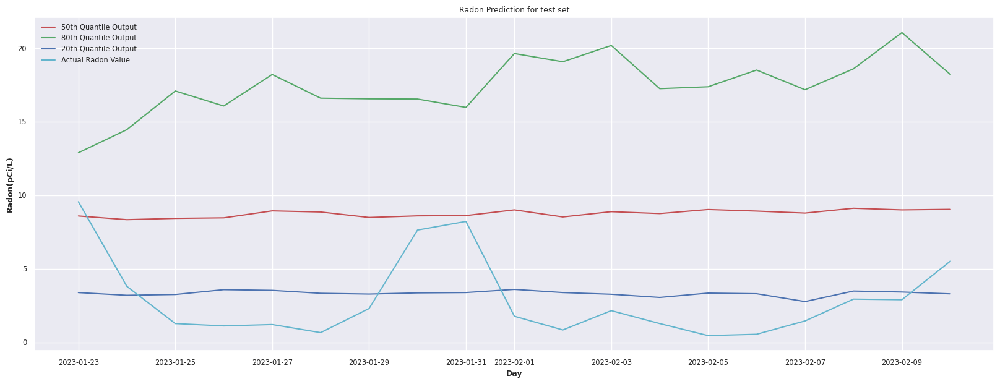

In [129]:
# plot the forecast
plt.figure(100, figsize=(20, 7))
plt.plot(dfY.index, dfY['Q50'], color='r', label='50th Quantile Output')
plt.plot(dfY.index, dfY['Q80'], color='g', label='80th Quantile Output')
plt.plot(dfY.index, dfY['Q20'], color='b', label='20th Quantile Output')
plt.plot(dfY.index, dfY['Actual'], color='c', label='Actual Radon Value')
plt.legend()
plt.title('Radon Prediction for test set')
plt.xlabel('Day')
plt.ylabel('Radon(pCi/L)')
plt.show()